# Temperature & Radius analysis

Created on 01 March 2020 for the Pentatrap experiment

@author: Menno Door<br>
@contact: door+fticr@mpi-k.de<br>
@license: MIT license

### Requirements:

The following code was written for Python 3.7/3.8. The required libraries are listed below with a rough description for their task in the code.

    fhds (inhouse data storage, https://git.mpi-hd.mpg.de/Pentatrap/fhds)
    h5py (data storage, easier to distribute)
    pandas (data organisation, calculation and visualization)
    numpy (calculation)
    matplotlib (plotting)
    scipy (chi square fitting)
    jupyter (Python notebook environment)
    ipywidgets (https://ipywidgets.readthedocs.io/en/latest/user_install.html)
    plotly (plotting, https://github.com/plotly/plotly.py#installation)
    qgrid (data visualization, https://github.com/quantopian/qgrid#installation)

### Remarks and TODOs

- this should work for magnetron as well as for cyclotron (be aware of B2 for cyclotron!)
- please be aware that I at the end only use the c4 shift, maybe you want to integrate higher order shifts as well as B2


In [2]:
# standard libs
from datetime import datetime
from pathlib import Path
import os, json
from pprint import pprint

# math and data
import numpy as np
import scipy
import pandas as pd
import h5py
from uncertainties import ufloat, umath

# visualization
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
#display(HTML("<style>div.output_scroll { height: 150em; }</style>"))
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
%matplotlib inline
import matplotlib.pyplot as plt
import qgrid
import plotly.graph_objs as go
import plotly.offline as py
import plotly.express as px
py.init_notebook_mode()
plt.rcParams['figure.figsize'] = (10, 4)

%load_ext autoreload
%autoreload 2

# this package
from fhds import fhds, interface
from fticr_toolkit import *
from trap_control import fitaxialClass
from fticr_toolkit.fitaxial import mennofit
from fticr_toolkit.fit_dip import fit_dip as fit_dip_alex
from fticr_toolkit.fit_dip import fit_double_dip as fit_double_alex
from fticr_toolkit.fit_dip import dip_func as dip_func_alex 
import fticr_toolkit.fitaxialClass_Pavel as fitaxialClass_Pavel


### Step 1: Load raw data and inspect

The input_data filename should be either a folder following fhds rules (append ".fhds" to the folder name please) or a hdf5 file.

In [3]:
###   P A R A M E T E R   L I S T   ( this is especially used for batch processing using the papermill package )
measurement_folder = 'E:\\local_analysis\\Yb_CHAR\\CHAR_TEMP_trap3_NOfeedback_174Yb43+'
measurement_folder = 'Z:\\Measurements\\CHAR_TEMP_trap3_12C6+'

input_file = 'AxialTemp_8.fhds' 
output_folder = "./part1_data/"
use_settings_file = False
settings = {
    "reuse_fitdata": False,
    "fit_function": "pavel",
}

In [4]:

data, meas_config, output_folder = data_conversion.load_data(measurement_folder=measurement_folder, 
                          input_data=input_file, 
                          output_folder="part1_data",
                          measurement_script = "axial_temp"
                         )

if use_settings_file:
    settings.update( data_conversion.load_settings(measurement_folder) )
print("settings", settings)

#pprint(meas_config)
data_root = data["meas_data"]

trap = meas_config["trap"]
ion = meas_config["ion"]
print(trap, ion)


 >>> WARNING!!! output_folder already exists! files will maybe be overwritten! <<< 


 >>> I hope you are in PART1, loading raw measurement data now... <<< 

object loaded in read mode, no writing possible
object loaded in read mode, no writing possible
object loaded in read mode, no writing possible
settings {'reuse_fitdata': False, 'fit_function': 'pavel'}
3 12C6+


In [5]:
####
# Chech the data structure, cycles and such
#
####

data = list(data_root.keys())
print("root group names / MAIN CYCLES : ", data )


root group names / MAIN CYCLES :  ['axial_fits_bad_backup (2).pkl', 'axial_fits_bad_backup.pkl', 'axial_fits_semibad_backup.pkl', 'nu_z_0.876600_cool_0.008.spec', 'nu_z_0.886600_0.008_1.spec', 'nu_z_0.886600_0.008_10.spec', 'nu_z_0.886600_0.008_10_ref.spec', 'nu_z_0.886600_0.008_11.spec', 'nu_z_0.886600_0.008_11_ref.spec', 'nu_z_0.886600_0.008_12.spec', 'nu_z_0.886600_0.008_12_ref.spec', 'nu_z_0.886600_0.008_13.spec', 'nu_z_0.886600_0.008_13_ref.spec', 'nu_z_0.886600_0.008_14.spec', 'nu_z_0.886600_0.008_14_ref.spec', 'nu_z_0.886600_0.008_15.spec', 'nu_z_0.886600_0.008_15_ref.spec', 'nu_z_0.886600_0.008_16.spec', 'nu_z_0.886600_0.008_16_ref.spec', 'nu_z_0.886600_0.008_17.spec', 'nu_z_0.886600_0.008_17_ref.spec', 'nu_z_0.886600_0.008_18.spec', 'nu_z_0.886600_0.008_18_ref.spec', 'nu_z_0.886600_0.008_19.spec', 'nu_z_0.886600_0.008_19_ref.spec', 'nu_z_0.886600_0.008_1_ref.spec', 'nu_z_0.886600_0.008_2.spec', 'nu_z_0.886600_0.008_20.spec', 'nu_z_0.886600_0.008_20_ref.spec', 'nu_z_0.886600_0.

In [6]:
## get the keys of the data we are intereseted in...

#raw_data_keys = data_conversion.get_data_paths( data_root, attr_type = ("amplitude", "phase") ) # super slow in fhds since all meta json files have to be read
raw_data_keys = data_conversion.get_data_paths( data_root, name_includes= ("amplitude") )
#pprint(raw_data_keys)

In [7]:
# Here you can check each spectrum individually, sorry for the simple drop down list of all specs, but everything else would be annoying to program here.

@interact
def spectrum_plot(key=raw_data_keys, center = widgets.FloatText(0), span = widgets.FloatText(100), downsample_factor = widgets.IntText(1)):
    try:        
        spec = data_conversion.Spectrum(data_root[key])
        if center == 0:
            trap = spec.attrs["trap"][-1]
            center = meas_config["nu_z"]
        
        spec.cut(center, span)
        ds_freqs, ds_amps = spec.downsample(downsample_factor, inplace=False)
        
        print(data_root[key][:].size)
        fig=plt.figure(figsize=(20, 8))

        ax1 = plt.subplot(211)
        plt.plot(spec.freqs, spec.amps)
        plt.plot(ds_freqs, ds_amps, linewidth=2)
        plt.title(str(spec.attrs["time"])+"    cycle "+str(spec.attrs["cycle"])+"    "+str(spec.attrs["trap"]))
        print(spec.attrs.keys())
        # share x only
        ax2 = plt.subplot(212, sharex=ax1)
        ax2.set_ylim(0, 2*np.pi)
        plt.plot(spec.freqs, spec.phases)
        plt.show()
    except:
        #raise
        print("not spectrum data here...")

interactive(children=(Dropdown(description='key', options=('/axial_fits_bad_backup (2).pkl', '/axial_fits_bad_…

### Step 2: Fit axial dip, all 10 averages

The **structure** is main cycle / subcycle (typ. 25) / position (typ. 2) / trap (typ. 2) / spectra (typ. 10). **If this changes you have to modify the loop!**

In [7]:
# refresher:
print("data : ", data )
print("len data : ", len(data) )
print("TRAP : ", trap)

data :  ['axial_fits_bad_backup (2).pkl', 'axial_fits_bad_backup.pkl', 'axial_fits_semibad_backup.pkl', 'nu_z_0.876600_cool_0.008.spec', 'nu_z_0.886600_0.008_1.spec', 'nu_z_0.886600_0.008_10.spec', 'nu_z_0.886600_0.008_10_ref.spec', 'nu_z_0.886600_0.008_11.spec', 'nu_z_0.886600_0.008_11_ref.spec', 'nu_z_0.886600_0.008_12.spec', 'nu_z_0.886600_0.008_12_ref.spec', 'nu_z_0.886600_0.008_13.spec', 'nu_z_0.886600_0.008_13_ref.spec', 'nu_z_0.886600_0.008_14.spec', 'nu_z_0.886600_0.008_14_ref.spec', 'nu_z_0.886600_0.008_15.spec', 'nu_z_0.886600_0.008_15_ref.spec', 'nu_z_0.886600_0.008_16.spec', 'nu_z_0.886600_0.008_16_ref.spec', 'nu_z_0.886600_0.008_17.spec', 'nu_z_0.886600_0.008_17_ref.spec', 'nu_z_0.886600_0.008_18.spec', 'nu_z_0.886600_0.008_18_ref.spec', 'nu_z_0.886600_0.008_19.spec', 'nu_z_0.886600_0.008_19_ref.spec', 'nu_z_0.886600_0.008_1_ref.spec', 'nu_z_0.886600_0.008_2.spec', 'nu_z_0.886600_0.008_20.spec', 'nu_z_0.886600_0.008_20_ref.spec', 'nu_z_0.886600_0.008_21.spec', 'nu_z_0.8866

In [8]:
# fit settings

nu_z_guess = meas_config["nu_z"]
nu_m_guess = meas_config["nu_m"]
nu_p_guess = meas_config["nu_p"]

if trap==2:
    dip_span = 10
    fit_config = {
        "center" : nu_z_guess,
        "dip_center": nu_z_guess,
        "res_span" : 2000, 
        "span" : 5, 
        "q_guess" : 4200, 
        "dip_range" : 1, 
        "width_range" : [0.5,10]
    }                 
else:
    dip_span = 20
    fit_config = {
        "center" : nu_z_guess,
        "dip_center": nu_z_guess,
        "res_span" : 2000, 
        "span" : 5, 
        "q_guess" : 4200, 
        "dip_range" : 1, 
        "width_range" : [0.5,10]
    }
print(fit_config)
    
# DANIELS FIT
if trap==2:          
    fit_opt = { # not needed, fit is automatic
        "dip_center": nu_z_guess,
        "res_span": 4000,
        "dip_span": 20,
        'min_dip_width': 0.5
    #    "fit_method": 0,
    #    "A": 110
    }
if trap==3:          
    fit_opt = { # not needed, fit is automatic
    #    "dip_center": nu_z_guess,
        "res_span": 500,
        "dip_span": 100,
        "supress_dispersive": False, 
    #    'min_dip_width': 2.0
    #    "fit_method": 0,
    #    "A": 110
    }
    
print(fit_opt)

{'center': 501503.1, 'dip_center': 501503.1, 'res_span': 2000, 'span': 5, 'q_guess': 4200, 'dip_range': 1, 'width_range': [0.5, 10]}
{'res_span': 500, 'dip_span': 100, 'supress_dispersive': False}


In [9]:

def calc_nu_m(nu_rf, nu_z, nu_l, nu_r,  dnu_z, dnu_l, dnu_r):
    print(nu_rf, nu_z, nu_l, nu_r,  dnu_z, dnu_l, dnu_r)
    value = nu_rf + nu_z - nu_l - nu_r
    dvalue = np.sqrt(dnu_z**2 + dnu_l**2 + dnu_r**2)
    return value, dvalue


def calc_nu_p(nu_rf, nu_z, nu_l, nu_r,  dnu_z, dnu_l, dnu_r):
    print(nu_rf, nu_z, nu_l, nu_r,  dnu_z, dnu_l, dnu_r)
    value = nu_rf - nu_z + nu_l + nu_r
    dvalue = np.sqrt(dnu_z**2 + dnu_l**2 + dnu_r**2)
    return value, dvalue

/axial_fits_bad_backup (2).pkl
/axial_fits_bad_backup.pkl
/axial_fits_semibad_backup.pkl
/nu_z_0.876600_cool_0.008.spec
resonator fit results {'A': 546841447152350.5, 'dA': 209998606071578.84, 'Q': 7676.3055836622125, 'dQ': 1512.5388545563037, 'offset': 520349468538.5228, 'doffset': 17144853704.266573, 'slope': -0.001513910972797346, 'dslope': 3.9377344271176175e-05, 'nu_res': 501501.6000000001, 'dnu_res': 0.9905478898584554}
init values for dip fit {'A': 546841447152350.5, 'dA': 209998606071578.84, 'Q': 7676.3055836622125, 'dQ': 1512.5388545563037, 'offset': 520349468538.5228, 'doffset': 17144853704.266573, 'slope': -0.001513910972797346, 'dslope': 3.9377344271176175e-05, 'nu_res': 501501.6000000001, 'dnu_res': 0.9905478898584554}
estimated dip width 9.0

 
 _______________________ Fit _______________________


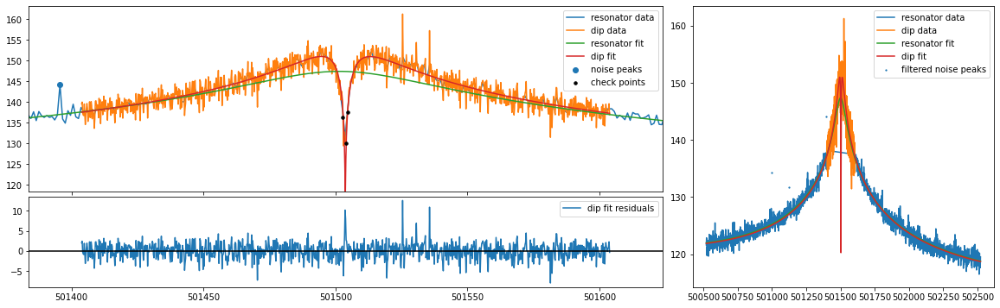

mean fit residuals = 8.1e-03 +/- 6.3e-02
{'A': 1250314718205654.8, 'dA': 48909307849832.805, 'Q': 11873.629740367469, 'dQ': 302.90637939784057, 'offset': 520349468538.5228, 'doffset': 17144853704.266573, 'slope': -0.001513910972797346, 'dslope': 3.9377344271176175e-05, 'nu_res': 501504.06610945164, 'dnu_res': 0.44309600167991087, 'nu_z': 501503.6842271256, 'dnu_z': 0.02226810016937234, 'dip_width': 8.076640606122044, 'ddip_width': 0.39277543942696685, 'pcov': array([[ 4.958682851532e-04, -2.666553227064e-05, -9.468558347819e+07,
        -4.578141194849e-03, -6.360754796005e-04],
       [-2.666553227065e-05,  1.542725458170e-01,  9.015656161961e+12,
         5.861155735843e+01, -5.087349131674e-05],
       [-9.468558347888e+07,  9.015656161961e+12,  2.392120394350e+27,
         1.373218582869e+16, -9.654046534513e+10],
       [-4.578141194857e-03,  5.861155735843e+01,  1.373218582869e+16,
         9.175227467991e+04, -1.508712028127e-01],
       [-6.360754796005e-04, -5.087349131847e-05

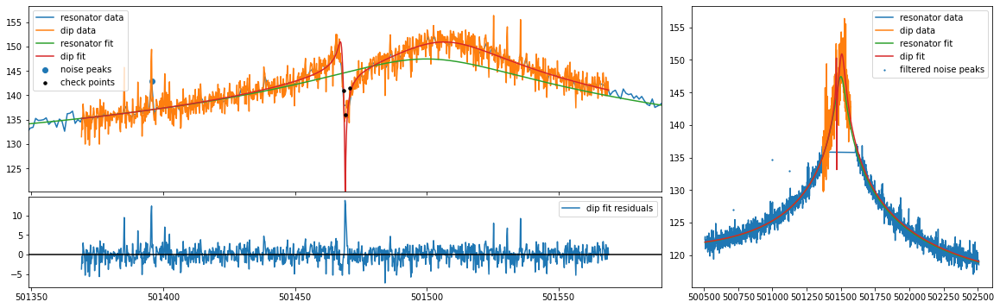

mean fit residuals = 9.1e-03 +/- 6.6e-02
{'A': 1235574273471408.8, 'dA': 49659027406434.23, 'Q': 11510.021283987378, 'dQ': 305.40631974930614, 'offset': 536841157720.3789, 'doffset': 16865507392.634844, 'slope': -0.0014911024349937956, 'dslope': 3.84854716117374e-05, 'nu_res': 501504.85600766365, 'dnu_res': 0.5041669675017488, 'nu_z': 501469.09010787273, 'dnu_z': 0.020792678931109983, 'dip_width': 6.336372509838914, 'ddip_width': 0.3591890476813442, 'pcov': array([[ 4.323354971322e-04,  1.444789873754e-03,  1.635182303609e+09,
         2.238184581542e-02, -5.897170720983e-04],
       [ 1.444789873754e-03,  1.290167719742e-01,  7.395946686849e+12,
         4.780090429780e+01, -1.383606707974e-02],
       [ 1.635182303609e+09,  7.395946686849e+12,  2.466019002953e+27,
         1.396101281605e+16, -2.158420760287e+12],
       [ 2.238184581542e-02,  4.780090429780e+01,  1.396101281605e+16,
         9.327302014282e+04, -2.802607803274e+01],
       [-5.897170720983e-04, -1.383606707974e-02, 

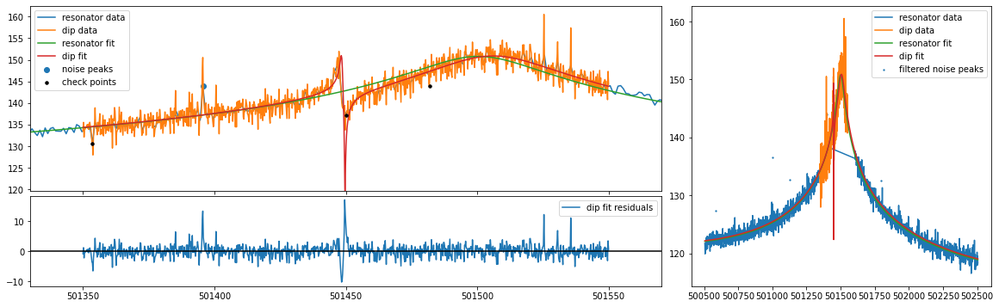

mean fit residuals = 1.1e-02 +/- 6.8e-02
{'A': 1229624961521288.0, 'dA': 50232186230306.086, 'Q': 11256.056807818159, 'dQ': 306.6693679408425, 'offset': 542735686491.40704, 'doffset': 16286780408.327887, 'slope': -0.001566638474236884, 'dslope': 3.69565858273427e-05, 'nu_res': 501504.82046749163, 'dnu_res': 0.5949794872367262, 'nu_z': 501449.70017375646, 'dnu_z': 0.02266148515619532, 'dip_width': 7.031386030747182, 'ddip_width': 0.40288827759226103, 'pcov': array([[ 5.135429094845e-04,  2.565592547251e-03,  1.880700261463e+09,
         3.905785076935e-02, -7.715735792517e-04],
       [ 2.565592547251e-03,  1.623189642213e-01,  8.418186232922e+12,
         5.414727937286e+01, -2.637288515103e-02],
       [ 1.880700261463e+09,  8.418186232922e+12,  2.523272533476e+27,
         1.399492050354e+16, -3.131662714620e+12],
       [ 3.905785076935e-02,  5.414727937286e+01,  1.399492050354e+16,
         9.404610123324e+04, -5.068779798309e+01],
       [-7.715735792517e-04, -2.637288515103e-02, 

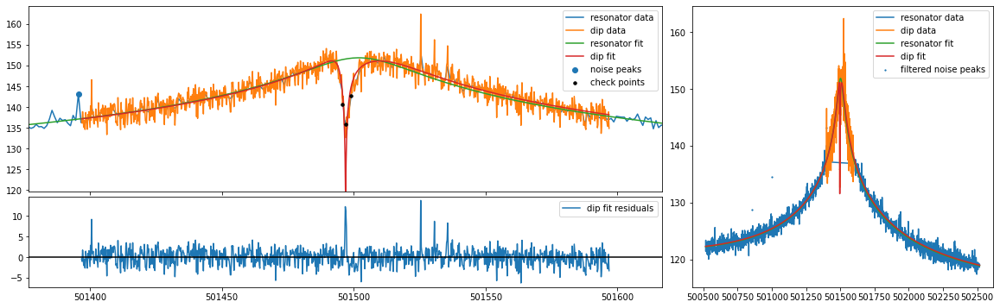

mean fit residuals = 7.7e-03 +/- 6.3e-02
{'A': 1283303720203065.8, 'dA': 49557282762471.72, 'Q': 11684.287299728485, 'dQ': 295.5981175936279, 'offset': 573243457747.3464, 'doffset': 16667577592.492687, 'slope': -0.0016115655899968247, 'dslope': 3.7453361325429885e-05, 'nu_res': 501504.74977237143, 'dnu_res': 0.446182920858659, 'nu_z': 501496.91653304175, 'dnu_z': 0.020037768637053407, 'dip_width': 6.335258266654116, 'ddip_width': 0.33624097570141953, 'pcov': array([[ 4.015121719521e-04,  2.426292267253e-04,  3.360978773548e+07,
        -1.494487585893e-03, -5.178817757849e-04],
       [ 2.426292267253e-04,  1.130579937406e-01,  7.086799101127e+12,
         4.437364773617e+01, -2.552701096793e-03],
       [ 3.360978773475e+07,  7.086799101127e+12,  2.455924274800e+27,
         1.356242066686e+16, -5.184441845458e+11],
       [-1.494487585897e-03,  4.437364773617e+01,  1.356242066686e+16,
         8.737824712490e+04, -5.203333144747e+00],
       [-5.178817757849e-04, -2.552701096794e-03,

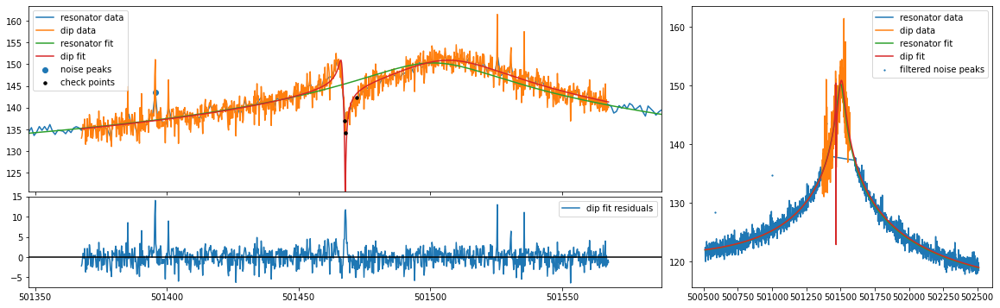

mean fit residuals = 7.3e-03 +/- 6.8e-02
{'A': 1234929160313874.2, 'dA': 51165432067911.74, 'Q': 11454.844296361161, 'dQ': 313.8724306906464, 'offset': 539544314726.69257, 'doffset': 16115133196.292788, 'slope': -0.0014825928171415177, 'dslope': 3.6518997454215054e-05, 'nu_res': 501505.2089528042, 'dnu_res': 0.5267230836685897, 'nu_z': 501467.69650920253, 'dnu_z': 0.021173750159284282, 'dip_width': 6.074677405846332, 'ddip_width': 0.3622930247214214, 'pcov': array([[ 4.483276958078e-04,  1.552365023524e-03,  1.618509669790e+09,
         2.295131802089e-02, -6.158194124228e-04],
       [ 1.552365023524e-03,  1.312562357618e-01,  7.532446799169e+12,
         4.856126542617e+01, -1.497899751876e-02],
       [ 1.618509669789e+09,  7.532446799169e+12,  2.617901438696e+27,
         1.476857701101e+16, -2.416188203869e+12],
       [ 2.295131802089e-02,  4.856126542617e+01,  1.476857701101e+16,
         9.851590274765e+04, -3.169516838797e+01],
       [-6.158194124228e-04, -1.497899751876e-02,

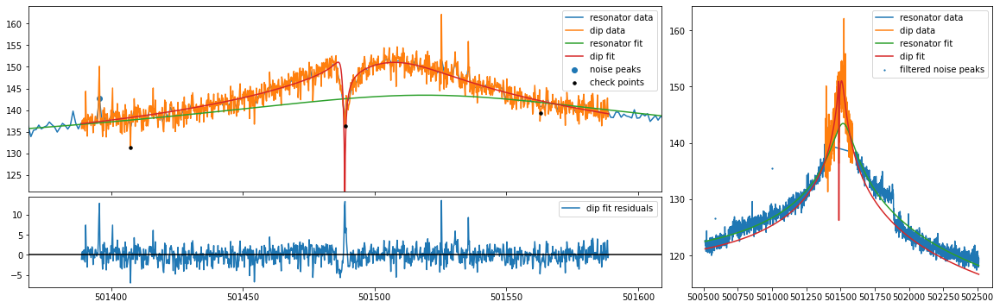

mean fit residuals = 2.0e-02 +/- 6.6e-02
{'A': 1270750041730674.5, 'dA': 50751177126245.34, 'Q': 11195.00967220635, 'dQ': 296.2942911266302, 'offset': 140096437637.14597, 'doffset': 27414278100.817738, 'slope': -0.0022341232775106123, 'dslope': 5.428781923394349e-05, 'nu_res': 501505.1464296869, 'dnu_res': 0.48750086507266527, 'nu_z': 501488.71512427897, 'dnu_z': 0.01590123103674609, 'dip_width': 4.261063252626299, 'ddip_width': 0.27458696148674716, 'pcov': array([[ 2.528491484840e-04,  1.239073825954e-04, -2.209280491830e+09,
        -2.397649638133e-02, -3.403220330530e-04],
       [ 1.239073825954e-04,  7.539799941852e-02,  5.041978365767e+12,
         3.077358299712e+01, -3.790034589928e-03],
       [-2.209280491830e+09,  5.041978365767e+12,  2.575681979700e+27,
         1.387871902413e+16, -1.172515556450e+12],
       [-2.397649638133e-02,  3.077358299712e+01,  1.387871902413e+16,
         8.779030695423e+04, -1.236316904274e+01],
       [-3.403220330530e-04, -3.790034589928e-03, 

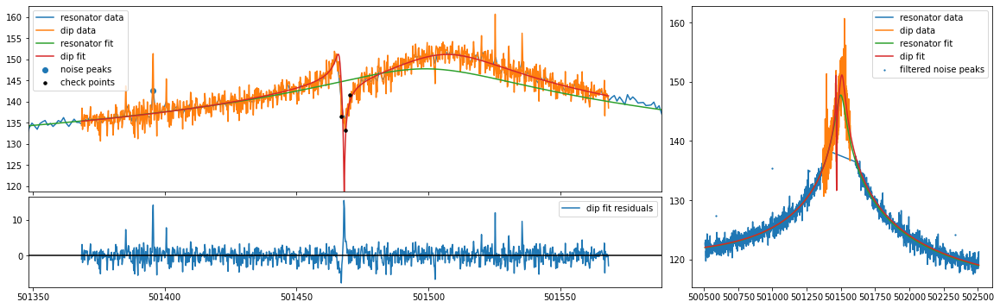

mean fit residuals = 1.3e-02 +/- 6.7e-02
{'A': 1310687168786917.8, 'dA': 53672571748371.54, 'Q': 11619.092608343715, 'dQ': 313.3234435766785, 'offset': 527955529175.6792, 'doffset': 16902890822.545748, 'slope': -0.001488376442157718, 'dslope': 3.79545026565179e-05, 'nu_res': 501505.0180939673, 'dnu_res': 0.5101073954192725, 'nu_z': 501468.08599614806, 'dnu_z': 0.02347822257542806, 'dip_width': 8.186100170091603, 'ddip_width': 0.42628710319861796, 'pcov': array([[ 5.512269353013e-04,  1.874149261125e-03,  1.654433499940e+09,
         2.332530356397e-02, -7.466883680063e-04],
       [ 1.874149261125e-03,  1.817206943535e-01,  1.050887770131e+13,
         6.446928587355e+01, -1.854377731368e-02],
       [ 1.654433499941e+09,  1.050887770131e+13,  2.880744958084e+27,
         1.548727773686e+16, -2.377720633882e+12],
       [ 2.332530356397e-02,  6.446928587355e+01,  1.548727773686e+16,
         9.817158029475e+04, -2.946556416064e+01],
       [-7.466883680063e-04, -1.854377731368e-02, -2.

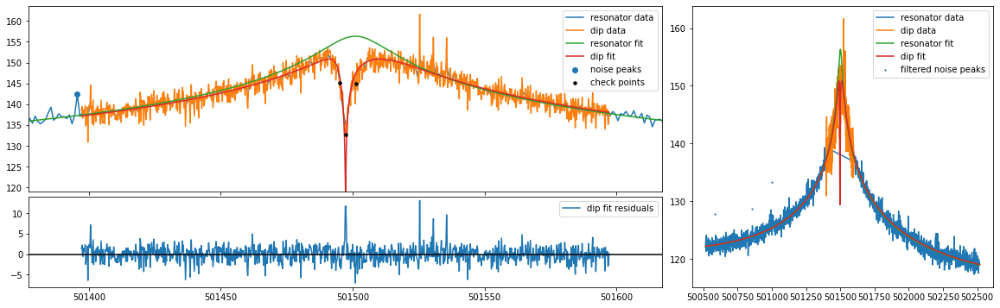

mean fit residuals = 1.0e-02 +/- 6.2e-02
{'A': 1216042263964143.0, 'dA': 45607743737602.88, 'Q': 11431.66974274952, 'dQ': 282.67357136736376, 'offset': 567582975523.49, 'doffset': 16812620678.604351, 'slope': -0.0015418898734182553, 'dslope': 3.7880819902400154e-05, 'nu_res': 501504.1673968663, 'dnu_res': 0.44365237109080996, 'nu_z': 501497.2874998462, 'dnu_z': 0.021466728264727557, 'dip_width': 7.488612080709055, 'ddip_width': 0.3649238917809695, 'pcov': array([[ 4.608204223917e-04,  2.591013718984e-04,  2.769937763573e+08,
         9.973751384599e-04, -5.975673591394e-04],
       [ 2.591013718984e-04,  1.331694467926e-01,  7.514871768200e+12,
         4.893002290478e+01, -2.649381288018e-03],
       [ 2.769937763570e+08,  7.514871768200e+12,  2.080066288835e+27,
         1.191763108071e+16, -4.335512545643e+11],
       [ 9.973751384585e-04,  4.893002290478e+01,  1.191763108071e+16,
         7.990434794958e+04, -4.450209415778e+00],
       [-5.975673591394e-04, -2.649381288017e-03, -4

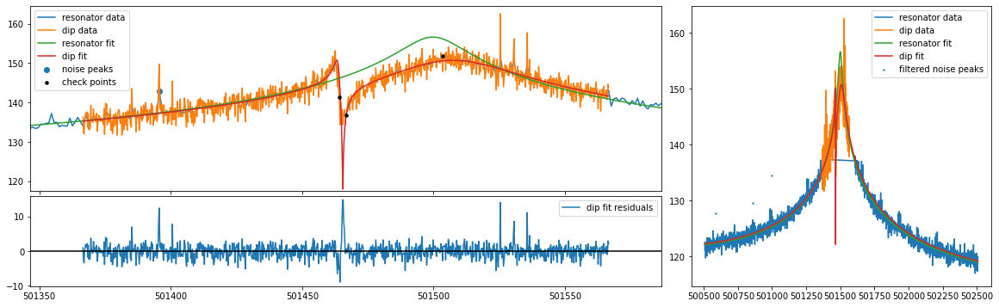

mean fit residuals = 1.7e-02 +/- 6.8e-02
{'A': 1179331577460660.2, 'dA': 47695489388449.8, 'Q': 10960.433662330033, 'dQ': 297.2683902540471, 'offset': 557894082174.3562, 'doffset': 16560242388.671007, 'slope': -0.0015267019383573878, 'dslope': 3.755609563066817e-05, 'nu_res': 501505.3326283763, 'dnu_res': 0.545916017797688, 'nu_z': 501465.46740027174, 'dnu_z': 0.025826173405705616, 'dip_width': 8.437318073308768, 'ddip_width': 0.44013166909849066, 'pcov': array([[ 6.669912327816e-04,  2.223888957534e-03,  9.796843592351e+08,
         1.975533857357e-02, -9.212244102400e-04],
       [ 2.223888957534e-03,  1.937158861434e-01,  9.584696100532e+12,
         6.287284778093e+01, -2.260732216490e-02],
       [ 9.796843592350e+08,  9.584696100532e+12,  2.274859708004e+27,
         1.298257925883e+16, -2.480686960032e+12],
       [ 1.975533857357e-02,  6.287284778093e+01,  1.298257925883e+16,
         8.836849584423e+04, -3.356937318049e+01],
       [-9.212244102400e-04, -2.260732216490e-02, -2

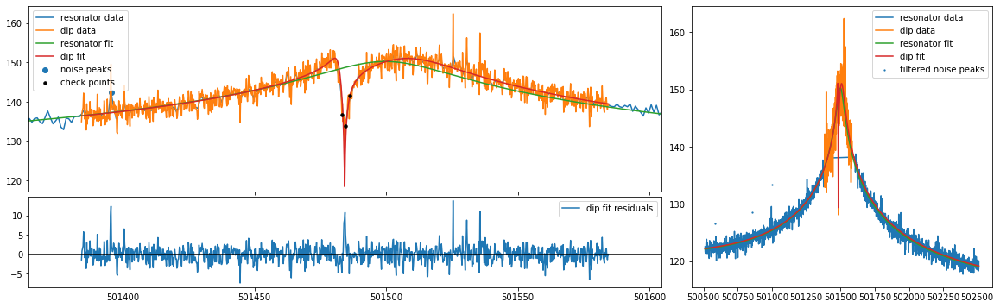

mean fit residuals = 1.0e-02 +/- 6.6e-02
{'A': 1269475747078786.2, 'dA': 51044183140949.46, 'Q': 11434.487972576948, 'dQ': 303.3972507846015, 'offset': 556152429156.9761, 'doffset': 16520405123.20608, 'slope': -0.0014935592592163203, 'dslope': 3.6925557499823185e-05, 'nu_res': 501504.3879172251, 'dnu_res': 0.48411948436639857, 'nu_z': 501484.2570857712, 'dnu_z': 0.024322499545033776, 'dip_width': 8.006203632462467, 'ddip_width': 0.40972650156076057, 'pcov': array([[ 5.915839841182e-04,  9.735022617071e-04,  1.285454500583e+08,
         2.025712222819e-03, -7.731818963999e-04],
       [ 9.735022617071e-04,  1.678758060812e-01,  9.635962606666e+12,
         6.017495240512e+01, -9.570019611232e-03],
       [ 1.285454500582e+08,  9.635962606666e+12,  2.605508632527e+27,
         1.429997736793e+16, -1.306973757505e+12],
       [ 2.025712222819e-03,  6.017495240512e+01,  1.429997736793e+16,
         9.204989178365e+04, -1.501378825081e+01],
       [-7.731818963999e-04, -9.570019611232e-03, 

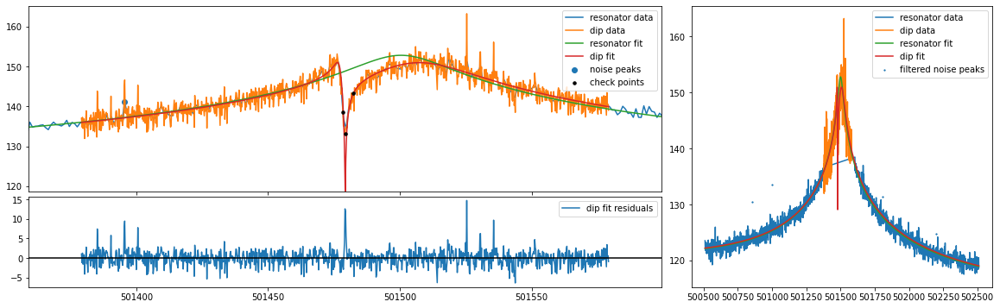

mean fit residuals = 1.1e-02 +/- 6.3e-02
{'A': 1252196752366860.5, 'dA': 48299994778162.46, 'Q': 11475.398315374076, 'dQ': 291.9899567437164, 'offset': 563484098414.5428, 'doffset': 16688629084.849836, 'slope': -0.0015621764544417284, 'dslope': 3.766127039323481e-05, 'nu_res': 501504.54106851696, 'dnu_res': 0.46842527780755516, 'nu_z': 501479.27918712975, 'dnu_z': 0.02200533988142829, 'dip_width': 7.557959761185491, 'ddip_width': 0.3803208692197377, 'pcov': array([[ 4.842349832972e-04,  1.094551138539e-03,  1.015036884321e+09,
         1.262211955751e-02, -6.398798716460e-04],
       [ 1.094551138539e-03,  1.446439635641e-01,  8.250663450669e+12,
         5.240958224338e+01, -1.056990920101e-02],
       [ 1.015036884321e+09,  8.250663450669e+12,  2.332889495571e+27,
         1.301428505070e+16, -1.473766535898e+12],
       [ 1.262211955751e-02,  5.240958224338e+01,  1.301428505070e+16,
         8.525813483920e+04, -1.767095729704e+01],
       [-6.398798716460e-04, -1.056990920101e-02, 

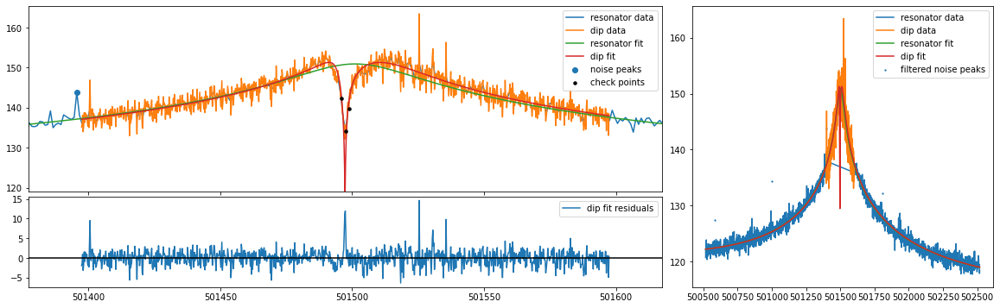

mean fit residuals = 9.8e-03 +/- 6.2e-02
{'A': 1349202185964597.8, 'dA': 52254875120542.15, 'Q': 12144.512142892561, 'dQ': 304.8895185211277, 'offset': 571965092212.1256, 'doffset': 16632483787.666876, 'slope': -0.0015633099767518412, 'dslope': 3.728961566518033e-05, 'nu_res': 501504.5381352343, 'dnu_res': 0.4291084116862351, 'nu_z': 501497.28717598406, 'dnu_z': 0.021488155914073978, 'dip_width': 7.783007915323808, 'ddip_width': 0.3773182424400881, 'pcov': array([[ 4.617408445876e-04,  2.951831925392e-04,  2.982881292433e+08,
         8.543938129637e-04, -5.882667773072e-04],
       [ 2.951831925392e-04,  1.423690560781e-01,  9.162584781597e+12,
         5.609687603725e+01, -2.672052639169e-03],
       [ 2.982881292428e+08,  9.162584781597e+12,  2.730571973863e+27,
         1.478851756480e+16, -4.595540122425e+11],
       [ 8.543938129613e-04,  5.609687603725e+01,  1.478851756480e+16,
         9.295761850405e+04, -4.442721574600e+00],
       [-5.882667773072e-04, -2.672052639169e-03, -

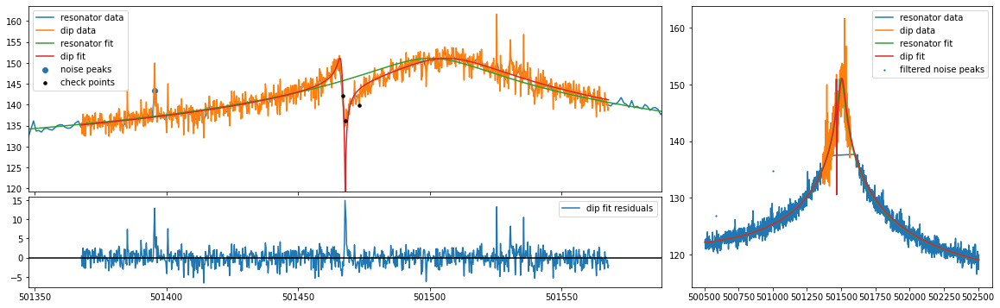

mean fit residuals = 1.2e-02 +/- 6.6e-02
{'A': 1287013983785354.8, 'dA': 52225141579952.06, 'Q': 11752.019374865162, 'dQ': 313.0185680604477, 'offset': 559422322317.4482, 'doffset': 16711436444.889544, 'slope': -0.0015338158419014635, 'dslope': 3.738949387304633e-05, 'nu_res': 501504.3552307585, 'dnu_res': 0.4983903968710511, 'nu_z': 501467.8828309525, 'dnu_z': 0.02206249081524858, 'dip_width': 7.171813684407851, 'ddip_width': 0.3885575342916493, 'pcov': array([[ 4.867535009729e-04,  1.670145518790e-03,  1.727379423899e+09,
         2.356926092888e-02, -6.570579529832e-04],
       [ 1.670145518790e-03,  1.509769574548e-01,  8.866849383078e+12,
         5.585004058577e+01, -1.563884229347e-02],
       [ 1.727379423899e+09,  8.866849383078e+12,  2.727465413046e+27,
         1.506915074893e+16, -2.236218019412e+12],
       [ 2.356926092888e-02,  5.585004058577e+01,  1.506915074893e+16,
         9.798062395061e+04, -2.833491948383e+01],
       [-6.570579529832e-04, -1.563884229347e-02, -2.

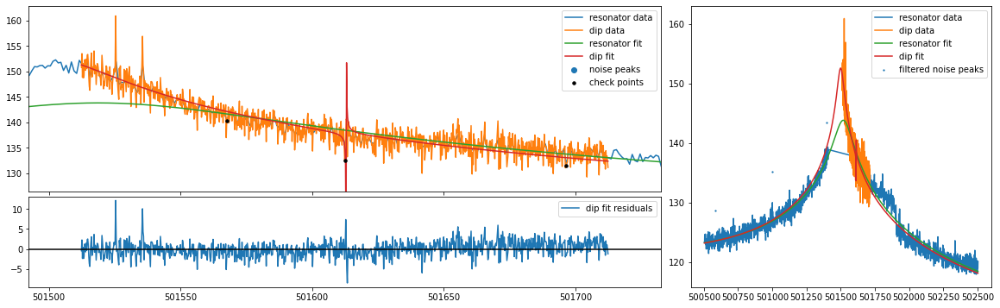

mean fit residuals = 2.6e-03 +/- 6.1e-02
{'A': 1810012438695235.0, 'dA': 403398625914708.6, 'Q': 11432.194931738124, 'dQ': 1093.211718054669, 'offset': 288049897627.6196, 'doffset': 27519650192.745888, 'slope': -0.002512193089130285, 'dslope': 5.1475211221802064e-05, 'nu_res': 501499.84199566464, 'dnu_res': 2.5731119007148693, 'nu_z': 501612.8915651718, 'dnu_z': 0.015188657902496575, 'dip_width': 2.0000000593054947, 'ddip_width': 0.30907424574749626, 'pcov': array([[ 2.306953288791e-04, -2.295598394498e-03,  4.781008864370e+11,
         1.245067516284e+00, -3.415935761370e-03],
       [-2.295598394498e-03,  9.552688938438e-02,  8.290751602979e+13,
         2.250918310623e+02, -4.730062272332e-01],
       [ 4.781008864370e+11,  8.290751602979e+13,  1.627304513899e+29,
         4.367387030155e+17, -9.604895444283e+14],
       [ 1.245067516284e+00,  2.250918310623e+02,  4.367387030155e+17,
         1.195111860492e+06, -2.457906327816e+03],
       [-3.415935761370e-03, -4.730062272332e-01,

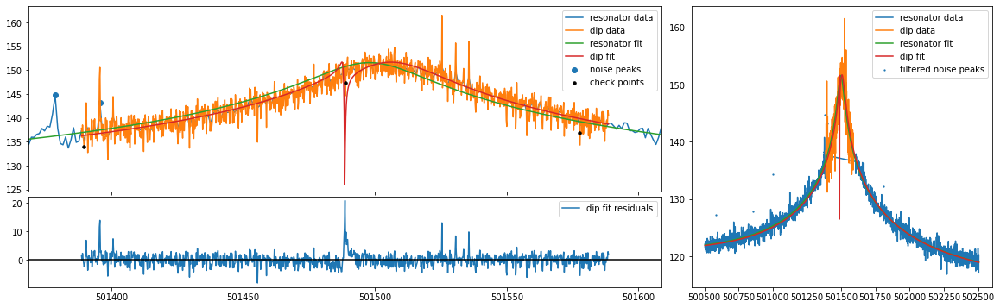

mean fit residuals = 4.1e-03 +/- 7.0e-02
{'A': 1483099783397206.8, 'dA': 66578597772567.945, 'Q': 12938.280552449633, 'dQ': 370.3058434089617, 'offset': 546173705133.0612, 'doffset': 16764844344.56813, 'slope': -0.0014755995163864054, 'dslope': 3.788702852547898e-05, 'nu_res': 501505.0110653606, 'dnu_res': 0.4677981197499267, 'nu_z': 501488.54624256125, 'dnu_z': 0.013681011298236456, 'dip_width': 2.0018149988607634, 'ddip_width': 0.19448570857452804, 'pcov': array([[ 1.871700701425e-04, -2.399372127434e-04, -6.630041968681e+09,
        -6.758211976886e-02, -2.278460464598e-04],
       [-2.399372127434e-04,  3.782469083974e-02,  3.448068114607e+12,
         2.009201581960e+01, -1.255863338008e-03],
       [-6.630041968681e+09,  3.448068114607e+12,  4.432709681361e+27,
         2.297123306155e+16, -1.197445280259e+12],
       [-6.758211976886e-02,  2.009201581960e+01,  2.297123306155e+16,
         1.371264176628e+05, -1.251454617308e+01],
       [-2.278460464598e-04, -1.255863338008e-03,

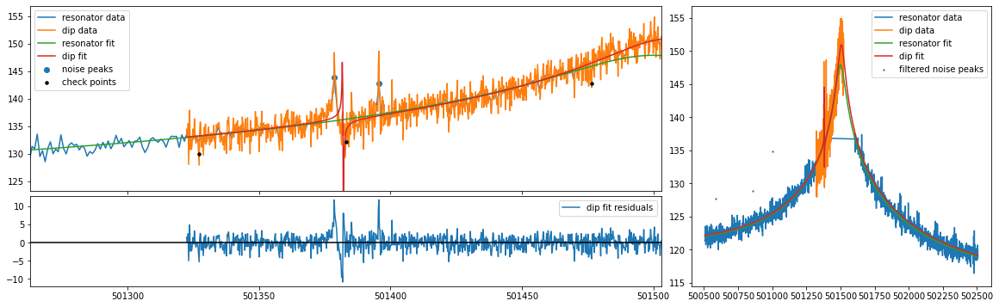

mean fit residuals = 2.4e-03 +/- 6.6e-02
{'A': 1242100212542451.8, 'dA': 51469047615574.625, 'Q': 11155.715734466752, 'dQ': 281.6211180728259, 'offset': 531748833494.4578, 'doffset': 16901703917.682682, 'slope': -0.001512072139801986, 'dslope': 3.7893585829269546e-05, 'nu_res': 501506.30778673897, 'dnu_res': 0.908953250133087, 'nu_z': 501382.0623004951, 'dnu_z': 0.01539912353542844, 'dip_width': 3.3829097694649284, 'ddip_width': 0.2848961962949731, 'pcov': array([[ 2.371330056594e-04,  2.811625063723e-03, -2.281208823023e+09,
         2.328549358696e-02, -4.964723465323e-04],
       [ 2.811625063723e-03,  8.116584266334e-02,  4.193255058614e+12,
         2.407246035991e+01, -5.997003692311e-03],
       [-2.281208823023e+09,  4.193255058614e+12,  2.649062862454e+27,
         1.215555968995e+16,  9.399541226320e+12],
       [ 2.328549358696e-02,  2.407246035991e+01,  1.215555968995e+16,
         7.931045414459e+04, -5.791367039837e+01],
       [-4.964723465323e-04, -5.997003692311e-03,  

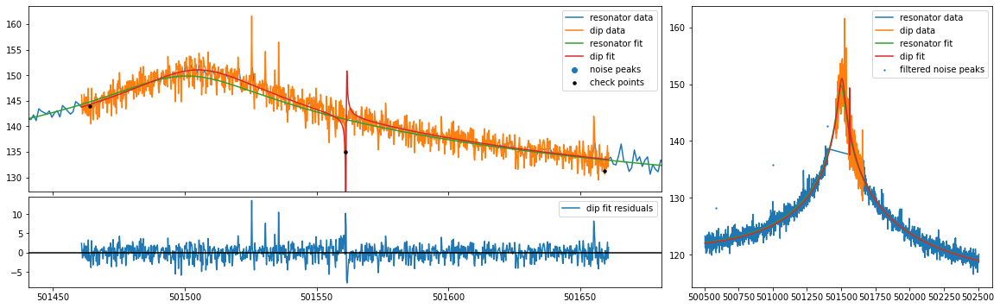

mean fit residuals = 9.5e-04 +/- 6.1e-02
{'A': 1266859858781318.0, 'dA': 47362061843587.97, 'Q': 11889.932115184947, 'dQ': 291.93260364560035, 'offset': 544898351673.98206, 'doffset': 17536217816.992104, 'slope': -0.0015453259813716974, 'dslope': 3.937074000280409e-05, 'nu_res': 501505.46639071614, 'dnu_res': 0.5068567690600589, 'nu_z': 501561.0998482459, 'dnu_z': 0.015527749082049335, 'dip_width': 2.0000558809933957, 'ddip_width': 0.18512199145204616, 'pcov': array([[ 2.411109915551e-04, -1.318690806332e-03,  8.061372137973e+08,
        -1.143055968398e-02, -3.613540806712e-04],
       [-1.318690806332e-03,  3.427015171917e-02,  2.130919493922e+12,
         1.379101435223e+01,  6.396987664584e-03],
       [ 8.061372137972e+08,  2.130919493922e+12,  2.243164902076e+27,
         1.261193706579e+16,  2.255521971682e+12],
       [-1.143055968398e-02,  1.379101435223e+01,  1.261193706579e+16,
         8.522464507130e+04,  3.942881669967e+01],
       [-3.613540806712e-04,  6.396987664584e-0

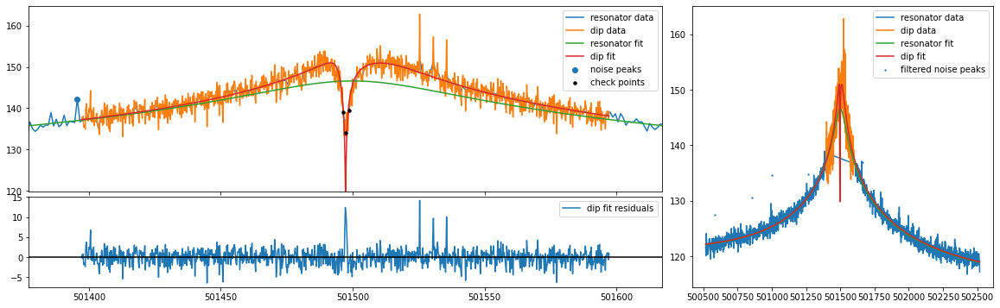

mean fit residuals = 9.2e-03 +/- 6.4e-02
{'A': 1246353432618354.8, 'dA': 48426453063517.55, 'Q': 11489.161521062586, 'dQ': 293.8711931284756, 'offset': 567397632885.0115, 'doffset': 16593801602.80634, 'slope': -0.0015356521642253098, 'dslope': 3.6854660308406934e-05, 'nu_res': 501504.6462882862, 'dnu_res': 0.4571506964242437, 'nu_z': 501497.29412010557, 'dnu_z': 0.02119356748005898, 'dip_width': 6.944127777453828, 'ddip_width': 0.3600695401637958, 'pcov': array([[ 4.491673025318e-04,  2.828240666311e-04,  3.906611026129e+08,
         2.259750521520e-03, -5.827371173965e-04],
       [ 2.828240666311e-04,  1.296500737538e-01,  7.657309583362e+12,
         4.880059243978e+01, -2.796211167456e-03],
       [ 3.906611026119e+08,  7.657309583362e+12,  2.345121356313e+27,
         1.316017514360e+16, -4.975471533245e+11],
       [ 2.259750521514e-03,  4.880059243978e+01,  1.316017514360e+16,
         8.636027815075e+04, -5.067383013796e+00],
       [-5.827371173965e-04, -2.796211167457e-03, -4

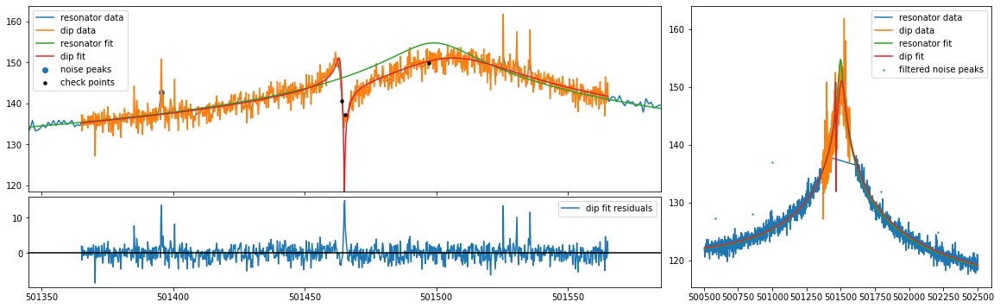

mean fit residuals = 1.3e-02 +/- 6.8e-02
{'A': 1273997674785995.0, 'dA': 52387505553100.69, 'Q': 11428.47137610899, 'dQ': 311.1579557181675, 'offset': 551978946698.3274, 'doffset': 16235324131.752085, 'slope': -0.0014836472037753768, 'dslope': 3.650971563941834e-05, 'nu_res': 501504.304060171, 'dnu_res': 0.5284752771766767, 'nu_z': 501465.0768403024, 'dnu_z': 0.023837705589850662, 'dip_width': 7.868934731162041, 'ddip_width': 0.42187517194325314, 'pcov': array([[ 5.682362077884e-04,  2.002768457648e-03,  1.623847052162e+09,
         2.481854868120e-02, -7.791428290848e-04],
       [ 2.002768457648e-03,  1.779786607021e-01,  9.922385781382e+12,
         6.197499011294e+01, -2.003004609690e-02],
       [ 1.623847052162e+09,  9.922385781382e+12,  2.744450738076e+27,
         1.497758656525e+16, -2.556459722564e+12],
       [ 2.481854868120e-02,  6.197499011294e+01,  1.497758656525e+16,
         9.681927340671e+04, -3.288810588557e+01],
       [-7.791428290848e-04, -2.003004609690e-02, -2.

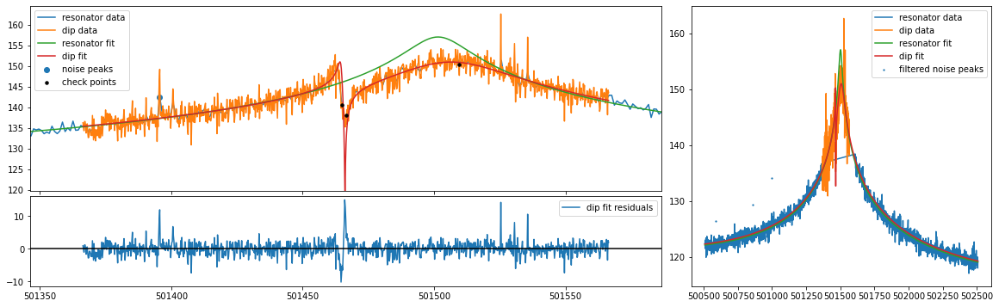

mean fit residuals = 1.1e-02 +/- 6.8e-02
{'A': 1253413354919499.2, 'dA': 51329791025588.93, 'Q': 11177.579661139216, 'dQ': 305.0264970786152, 'offset': 565602009200.3217, 'doffset': 16605790725.791597, 'slope': -0.0015103202351076067, 'dslope': 3.709871095805996e-05, 'nu_res': 501504.62951351894, 'dnu_res': 0.5379236808875635, 'nu_z': 501466.0867769431, 'dnu_z': 0.022434512720824716, 'dip_width': 6.846907703928772, 'ddip_width': 0.3888309486375228, 'pcov': array([[ 5.033073610208e-04,  1.744542810676e-03,  1.795567943891e+09,
         2.542724592453e-02, -6.975893424310e-04],
       [ 1.744542810676e-03,  1.511895066184e-01,  8.450640665589e+12,
         5.281968076566e+01, -1.767749865172e-02],
       [ 1.795567943891e+09,  8.450640665589e+12,  2.634747446731e+27,
         1.436516262612e+16, -2.562792175054e+12],
       [ 2.542724592453e-02,  5.281968076566e+01,  1.436516262612e+16,
         9.304116392005e+04, -3.281398970611e+01],
       [-6.975893424310e-04, -1.767749865172e-02, -

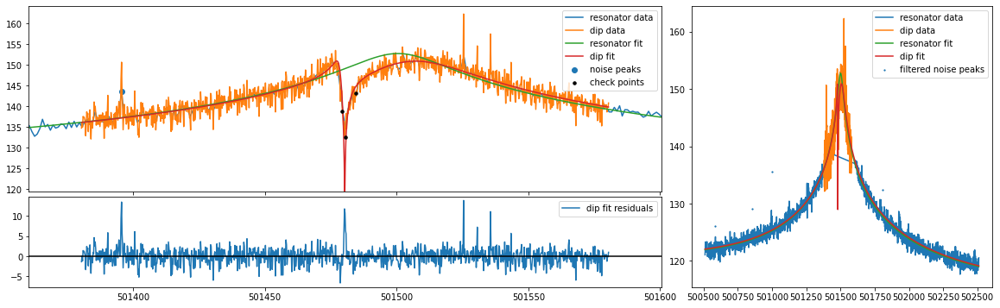

mean fit residuals = 9.6e-03 +/- 6.6e-02
{'A': 1239176772004390.8, 'dA': 49294098775192.016, 'Q': 11317.884140260436, 'dQ': 298.12109230923505, 'offset': 544683401310.26434, 'doffset': 16609799454.665308, 'slope': -0.0014402908519437385, 'dslope': 3.75811236420513e-05, 'nu_res': 501504.29311255645, 'dnu_res': 0.4887256006680983, 'nu_z': 501480.2921968195, 'dnu_z': 0.022267657383269353, 'dip_width': 7.351349035188163, 'ddip_width': 0.38677825284021355, 'pcov': array([[ 4.958485653387e-04,  1.066347507095e-03,  1.095759500069e+09,
         1.346241264322e-02, -6.583145271837e-04],
       [ 1.066347507095e-03,  1.495974168701e-01,  8.460911527437e+12,
         5.376526194425e+01, -1.056181941369e-02],
       [ 1.095759500068e+09,  8.460911527437e+12,  2.429908174058e+27,
         1.355095605484e+16, -1.504715172329e+12],
       [ 1.346241264322e-02,  5.376526194425e+01,  1.355095605484e+16,
         8.887618567965e+04, -1.802060770469e+01],
       [-6.583145271837e-04, -1.056181941369e-02

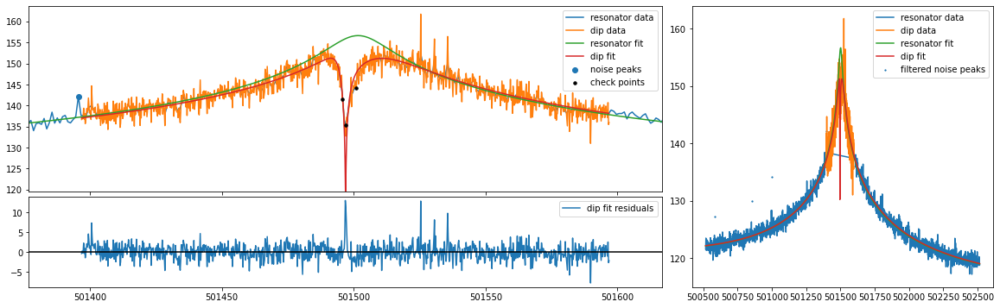

mean fit residuals = 9.9e-03 +/- 6.2e-02
{'A': 1327613674400854.5, 'dA': 51315686025657.06, 'Q': 12009.208046372763, 'dQ': 301.8156206254161, 'offset': 573254822331.9517, 'doffset': 16263634394.741331, 'slope': -0.001508768953457879, 'dslope': 3.668671311383058e-05, 'nu_res': 501505.1718389441, 'dnu_res': 0.4337922711127088, 'nu_z': 501496.90734158363, 'dnu_z': 0.021061780244780524, 'dip_width': 7.355464031893018, 'ddip_width': 0.3651425166198973, 'pcov': array([[ 4.435985870794e-04,  3.318968702182e-04,  4.326707249262e+08,
         2.733376107066e-03, -5.673672418273e-04],
       [ 3.318968702182e-04,  1.333290574435e-01,  8.498374757888e+12,
         5.245531233817e+01, -3.017058838421e-03],
       [ 4.326707249258e+08,  8.498374757888e+12,  2.633299632284e+27,
         1.436496897070e+16, -5.232770685462e+11],
       [ 2.733376107065e-03,  5.245531233817e+01,  1.436496897070e+16,
         9.109266885351e+04, -5.284887652985e+00],
       [-5.673672418273e-04, -3.017058838421e-03, -5

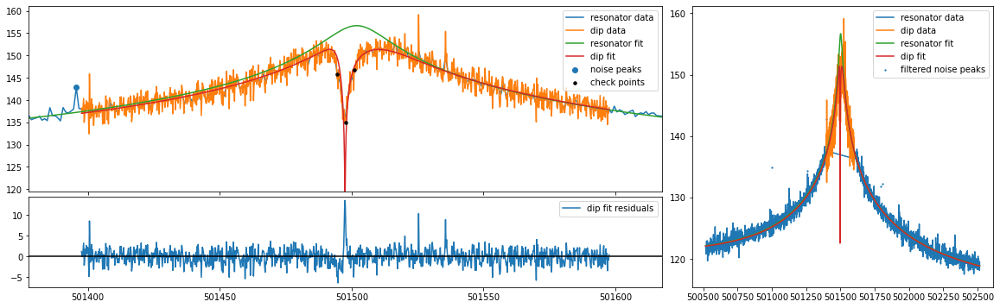

mean fit residuals = 1.0e-02 +/- 6.1e-02
{'A': 1365322023433608.8, 'dA': 51999894637957.06, 'Q': 12371.312415282646, 'dQ': 303.87688993362616, 'offset': 551034778075.9341, 'doffset': 15991156948.7582, 'slope': -0.0015745828331665387, 'dslope': 3.622676101744061e-05, 'nu_res': 501504.58477952983, 'dnu_res': 0.41347929760783364, 'nu_z': 501497.4891424173, 'dnu_z': 0.020006591548456742, 'dip_width': 7.285401327206399, 'ddip_width': 0.3534694093069037, 'pcov': array([[ 4.002637053868e-04,  2.649201425213e-04,  3.721963972295e+08,
         1.809771675955e-03, -5.082551014454e-04],
       [ 2.649201425213e-04,  1.249406233158e-01,  8.369512171768e+12,
         5.129283823709e+01, -2.284683253110e-03],
       [ 3.721963972288e+08,  8.369512171768e+12,  2.703989042359e+27,
         1.468592414094e+16, -4.249603076810e+11],
       [ 1.809771675950e-03,  5.129283823709e+01,  1.468592414094e+16,
         9.234116423573e+04, -4.088812374734e+00],
       [-5.082551014454e-04, -2.284683253111e-03, -

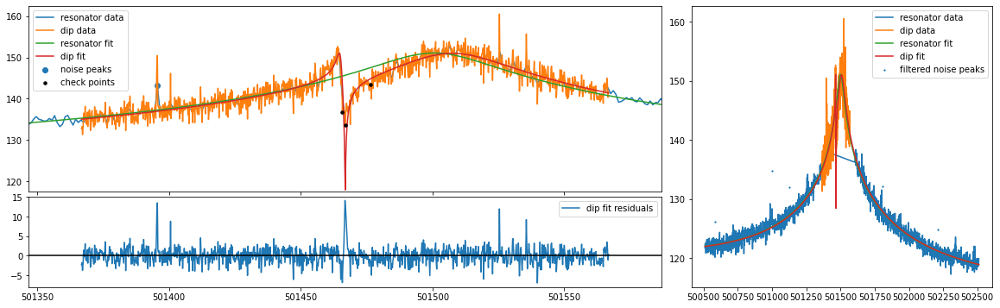

mean fit residuals = 1.5e-02 +/- 6.7e-02
{'A': 1261672576160334.8, 'dA': 51646263006474.875, 'Q': 11692.021914324523, 'dQ': 314.76730782640556, 'offset': 536519195831.98895, 'doffset': 16974223425.118162, 'slope': -0.0015116680204624179, 'dslope': 3.8331789234681795e-05, 'nu_res': 501505.3625971443, 'dnu_res': 0.5107745726611244, 'nu_z': 501466.8670276268, 'dnu_z': 0.02463760427824478, 'dip_width': 8.448346546054806, 'ddip_width': 0.4350917587570816, 'pcov': array([[ 6.070115445714e-04,  2.098526144572e-03,  1.244426754650e+09,
         2.103823360484e-02, -8.198620933553e-04],
       [ 2.098526144572e-03,  1.893048385383e-01,  1.042393125458e+13,
         6.677998591804e+01, -2.007205603495e-02],
       [ 1.244426754651e+09,  1.042393125458e+13,  2.667336482534e+27,
         1.496778497391e+16, -2.365344707740e+12],
       [ 2.103823360484e-02,  6.677998591804e+01,  1.496778497391e+16,
         9.907845807628e+04, -3.098322291595e+01],
       [-8.198620933553e-04, -2.007205603495e-02,

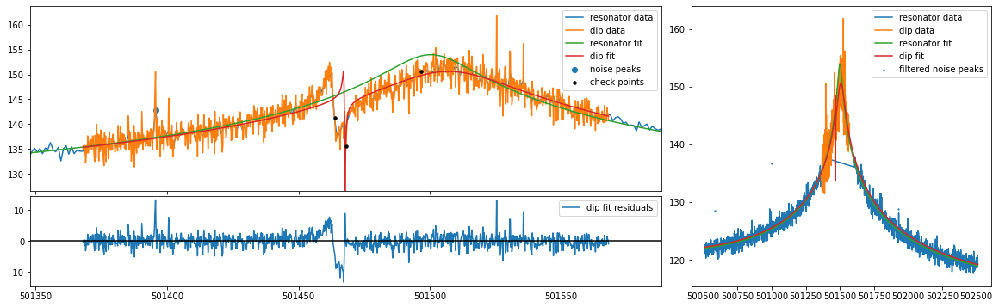

mean fit residuals = 1.3e-03 +/- 7.7e-02
{'A': 1150172675320833.5, 'dA': 52080502719868.82, 'Q': 10671.717177709903, 'dQ': 326.5282402834932, 'offset': 536879302026.6122, 'doffset': 16189984758.81609, 'slope': -0.0015056759520739307, 'dslope': 3.6847177805257125e-05, 'nu_res': 501506.6668147957, 'dnu_res': 0.628873582068637, 'nu_z': 501467.71371243976, 'dnu_z': 0.01912820712248531, 'dip_width': 2.000558844892241, 'ddip_width': 0.2161841964479671, 'pcov': array([[ 3.658883077207e-04,  9.077480624779e-04, -1.818172066458e+09,
        -1.796875915102e-02, -5.064048058715e-04],
       [ 9.077480624779e-04,  4.673560679385e-02,  2.762497105002e+12,
         1.812910859382e+01, -7.255112670930e-03],
       [-1.818172066458e+09,  2.762497105002e+12,  2.712378763554e+27,
         1.554240586427e+16, -3.184251987958e+12],
       [-1.796875915102e-02,  1.812910859382e+01,  1.554240586427e+16,
         1.066206917026e+05, -4.329495820847e+01],
       [-5.064048058715e-04, -7.255112670930e-03, -3.

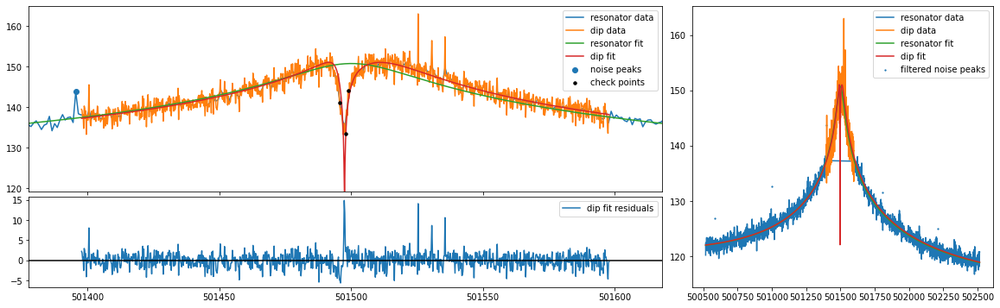

mean fit residuals = 1.1e-02 +/- 6.1e-02
{'A': 1261726909997851.8, 'dA': 46694291196240.22, 'Q': 11520.521037528373, 'dQ': 280.4345796294688, 'offset': 531749484907.8215, 'doffset': 16978365672.527384, 'slope': -0.001503244833120948, 'dslope': 3.858744887471316e-05, 'nu_res': 501505.26703394053, 'dnu_res': 0.43414359286008086, 'nu_z': 501497.49012730806, 'dnu_z': 0.02039538104994746, 'dip_width': 7.395709571947823, 'ddip_width': 0.3558183370892999, 'pcov': array([[ 4.159715681726e-04,  2.776725565137e-04,  2.993586870523e+08,
         1.429867369347e-03, -5.399464468085e-04],
       [ 2.776725565137e-04,  1.266066890090e-01,  7.485387167252e+12,
         4.720311479608e+01, -2.706695482489e-03],
       [ 2.993586870507e+08,  7.485387167252e+12,  2.180356830319e+27,
         1.211174055673e+16, -4.537466447672e+11],
       [ 1.429867369337e-03,  4.720311479608e+01,  1.211174055673e+16,
         7.864355345196e+04, -4.594915995204e+00],
       [-5.399464468085e-04, -2.706695482490e-03, -

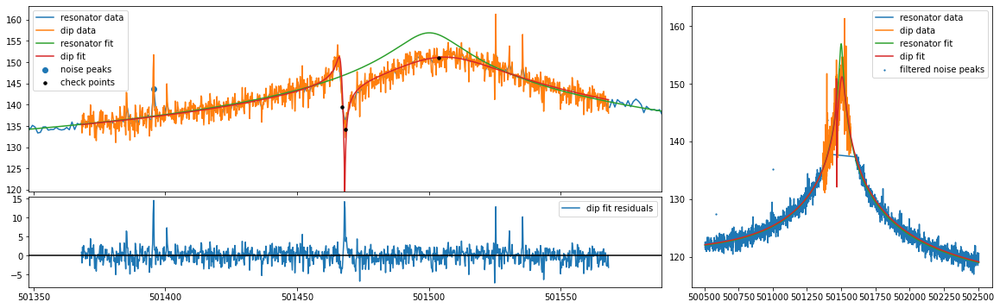

mean fit residuals = 1.1e-02 +/- 6.6e-02
{'A': 1318269459305353.5, 'dA': 53369635975008.97, 'Q': 11789.173924975636, 'dQ': 312.9464913640936, 'offset': 557276463233.5323, 'doffset': 16998683873.152346, 'slope': -0.0014883298059296091, 'dslope': 3.854800817752724e-05, 'nu_res': 501503.94913929165, 'dnu_res': 0.49378726178155713, 'nu_z': 501468.10089354723, 'dnu_z': 0.02236006654420139, 'dip_width': 7.507633724062021, 'ddip_width': 0.39758039828489417, 'pcov': array([[ 4.999725758611e-04,  1.691351562978e-03,  1.724000864800e+09,
         2.307490044320e-02, -6.723460749394e-04],
       [ 1.691351562978e-03,  1.580701731004e-01,  9.458686103376e+12,
         5.827393146310e+01, -1.579054883179e-02],
       [ 1.724000864800e+09,  9.458686103376e+12,  2.848318044105e+27,
         1.540344063374e+16, -2.216568965827e+12],
       [ 2.307490044320e-02,  5.827393146310e+01,  1.540344063374e+16,
         9.793550645710e+04, -2.737016764379e+01],
       [-6.723460749394e-04, -1.579054883179e-02,

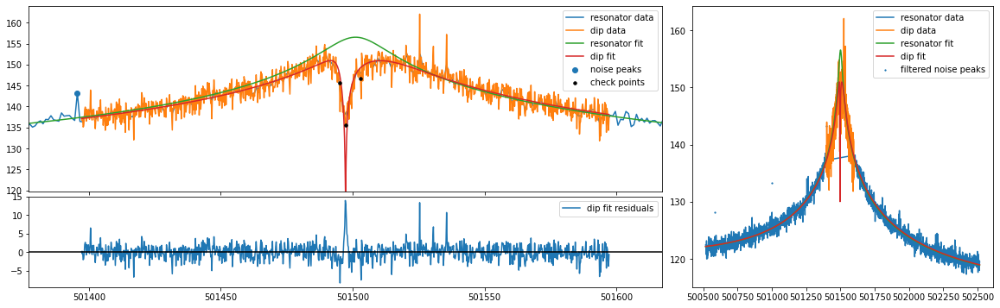

mean fit residuals = 1.0e-02 +/- 6.5e-02
{'A': 1241962676465820.0, 'dA': 49586553338425.99, 'Q': 11526.714173198487, 'dQ': 302.67306110234915, 'offset': 558331069554.9929, 'doffset': 17043091475.88722, 'slope': -0.0015568882665976704, 'dslope': 3.839561303217275e-05, 'nu_res': 501504.8819263579, 'dnu_res': 0.4681449976514534, 'nu_z': 501497.291333629, 'dnu_z': 0.02151740326512817, 'dip_width': 6.8353769929706925, 'ddip_width': 0.3659687125698406, 'pcov': array([[ 4.629986432741e-04,  3.059616267082e-04,  4.477081860682e+08,
         2.822783994162e-03, -6.005321530294e-04],
       [ 3.059616267082e-04,  1.339330985800e-01,  7.926479614758e+12,
         5.080627958131e+01, -2.983722742223e-03],
       [ 4.477081860689e+08,  7.926479614758e+12,  2.458826271985e+27,
         1.388218113668e+16, -5.346608288907e+11],
       [ 2.822783994166e-03,  5.080627958131e+01,  1.388218113668e+16,
         9.161098191707e+04, -5.494682196096e+00],
       [-6.005321530294e-04, -2.983722742223e-03, -5.

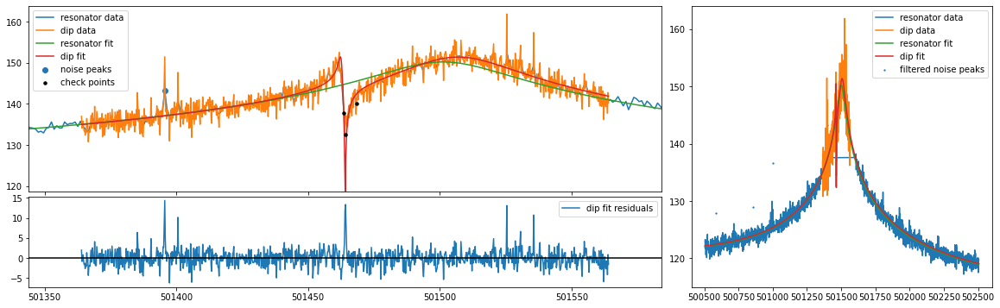

mean fit residuals = 1.0e-02 +/- 6.6e-02
{'A': 1373185408164714.2, 'dA': 56253315740703.97, 'Q': 12054.257036243582, 'dQ': 322.0814038658963, 'offset': 560013445789.7806, 'doffset': 16735674760.981842, 'slope': -0.0015471045134802797, 'dslope': 3.764978540517283e-05, 'nu_res': 501505.205944752, 'dnu_res': 0.49884703589475743, 'nu_z': 501464.0742374899, 'dnu_z': 0.022279284857635178, 'dip_width': 7.511719301336746, 'ddip_width': 0.40212813492380856, 'pcov': array([[ 4.963665337677e-04,  1.957429420543e-03,  1.880285858892e+09,
         2.617095232500e-02, -6.729978260412e-04],
       [ 1.957429420543e-03,  1.617070368973e-01,  1.005751964912e+13,
         6.050796583131e+01, -1.804686720499e-02],
       [ 1.880285858892e+09,  1.005751964912e+13,  3.164435531823e+27,
         1.670731550604e+16, -2.565837818406e+12],
       [ 2.617095232500e-02,  6.050796583131e+01,  1.670731550604e+16,
         1.037364307162e+05, -3.201626837461e+01],
       [-6.729978260412e-04, -1.804686720499e-02, -

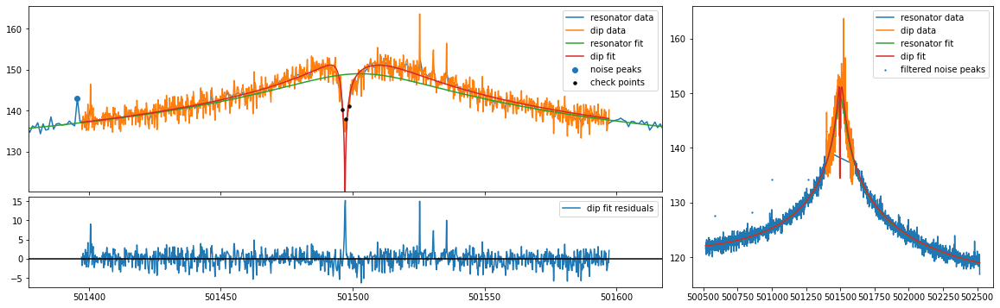

mean fit residuals = 9.3e-03 +/- 6.4e-02
{'A': 1296613733875770.2, 'dA': 50973822798957.445, 'Q': 11817.22189974692, 'dQ': 303.3666834918616, 'offset': 549520864281.3745, 'doffset': 15856560650.710537, 'slope': -0.0015030735959918702, 'dslope': 3.57588770841468e-05, 'nu_res': 501504.4259120379, 'dnu_res': 0.44845291872556453, 'nu_z': 501497.0947958869, 'dnu_z': 0.020340658236259315, 'dip_width': 6.599269759143934, 'ddip_width': 0.3491529000837436, 'pcov': array([[ 4.137423774843e-04,  2.703827561332e-04,  3.696863450692e+08,
         2.015408889101e-03, -5.333552290915e-04],
       [ 2.703827561332e-04,  1.219077476369e-01,  7.716721730300e+12,
         4.819473469733e+01, -2.500380366492e-03],
       [ 3.696863450691e+08,  7.716721730300e+12,  2.598330610740e+27,
         1.432824557174e+16, -4.840500642049e+11],
       [ 2.015408889100e-03,  4.819473469733e+01,  1.432824557174e+16,
         9.203134465285e+04, -4.822681313611e+00],
       [-5.333552290915e-04, -2.500380366491e-03, -4

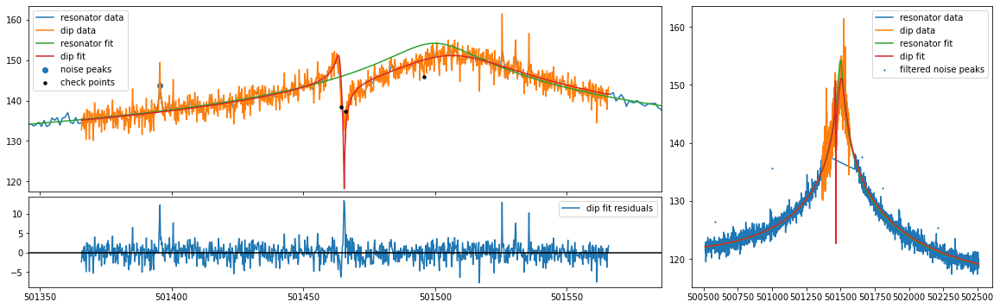

mean fit residuals = 1.4e-02 +/- 6.9e-02
{'A': 1300907012189382.8, 'dA': 55035788315655.42, 'Q': 11719.485467197648, 'dQ': 325.8524019451266, 'offset': 552106386817.668, 'doffset': 16562283902.17757, 'slope': -0.0014689148381051528, 'dslope': 3.7368743629982304e-05, 'nu_res': 501504.3506623106, 'dnu_res': 0.5263542007181936, 'nu_z': 501465.4626580176, 'dnu_z': 0.025428389286874218, 'dip_width': 8.345896030982056, 'ddip_width': 0.4461590037361801, 'pcov': array([[ 6.466029817248e-04,  2.250732076179e-03,  1.162310209562e+09,
         2.019435479693e-02, -8.708220650183e-04],
       [ 2.250732076179e-03,  1.990578566149e-01,  1.133729829028e+13,
         7.055763879026e+01, -2.113300211766e-02],
       [ 1.162310209563e+09,  1.133729829028e+13,  3.028937995526e+27,
         1.651490081400e+16, -2.587583266651e+12],
       [ 2.019435479693e-02,  7.055763879026e+01,  1.651490081400e+16,
         1.061797878534e+05, -3.295502224187e+01],
       [-8.708220650183e-04, -2.113300211766e-02, -2.

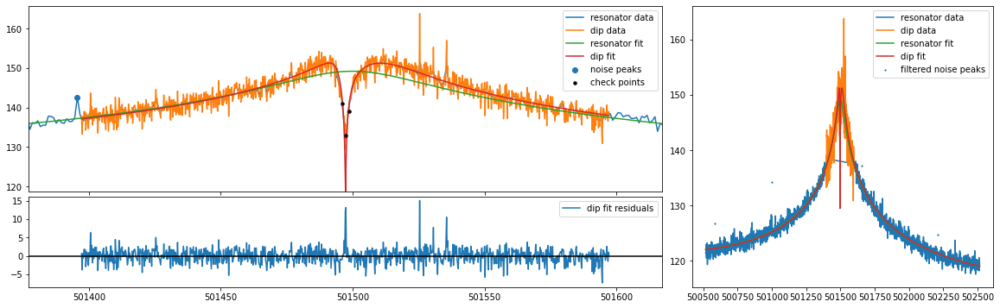

mean fit residuals = 1.0e-02 +/- 6.2e-02
{'A': 1329669847527893.0, 'dA': 51673176409199.25, 'Q': 12105.346597158401, 'dQ': 305.2037187116704, 'offset': 558132046027.4803, 'doffset': 16149029587.878048, 'slope': -0.001454883584455669, 'dslope': 3.6308155625318166e-05, 'nu_res': 501504.41749674216, 'dnu_res': 0.43209220634144946, 'nu_z': 501497.28181774507, 'dnu_z': 0.021640377184560224, 'dip_width': 7.823104542703093, 'ddip_width': 0.3802215479045471, 'pcov': array([[ 4.683059246900e-04,  2.876169104322e-04,  2.451580881288e+08,
         5.459843101146e-04, -5.973591632603e-04],
       [ 2.876169104322e-04,  1.445684254909e-01,  9.141987189124e+12,
         5.666197096692e+01, -2.733424355256e-03],
       [ 2.451580881281e+08,  9.141987189124e+12,  2.670117160216e+27,
         1.463577707982e+16, -4.572479238800e+11],
       [ 5.459843101108e-04,  5.666197096692e+01,  1.463577707982e+16,
         9.314930991543e+04, -4.546105563336e+00],
       [-5.973591632603e-04, -2.733424355257e-03,

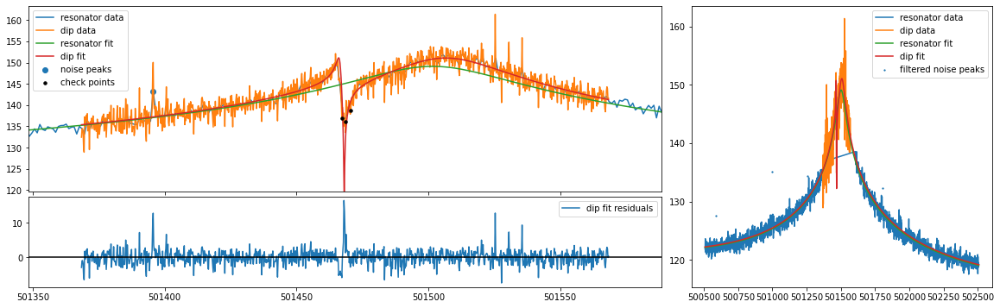

mean fit residuals = 1.2e-02 +/- 6.8e-02
{'A': 1280982788611463.5, 'dA': 52754195627815.1, 'Q': 11496.203991082159, 'dQ': 312.7350218437289, 'offset': 562978397410.722, 'doffset': 16803999128.62323, 'slope': -0.0015218282563674575, 'dslope': 3.7378198270609675e-05, 'nu_res': 501504.62052773824, 'dnu_res': 0.5184319353689413, 'nu_z': 501468.09196331585, 'dnu_z': 0.0229862837034596, 'dip_width': 7.382141978162727, 'ddip_width': 0.4042571705624887, 'pcov': array([[ 5.283692384959e-04,  1.773755269291e-03,  1.748863719861e+09,
         2.409121028353e-02, -7.179635644580e-04],
       [ 1.773755269291e-03,  1.634238599512e-01,  9.384038978260e+12,
         5.847986617304e+01, -1.716997832151e-02],
       [ 1.748863719861e+09,  9.384038978260e+12,  2.783005156338e+27,
         1.518297336868e+16, -2.380947691894e+12],
       [ 2.409121028352e-02,  5.847986617304e+01,  1.518297336868e+16,
         9.780319388760e+04, -2.986799603123e+01],
       [-7.179635644580e-04, -1.716997832151e-02, -2.3

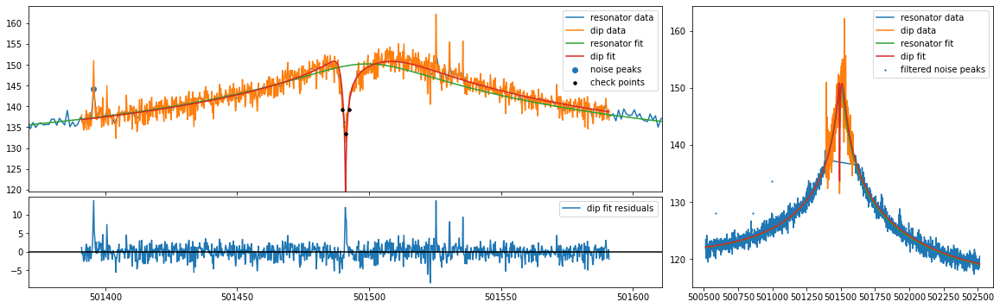

mean fit residuals = 8.5e-03 +/- 6.4e-02
{'A': 1203406323286792.2, 'dA': 46596841057284.27, 'Q': 11225.934058752071, 'dQ': 288.1716891479848, 'offset': 546211105984.65216, 'doffset': 16476436241.407331, 'slope': -0.0014511247202749554, 'dslope': 3.721540430145834e-05, 'nu_res': 501504.1049539759, 'dnu_res': 0.46994796589718135, 'nu_z': 501491.0895292278, 'dnu_z': 0.0211248583978637, 'dip_width': 6.820141150682537, 'ddip_width': 0.35849194097417275, 'pcov': array([[ 4.462596423298e-04,  5.094470636245e-04,  6.285589297934e+08,
         6.181683467716e-03, -5.861710302813e-04],
       [ 5.094470636245e-04,  1.285164717434e-01,  7.233550849562e+12,
         4.699602927269e+01, -5.090844316209e-03],
       [ 6.285589297931e+08,  7.233550849562e+12,  2.171265596518e+27,
         1.239284289448e+16, -8.108652152967e+11],
       [ 6.181683467714e-03,  4.699602927269e+01,  1.239284289448e+16,
         8.304292242640e+04, -9.250795433575e+00],
       [-5.861710302813e-04, -5.090844316209e-03, -

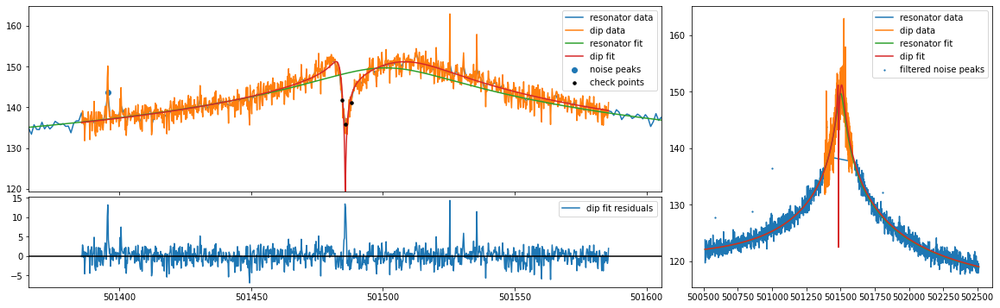

mean fit residuals = 1.1e-02 +/- 6.6e-02
{'A': 1310387695639578.2, 'dA': 53644791403990.93, 'Q': 11910.740032159309, 'dQ': 318.00434125284, 'offset': 556261778795.7456, 'doffset': 16607213744.75728, 'slope': -0.0015148200501053776, 'dslope': 3.7514257302989516e-05, 'nu_res': 501504.8807928132, 'dnu_res': 0.47025335026939935, 'nu_z': 501485.70840278367, 'dnu_z': 0.022400703167812865, 'dip_width': 7.40972031891533, 'ddip_width': 0.3914415521724048, 'pcov': array([[ 5.017915024125e-04,  9.032435339252e-04,  1.012477966618e+09,
         1.091441955936e-02, -6.498438987374e-04],
       [ 9.032435339252e-04,  1.532264887671e-01,  9.486185525075e+12,
         5.902790470639e+01, -8.139589489775e-03],
       [ 1.012477966618e+09,  9.486185525075e+12,  2.877763644778e+27,
         1.579956456287e+16, -1.239280920951e+12],
       [ 1.091441955936e-02,  5.902790470639e+01,  1.579956456287e+16,
         1.011267610557e+05, -1.409224693909e+01],
       [-6.498438987374e-04, -8.139589489774e-03, -1.

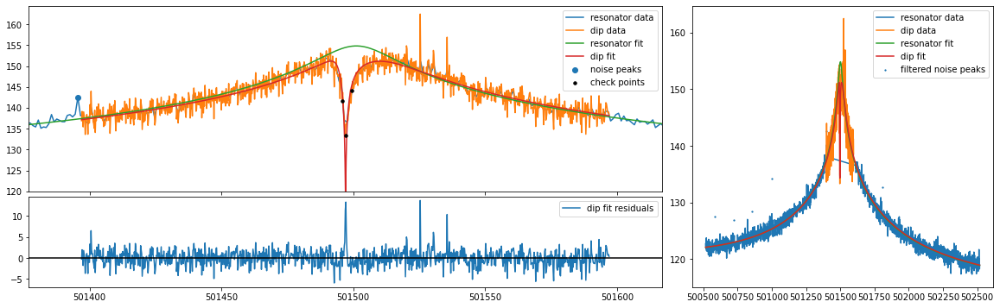

mean fit residuals = 8.4e-03 +/- 6.2e-02
{'A': 1306394278933145.5, 'dA': 49885327745488.24, 'Q': 11810.214448765912, 'dQ': 294.5398162875508, 'offset': 543339450572.9215, 'doffset': 15883808977.47152, 'slope': -0.0015230328084329097, 'dslope': 3.596927320421045e-05, 'nu_res': 501504.6309466416, 'dnu_res': 0.43599557804557004, 'nu_z': 501497.09193664626, 'dnu_z': 0.019861419371601664, 'dip_width': 6.740942787786399, 'ddip_width': 0.34359891272418397, 'pcov': array([[ 3.944759794546e-04,  2.691654786919e-04,  4.305253548317e+08,
         2.765264411720e-03, -5.089139920223e-04],
       [ 2.691654786919e-04,  1.180602128252e-01,  7.493247292599e+12,
         4.642857405387e+01, -2.540487217783e-03],
       [ 4.305253548315e+08,  7.493247292599e+12,  2.488545924275e+27,
         1.361359490506e+16, -4.832950295821e+11],
       [ 2.765264411719e-03,  4.642857405387e+01,  1.361359490506e+16,
         8.675370337870e+04, -4.814784981531e+00],
       [-5.089139920223e-04, -2.540487217782e-03, 

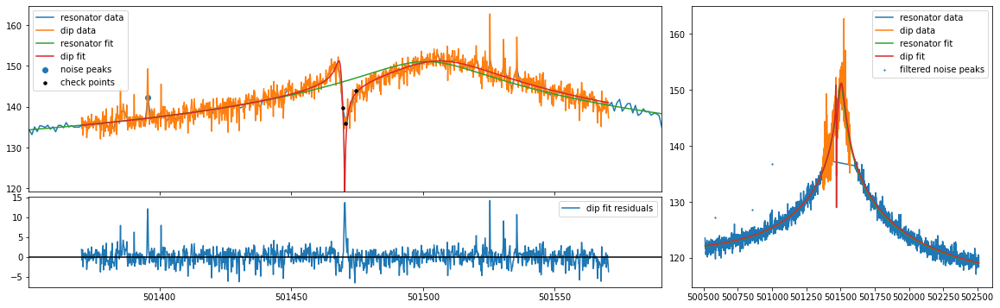

mean fit residuals = 1.1e-02 +/- 6.7e-02
{'A': 1320990342566206.2, 'dA': 54412395064234.39, 'Q': 11757.040654592563, 'dQ': 317.6687939500383, 'offset': 553765192854.4359, 'doffset': 16462625192.221355, 'slope': -0.0015152124593931842, 'dslope': 3.675799145821352e-05, 'nu_res': 501504.3615078732, 'dnu_res': 0.5003913118587411, 'nu_z': 501470.28537648846, 'dnu_z': 0.022629641434587698, 'dip_width': 7.471561338552937, 'ddip_width': 0.40283393353016617, 'pcov': array([[ 5.121006714580e-04,  1.636157930020e-03,  1.662214618184e+09,
         2.172560118881e-02, -6.859415412452e-04],
       [ 1.636157930020e-03,  1.622751780034e-01,  9.770093518773e+12,
         5.992521723307e+01, -1.545717974972e-02],
       [ 1.662214618185e+09,  9.770093518773e+12,  2.960708736626e+27,
         1.594689952459e+16, -2.208268615410e+12],
       [ 2.172560118881e-02,  5.992521723307e+01,  1.594689952459e+16,
         1.009134626497e+05, -2.682947595010e+01],
       [-6.859415412452e-04, -1.545717974972e-02, 

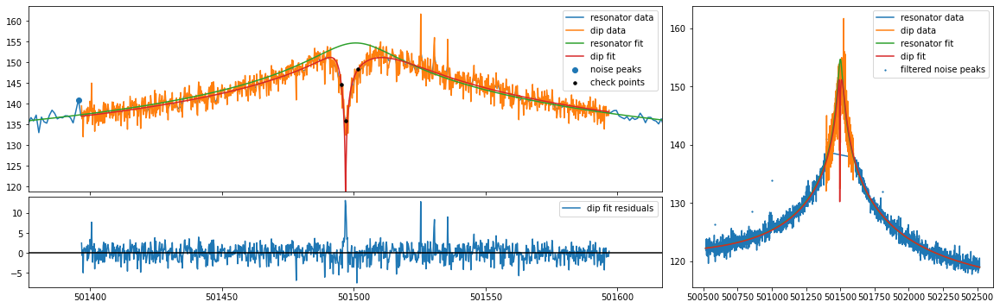

mean fit residuals = 1.1e-02 +/- 6.3e-02
{'A': 1304865944600079.0, 'dA': 51311144261537.47, 'Q': 11995.76207245433, 'dQ': 306.8141722400189, 'offset': 578601085654.826, 'doffset': 16192680077.08799, 'slope': -0.0015858511887224056, 'dslope': 3.626360176960174e-05, 'nu_res': 501504.9653917425, 'dnu_res': 0.4418487866633513, 'nu_z': 501496.91761618183, 'dnu_z': 0.022017778313967624, 'dip_width': 7.534912907320701, 'ddip_width': 0.37746664032661864, 'pcov': array([[ 4.847825618830e-04,  3.668192101109e-04,  6.296016960634e+08,
         4.586942911459e-03, -6.191462559970e-04],
       [ 3.668192101109e-04,  1.424810645595e-01,  8.859629064907e+12,
         5.560653579664e+01, -3.154568735731e-03],
       [ 6.296016960630e+08,  8.859629064907e+12,  2.632833525428e+27,
         1.460039697603e+16, -5.272384623340e+11],
       [ 4.586942911456e-03,  5.560653579664e+01,  1.460039697603e+16,
         9.413493628733e+04, -5.344435321657e+00],
       [-6.191462559970e-04, -3.154568735733e-03, -5.

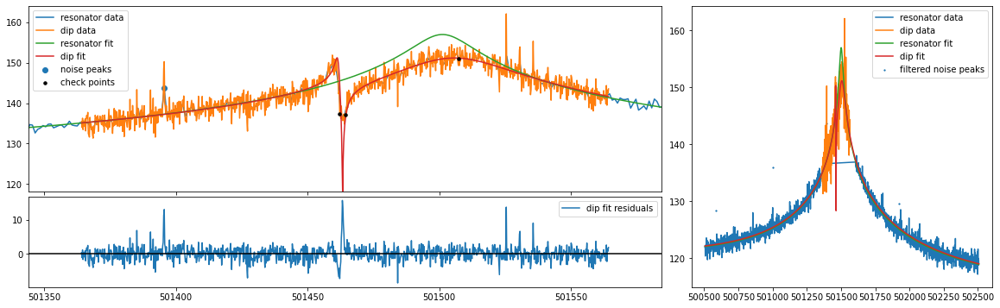

mean fit residuals = 1.5e-02 +/- 6.7e-02
{'A': 1315148379829855.0, 'dA': 54243162194300.64, 'Q': 11752.014443180818, 'dQ': 318.3608793625167, 'offset': 555347144545.2668, 'doffset': 16344917010.435637, 'slope': -0.0015544916938718485, 'dslope': 3.6973432074552935e-05, 'nu_res': 501503.771570134, 'dnu_res': 0.5138627970582325, 'nu_z': 501463.27362865926, 'dnu_z': 0.024145305547858868, 'dip_width': 8.240698318271106, 'ddip_width': 0.4318746755588738, 'pcov': array([[ 5.829957799995e-04,  2.164846846196e-03,  1.458441390662e+09,
         2.265005665769e-02, -7.889340403809e-04],
       [ 2.164846846196e-03,  1.865157353891e-01,  1.075110153418e+13,
         6.632912643491e+01, -2.030363105996e-02],
       [ 1.458441390662e+09,  1.075110153418e+13,  2.942320644837e+27,
         1.590088690253e+16, -2.536416566564e+12],
       [ 2.265005665769e-02,  6.632912643491e+01,  1.590088690253e+16,
         1.013536495085e+05, -3.216338302539e+01],
       [-7.889340403809e-04, -2.030363105996e-02, -

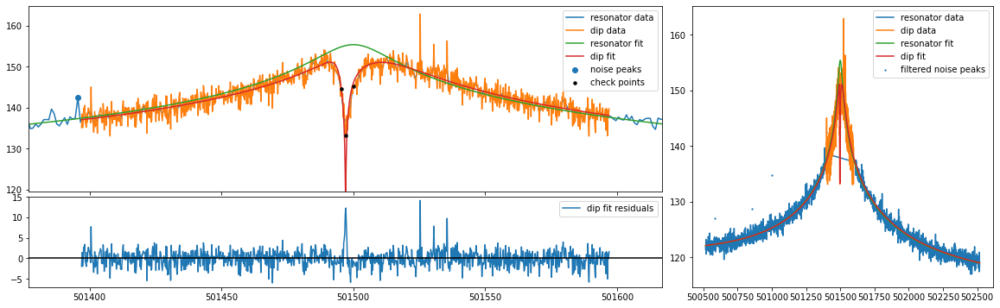

mean fit residuals = 9.8e-03 +/- 6.4e-02
{'A': 1281744844722983.8, 'dA': 50209383765304.58, 'Q': 11795.85701097371, 'dQ': 301.9443941587447, 'offset': 572207416400.4982, 'doffset': 16661350542.038206, 'slope': -0.0014996595991888855, 'dslope': 3.758339000451675e-05, 'nu_res': 501505.0887459268, 'dnu_res': 0.4481860872868278, 'nu_z': 501497.10485521756, 'dnu_z': 0.021738869968661437, 'dip_width': 7.3973460848201915, 'ddip_width': 0.3738946196973506, 'pcov': array([[ 4.725784675144e-04,  3.363266539665e-04,  4.552527315953e+08,
         2.977251129477e-03, -6.073810689243e-04],
       [ 3.363266539665e-04,  1.397971866386e-01,  8.496822269643e+12,
         5.364502359593e+01, -3.126522138116e-03],
       [ 4.552527315956e+08,  8.496822269643e+12,  2.520982218092e+27,
         1.404427964447e+16, -5.237788196155e+11],
       [ 2.977251129479e-03,  5.364502359593e+01,  1.404427964447e+16,
         9.117041716389e+04, -5.385244174697e+00],
       [-6.073810689243e-04, -3.126522138117e-03, -

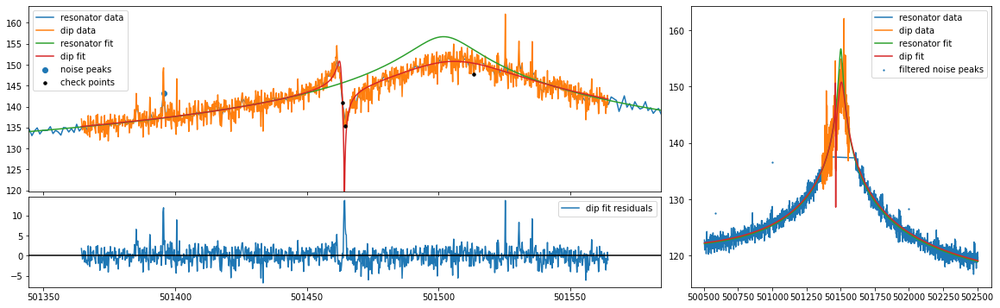

mean fit residuals = 1.1e-02 +/- 6.7e-02
{'A': 1198718845448607.0, 'dA': 47713372156942.37, 'Q': 11027.253433851209, 'dQ': 293.8140965290129, 'offset': 552526780711.5647, 'doffset': 16491313216.1091, 'slope': -0.0015783733193467772, 'dslope': 3.700806832838553e-05, 'nu_res': 501504.31531970866, 'dnu_res': 0.5361286153714314, 'nu_z': 501464.2993029274, 'dnu_z': 0.022402952532467532, 'dip_width': 7.038164437352257, 'ddip_width': 0.38679597028864715, 'pcov': array([[ 5.018922821720e-04,  1.775856889641e-03,  1.708487319912e+09,
         2.600382528446e-02, -7.033738102664e-04],
       [ 1.775856889641e-03,  1.496111226315e-01,  7.860653978616e+12,
         5.092899956806e+01, -1.847850656030e-02],
       [ 1.708487319912e+09,  7.860653978616e+12,  2.276565882587e+27,
         1.283812399541e+16, -2.477748076293e+12],
       [ 2.600382528446e-02,  5.092899956806e+01,  1.283812399541e+16,
         8.632672331916e+04, -3.332157850205e+01],
       [-7.033738102664e-04, -1.847850656030e-02, -2

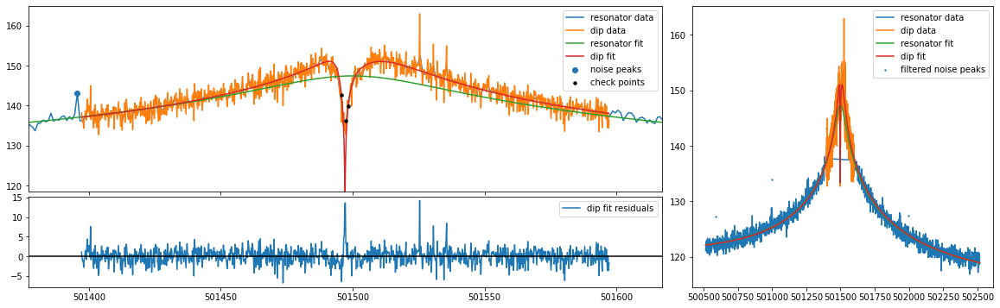

mean fit residuals = 1.1e-02 +/- 6.4e-02
{'A': 1269197697825857.2, 'dA': 49752488518342.66, 'Q': 11737.633327266698, 'dQ': 301.0760706202527, 'offset': 561499836051.9045, 'doffset': 16923384325.207329, 'slope': -0.0015510179122219866, 'dslope': 3.778081160097203e-05, 'nu_res': 501504.8089398844, 'dnu_res': 0.4507818726294288, 'nu_z': 501497.078859328, 'dnu_z': 0.022177541272126945, 'dip_width': 7.62917789251023, 'ddip_width': 0.38207779743985065, 'pcov': array([[ 4.918433368769e-04,  3.152978991332e-04,  2.172205689410e+08,
         1.463992018111e-04, -6.329403560185e-04],
       [ 3.152978991332e-04,  1.459834432965e-01,  8.696265016474e+12,
         5.525722844099e+01, -3.062831068207e-03],
       [ 2.172205689413e+08,  8.696265016474e+12,  2.475310113768e+27,
         1.387206678680e+16, -5.018850745996e+11],
       [ 1.463992018125e-04,  5.525722844099e+01,  1.387206678680e+16,
         9.064680030013e+04, -5.106380574677e+00],
       [-6.329403560185e-04, -3.062831068207e-03, -5.

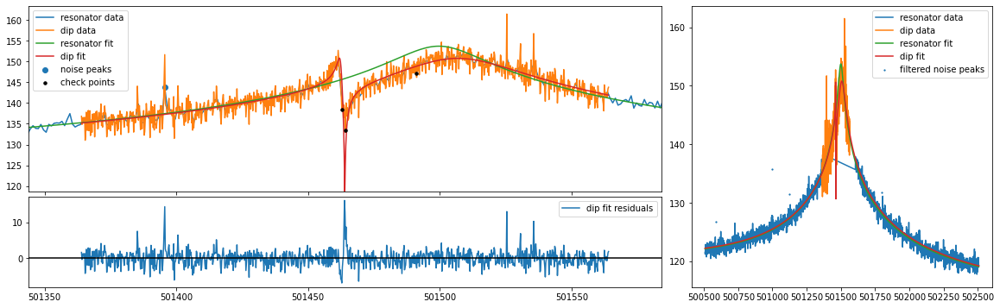

mean fit residuals = 1.3e-02 +/- 6.8e-02
{'A': 1198941360303946.5, 'dA': 48586261979624.16, 'Q': 11036.160924997068, 'dQ': 299.4028949847372, 'offset': 561928018426.0967, 'doffset': 16587749633.865425, 'slope': -0.0015020685956803627, 'dslope': 3.678776488108677e-05, 'nu_res': 501504.84951990866, 'dnu_res': 0.5483258020152136, 'nu_z': 501463.91313750076, 'dnu_z': 0.02415228754785596, 'dip_width': 7.673775136728508, 'ddip_width': 0.4160565098151631, 'pcov': array([[ 5.833329937943e-04,  2.130135684980e-03,  2.150332361483e+09,
         3.295488645508e-02, -8.199481201072e-04],
       [ 2.130135684980e-03,  1.731030193596e-01,  8.886329532518e+12,
         5.763916386946e+01, -2.151804662907e-02],
       [ 2.150332361483e+09,  8.886329532518e+12,  2.360624853153e+27,
         1.331564788848e+16, -2.609835331122e+12],
       [ 3.295488645508e-02,  5.763916386946e+01,  1.331564788848e+16,
         8.964209352524e+04, -3.550581671745e+01],
       [-8.199481201072e-04, -2.151804662907e-02, -

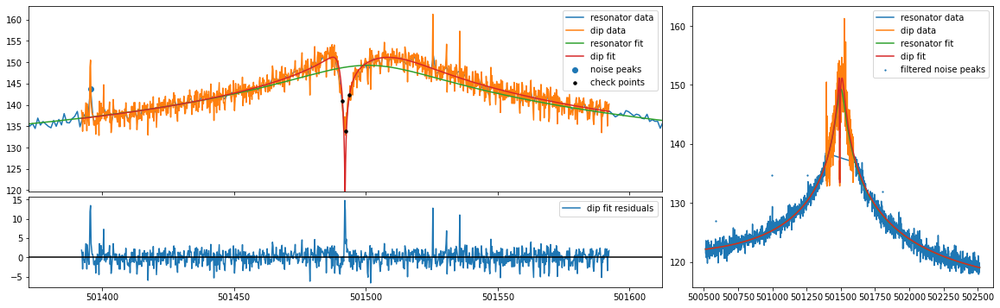

mean fit residuals = 1.1e-02 +/- 6.6e-02
{'A': 1305055677539348.0, 'dA': 52812295896732.61, 'Q': 11868.050891081502, 'dQ': 313.3394182656774, 'offset': 568657412519.214, 'doffset': 16926277395.752268, 'slope': -0.0015199543952615561, 'dslope': 3.752153750091572e-05, 'nu_res': 501503.88695762714, 'dnu_res': 0.4614115732853403, 'nu_z': 501492.10626416374, 'dnu_z': 0.02186993496712356, 'dip_width': 7.133299469124261, 'ddip_width': 0.3771325509387102, 'pcov': array([[ 4.782940554662e-04,  5.122067994814e-04,  5.529353422469e+08,
         4.494158781784e-03, -6.153221483439e-04],
       [ 5.122067994814e-04,  1.422289609775e-01,  8.893416762369e+12,
         5.538397131100e+01, -4.626771283269e-03],
       [ 5.529353422467e+08,  8.893416762369e+12,  2.789138597884e+27,
         1.533348035654e+16, -7.721146075672e+11],
       [ 4.494158781783e-03,  5.538397131100e+01,  1.533348035654e+16,
         9.818159103907e+04, -8.266908874655e+00],
       [-6.153221483439e-04, -4.626771283269e-03, -7

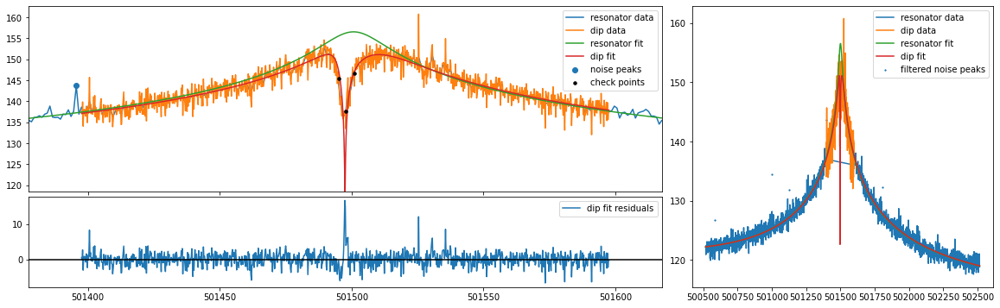

mean fit residuals = 1.5e-02 +/- 6.5e-02
{'A': 1293473649325469.0, 'dA': 52114830021641.19, 'Q': 11966.776310662615, 'dQ': 313.81679076577154, 'offset': 589468650732.8213, 'doffset': 17161232025.49478, 'slope': -0.0015528985346857107, 'dslope': 3.851674725136551e-05, 'nu_res': 501504.005999692, 'dnu_res': 0.45345826453903987, 'nu_z': 501497.477415442, 'dnu_z': 0.02318262875729152, 'dip_width': 7.841390766612443, 'ddip_width': 0.3968433007031578, 'pcov': array([[ 5.374342760984e-04,  2.778564702824e-04,  6.023403152485e+07,
        -2.054871660911e-03, -6.859522505916e-04],
       [ 2.778564702824e-04,  1.574846053130e-01,  9.600415263458e+12,
         6.069290742732e+01, -2.678846734494e-03],
       [ 6.023403152435e+07,  9.600415263458e+12,  2.715955508185e+27,
         1.516565743495e+16, -4.503076416291e+11],
       [-2.054871660915e-03,  6.069290742732e+01,  1.516565743495e+16,
         9.848097816653e+04, -4.401337978195e+00],
       [-6.859522505916e-04, -2.678846734494e-03, -4.5

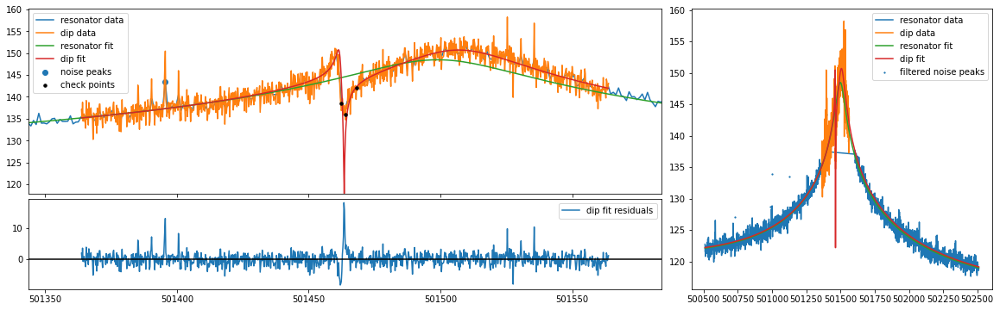

mean fit residuals = 1.8e-02 +/- 6.8e-02
{'A': 1178581345562257.8, 'dA': 47881283227319.555, 'Q': 10915.676322168343, 'dQ': 297.9090033195974, 'offset': 548198100888.36365, 'doffset': 16770368918.368084, 'slope': -0.0015136307493475792, 'dslope': 3.725508625539984e-05, 'nu_res': 501504.84918255906, 'dnu_res': 0.5579014463034223, 'nu_z': 501463.47073156876, 'dnu_z': 0.025044721686854572, 'dip_width': 8.062915861090284, 'ddip_width': 0.43119641609875997, 'pcov': array([[ 6.272380843720e-04,  2.191146344235e-03,  1.325173764821e+09,
         2.472555748749e-02, -8.793575687798e-04],
       [ 2.191146344235e-03,  1.859303492564e-01,  9.236718723534e+12,
         6.049359609113e+01, -2.326654817167e-02],
       [ 1.325173764821e+09,  9.236718723534e+12,  2.292617283495e+27,
         1.304278871451e+16, -2.648960784825e+12],
       [ 2.472555748749e-02,  6.049359609113e+01,  1.304278871451e+16,
         8.874977425888e+04, -3.652454043369e+01],
       [-8.793575687798e-04, -2.326654817167e-0

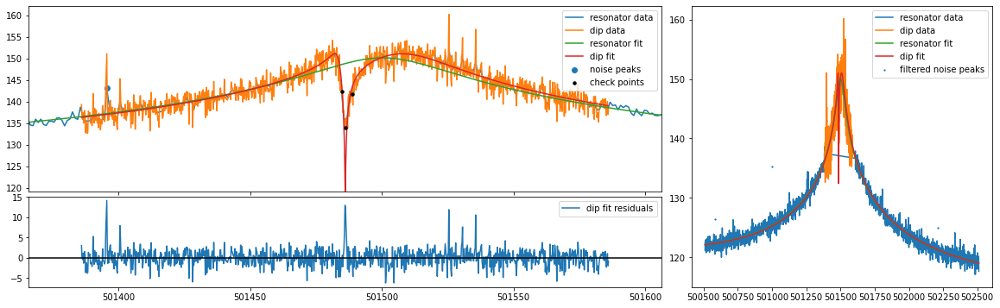

mean fit residuals = 1.2e-02 +/- 6.7e-02
{'A': 1276163621680394.8, 'dA': 52635786302796.61, 'Q': 11863.021144395994, 'dQ': 319.45513636559906, 'offset': 566345887465.9243, 'doffset': 16692705196.681639, 'slope': -0.0015195966730902142, 'dslope': 3.73258206189404e-05, 'nu_res': 501503.8414831373, 'dnu_res': 0.4747911164385352, 'nu_z': 501486.09134425904, 'dnu_z': 0.023690531097981176, 'dip_width': 7.975881547773886, 'ddip_width': 0.4134012460144799, 'pcov': array([[ 5.612412637044e-04,  9.187647667736e-04,  9.297875036747e+08,
         9.977903884792e-03, -7.250826640469e-04],
       [ 9.187647667736e-04,  1.709005902063e-01,  1.010408482062e+13,
         6.438952755632e+01, -8.300521977562e-03],
       [ 9.297875036752e+08,  1.010408482062e+13,  2.770525999714e+27,
         1.557082710944e+16, -1.150941627399e+12],
       [ 9.977903884795e-03,  6.438952755632e+01,  1.557082710944e+16,
         1.020515841504e+05, -1.328152995697e+01],
       [-7.250826640469e-04, -8.300521977562e-03, -

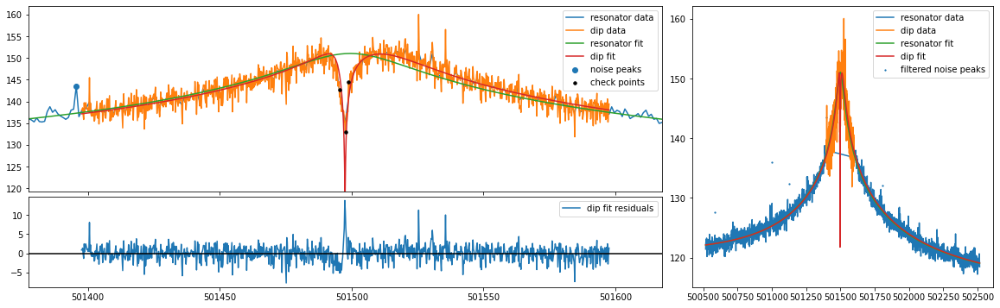

mean fit residuals = 1.1e-02 +/- 6.5e-02
{'A': 1240265002870549.8, 'dA': 49541887979696.92, 'Q': 11573.834858554213, 'dQ': 303.7359798315578, 'offset': 575908827020.6571, 'doffset': 16887119830.962084, 'slope': -0.0014659463585753032, 'dslope': 3.7702067185331706e-05, 'nu_res': 501504.73717224493, 'dnu_res': 0.4663089693377131, 'nu_z': 501497.4934291988, 'dnu_z': 0.023079158031833396, 'dip_width': 7.732585006949385, 'ddip_width': 0.39472529502947834, 'pcov': array([[ 5.326475354583e-04,  3.265560911382e-04,  3.405461108524e+08,
         1.504733239423e-03, -6.876051418892e-04],
       [ 3.265560911382e-04,  1.558080585361e-01,  8.962397344104e+12,
         5.771494180206e+01, -3.123966579967e-03],
       [ 3.405461108534e+08,  8.962397344104e+12,  2.454398664593e+27,
         1.392186713995e+16, -4.931701857073e+11],
       [ 1.504733239429e-03,  5.771494180206e+01,  1.392186713995e+16,
         9.225554544424e+04, -5.077701305192e+00],
       [-6.876051418892e-04, -3.123966579965e-03,

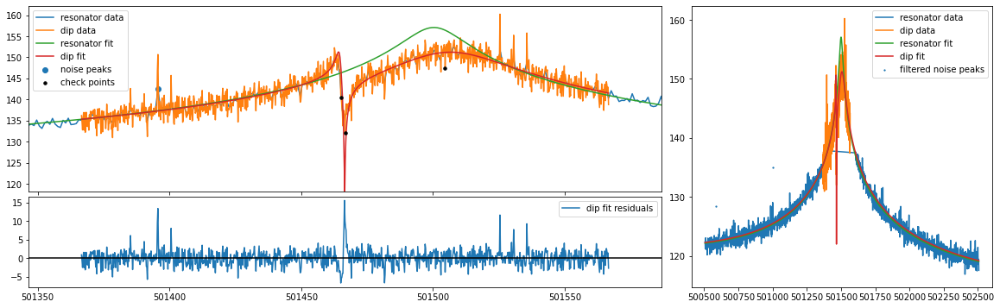

mean fit residuals = 1.4e-02 +/- 6.7e-02
{'A': 1325413309022302.8, 'dA': 54142991759046.31, 'Q': 11671.190761374763, 'dQ': 313.69212369627525, 'offset': 583575384860.3843, 'doffset': 17083815038.95334, 'slope': -0.0015282764114390136, 'dslope': 3.8004074268682835e-05, 'nu_res': 501504.3793432262, 'dnu_res': 0.5090165927637562, 'nu_z': 501466.4758797839, 'dnu_z': 0.024913534888770794, 'dip_width': 8.638517297315898, 'ddip_width': 0.44048645324405544, 'pcov': array([[ 6.206842206540e-04,  2.129148265233e-03,  1.513385130694e+09,
         2.292878252163e-02, -8.372405364005e-04],
       [ 2.129148265233e-03,  1.940283154915e-01,  1.115694675341e+13,
         6.795522163523e+01, -2.011737578720e-02],
       [ 1.513385130695e+09,  1.115694675341e+13,  2.931463556620e+27,
         1.563964638688e+16, -2.440432829831e+12],
       [ 2.292878252163e-02,  6.795522163523e+01,  1.563964638688e+16,
         9.840274846908e+04, -3.020994466355e+01],
       [-8.372405364005e-04, -2.011737578720e-02, 

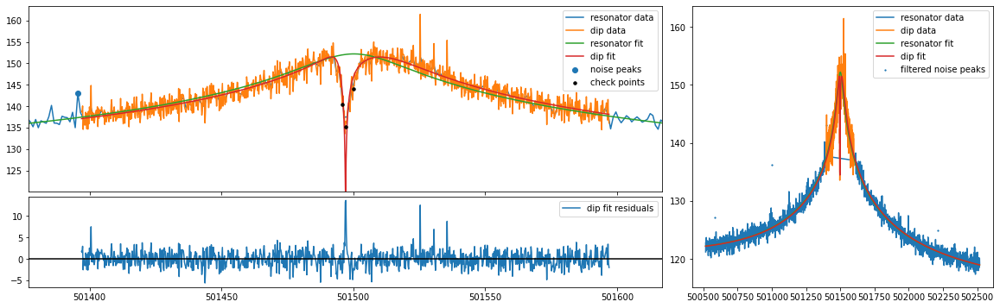

mean fit residuals = 9.6e-03 +/- 6.0e-02
{'A': 1404142389008603.8, 'dA': 52542409681246.98, 'Q': 12341.567327594697, 'dQ': 298.0268452206019, 'offset': 564096933710.3066, 'doffset': 16975441114.32926, 'slope': -0.0015638366175978323, 'dslope': 3.798869408850242e-05, 'nu_res': 501504.9201327473, 'dnu_res': 0.40748506695027803, 'nu_z': 501497.09161256615, 'dnu_z': 0.019115494537074854, 'dip_width': 6.869190504048343, 'ddip_width': 0.3351647173772534, 'pcov': array([[ 3.654021313969e-04,  2.720798843152e-04,  4.493561110554e+08,
         2.796179449886e-03, -4.651000737715e-04],
       [ 2.720798843152e-04,  1.123353877746e-01,  7.834976560507e+12,
         4.660204078631e+01, -2.365755008150e-03],
       [ 4.493561110538e+08,  7.834976560507e+12,  2.760704815112e+27,
         1.455092699608e+16, -4.694476370306e+11],
       [ 2.796179449876e-03,  4.660204078631e+01,  1.455092699608e+16,
         8.882000047214e+04, -4.496452526861e+00],
       [-4.651000737715e-04, -2.365755008151e-03, -

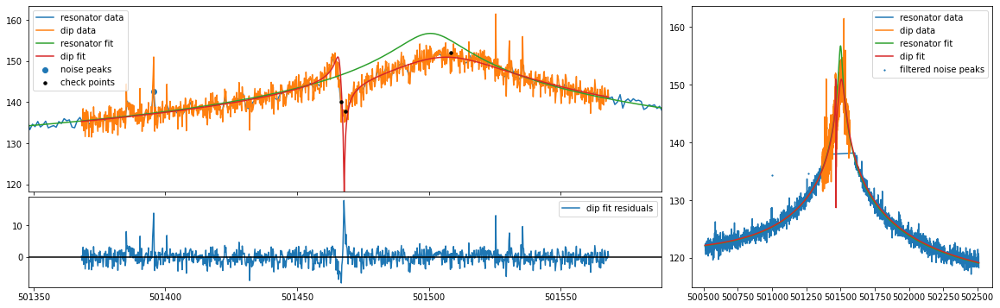

mean fit residuals = 1.7e-02 +/- 7.1e-02
{'A': 1249293263913575.8, 'dA': 53829032263219.13, 'Q': 11453.272695537808, 'dQ': 326.40230441244296, 'offset': 572882688369.2509, 'doffset': 16465215078.335653, 'slope': -0.0014866042978510772, 'dslope': 3.659693373577183e-05, 'nu_res': 501504.38621394616, 'dnu_res': 0.545129659989726, 'nu_z': 501467.87886328716, 'dnu_z': 0.026484409791836843, 'dip_width': 8.499606766033999, 'ddip_width': 0.46238557893007687, 'pcov': array([[ 7.014239620219e-04,  2.279146664962e-03,  1.600546023200e+09,
         2.494599166000e-02, -9.482350584062e-04],
       [ 2.279146664962e-03,  2.138004236025e-01,  1.154520059900e+13,
         7.361881064085e+01, -2.187883145979e-02],
       [ 1.600546023200e+09,  1.154520059900e+13,  2.897564714395e+27,
         1.616316470918e+16, -2.558012268705e+12],
       [ 2.494599166000e-02,  7.361881064085e+01,  1.616316470918e+16,
         1.065384643258e+05, -3.289433152557e+01],
       [-9.482350584062e-04, -2.187883145979e-02,

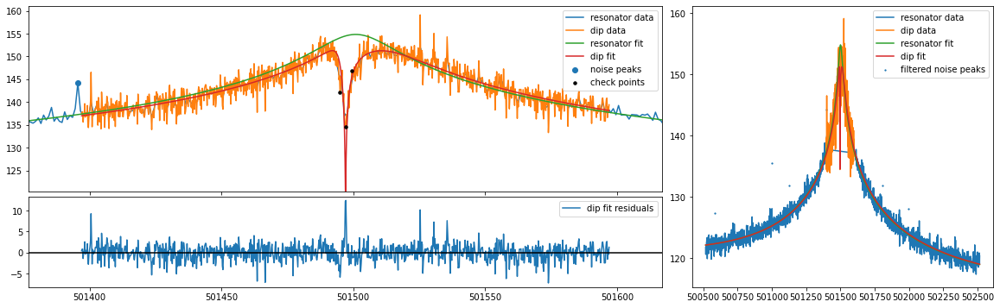

mean fit residuals = 8.4e-03 +/- 6.3e-02
{'A': 1333168667817219.2, 'dA': 51962453156068.88, 'Q': 12066.979094513192, 'dQ': 305.39006662232117, 'offset': 572482776350.7915, 'doffset': 16385269885.447102, 'slope': -0.0015214424870302636, 'dslope': 3.687171247115899e-05, 'nu_res': 501505.7562211758, 'dnu_res': 0.4351628250459489, 'nu_z': 501497.09352695075, 'dnu_z': 0.0199527055535352, 'dip_width': 6.525307551413285, 'ddip_width': 0.3414255138667043, 'pcov': array([[ 3.981104589061e-04,  3.209946999221e-04,  4.831667460279e+08,
         3.386447599679e-03, -5.099603390074e-04],
       [ 3.209946999221e-04,  1.165713815191e-01,  7.690666963596e+12,
         4.741969143792e+01, -2.832040038552e-03],
       [ 4.831667460276e+08,  7.690666963596e+12,  2.700096537997e+27,
         1.472318208576e+16, -5.496437223083e+11],
       [ 3.386447599677e-03,  4.741969143792e+01,  1.472318208576e+16,
         9.326309279159e+04, -5.578759818984e+00],
       [-5.099603390074e-04, -2.832040038552e-03, -5

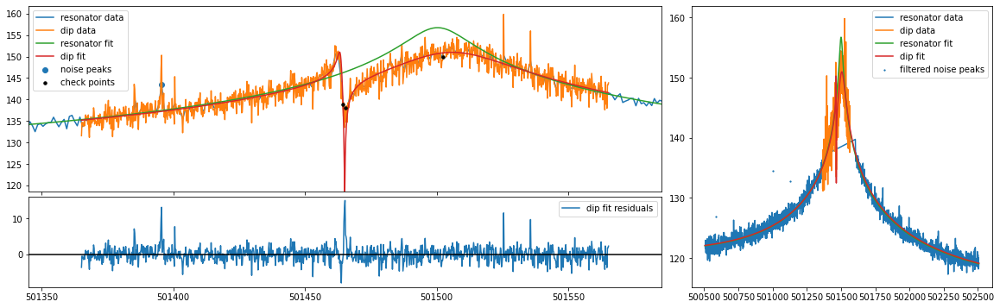

mean fit residuals = 1.2e-02 +/- 6.6e-02
{'A': 1257347074870008.0, 'dA': 50435766919325.78, 'Q': 11442.807773479066, 'dQ': 303.7704668991164, 'offset': 549366996972.7866, 'doffset': 16441107813.555418, 'slope': -0.0014784273885056689, 'dslope': 3.6722641066991916e-05, 'nu_res': 501504.051005331, 'dnu_res': 0.5139095532494402, 'nu_z': 501465.0726415044, 'dnu_z': 0.022190714970432658, 'dip_width': 7.168659997696105, 'ddip_width': 0.3887198944168036, 'pcov': array([[ 4.924278308990e-04,  1.745521256078e-03,  1.604085656868e+09,
         2.363660413227e-02, -6.757263461375e-04],
       [ 1.745521256078e-03,  1.511031563154e-01,  8.488771503881e+12,
         5.376517202752e+01, -1.722269278142e-02],
       [ 1.604085656868e+09,  8.488771503881e+12,  2.543766584741e+27,
         1.408058978815e+16, -2.379856543273e+12],
       [ 2.363660413227e-02,  5.376517202752e+01,  1.408058978815e+16,
         9.227649656011e+04, -3.096635230326e+01],
       [-6.757263461375e-04, -1.722269278142e-02, -2

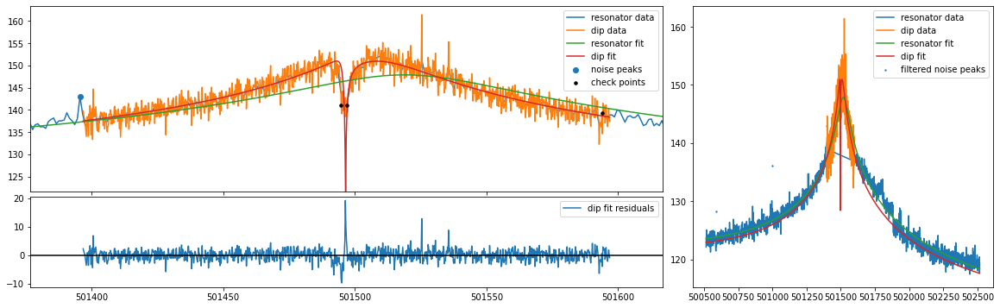

mean fit residuals = 2.2e-03 +/- 6.6e-02
{'A': 1242514685201536.5, 'dA': 49080632059027.016, 'Q': 11065.514820352235, 'dQ': 290.7259759278643, 'offset': 439477273473.7114, 'doffset': 24479344378.876835, 'slope': -0.0026286062604742033, 'dslope': 4.618150092360044e-05, 'nu_res': 501505.12158850906, 'dnu_res': 0.48371618495798796, 'nu_z': 501496.46747547435, 'dnu_z': 0.016235249744753787, 'dip_width': 3.5642562997556273, 'ddip_width': 0.2509875334619117, 'pcov': array([[ 2.635833342745e-04,  4.748755661488e-04,  3.422102957915e+09,
         3.334996137284e-02, -3.575357944785e-04],
       [ 4.748755661488e-04,  6.299474195329e-02,  4.063904694190e+12,
         2.526170114255e+01, -2.212591122658e-03],
       [ 3.422102957915e+09,  4.063904694190e+12,  2.408908443314e+27,
         1.316388961198e+16, -6.868276468879e+11],
       [ 3.334996137284e-02,  2.526170114255e+01,  1.316388961198e+16,
         8.452159307921e+04, -6.226264233618e+00],
       [-3.575357944785e-04, -2.212591122658e-0

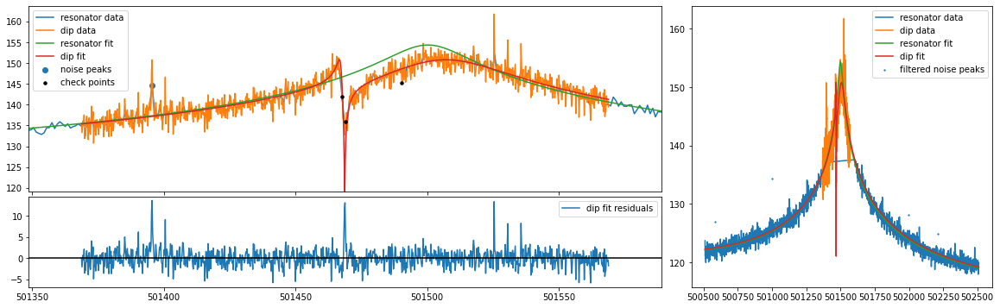

mean fit residuals = 1.0e-02 +/- 6.6e-02
{'A': 1199744123514409.8, 'dA': 47477930904379.984, 'Q': 11140.154412861766, 'dQ': 293.9838243065286, 'offset': 571052095418.767, 'doffset': 16489222919.162775, 'slope': -0.0015022681813081375, 'dslope': 3.6767707630456864e-05, 'nu_res': 501505.12628838664, 'dnu_res': 0.5172907147039103, 'nu_z': 501468.6793100437, 'dnu_z': 0.02210409954235184, 'dip_width': 6.88638856379855, 'ddip_width': 0.377066078411695, 'pcov': array([[ 4.885912165782e-04,  1.583409904570e-03,  1.543820604379e+09,
         2.250365287037e-02, -6.719981911499e-04],
       [ 1.583409904570e-03,  1.421788274888e-01,  7.605592314087e+12,
         4.954253894190e+01, -1.585969476762e-02],
       [ 1.543820604380e+09,  7.605592314087e+12,  2.254153922961e+27,
         1.281156535392e+16, -2.203954471577e+12],
       [ 2.250365287037e-02,  4.954253894190e+01,  1.281156535392e+16,
         8.642648895389e+04, -2.901898288228e+01],
       [-6.719981911499e-04, -1.585969476762e-02, -2.

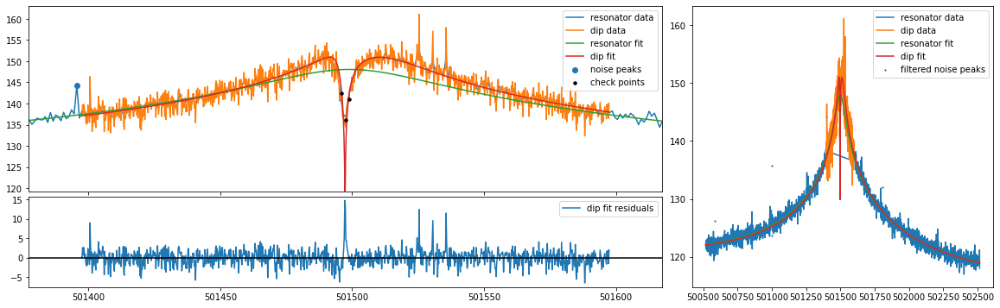

mean fit residuals = 1.1e-02 +/- 6.5e-02
{'A': 1249627146122932.0, 'dA': 50254333480051.9, 'Q': 11694.219055862563, 'dQ': 308.03575614649833, 'offset': 552719172703.045, 'doffset': 17026675932.250017, 'slope': -0.0015259427641625975, 'dslope': 3.783055799111586e-05, 'nu_res': 501504.82421214465, 'dnu_res': 0.464163228678819, 'nu_z': 501497.2858480217, 'dnu_z': 0.021887043452043165, 'dip_width': 7.10731034421881, 'ddip_width': 0.3755876257686232, 'pcov': array([[ 4.790426710716e-04,  3.162407235993e-04,  3.970511949783e+08,
         2.188008582599e-03, -6.180600546575e-04],
       [ 3.162407235993e-04,  1.410660646305e-01,  8.397558150331e+12,
         5.404296579930e+01, -2.966771735785e-03],
       [ 3.970511949769e+08,  8.397558150331e+12,  2.525498033524e+27,
         1.433263117296e+16, -5.123092400196e+11],
       [ 2.188008582589e-03,  5.404296579930e+01,  1.433263117296e+16,
         9.488602706474e+04, -5.271122584350e+00],
       [-6.180600546575e-04, -2.966771735787e-03, -5.1

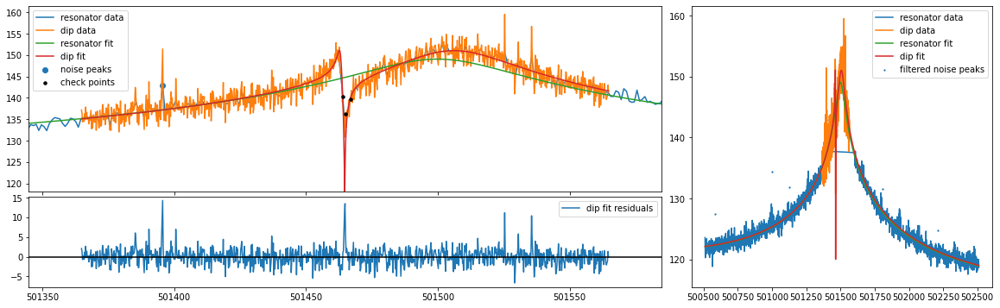

mean fit residuals = 1.1e-02 +/- 6.6e-02
{'A': 1267638700314744.5, 'dA': 50641757800345.4, 'Q': 11574.586654394172, 'dQ': 305.0418168775635, 'offset': 553523643190.4698, 'doffset': 16694529835.935764, 'slope': -0.0015319279808166093, 'dslope': 3.744956594481126e-05, 'nu_res': 501504.2335442662, 'dnu_res': 0.5064124254743148, 'nu_z': 501464.66892015794, 'dnu_z': 0.02288039533530381, 'dip_width': 7.6416326308702125, 'ddip_width': 0.401254906283519, 'pcov': array([[ 5.235124906998e-04,  1.873039436954e-03,  1.415812045054e+09,
         2.205481347183e-02, -7.136626267416e-04],
       [ 1.873039436954e-03,  1.610054998166e-01,  9.034694491818e+12,
         5.722249200826e+01, -1.810296236003e-02],
       [ 1.415812045054e+09,  9.034694491818e+12,  2.564587633109e+27,
         1.420727169872e+16, -2.358216857404e+12],
       [ 2.205481347183e-02,  5.722249200826e+01,  1.420727169872e+16,
         9.305051004396e+04, -3.073358736723e+01],
       [-7.136626267416e-04, -1.810296236003e-02, -2.

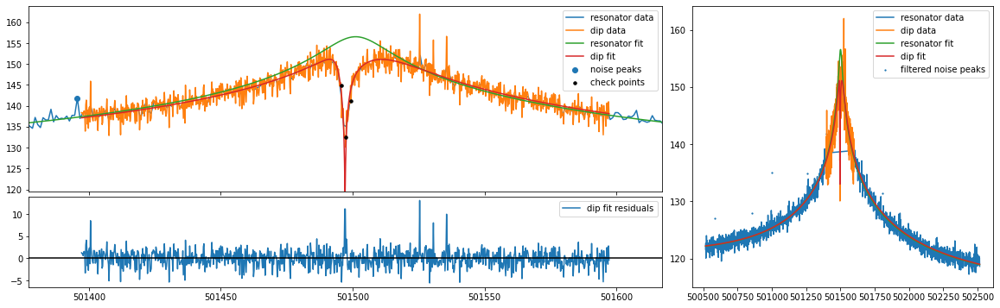

mean fit residuals = 9.4e-03 +/- 6.0e-02
{'A': 1296839291903582.0, 'dA': 47775384670324.46, 'Q': 11793.930985787678, 'dQ': 283.9275926598386, 'offset': 568479184312.5295, 'doffset': 16604969347.067757, 'slope': -0.0015560148097651743, 'dslope': 3.7357803284698194e-05, 'nu_res': 501505.1584228685, 'dnu_res': 0.4215574836152298, 'nu_z': 501497.102389924, 'dnu_z': 0.020776267062769825, 'dip_width': 7.713683760215049, 'ddip_width': 0.36082459049279636, 'pcov': array([[ 4.316532730635e-04,  3.111759743017e-04,  4.123968696712e+08,
         2.511313140901e-03, -5.548437601652e-04],
       [ 3.111759743017e-04,  1.301943851043e-01,  7.928784461617e+12,
         4.946970995124e+01, -2.849230497426e-03],
       [ 4.123968696696e+08,  7.928784461617e+12,  2.282487380397e+27,
         1.256601549180e+16, -4.656747430123e+11],
       [ 2.511313140893e-03,  4.946970995124e+01,  1.256601549180e+16,
         8.061487787361e+04, -4.688502389435e+00],
       [-5.548437601652e-04, -2.849230497428e-03, -

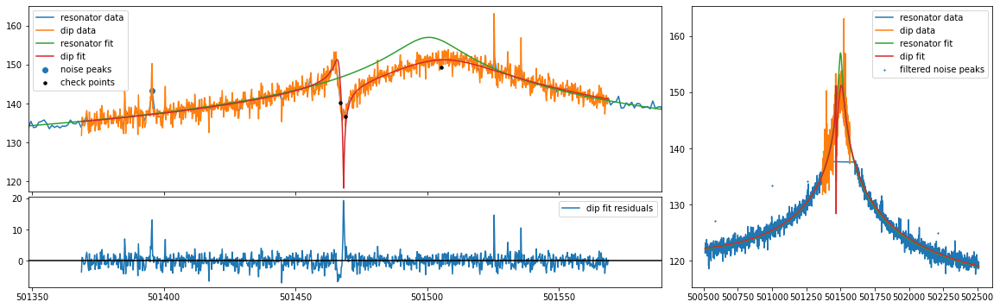

mean fit residuals = 2.0e-02 +/- 6.7e-02
{'A': 1326937081325439.2, 'dA': 54822548566105.15, 'Q': 11818.866293926429, 'dQ': 319.9577331899227, 'offset': 571496673762.653, 'doffset': 16397165250.80758, 'slope': -0.0015598085133959132, 'dslope': 3.66249275414645e-05, 'nu_res': 501504.07750398514, 'dnu_res': 0.5018306352007545, 'nu_z': 501468.2618450491, 'dnu_z': 0.02551132759984744, 'dip_width': 8.69178625278336, 'ddip_width': 0.44413985117696514, 'pcov': array([[ 6.508278359067e-04,  2.080605664534e-03,  8.908279867706e+08,
         1.519173613591e-02, -8.639404139700e-04],
       [ 2.080605664534e-03,  1.972602074035e-01,  1.147936289978e+13,
         7.039900087612e+01, -1.880882219534e-02],
       [ 8.908279867708e+08,  1.147936289978e+13,  3.005511831283e+27,
         1.618204925158e+16, -2.289249108484e+12],
       [ 1.519173613591e-02,  7.039900087612e+01,  1.618204925158e+16,
         1.023729510280e+05, -2.799761298978e+01],
       [-8.639404139700e-04, -1.880882219534e-02, -2.28

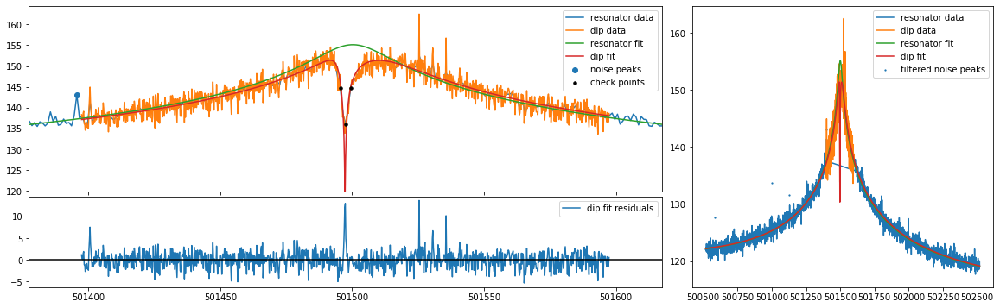

mean fit residuals = 9.4e-03 +/- 6.2e-02
{'A': 1368099693089543.2, 'dA': 53147408683757.15, 'Q': 12181.255605364551, 'dQ': 306.4814702050261, 'offset': 595462921313.1613, 'doffset': 16350227037.12895, 'slope': -0.0014723947192999932, 'dslope': 3.6579083566127146e-05, 'nu_res': 501504.5548337413, 'dnu_res': 0.4289171998179147, 'nu_z': 501497.28864225163, 'dnu_z': 0.020494189180790188, 'dip_width': 6.9705187343092945, 'ddip_width': 0.35318610351048674, 'pcov': array([[ 4.200117901780e-04,  2.817099692588e-04,  4.017607555055e+08,
         2.183357836071e-03, -5.350662311588e-04],
       [ 2.817099692588e-04,  1.247404237129e-01,  8.367243812225e+12,
         5.062416203969e+01, -2.416568662445e-03],
       [ 4.017607555051e+08,  8.367243812225e+12,  2.824647049798e+27,
         1.512277754307e+16, -4.611452162360e+11],
       [ 2.183357836069e-03,  5.062416203969e+01,  1.512277754307e+16,
         9.393089157903e+04, -4.456701060764e+00],
       [-5.350662311588e-04, -2.416568662446e-03,

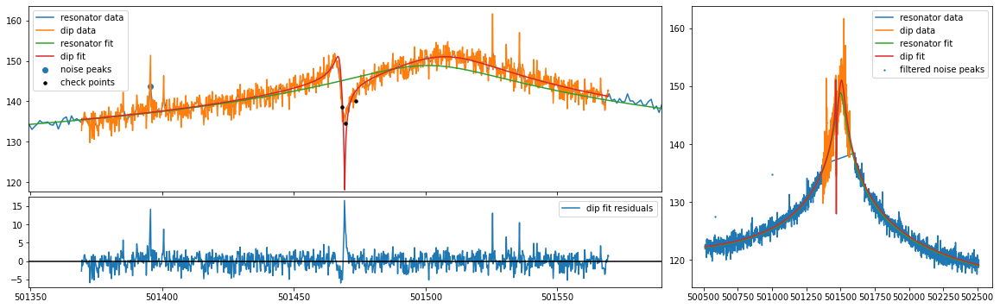

mean fit residuals = 1.7e-02 +/- 6.8e-02
{'A': 1273510292369197.0, 'dA': 52826888958349.73, 'Q': 11429.91412090444, 'dQ': 313.7204003047186, 'offset': 569254061521.9677, 'doffset': 17015293192.502298, 'slope': -0.001559859525716958, 'dslope': 3.7561792369262185e-05, 'nu_res': 501504.7759540482, 'dnu_res': 0.5243423471398835, 'nu_z': 501469.26911668025, 'dnu_z': 0.0262819082030728, 'dip_width': 8.876752247895368, 'ddip_width': 0.45689447827571417, 'pcov': array([[ 6.907386987947e-04,  2.133694042436e-03,  1.167689568547e+09,
         1.929482577359e-02, -9.306723389807e-04],
       [ 2.133694042436e-03,  2.087525642788e-01,  1.139425084214e+13,
         7.114545729289e+01, -2.071399804004e-02],
       [ 1.167689568547e+09,  1.139425084214e+13,  2.790680197018e+27,
         1.524795727969e+16, -2.384210097024e+12],
       [ 1.929482577359e-02,  7.114545729289e+01,  1.524795727969e+16,
         9.842048956735e+04, -2.980884586007e+01],
       [-9.306723389807e-04, -2.071399804004e-02, -2.

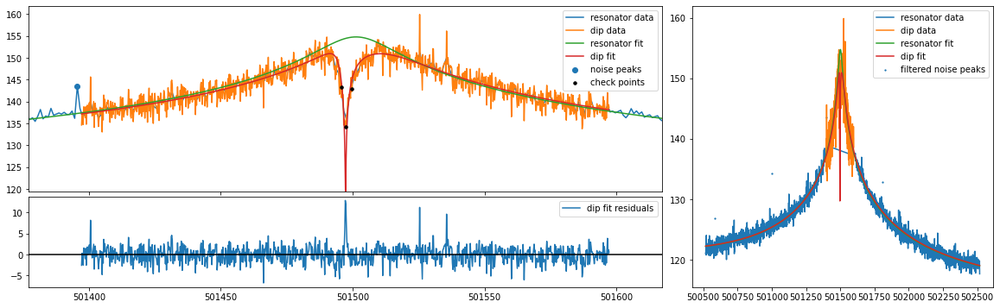

mean fit residuals = 1.0e-02 +/- 6.3e-02
{'A': 1241710450987402.0, 'dA': 47663964373166.375, 'Q': 11514.174034426549, 'dQ': 290.791632183365, 'offset': 576803309785.4602, 'doffset': 16749146563.269566, 'slope': -0.0015527969589913837, 'dslope': 3.727228577932814e-05, 'nu_res': 501504.6374786756, 'dnu_res': 0.450624794146224, 'nu_z': 501497.28964084893, 'dnu_z': 0.02135824110183558, 'dip_width': 7.158316164865256, 'ddip_width': 0.3623076460300179, 'pcov': array([[ 4.561744629641e-04,  2.849196769039e-04,  3.697394957374e+08,
         1.997520345880e-03, -5.906964126264e-04],
       [ 2.849196769039e-04,  1.312668303718e-01,  7.674891833093e+12,
         4.918005557540e+01, -2.801360851440e-03],
       [ 3.697394957382e+08,  7.674891833093e+12,  2.271853499766e+27,
         1.281893510468e+16, -4.820411751647e+11],
       [ 1.997520345884e-03,  4.918005557540e+01,  1.281893510468e+16,
         8.455977334787e+04, -4.924182866791e+00],
       [-5.906964126264e-04, -2.801360851440e-03, -4.

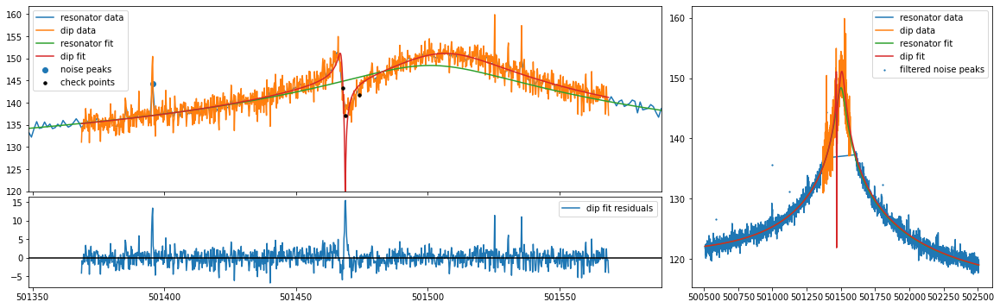

mean fit residuals = 1.1e-02 +/- 6.9e-02
{'A': 1295299101010264.5, 'dA': 54503543487616.46, 'Q': 11723.901378692031, 'dQ': 323.97767190944654, 'offset': 547304701007.9359, 'doffset': 16743406614.826265, 'slope': -0.0015433892907647639, 'dslope': 3.736577066868631e-05, 'nu_res': 501504.8242841366, 'dnu_res': 0.5174155991802839, 'nu_z': 501468.6890233742, 'dnu_z': 0.022146640657622826, 'dip_width': 6.79857487743923, 'ddip_width': 0.38988201148859286, 'pcov': array([[ 4.904736924179e-04,  1.677469843826e-03,  1.873694610665e+09,
         2.485610811180e-02, -6.640020201055e-04],
       [ 1.677469843826e-03,  1.520079828824e-01,  9.096436786923e+12,
         5.681032380045e+01, -1.582879546471e-02],
       [ 1.873694610665e+09,  9.096436786923e+12,  2.970636252706e+27,
         1.627651365235e+16, -2.412721607169e+12],
       [ 2.485610811180e-02,  5.681032380045e+01,  1.627651365235e+16,
         1.049615318959e+05, -3.024498056244e+01],
       [-6.640020201055e-04, -1.582879546471e-02, -

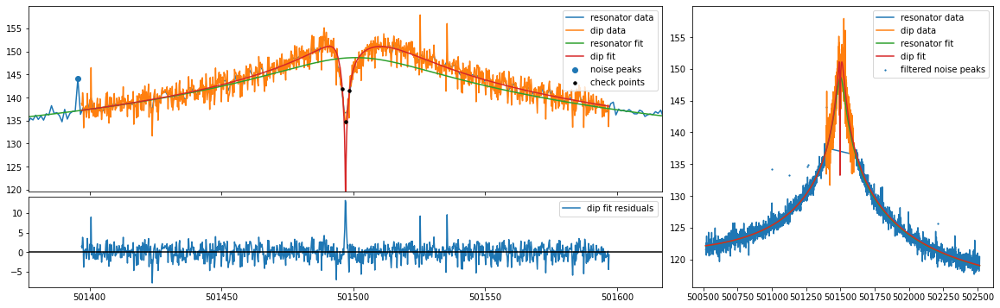

mean fit residuals = 1.1e-02 +/- 6.2e-02
{'A': 1284430269345091.0, 'dA': 49145389024765.6, 'Q': 11666.04121763304, 'dQ': 292.57416910742467, 'offset': 562143038825.3678, 'doffset': 16413614413.647303, 'slope': -0.0015020995805350198, 'dslope': 3.640361191820809e-05, 'nu_res': 501504.1942310021, 'dnu_res': 0.44277089295815686, 'nu_z': 501497.0974349394, 'dnu_z': 0.021449702831910375, 'dip_width': 7.579262949328478, 'ddip_width': 0.372008046721907, 'pcov': array([[ 4.600897515773e-04,  2.822736396928e-04,  3.759096091497e+08,
         2.004276561306e-03, -5.936745849994e-04],
       [ 2.822736396928e-04,  1.383899868258e-01,  8.335286792694e+12,
         5.210217023750e+01, -2.765303735852e-03],
       [ 3.759096091491e+08,  8.335286792694e+12,  2.415269262396e+27,
         1.331059664352e+16, -4.658224755815e+11],
       [ 2.004276561303e-03,  5.210217023750e+01,  1.331059664352e+16,
         8.559964442890e+04, -4.642511181134e+00],
       [-5.936745849994e-04, -2.765303735852e-03, -4.

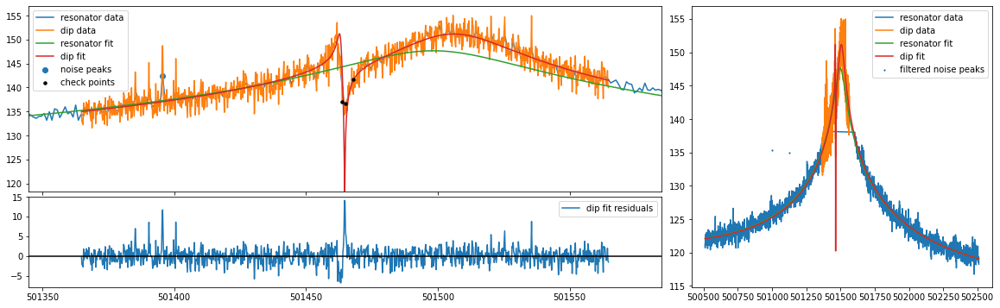

mean fit residuals = 1.3e-02 +/- 6.5e-02
{'A': 1305965891572887.5, 'dA': 52547860013720.07, 'Q': 11928.403313049113, 'dQ': 313.9175604193175, 'offset': 570693484202.272, 'doffset': 17037948715.751785, 'slope': -0.0014734156293470452, 'dslope': 3.756207585016987e-05, 'nu_res': 501504.21831823123, 'dnu_res': 0.49200670036787564, 'nu_z': 501464.67089052516, 'dnu_z': 0.02286390640844735, 'dip_width': 7.7355572813544935, 'ddip_width': 0.403258640132054, 'pcov': array([[ 5.227582162542e-04,  1.929738417282e-03,  1.488648837216e+09,
         2.251192121944e-02, -7.037220821656e-04],
       [ 1.929738417282e-03,  1.626175308412e-01,  9.521508871746e+12,
         5.978562915656e+01, -1.753654806723e-02],
       [ 1.488648837216e+09,  9.521508871746e+12,  2.761277592022e+27,
         1.520763769099e+16, -2.309269848488e+12],
       [ 2.251192121944e-02,  5.978562915656e+01,  1.520763769099e+16,
         9.854423473962e+04, -2.976971393029e+01],
       [-7.037220821656e-04, -1.753654806723e-02, -

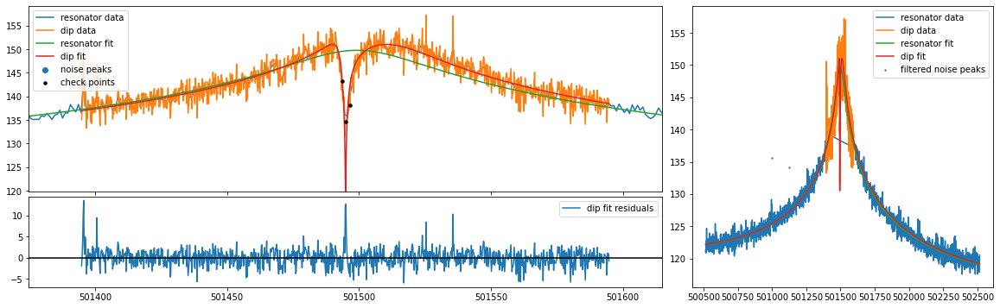

mean fit residuals = 9.6e-03 +/- 6.5e-02
{'A': 1266869180623422.0, 'dA': 50156842958538.16, 'Q': 11550.81038285405, 'dQ': 300.6385960444198, 'offset': 575910606194.4634, 'doffset': 17346032530.69009, 'slope': -0.001475142340662596, 'dslope': 3.8511013004414654e-05, 'nu_res': 501505.60115896695, 'dnu_res': 0.46449938576905625, 'nu_z': 501494.9050523015, 'dnu_z': 0.0215702979400005, 'dip_width': 6.9394844843111, 'ddip_width': 0.3663662252854914, 'pcov': array([[ 4.652777532204e-04,  4.365350599681e-04,  4.969823747238e+08,
         4.000910260002e-03, -6.033053990428e-04],
       [ 4.365350599681e-04,  1.342242110299e-01,  8.069418130991e+12,
         5.079256340515e+01, -4.188355628964e-03],
       [ 4.969823747240e+08,  8.069418130991e+12,  2.515708895567e+27,
         1.394694962753e+16, -7.074414890000e+11],
       [ 4.000910260004e-03,  5.079256340515e+01,  1.394694962753e+16,
         9.038356543156e+04, -7.604883787629e+00],
       [-6.033053990428e-04, -4.188355628964e-03, -7.074

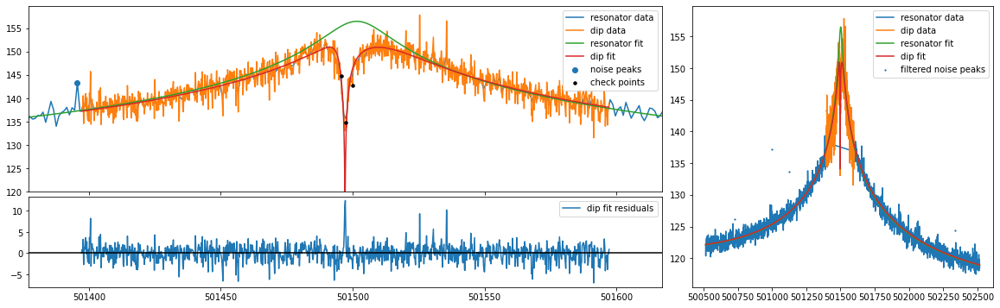

mean fit residuals = 8.4e-03 +/- 6.4e-02
{'A': 1240462799127262.2, 'dA': 48081669066453.42, 'Q': 11485.822671612717, 'dQ': 293.07722362706414, 'offset': 547070132641.6298, 'doffset': 16373328189.034302, 'slope': -0.0015669827915719577, 'dslope': 3.703769224390355e-05, 'nu_res': 501504.09206368873, 'dnu_res': 0.4559499828074166, 'nu_z': 501497.09550405137, 'dnu_z': 0.02066102713002159, 'dip_width': 6.7244448969646475, 'ddip_width': 0.35199638556233526, 'pcov': array([[ 4.268780420675e-04,  2.548677576161e-04,  3.365921716876e+08,
         1.611361413328e-03, -5.546053053425e-04],
       [ 2.548677576161e-04,  1.239014554489e-01,  7.342843488908e+12,
         4.699603900623e+01, -2.497884722054e-03],
       [ 3.365921716886e+08,  7.342843488908e+12,  2.311846900216e+27,
         1.303150927820e+16, -4.647472846157e+11],
       [ 1.611361413334e-03,  4.699603900623e+01,  1.303150927820e+16,
         8.589425900895e+04, -4.664936300728e+00],
       [-5.546053053425e-04, -2.497884722053e-03

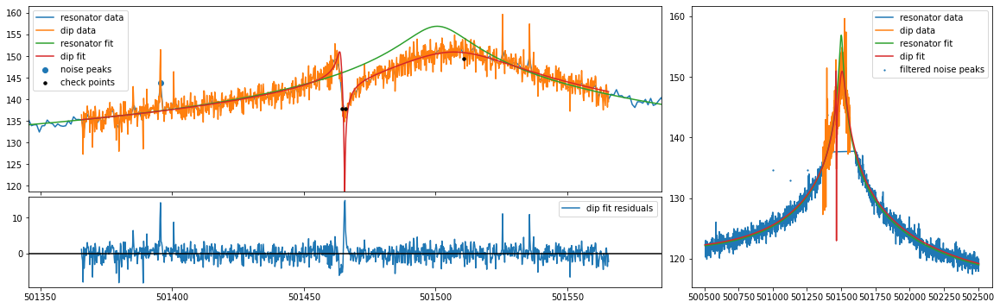

mean fit residuals = 1.2e-02 +/- 6.8e-02
{'A': 1239265828709710.2, 'dA': 50739169224954.914, 'Q': 11185.06614728205, 'dQ': 305.1994648594346, 'offset': 563787658080.469, 'doffset': 16731218784.62636, 'slope': -0.0015525250847708166, 'dslope': 3.7549337434482444e-05, 'nu_res': 501505.12419734534, 'dnu_res': 0.5409627545285018, 'nu_z': 501465.47352564824, 'dnu_z': 0.023034021979953356, 'dip_width': 7.1202291530301505, 'ddip_width': 0.3987489265224441, 'pcov': array([[ 5.305661685730e-04,  1.867015164433e-03,  1.700754049743e+09,
         2.553759199464e-02, -7.362532650852e-04],
       [ 1.867015164433e-03,  1.590007064028e-01,  8.684384704855e+12,
         5.495731536905e+01, -1.903181513735e-02],
       [ 1.700754049743e+09,  8.684384704855e+12,  2.574463293639e+27,
         1.420094009526e+16, -2.607217098015e+12],
       [ 2.553759199464e-02,  5.495731536905e+01,  1.420094009526e+16,
         9.314671335049e+04, -3.409298468912e+01],
       [-7.362532650852e-04, -1.903181513735e-02, 

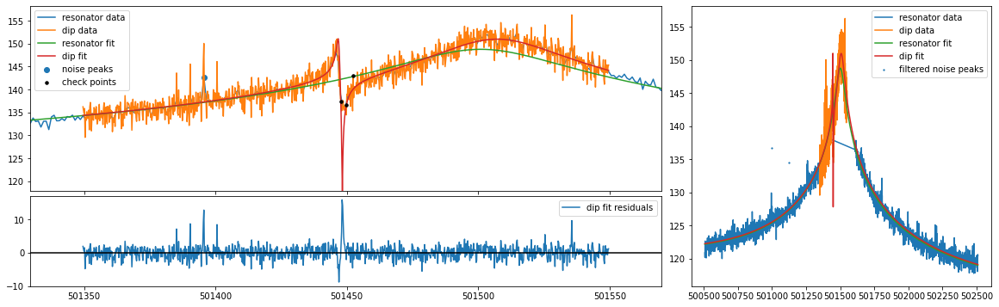

mean fit residuals = 1.5e-02 +/- 6.5e-02
{'A': 1253018586118396.5, 'dA': 48477456835682.39, 'Q': 11259.511606595206, 'dQ': 290.5401340433114, 'offset': 552718603283.1587, 'doffset': 17239643995.022346, 'slope': -0.0015639529519486173, 'dslope': 3.799063938309185e-05, 'nu_res': 501505.68421267916, 'dnu_res': 0.5705155209008707, 'nu_z': 501448.2708071068, 'dnu_z': 0.023737725025992803, 'dip_width': 8.349975903148314, 'ddip_width': 0.42495095009404227, 'pcov': array([[ 5.634795894096e-04,  2.849091329521e-03,  1.143090661952e+09,
         3.363839454204e-02, -8.415521436246e-04],
       [ 2.849091329521e-03,  1.805833099858e-01,  9.130510037970e+12,
         5.768186144942e+01, -2.890193624248e-02],
       [ 1.143090661952e+09,  9.130510037970e+12,  2.350063821255e+27,
         1.277809051878e+16, -2.860405749941e+12],
       [ 3.363839454204e-02,  5.768186144942e+01,  1.277809051878e+16,
         8.441356948991e+04, -4.692395233076e+01],
       [-8.415521436246e-04, -2.890193624248e-02, 

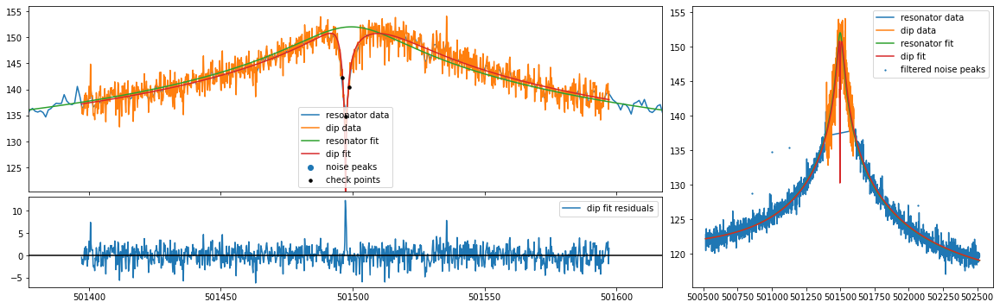

mean fit residuals = 7.5e-03 +/- 6.0e-02
{'A': 1190995227881682.2, 'dA': 43000752894184.93, 'Q': 11258.803068535653, 'dQ': 269.16718635803727, 'offset': 564925264610.3492, 'doffset': 16919159179.73771, 'slope': -0.0015077149766649816, 'dslope': 3.763336366100818e-05, 'nu_res': 501504.0322928531, 'dnu_res': 0.4340085972180022, 'nu_z': 501497.3007879258, 'dnu_z': 0.019216547827915705, 'dip_width': 6.32971963554667, 'ddip_width': 0.3186106985720766, 'pcov': array([[ 3.692757104226e-04,  2.005143110503e-04,  2.276796220999e+08,
         8.913877233441e-04, -4.823210242905e-04],
       [ 2.005143110503e-04,  1.015127772446e-01,  5.774787480071e+12,
         3.797098441807e+01, -2.092076818608e-03],
       [ 2.276796221005e+08,  5.774787480071e+12,  1.849064749467e+27,
         1.068860458855e+16, -3.983146955985e+11],
       [ 8.913877233480e-04,  3.797098441807e+01,  1.068860458855e+16,
         7.245097421190e+04, -4.131298771265e+00],
       [-4.823210242905e-04, -2.092076818608e-03, -3.

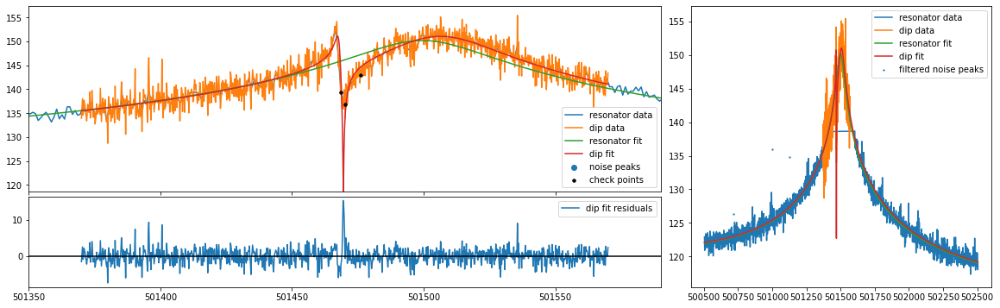

mean fit residuals = 1.3e-02 +/- 6.7e-02
{'A': 1269596592246372.5, 'dA': 51685212555412.32, 'Q': 11467.83272389696, 'dQ': 308.48568268613394, 'offset': 552736509955.925, 'doffset': 17015689512.477633, 'slope': -0.0014558926784222703, 'dslope': 3.8069940294524586e-05, 'nu_res': 501504.22388436703, 'dnu_res': 0.5096901843280115, 'nu_z': 501469.4758781174, 'dnu_z': 0.022792839846817087, 'dip_width': 7.390743008816431, 'ddip_width': 0.39944137337394686, 'pcov': array([[ 5.195135482827e-04,  1.636595770620e-03,  1.433649604485e+09,
         2.005579343780e-02, -7.011846659808e-04],
       [ 1.636595770620e-03,  1.595534107629e-01,  9.104758561843e+12,
         5.712417857038e+01, -1.588913594995e-02],
       [ 1.433649604485e+09,  9.104758561843e+12,  2.671361196898e+27,
         1.467968942314e+16, -2.196464850185e+12],
       [ 2.005579343780e-02,  5.712417857038e+01,  1.467968942314e+16,
         9.516341642233e+04, -2.745218419114e+01],
       [-7.011846659808e-04, -1.588913594995e-02, 

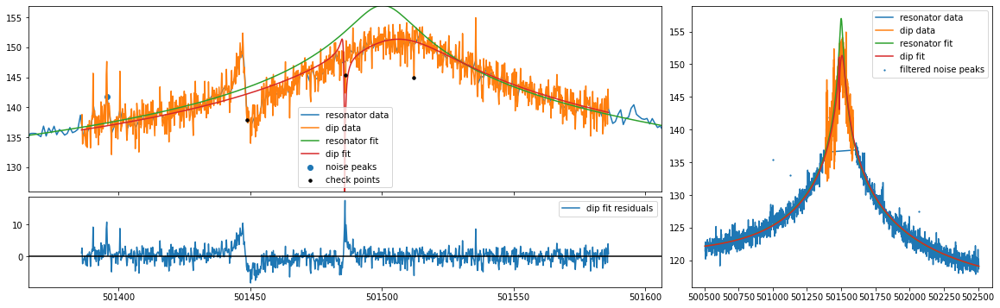

mean fit residuals = 1.8e-03 +/- 7.6e-02
{'A': 1361679326891935.2, 'dA': 64872807626826.836, 'Q': 12181.379030648292, 'dQ': 376.01417479751, 'offset': 581046889855.1742, 'doffset': 16973527724.386862, 'slope': -0.0015345701687630897, 'dslope': 3.766483613645908e-05, 'nu_res': 501505.317074148, 'dnu_res': 0.5329153441870137, 'nu_z': 501485.93202923716, 'dnu_z': 0.017137157682045982, 'dip_width': 2.00055245015945, 'ddip_width': 0.21005675314770586, 'pcov': array([[ 2.936821734193e-04, -1.976480316145e-05, -5.998490929780e+09,
        -6.358064874643e-02, -3.705231008862e-04],
       [-1.976480316145e-05,  4.412383954296e-02,  3.578938879484e+12,
         2.170445323039e+01, -2.334403557251e-03],
       [-5.998490929780e+09,  3.578938879484e+12,  4.208481169387e+27,
         2.263039376433e+16, -1.648641663730e+12],
       [-6.358064874643e-02,  2.170445323039e+01,  2.263039376433e+16,
         1.413866596487e+05, -1.826302644415e+01],
       [-3.705231008862e-04, -2.334403557251e-03, -1.

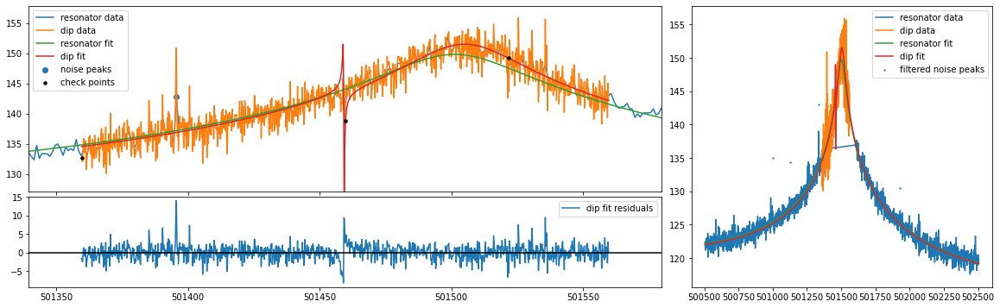

mean fit residuals = 7.3e-04 +/- 6.5e-02
{'A': 1418865562929368.2, 'dA': 57870097980492.31, 'Q': 12547.191912461478, 'dQ': 330.26224246724513, 'offset': 585212660420.7188, 'doffset': 17575696056.478886, 'slope': -0.0014460081292351572, 'dslope': 3.83669382656336e-05, 'nu_res': 501504.65322861157, 'dnu_res': 0.4811250409346843, 'nu_z': 501459.3141586596, 'dnu_z': 0.01605828237444547, 'dip_width': 2.0000043809309833, 'ddip_width': 0.18339551859391326, 'pcov': array([[ 2.578684328174e-04,  9.447755341238e-04, -2.784697890526e+09,
        -2.155896552571e-02, -3.406879807787e-04],
       [ 9.447755341238e-04,  3.363391624033e-02,  2.718427993640e+12,
         1.617802649855e+01, -4.818158160621e-03],
       [-2.784697890526e+09,  2.718427993640e+12,  3.348948240272e+27,
         1.765853779411e+16, -2.587072490605e+12],
       [-2.155896552571e-02,  1.617802649855e+01,  1.765853779411e+16,
         1.090731487995e+05, -3.297180047094e+01],
       [-3.406879807787e-04, -4.818158160621e-03, 

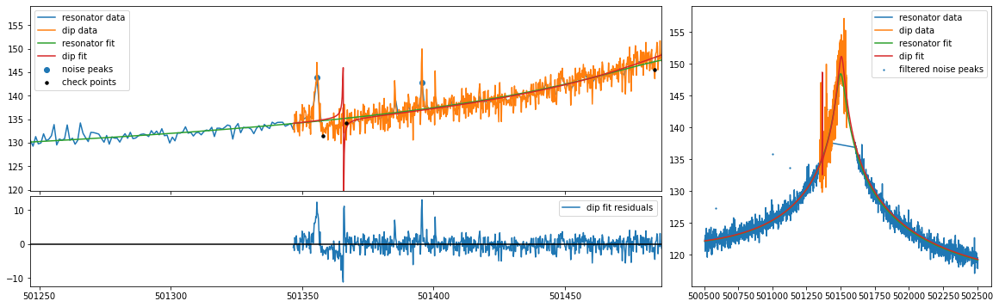

mean fit residuals = 5.9e-03 +/- 7.0e-02
{'A': 1305096117019145.0, 'dA': 55415691071383.195, 'Q': 11704.21429351613, 'dQ': 327.559671212677, 'offset': 575913653403.3926, 'doffset': 17058005938.216648, 'slope': -0.0014623730767469852, 'dslope': 3.761461314604853e-05, 'nu_res': 501505.4433565293, 'dnu_res': 0.6061573267124251, 'nu_z': 501365.8385116706, 'dnu_z': 0.01477287513356935, 'dip_width': 3.555223652764371, 'ddip_width': 0.3077788657104234, 'pcov': array([[ 2.182378397120e-04,  2.951081684094e-03, -1.899381892413e+09,
        -2.733189535847e-02, -2.647164716678e-04],
       [ 2.951081684094e-03,  9.472783017799e-02,  5.251209314893e+12,
         3.203665186520e+01, -1.555412182971e-02],
       [-1.899381892413e+09,  5.251209314893e+12,  3.070898816919e+27,
         1.650158112247e+16, -3.383450677051e+12],
       [-2.733189535847e-02,  3.203665186520e+01,  1.650158112247e+16,
         1.072953382050e+05, -5.637264059142e+01],
       [-2.647164716678e-04, -1.555412182971e-02, -3.3

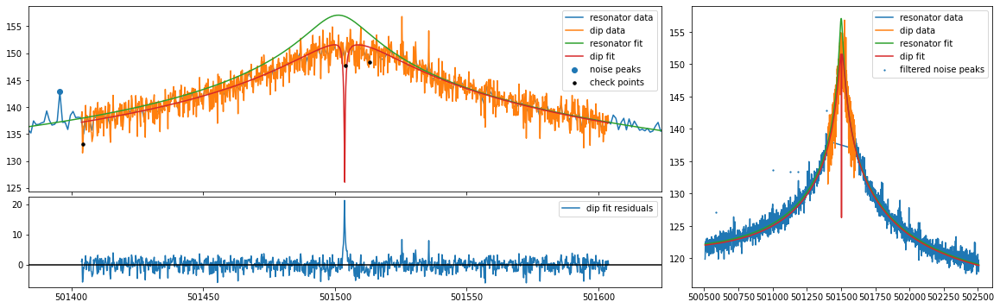

mean fit residuals = 1.2e-02 +/- 6.6e-02
{'A': 1433318226916476.0, 'dA': 60888068488369.85, 'Q': 13061.470738105103, 'dQ': 352.7690389461675, 'offset': 588705061829.0614, 'doffset': 17713618833.027725, 'slope': -0.00156749358301406, 'dslope': 3.92828332970984e-05, 'nu_res': 501504.9315092007, 'dnu_res': 0.43354517900527756, 'nu_z': 501503.6505059345, 'dnu_z': 0.013464429392852776, 'dip_width': 2.000728856560061, 'ddip_width': 0.18666819091840633, 'pcov': array([[ 1.812908588751e-04,  4.912284838390e-04,  6.086836668219e+09,
         6.138762925278e-02, -2.301804271085e-04],
       [ 4.912284838390e-04,  3.484501350075e-02,  2.991271865113e+12,
         1.819722372773e+01, -7.400844526972e-04],
       [ 6.086836668214e+09,  2.991271865113e+12,  3.707356884244e+27,
         2.003574507423e+16, -1.660138931527e+11],
       [ 6.138762925276e-02,  1.819722372773e+01,  2.003574507423e+16,
         1.244459948390e+05, -8.156249446548e-01],
       [-2.301804271085e-04, -7.400844527008e-04, -1.

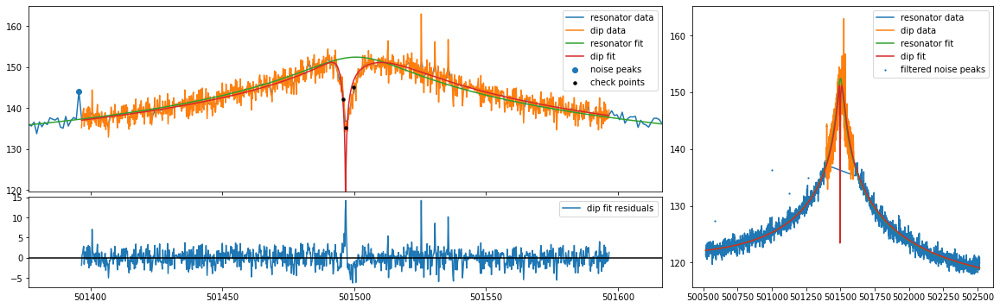

mean fit residuals = 9.2e-03 +/- 6.5e-02
{'A': 1298757907569275.2, 'dA': 51823095866216.336, 'Q': 11836.80077132489, 'dQ': 308.3161328389679, 'offset': 575629430071.0132, 'doffset': 16465198644.972605, 'slope': -0.0014879138177663282, 'dslope': 3.667184440568819e-05, 'nu_res': 501505.10567587905, 'dnu_res': 0.454828694340509, 'nu_z': 501496.71478975745, 'dnu_z': 0.020911511291542225, 'dip_width': 6.5779299801219295, 'ddip_width': 0.35384732563564686, 'pcov': array([[ 4.372913044963e-04,  3.042725466728e-04,  1.732355568665e+08,
         1.098558785015e-04, -5.618078906339e-04],
       [ 3.042725466728e-04,  1.252079298595e-01,  7.937390038206e+12,
         4.956437555885e+01, -2.976913083974e-03],
       [ 1.732355568665e+08,  7.937390038206e+12,  2.685633265159e+27,
         1.480518000373e+16, -5.685870823745e+11],
       [ 1.098558785018e-04,  4.956437555885e+01,  1.480518000373e+16,
         9.505883776878e+04, -5.838040313596e+00],
       [-5.618078906339e-04, -2.976913083975e-03,

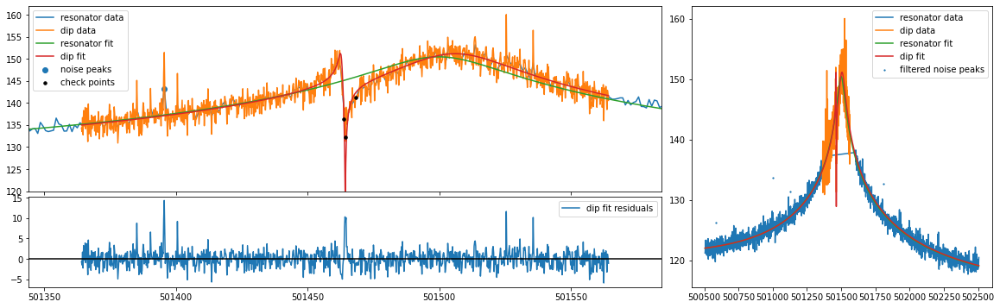

mean fit residuals = 8.3e-03 +/- 6.6e-02
{'A': 1305159543206281.0, 'dA': 52795691564310.65, 'Q': 11827.97292216681, 'dQ': 313.6984367686005, 'offset': 561829219725.5635, 'doffset': 16710050879.84928, 'slope': -0.0014481282460703708, 'dslope': 3.7316745004321174e-05, 'nu_res': 501504.2795150704, 'dnu_res': 0.5010635086619866, 'nu_z': 501464.29169491964, 'dnu_z': 0.021865249153662093, 'dip_width': 7.158960745412398, 'ddip_width': 0.38769760645471074, 'pcov': array([[ 4.780891205517e-04,  1.816422063774e-03,  1.850784326717e+09,
         2.622056328834e-02, -6.516866602224e-04],
       [ 1.816422063774e-03,  1.503094340507e-01,  8.906632305563e+12,
         5.562158954059e+01, -1.692839921620e-02],
       [ 1.850784326717e+09,  8.906632305563e+12,  2.787385047754e+27,
         1.525499341953e+16, -2.406816319956e+12],
       [ 2.622056328834e-02,  5.562158954059e+01,  1.525499341953e+16,
         9.840670923106e+04, -3.106477170117e+01],
       [-6.516866602224e-04, -1.692839921620e-02, -

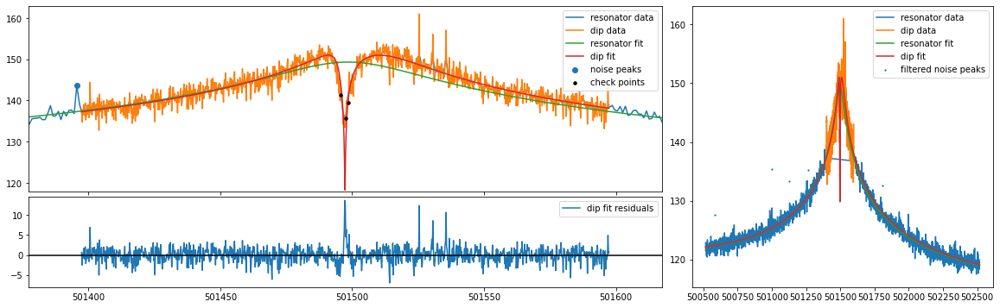

mean fit residuals = 1.2e-02 +/- 6.3e-02
{'A': 1256693858375514.2, 'dA': 47992950559329.98, 'Q': 11519.899544636795, 'dQ': 289.4126051666524, 'offset': 572094904739.3914, 'doffset': 16903056013.80363, 'slope': -0.0014634473834108442, 'dslope': 3.783202318312571e-05, 'nu_res': 501504.239477007, 'dnu_res': 0.4479872821878954, 'nu_z': 501497.2665985764, 'dnu_z': 0.022240762319931922, 'dip_width': 7.621802351966059, 'ddip_width': 0.3746844575009585, 'pcov': array([[ 4.946515085717e-04,  2.491134236796e-04, -1.049996816028e+08,
        -3.254822569734e-03, -6.393291398466e-04],
       [ 2.491134236796e-04,  1.403884426928e-01,  8.187560812358e+12,
         5.186577879532e+01, -2.686460013886e-03],
       [-1.049996816017e+08,  8.187560812358e+12,  2.303323303390e+27,
         1.284678486358e+16, -4.450600485816e+11],
       [-3.254822569728e-03,  5.186577879532e+01,  1.284678486358e+16,
         8.375965602935e+04, -4.472560137904e+00],
       [-6.393291398466e-04, -2.686460013885e-03, -4.4

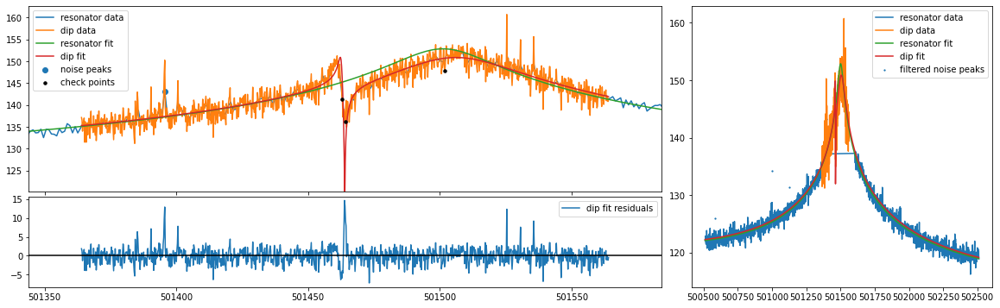

mean fit residuals = 9.5e-03 +/- 6.8e-02
{'A': 1226776071731035.8, 'dA': 49851677217772.72, 'Q': 11030.527304174862, 'dQ': 300.0247543896819, 'offset': 552175340142.9817, 'doffset': 16689264126.977633, 'slope': -0.0015362741338559764, 'dslope': 3.740444933490245e-05, 'nu_res': 501504.51615408616, 'dnu_res': 0.5486248330964774, 'nu_z': 501463.88686579245, 'dnu_z': 0.021361395906024302, 'dip_width': 6.192835564690669, 'ddip_width': 0.3659754359674717, 'pcov': array([[ 4.563092350539e-04,  1.669193812783e-03,  1.899537109290e+09,
         2.722956614687e-02, -6.447174229080e-04],
       [ 1.669193812783e-03,  1.339380197316e-01,  7.374615157242e+12,
         4.669158646057e+01, -1.722464543833e-02],
       [ 1.899537109290e+09,  7.374615157242e+12,  2.485189721425e+27,
         1.369427981023e+16, -2.670533257583e+12],
       [ 2.722956614687e-02,  4.669158646057e+01,  1.369427981023e+16,
         9.001485324659e+04, -3.529743255037e+01],
       [-6.447174229080e-04, -1.722464543833e-02, 

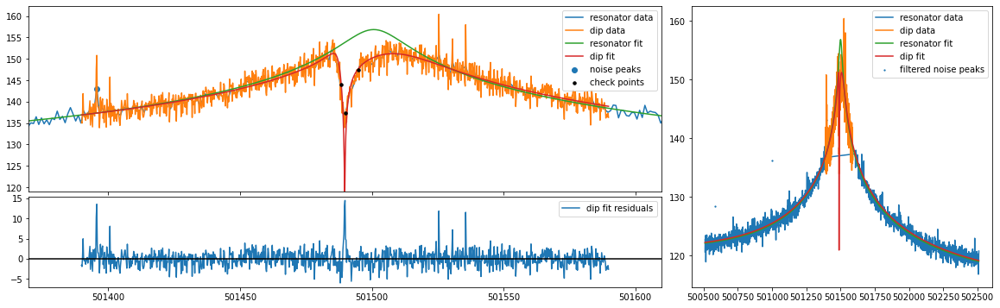

mean fit residuals = 1.1e-02 +/- 6.4e-02
{'A': 1327064341095241.2, 'dA': 52144345121323.01, 'Q': 11629.931402434355, 'dQ': 299.8778607596138, 'offset': 560521124441.295, 'doffset': 16614890960.12586, 'slope': -0.001519021878327552, 'dslope': 3.726378554967067e-05, 'nu_res': 501503.79810342094, 'dnu_res': 0.45933774120868776, 'nu_z': 501489.6807149501, 'dnu_z': 0.021462539394789516, 'dip_width': 7.2804600655991765, 'ddip_width': 0.37381452758864975, 'pcov': array([[ 4.606405972729e-04,  5.874273137008e-04,  6.758411531798e+08,
         6.096573712005e-03, -5.984928443986e-04],
       [ 5.874273137008e-04,  1.397373010363e-01,  8.725271130353e+12,
         5.268555168128e+01, -5.572699570964e-03],
       [ 6.758411531794e+08,  8.725271130353e+12,  2.719032728132e+27,
         1.446660128349e+16, -9.092477618303e+11],
       [ 6.096573712002e-03,  5.268555168128e+01,  1.446660128349e+16,
         8.992673137376e+04, -9.666841938250e+00],
       [-5.984928443986e-04, -5.572699570964e-03, -

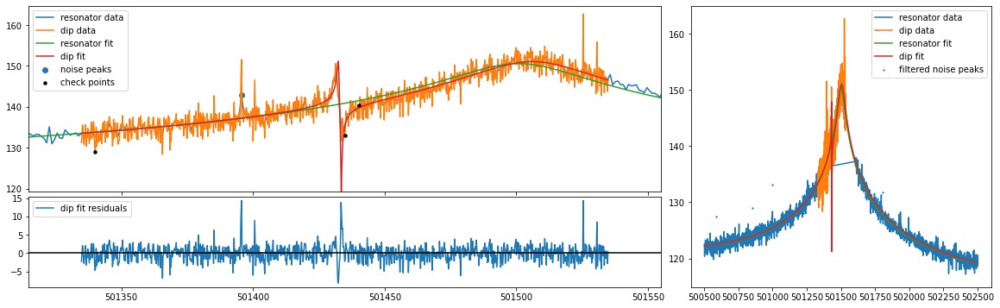

mean fit residuals = 1.1e-02 +/- 6.8e-02
{'A': 1279443644789734.5, 'dA': 52661566680409.23, 'Q': 11599.234488359953, 'dQ': 313.21410903516943, 'offset': 585905102166.949, 'doffset': 16803725761.450426, 'slope': -0.0015302716154068135, 'dslope': 3.701770700374763e-05, 'nu_res': 501504.8748645766, 'dnu_res': 0.6882877841932951, 'nu_z': 501433.4994203394, 'dnu_z': 0.024268326879283486, 'dip_width': 7.928082608160847, 'ddip_width': 0.4457638116915145, 'pcov': array([[ 5.889516895198e-04,  3.921140006451e-03,  6.751907478257e+07,
         5.683225273587e-02, -1.005355269679e-03],
       [ 3.921140006451e-03,  1.987053758137e-01,  9.821488596582e+12,
         6.176683769093e+01, -3.450677465451e-02],
       [ 6.751907478273e+07,  9.821488596582e+12,  2.773240605235e+27,
         1.469021100011e+16, -1.763621310226e+12],
       [ 5.683225273587e-02,  6.176683769093e+01,  1.469021100011e+16,
         9.810307809869e+04, -6.703108352987e+01],
       [-1.005355269679e-03, -3.450677465451e-02, -1

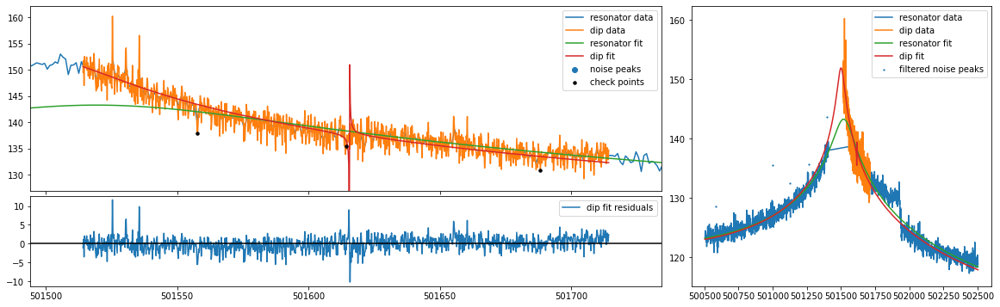

mean fit residuals = 2.1e-03 +/- 6.0e-02
{'A': 1549797152755974.2, 'dA': 338709978000225.8, 'Q': 10532.79023101397, 'dQ': 975.3668524764818, 'offset': 242857766808.08542, 'doffset': 30536214809.514046, 'slope': -0.002544735821494048, 'dslope': 5.579411470683087e-05, 'nu_res': 501500.52928742213, 'dnu_res': 2.789971229909149, 'nu_z': 501615.51036653446, 'dnu_z': 0.014551052275158242, 'dip_width': 2.000000003350701, 'ddip_width': 0.2951379346920544, 'pcov': array([[ 2.117331223144e-04, -2.046278832632e-03,  4.021689140446e+11,
         1.094679151315e+00, -3.706008639807e-03],
       [-2.046278832632e-03,  8.710640049429e-02,  6.448656183845e+13,
         1.864484108560e+02, -4.755182318669e-01],
       [ 4.021689140446e+11,  6.448656183845e+13,  1.147244491969e+29,
         3.268397647649e+17, -8.779546738526e+14],
       [ 1.094679151315e+00,  1.864484108560e+02,  3.268397647649e+17,
         9.513404969099e+05, -2.380897981728e+03],
       [-3.706008639807e-03, -4.755182318669e-01, -8

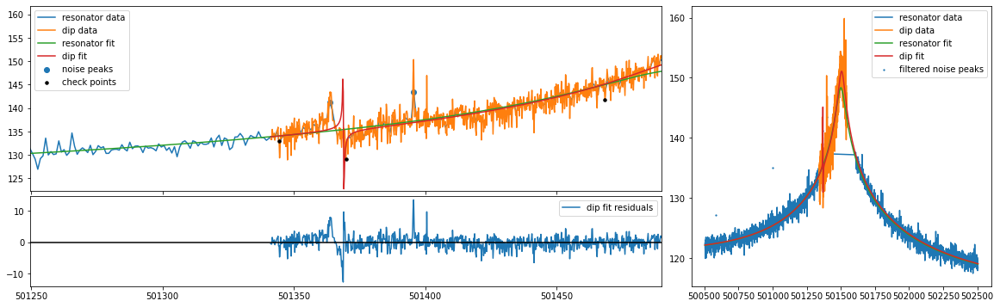

mean fit residuals = 4.3e-03 +/- 6.9e-02
{'A': 1287157527786620.0, 'dA': 53452775451620.4, 'Q': 11588.18828166251, 'dQ': 317.65174143171436, 'offset': 560812314777.817, 'doffset': 17978509694.189083, 'slope': -0.00155911109515694, 'dslope': 3.959283953041964e-05, 'nu_res': 501505.3363085362, 'dnu_res': 0.6369870163804779, 'nu_z': 501369.085014085, 'dnu_z': 0.018738341544396825, 'dip_width': 4.4105013902044305, 'ddip_width': 0.36424987153424887, 'pcov': array([[ 3.511254438345e-04,  4.700458813784e-03, -6.117459329683e+09,
        -5.875037347877e-02, -4.464074208024e-04],
       [ 4.700458813784e-03,  1.326779689127e-01,  5.737286414872e+12,
         3.538023560420e+01, -2.135708620176e-02],
       [-6.117459329683e+09,  5.737286414872e+12,  2.857199203481e+27,
         1.531413418823e+16, -2.955595836919e+12],
       [-5.875037347877e-02,  3.538023560420e+01,  1.531413418823e+16,
         1.009026288346e+05, -6.118714401331e+01],
       [-4.464074208024e-04, -2.135708620176e-02, -2.95

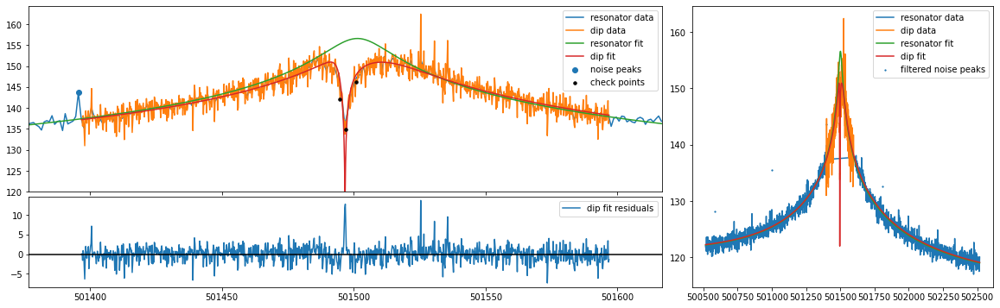

mean fit residuals = 9.3e-03 +/- 6.4e-02
{'A': 1239207707713023.5, 'dA': 48423735051444.54, 'Q': 11362.694591922515, 'dQ': 293.24234700756784, 'offset': 569358845001.3744, 'doffset': 17040665249.615408, 'slope': -0.001532746294879549, 'dslope': 3.792599902006745e-05, 'nu_res': 501505.0738263095, 'dnu_res': 0.46562398529819615, 'nu_z': 501496.69739675365, 'dnu_z': 0.021408035877095652, 'dip_width': 6.906548701453425, 'ddip_width': 0.36247069331564585, 'pcov': array([[ 4.583040001150e-04,  3.271530463757e-04,  3.939597931299e+08,
         2.416212026476e-03, -5.968598313944e-04],
       [ 3.271530463757e-04,  1.313850035127e-01,  7.670618446760e+12,
         4.879152330062e+01, -3.213713381945e-03],
       [ 3.939597931305e+08,  7.670618446760e+12,  2.344858116332e+27,
         1.312070568546e+16, -5.592324187181e+11],
       [ 2.416212026480e-03,  4.879152330062e+01,  1.312070568546e+16,
         8.599107407851e+04, -5.796543287102e+00],
       [-5.968598313944e-04, -3.213713381945e-03,

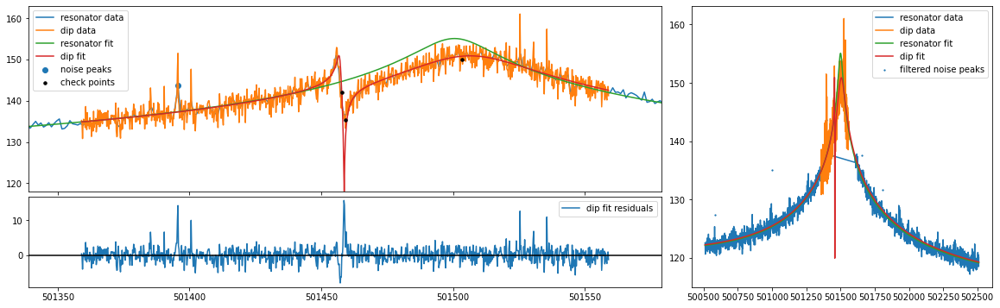

mean fit residuals = 1.6e-02 +/- 6.9e-02
{'A': 1223233606633862.0, 'dA': 50404187257548.07, 'Q': 11200.555190512361, 'dQ': 307.9336175729746, 'offset': 579625966536.0127, 'doffset': 16542387758.602547, 'slope': -0.00146076072050149, 'dslope': 3.6624729623042804e-05, 'nu_res': 501504.53134918434, 'dnu_res': 0.563251238647826, 'nu_z': 501458.67302821827, 'dnu_z': 0.02596913234430102, 'dip_width': 8.462661743767397, 'ddip_width': 0.44991565448615767, 'pcov': array([[ 6.743958347158e-04,  2.687626435882e-03,  1.558811937004e+09,
         3.101047321314e-02, -9.510270586678e-04],
       [ 2.687626435882e-03,  2.024240961517e-01,  1.030585535679e+13,
         6.629350879203e+01, -2.685672050963e-02],
       [ 1.558811937003e+09,  1.030585535679e+13,  2.540582093094e+27,
         1.418981008880e+16, -2.904882856950e+12],
       [ 3.101047321314e-02,  6.629350879203e+01,  1.418981008880e+16,
         9.482311283158e+04, -4.100757049020e+01],
       [-9.510270586678e-04, -2.685672050963e-02, -2

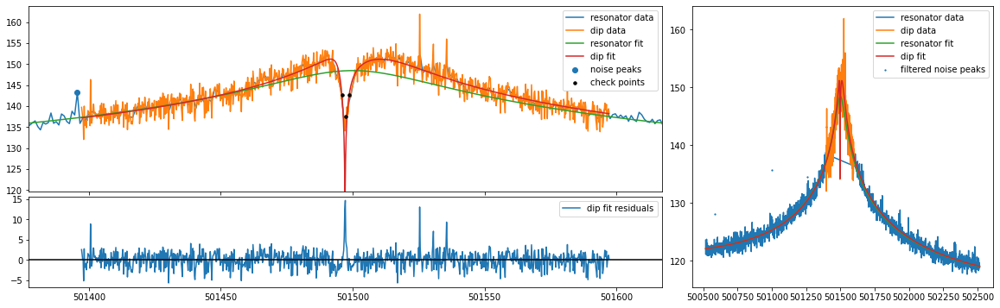

mean fit residuals = 9.5e-03 +/- 6.3e-02
{'A': 1305460656722537.5, 'dA': 50604475152954.72, 'Q': 11765.291228011969, 'dQ': 298.1940317152702, 'offset': 553992202846.1031, 'doffset': 16867063073.84872, 'slope': -0.0014789417671784157, 'dslope': 3.751308369591308e-05, 'nu_res': 501505.0165301966, 'dnu_res': 0.444526899895915, 'nu_z': 501497.0880912968, 'dnu_z': 0.020473227484228827, 'dip_width': 6.869157442150907, 'ddip_width': 0.3535327363411797, 'pcov': array([[ 4.191530436210e-04,  3.013902983923e-04,  4.484976805402e+08,
         2.939710682967e-03, -5.408937457938e-04],
       [ 3.013902983923e-04,  1.249853956649e-01,  7.868681836400e+12,
         4.866746935709e+01, -2.773977002936e-03],
       [ 4.484976805399e+08,  7.868681836400e+12,  2.560812905506e+27,
         1.397725369480e+16, -5.093362820744e+11],
       [ 2.939710682966e-03,  4.866746935709e+01,  1.397725369480e+16,
         8.891968055061e+04, -5.112939624653e+00],
       [-5.408937457938e-04, -2.773977002936e-03, -5.0

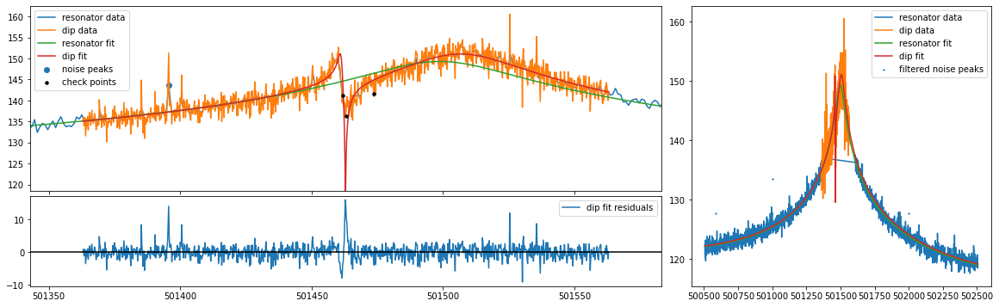

mean fit residuals = 1.5e-02 +/- 7.0e-02
{'A': 1279806369999695.8, 'dA': 54334667587756.16, 'Q': 11430.946503836598, 'dQ': 321.4907121617588, 'offset': 560153276413.0183, 'doffset': 16551762387.875101, 'slope': -0.0015312402850398438, 'dslope': 3.679894881563806e-05, 'nu_res': 501504.7450478978, 'dnu_res': 0.5530343341272648, 'nu_z': 501462.8784909239, 'dnu_z': 0.024802006482007876, 'dip_width': 7.946907560951708, 'ddip_width': 0.43976125754495027, 'pcov': array([[ 6.151395255336e-04,  2.319015431027e-03,  1.870512274528e+09,
         2.945660013629e-02, -8.513752195127e-04],
       [ 2.319015431027e-03,  1.933899636375e-01,  1.072569917765e+13,
         6.675351160122e+01, -2.317551345289e-02],
       [ 1.870512274528e+09,  1.072569917765e+13,  2.952256101872e+27,
         1.603227778495e+16, -2.897513212041e+12],
       [ 2.945660013629e-02,  6.675351160122e+01,  1.603227778495e+16,
         1.033562780063e+05, -3.789527581709e+01],
       [-8.513752195127e-04, -2.317551345289e-02, -

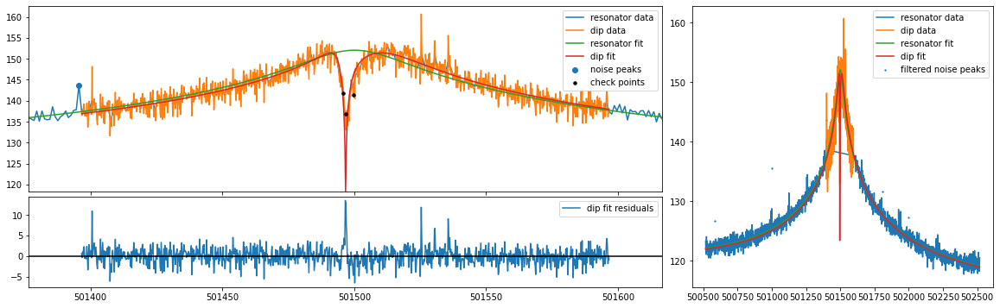

mean fit residuals = 1.1e-02 +/- 6.5e-02
{'A': 1386258813893532.0, 'dA': 56730731478379.65, 'Q': 12524.789040216288, 'dQ': 329.5292936084891, 'offset': 566937505312.4939, 'doffset': 16162450066.143646, 'slope': -0.0014740112238372494, 'dslope': 3.614138453993222e-05, 'nu_res': 501504.74261684815, 'dnu_res': 0.43885472122098307, 'nu_z': 501496.7282477931, 'dnu_z': 0.0223856940291826, 'dip_width': 7.597871973400806, 'ddip_width': 0.38856395867581045, 'pcov': array([[ 5.011192971682e-04,  3.997277168229e-04,  7.228850677632e+08,
         5.415620955739e-03, -6.320866703536e-04],
       [ 3.997277168229e-04,  1.509819499818e-01,  1.021910249099e+13,
         6.225341558136e+01, -3.157841399378e-03],
       [ 7.228850677651e+08,  1.021910249099e+13,  3.218375894072e+27,
         1.738737751730e+16, -5.440989149267e+11],
       [ 5.415620955749e-03,  6.225341558136e+01,  1.738737751730e+16,
         1.085895553461e+05, -5.416675661816e+00],
       [-6.320866703536e-04, -3.157841399377e-03, -

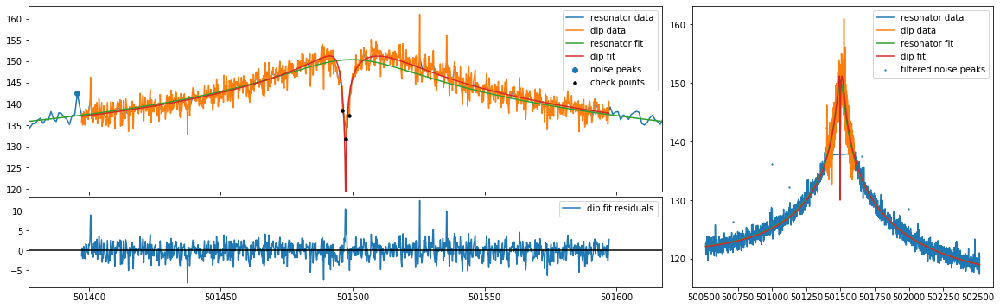

mean fit residuals = 8.0e-03 +/- 6.3e-02
{'A': 1317611472124488.0, 'dA': 52216264002168.84, 'Q': 12202.950732681333, 'dQ': 313.0608453998675, 'offset': 579875531217.126, 'doffset': 16585074487.842007, 'slope': -0.001502404698432612, 'dslope': 3.7161394035645684e-05, 'nu_res': 501503.54418123903, 'dnu_res': 0.43654699837972394, 'nu_z': 501497.28694802977, 'dnu_z': 0.021305641829120398, 'dip_width': 7.206266428313117, 'ddip_width': 0.367541839850776, 'pcov': array([[ 4.539303737508e-04,  2.545241300418e-04,  3.527943475599e+08,
         1.500818668641e-03, -5.772724433999e-04],
       [ 2.545241300418e-04,  1.350870040409e-01,  8.669073662688e+12,
         5.453563119977e+01, -2.276143649311e-03],
       [ 3.527943475586e+08,  8.669073662688e+12,  2.726538226344e+27,
         1.517877170167e+16, -4.192354049453e+11],
       [ 1.500818668633e-03,  5.453563119977e+01,  1.517877170167e+16,
         9.800709292248e+04, -4.097349262968e+00],
       [-5.772724433999e-04, -2.276143649312e-03, -

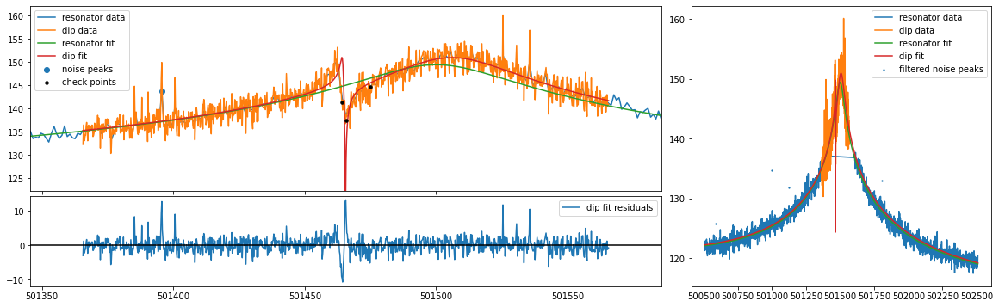

mean fit residuals = 5.6e-03 +/- 7.0e-02
{'A': 1241149661851791.5, 'dA': 51884285297355.63, 'Q': 11218.01304728044, 'dQ': 312.1590675377166, 'offset': 566481675073.6389, 'doffset': 16497595325.028694, 'slope': -0.0014917324282254828, 'dslope': 3.690081525007493e-05, 'nu_res': 501504.77893836476, 'dnu_res': 0.5487328525650682, 'nu_z': 501465.4917651759, 'dnu_z': 0.020018641462799025, 'dip_width': 4.8553113523654465, 'ddip_width': 0.32423403607424855, 'pcov': array([[ 4.007460060161e-04,  1.464848510214e-03,  1.901343093438e+09,
         2.558035480985e-02, -5.629434702798e-04],
       [ 1.464848510214e-03,  1.051277101490e-01,  6.173712390187e+12,
         3.904494675135e+01, -1.346268529841e-02],
       [ 1.901343093438e+09,  6.173712390187e+12,  2.691979060817e+27,
         1.486019197124e+16, -2.676407323283e+12],
       [ 2.558035480985e-02,  3.904494675135e+01,  1.486019197124e+16,
         9.744328344602e+04, -3.489408666575e+01],
       [-5.629434702798e-04, -1.346268529841e-02, 

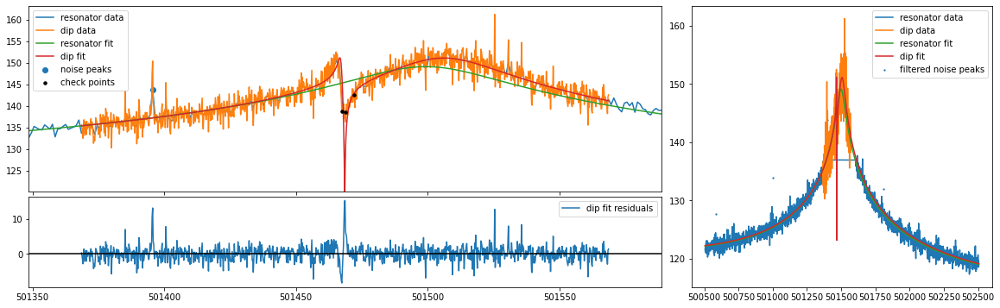

mean fit residuals = 1.0e-02 +/- 7.0e-02
{'A': 1288614936931368.8, 'dA': 55090731802078.08, 'Q': 11567.046055233279, 'dQ': 326.0071257775686, 'offset': 570043719459.0453, 'doffset': 16689743771.239407, 'slope': -0.0015454309560133503, 'dslope': 3.7172736797760915e-05, 'nu_res': 501504.32814666635, 'dnu_res': 0.5328967144068639, 'nu_z': 501468.485824039, 'dnu_z': 0.022185554952843793, 'dip_width': 6.36462521076606, 'ddip_width': 0.38276678834775285, 'pcov': array([[ 4.921988485657e-04,  1.661500870970e-03,  1.999566708634e+09,
         2.593093219859e-02, -6.693209882469e-04],
       [ 1.661500870970e-03,  1.465104142621e-01,  8.763053544988e+12,
         5.450030268830e+01, -1.556080891643e-02],
       [ 1.999566708634e+09,  8.763053544988e+12,  3.034988730488e+27,
         1.654005964219e+16, -2.516853949811e+12],
       [ 2.593093219859e-02,  5.450030268830e+01,  1.654005964219e+16,
         1.062806460578e+05, -3.134279884432e+01],
       [-6.693209882469e-04, -1.556080891643e-02, -

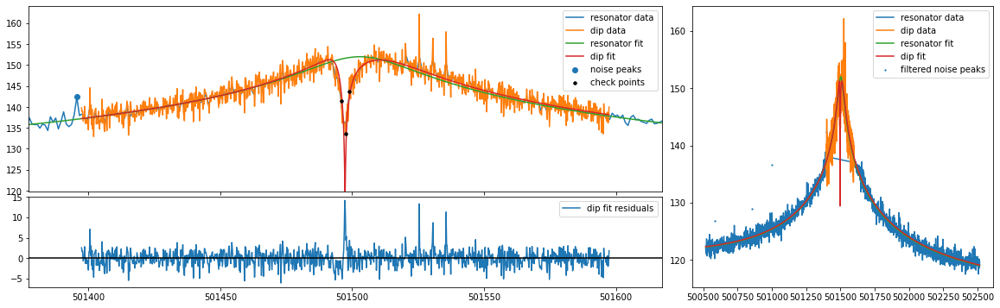

mean fit residuals = 1.1e-02 +/- 6.3e-02
{'A': 1330081304974431.0, 'dA': 51635160093181.56, 'Q': 11869.206160398597, 'dQ': 300.56277180394, 'offset': 582313080175.6616, 'doffset': 16755649154.97415, 'slope': -0.001559887873088361, 'dslope': 3.7219404963860254e-05, 'nu_res': 501504.7852719176, 'dnu_res': 0.4409635559671812, 'nu_z': 501497.2970705452, 'dnu_z': 0.021517026110741418, 'dip_width': 7.516515737482901, 'ddip_width': 0.37324791157483184, 'pcov': array([[ 4.629824126503e-04,  3.065785660364e-04,  3.869580553513e+08,
         1.873718426011e-03, -5.940100995628e-04],
       [ 3.065785660364e-04,  1.393140034950e-01,  8.791386765611e+12,
         5.371766116662e+01, -2.816656095591e-03],
       [ 3.869580553525e+08,  8.791386765611e+12,  2.666189757848e+27,
         1.438353762164e+16, -4.918337777328e+11],
       [ 1.873718426017e-03,  5.371766116662e+01,  1.438353762164e+16,
         9.033797979447e+04, -4.779727139740e+00],
       [-5.940100995628e-04, -2.816656095590e-03, -4.9

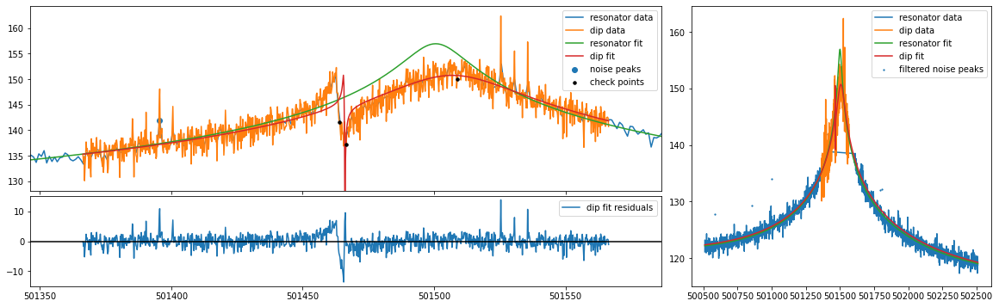

mean fit residuals = 8.2e-04 +/- 7.3e-02
{'A': 1182625722651403.8, 'dA': 51020462231863.5, 'Q': 10828.83489117289, 'dQ': 314.3523299217686, 'offset': 568757284127.4832, 'doffset': 16536407868.989332, 'slope': -0.0015397921824831411, 'dslope': 3.69130447622811e-05, 'nu_res': 501506.4571850975, 'dnu_res': 0.5930774891859875, 'nu_z': 501466.0941787105, 'dnu_z': 0.018556443504030018, 'dip_width': 2.0000000000305906, 'ddip_width': 0.21146220666483784, 'pcov': array([[ 3.443415955183e-04,  1.269497024335e-03,  1.920932664504e+09,
         2.391236929124e-02, -5.041644724324e-04],
       [ 1.269497024335e-03,  4.471626484756e-02,  2.582381665360e+12,
         1.670872299697e+01, -7.381508642923e-03],
       [ 1.920932664504e+09,  2.582381665360e+12,  2.603087566353e+27,
         1.466756934110e+16, -2.979392725285e+12],
       [ 2.391236929124e-02,  1.670872299697e+01,  1.466756934110e+16,
         9.881738732724e+04, -4.011752024581e+01],
       [-5.041644724324e-04, -7.381508642923e-03, -2.

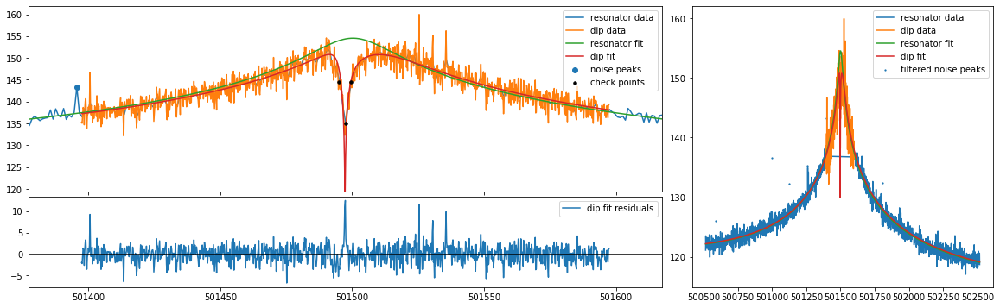

mean fit residuals = 9.1e-03 +/- 6.4e-02
{'A': 1196259660019872.8, 'dA': 46233402065187.03, 'Q': 11237.901808033052, 'dQ': 287.78132701231357, 'offset': 582182502796.9893, 'doffset': 16505175677.185219, 'slope': -0.0014784395176182842, 'dslope': 3.6705777867099883e-05, 'nu_res': 501504.41087695764, 'dnu_res': 0.46570178929659367, 'nu_z': 501497.28745697066, 'dnu_z': 0.02156470844666668, 'dip_width': 6.881233073219778, 'ddip_width': 0.35940818590547097, 'pcov': array([[ 4.650366503897e-04,  2.745227700893e-04,  3.295109835744e+08,
         1.679391530969e-03, -6.065526204867e-04],
       [ 2.745227700893e-04,  1.291742440959e-01,  7.230743729008e+12,
         4.729422749656e+01, -2.720178333820e-03],
       [ 3.295109835727e+08,  7.230743729008e+12,  2.137527466521e+27,
         1.228476167089e+16, -4.685742695825e+11],
       [ 1.679391530959e-03,  4.729422749656e+01,  1.228476167089e+16,
         8.281809217697e+04, -4.876364242009e+00],
       [-6.065526204867e-04, -2.720178333821e-0

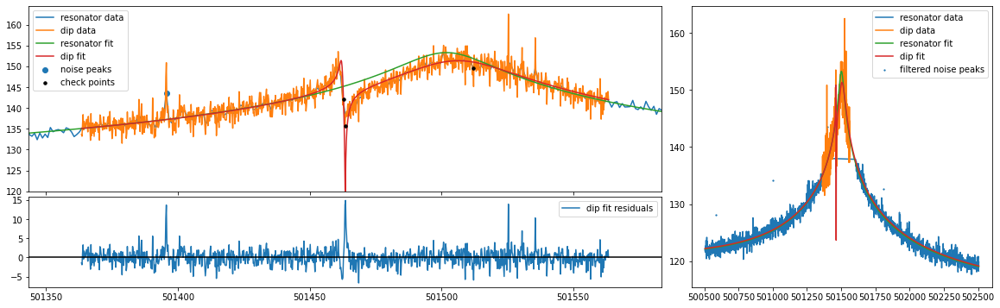

mean fit residuals = 9.9e-03 +/- 6.7e-02
{'A': 1364580823407886.8, 'dA': 56341410140050.52, 'Q': 11868.265386891893, 'dQ': 320.99606819133413, 'offset': 561950139012.0784, 'doffset': 16572293978.960382, 'slope': -0.0015380922634596504, 'dslope': 3.685055285364198e-05, 'nu_res': 501504.84132213047, 'dnu_res': 0.5125426033056653, 'nu_z': 501463.4792251259, 'dnu_z': 0.020743890569537383, 'dip_width': 6.309571898616551, 'ddip_width': 0.36707455993395605, 'pcov': array([[ 4.303089959609e-04,  1.741226297033e-03,  2.302200180415e+09,
         2.967440694557e-02, -5.931453311589e-04],
       [ 1.741226297033e-03,  1.347437325507e-01,  8.543516514392e+12,
         5.115614471178e+01, -1.603695519304e-02],
       [ 2.302200180415e+09,  8.543516514392e+12,  3.174354496569e+27,
         1.665548071621e+16, -2.686247129806e+12],
       [ 2.967440694557e-02,  5.115614471178e+01,  1.665548071621e+16,
         1.030384757943e+05, -3.347451147661e+01],
       [-5.931453311589e-04, -1.603695519304e-02,

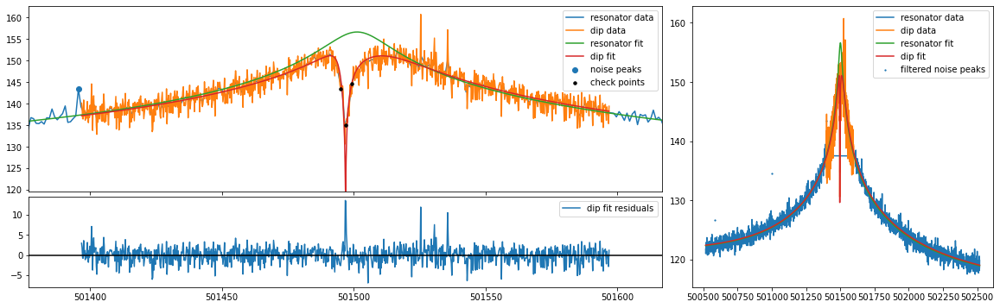

mean fit residuals = 1.1e-02 +/- 6.4e-02
{'A': 1286667012039489.2, 'dA': 50771060535440.3, 'Q': 11651.529261824382, 'dQ': 301.4788762576786, 'offset': 586917789609.2775, 'doffset': 16800579729.277475, 'slope': -0.0016384154597363372, 'dslope': 3.7418270374250054e-05, 'nu_res': 501504.9523483923, 'dnu_res': 0.4575680303953035, 'nu_z': 501496.89249819226, 'dnu_z': 0.0220826539900407, 'dip_width': 7.384566367402584, 'ddip_width': 0.37801395865770343, 'pcov': array([[ 4.876436072439e-04,  3.409336921594e-04,  4.495147562565e+08,
         2.548550553482e-03, -6.291670796973e-04],
       [ 3.409336921594e-04,  1.428945529401e-01,  8.655136916261e+12,
         5.397032134009e+01, -3.271515327443e-03],
       [ 4.495147562554e+08,  8.655136916261e+12,  2.577700587893e+27,
         1.416756527180e+16, -5.602341031670e+11],
       [ 2.548550553476e-03,  5.397032134009e+01,  1.416756527180e+16,
         9.088951282959e+04, -5.609508318950e+00],
       [-6.291670796973e-04, -3.271515327443e-03, -5

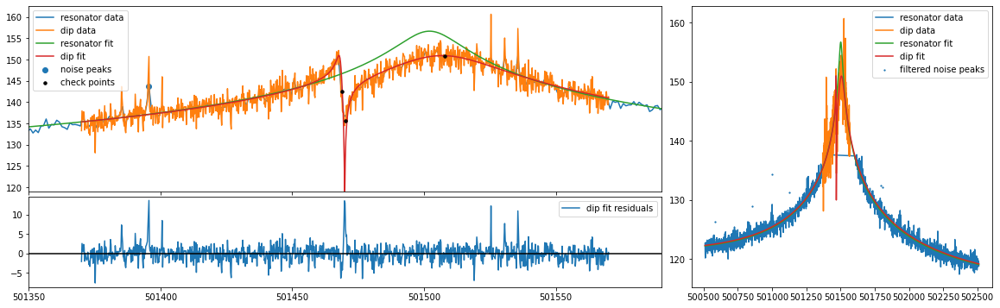

mean fit residuals = 1.2e-02 +/- 6.7e-02
{'A': 1242779332586195.8, 'dA': 50819049843194.27, 'Q': 11477.447258694552, 'dQ': 310.1218555228761, 'offset': 588196443031.5217, 'doffset': 16514154959.731813, 'slope': -0.0015399904227153256, 'dslope': 3.688707880850882e-05, 'nu_res': 501504.75797353423, 'dnu_res': 0.5126421836760648, 'nu_z': 501469.8807433955, 'dnu_z': 0.02340133805536373, 'dip_width': 7.409021305931123, 'ddip_width': 0.4024810284021183, 'pcov': array([[ 5.476226227814e-04,  1.730356206290e-03,  1.563900495319e+09,
         2.215385300637e-02, -7.386546778035e-04],
       [ 1.730356206290e-03,  1.619909782236e-01,  9.016612655714e+12,
         5.785698317996e+01, -1.637639507666e-02],
       [ 1.563900495319e+09,  9.016612655714e+12,  2.582575826965e+27,
         1.450840028419e+16, -2.202024581014e+12],
       [ 2.215385300637e-02,  5.785698317996e+01,  1.450840028419e+16,
         9.617556527295e+04, -2.814906104581e+01],
       [-7.386546778035e-04, -1.637639507666e-02, -2

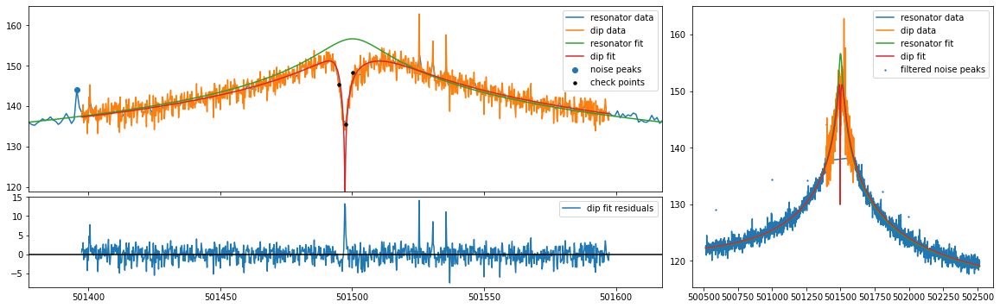

mean fit residuals = 1.1e-02 +/- 6.4e-02
{'A': 1299166815548733.5, 'dA': 50817132489648.11, 'Q': 11727.25600392726, 'dQ': 300.23010638113414, 'offset': 588818922603.3176, 'doffset': 16428390382.203573, 'slope': -0.0015274475877761165, 'dslope': 3.65476407303915e-05, 'nu_res': 501504.2822637221, 'dnu_res': 0.44999696554883073, 'nu_z': 501497.279204869, 'dnu_z': 0.02187474056146909, 'dip_width': 7.3703593801083755, 'ddip_width': 0.3733859027196413, 'pcov': array([[ 4.785042746316e-04,  2.785615573968e-04,  2.398536424829e+08,
         2.840792980357e-04, -6.156239979639e-04],
       [ 2.785615573968e-04,  1.394170323498e-01,  8.564082975008e+12,
         5.313061104673e+01, -2.673010523845e-03],
       [ 2.398536424831e+08,  8.564082975008e+12,  2.582380954470e+27,
         1.412857520247e+16, -4.706470387101e+11],
       [ 2.840792980367e-04,  5.313061104673e+01,  1.412857520247e+16,
         9.013811677763e+04, -4.598454316053e+00],
       [-6.156239979639e-04, -2.673010523845e-03, -4.

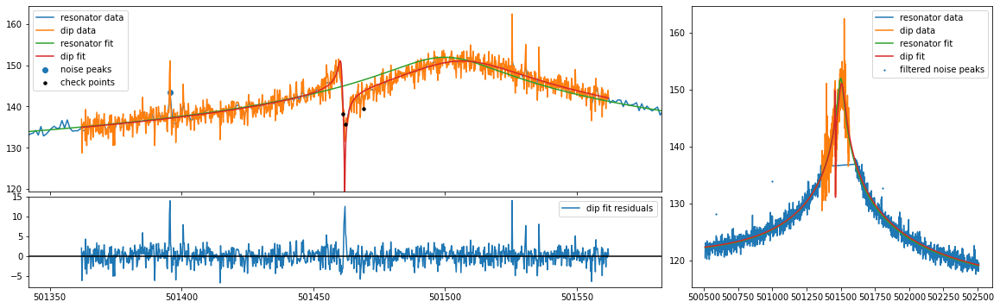

mean fit residuals = 9.2e-03 +/- 6.6e-02
{'A': 1265183939889302.0, 'dA': 50430472263024.06, 'Q': 11562.180817390661, 'dQ': 304.3527988231763, 'offset': 585873107583.2699, 'doffset': 16985036329.563648, 'slope': -0.0015786709444654868, 'dslope': 3.784097578676124e-05, 'nu_res': 501504.85028970806, 'dnu_res': 0.5148304227672966, 'nu_z': 501461.87782867736, 'dnu_z': 0.021648928581188536, 'dip_width': 6.806186473026135, 'ddip_width': 0.37568475336312057, 'pcov': array([[ 4.686761087134e-04,  1.870721384126e-03,  1.864969160460e+09,
         2.769177920673e-02, -6.505804133744e-04],
       [ 1.870721384126e-03,  1.411390339095e-01,  7.993658800951e+12,
         5.075151313267e+01, -1.770405121955e-02],
       [ 1.864969160460e+09,  7.993658800951e+12,  2.543232532672e+27,
         1.409434542838e+16, -2.522121019744e+12],
       [ 2.769177920673e-02,  5.075151313267e+01,  1.409434542838e+16,
         9.263062615150e+04, -3.382093596548e+01],
       [-6.505804133744e-04, -1.770405121955e-02,

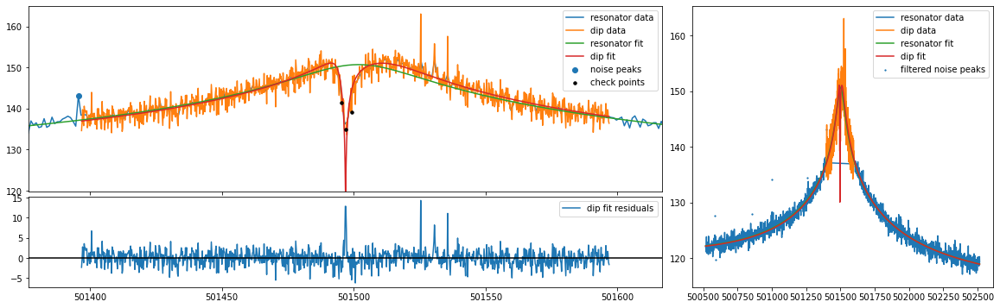

mean fit residuals = 1.0e-02 +/- 6.3e-02
{'A': 1278637848727341.8, 'dA': 50109262360445.016, 'Q': 11882.936584604857, 'dQ': 303.6835703270692, 'offset': 572522349500.6931, 'doffset': 16560464370.417774, 'slope': -0.0015770546090739053, 'dslope': 3.671354626748162e-05, 'nu_res': 501505.2637160186, 'dnu_res': 0.4449198597070432, 'nu_z': 501496.902465294, 'dnu_z': 0.0213974698026094, 'dip_width': 7.205800553013553, 'ddip_width': 0.3671105325722961, 'pcov': array([[ 4.578517139536e-04,  3.424610027376e-04,  4.441278712929e+08,
         2.836987956057e-03, -5.873079966231e-04],
       [ 3.424610027376e-04,  1.347701431255e-01,  8.255264823561e+12,
         5.251724749268e+01, -3.143358030610e-03],
       [ 4.441278712937e+08,  8.255264823561e+12,  2.510938174308e+27,
         1.410389315250e+16, -5.389269157041e+11],
       [ 2.836987956061e-03,  5.251724749268e+01,  1.410389315250e+16,
         9.222371088660e+04, -5.578359396662e+00],
       [-5.873079966231e-04, -3.143358030609e-03, -5.3

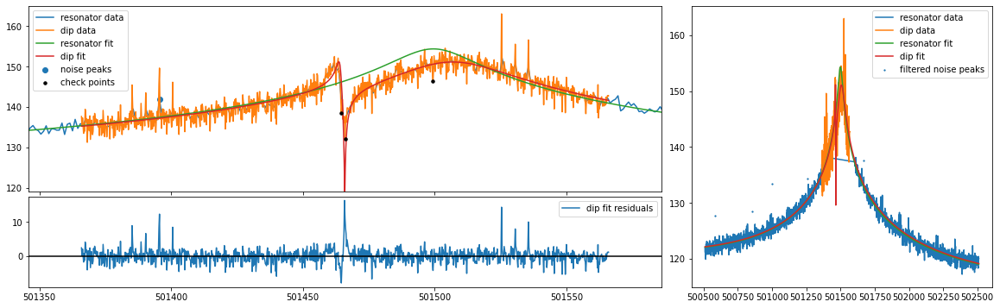

mean fit residuals = 1.4e-02 +/- 6.7e-02
{'A': 1284915799263238.2, 'dA': 52276736223032.89, 'Q': 11530.894166832748, 'dQ': 309.79562983497146, 'offset': 555493561341.0109, 'doffset': 16214335877.343935, 'slope': -0.0014792116546049055, 'dslope': 3.6300114908756163e-05, 'nu_res': 501504.6901415895, 'dnu_res': 0.5164300080262807, 'nu_z': 501465.8977502931, 'dnu_z': 0.024213614559549235, 'dip_width': 8.397671287078337, 'ddip_width': 0.4331496929152749, 'pcov': array([[ 5.862991300384e-04,  2.096314528368e-03,  2.007068945891e+09,
         2.896311739666e-02, -8.017030424073e-04],
       [ 2.096314528368e-03,  1.876186564726e-01,  1.044406555348e+13,
         6.507967305259e+01, -2.036794649731e-02],
       [ 2.007068945892e+09,  1.044406555348e+13,  2.732857150133e+27,
         1.489342247857e+16, -2.455155216364e+12],
       [ 2.896311739666e-02,  6.507967305259e+01,  1.489342247857e+16,
         9.597333226485e+04, -3.139029259538e+01],
       [-8.017030424073e-04, -2.036794649731e-02, 

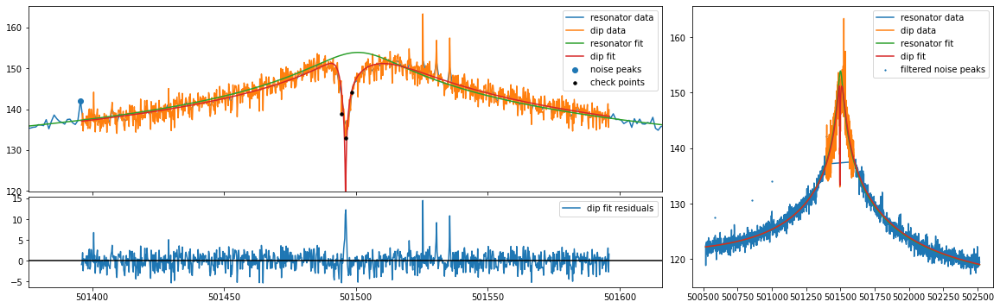

mean fit residuals = 9.7e-03 +/- 6.3e-02
{'A': 1310799075436343.2, 'dA': 50958520467693.08, 'Q': 11863.371679323822, 'dQ': 300.9016994986169, 'offset': 576101328667.8358, 'doffset': 17163038490.169434, 'slope': -0.0015440381569141526, 'dslope': 3.8352371948067616e-05, 'nu_res': 501505.0269668215, 'dnu_res': 0.44237813062625864, 'nu_z': 501496.0998375364, 'dnu_z': 0.021557380518858294, 'dip_width': 7.499681989913163, 'ddip_width': 0.37348115076523997, 'pcov': array([[ 4.647206548349e-04,  3.735500502809e-04,  4.906623337760e+08,
         3.360748389384e-03, -5.967252001743e-04],
       [ 3.735500502809e-04,  1.394881699769e-01,  8.669481530805e+12,
         5.373778214909e+01, -3.449086177565e-03],
       [ 4.906623337762e+08,  8.669481530805e+12,  2.596770808256e+27,
         1.420956225572e+16, -5.743469511986e+11],
       [ 3.360748389386e-03,  5.373778214909e+01,  1.420956225572e+16,
         9.054183276116e+04, -5.877377121119e+00],
       [-5.967252001743e-04, -3.449086177565e-03,

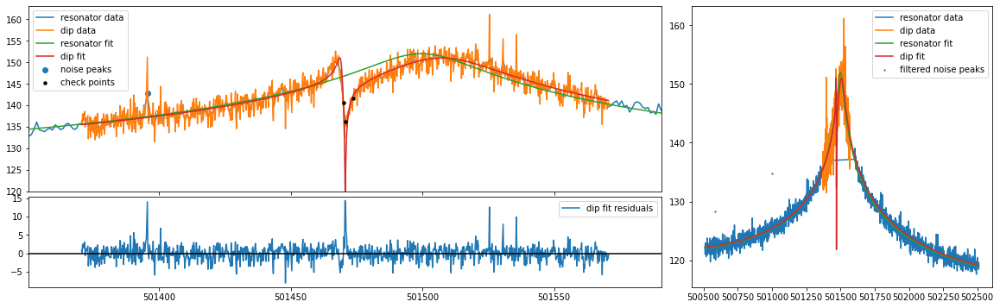

mean fit residuals = 1.1e-02 +/- 6.6e-02
{'A': 1256249212392812.0, 'dA': 50613790377388.984, 'Q': 11414.271257773238, 'dQ': 304.31157070142467, 'offset': 561033188195.9614, 'doffset': 16670564976.578457, 'slope': -0.0015130368065374726, 'dslope': 3.734673452386329e-05, 'nu_res': 501505.26375104644, 'dnu_res': 0.508005562718503, 'nu_z': 501470.69078914105, 'dnu_z': 0.021893058612497466, 'dip_width': 6.898639608509713, 'ddip_width': 0.3797081281297598, 'pcov': array([[ 4.793060154102e-04,  1.518446025001e-03,  1.630061974281e+09,
         2.205615155969e-02, -6.513136942897e-04],
       [ 1.518446025001e-03,  1.441782625678e-01,  8.240138579339e+12,
         5.207808069354e+01, -1.483848856564e-02],
       [ 1.630061974281e+09,  8.240138579339e+12,  2.561755776366e+27,
         1.417405974438e+16, -2.178839077835e+12],
       [ 2.205615155969e-02,  5.207808069354e+01,  1.417405974438e+16,
         9.260553206277e+04, -2.746005073674e+01],
       [-6.513136942897e-04, -1.483848856564e-02,

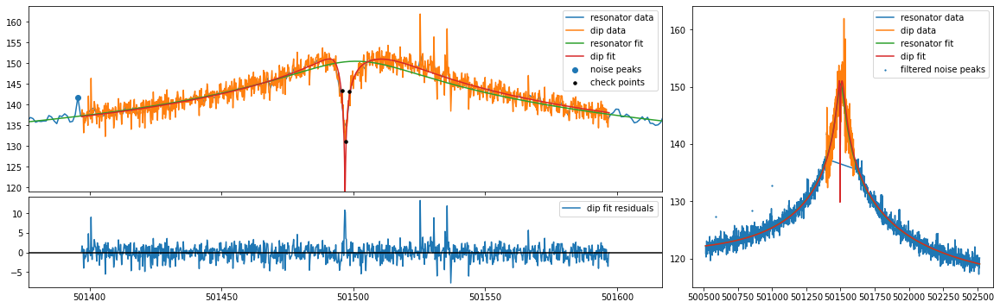

mean fit residuals = 8.9e-03 +/- 6.1e-02
{'A': 1270270838483887.5, 'dA': 47440741589126.164, 'Q': 11692.059381164929, 'dQ': 286.0487933707661, 'offset': 572810082879.8947, 'doffset': 16890747912.710293, 'slope': -0.0015421488974841663, 'dslope': 3.733429893736456e-05, 'nu_res': 501504.6054571728, 'dnu_res': 0.4313010784450091, 'nu_z': 501496.91154872207, 'dnu_z': 0.021225192349347465, 'dip_width': 7.598363182002696, 'ddip_width': 0.3636582649847608, 'pcov': array([[ 4.505087902668e-04,  3.138695035343e-04,  4.858007210834e+08,
         3.275059625710e-03, -5.800310038364e-04],
       [ 3.138695035343e-04,  1.322473336917e-01,  7.872655898816e+12,
         4.984680148771e+01, -2.816981361356e-03],
       [ 4.858007210844e+08,  7.872655898816e+12,  2.250623962526e+27,
         1.256387155846e+16, -4.594215697342e+11],
       [ 3.275059625716e-03,  4.984680148771e+01,  1.256387155846e+16,
         8.182391218887e+04, -4.662501449855e+00],
       [-5.800310038364e-04, -2.816981361355e-03, 

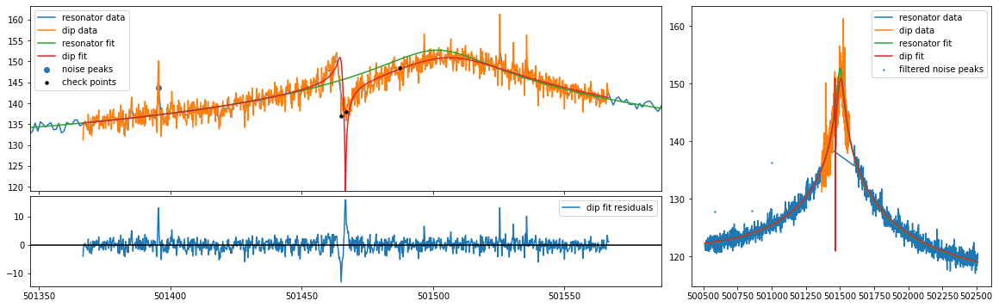

mean fit residuals = 1.4e-02 +/- 7.2e-02
{'A': 1225542086653383.2, 'dA': 53049107620372.66, 'Q': 11352.488359480974, 'dQ': 325.9206193925711, 'offset': 571473974825.9362, 'doffset': 17117177975.98429, 'slope': -0.001596519835927948, 'dslope': 3.793564529244474e-05, 'nu_res': 501504.19821963867, 'dnu_res': 0.5561356692593672, 'nu_z': 501466.68303052156, 'dnu_z': 0.024953197554341954, 'dip_width': 7.512306241648093, 'ddip_width': 0.4323926133664807, 'pcov': array([[ 6.226620681860e-04,  2.099867409752e-03,  1.884400775238e+09,
         2.780257605438e-02, -8.511816926092e-04],
       [ 2.099867409752e-03,  1.869633720939e-01,  1.011270356042e+13,
         6.534621138774e+01, -2.055200748341e-02],
       [ 1.884400775238e+09,  1.011270356042e+13,  2.814207819318e+27,
         1.588842150839e+16, -2.665625891269e+12],
       [ 2.780257605438e-02,  6.534621138774e+01,  1.588842150839e+16,
         1.062242501452e+05, -3.491430235948e+01],
       [-8.511816926092e-04, -2.055200748341e-02, -2

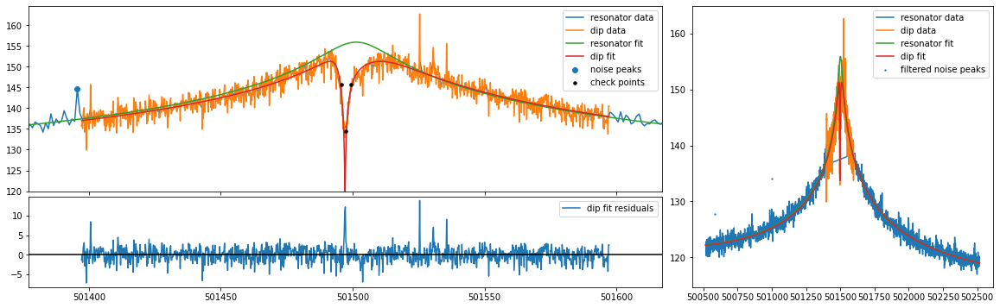

mean fit residuals = 9.0e-03 +/- 6.2e-02
{'A': 1334147800751716.0, 'dA': 51845036080305.53, 'Q': 12164.900587649041, 'dQ': 306.2909276808748, 'offset': 580816593211.3713, 'doffset': 17561950332.541428, 'slope': -0.0015417060980994852, 'dslope': 3.903680919107776e-05, 'nu_res': 501504.9064850122, 'dnu_res': 0.42987754945903583, 'nu_z': 501497.09573866613, 'dnu_z': 0.020931805108706392, 'dip_width': 7.270545990768358, 'ddip_width': 0.3628065605790297, 'pcov': array([[ 4.381404651089e-04,  3.120860451096e-04,  3.840229709653e+08,
         2.017370893463e-03, -5.580733837419e-04],
       [ 3.120860451096e-04,  1.316286003992e-01,  8.518249136667e+12,
         5.280285141494e+01, -2.717180756043e-03],
       [ 3.840229709658e+08,  8.518249136667e+12,  2.687907766168e+27,
         1.474133690487e+16, -4.839040630895e+11],
       [ 2.017370893466e-03,  5.280285141494e+01,  1.474133690487e+16,
         9.381413237961e+04, -4.817440513921e+00],
       [-5.580733837419e-04, -2.717180756044e-03, 

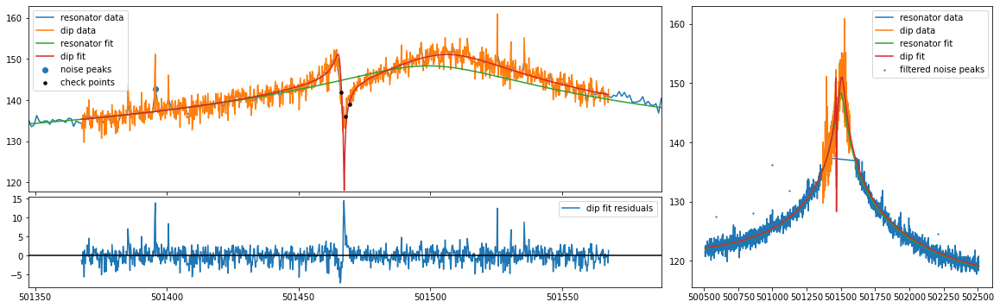

mean fit residuals = 1.4e-02 +/- 6.7e-02
{'A': 1281957410096529.2, 'dA': 52230323933960.414, 'Q': 11564.353108106357, 'dQ': 310.73804346060444, 'offset': 559714607356.6526, 'doffset': 16572762667.485983, 'slope': -0.0015311299421967807, 'dslope': 3.690420153959171e-05, 'nu_res': 501504.0768615056, 'dnu_res': 0.5102084010074638, 'nu_z': 501467.26889993227, 'dnu_z': 0.024743709152395644, 'dip_width': 8.43925859605851, 'ddip_width': 0.43361373126651676, 'pcov': array([[ 6.122511426183e-04,  1.999440358657e-03,  1.176521662297e+09,
         1.900070531829e-02, -8.244962108165e-04],
       [ 1.999440358657e-03,  1.880208679429e-01,  1.050065709062e+13,
         6.567454208449e+01, -1.916382001556e-02],
       [ 1.176521662297e+09,  1.050065709062e+13,  2.728006738246e+27,
         1.494120123099e+16, -2.319539785797e+12],
       [ 1.900070531829e-02,  6.567454208449e+01,  1.494120123099e+16,
         9.655813165372e+04, -2.924605248790e+01],
       [-8.244962108165e-04, -1.916382001556e-02,

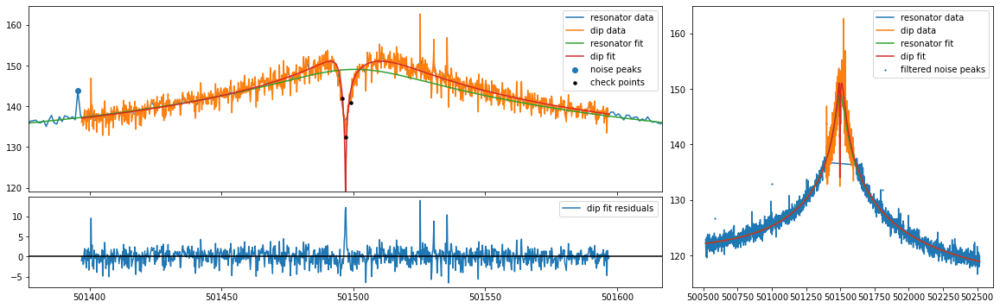

mean fit residuals = 9.2e-03 +/- 6.2e-02
{'A': 1281163873702204.0, 'dA': 48778090953504.76, 'Q': 11782.77618878993, 'dQ': 293.21885322434804, 'offset': 567924748805.8142, 'doffset': 17046823819.204744, 'slope': -0.0015816810128579618, 'dslope': 3.78116833328052e-05, 'nu_res': 501504.7763758999, 'dnu_res': 0.4359661628954133, 'nu_z': 501497.08098875114, 'dnu_z': 0.020619922129277282, 'dip_width': 7.050666097017696, 'ddip_width': 0.3529695701311327, 'pcov': array([[ 4.251811886175e-04,  2.898614216606e-04,  4.126053241674e+08,
         2.459440492177e-03, -5.472611325723e-04],
       [ 2.898614216606e-04,  1.245875174386e-01,  7.647779676949e+12,
         4.826448574459e+01, -2.716294615020e-03],
       [ 4.126053241666e+08,  7.647779676949e+12,  2.379302157068e+27,
         1.324906972090e+16, -4.842698968616e+11],
       [ 2.459440492173e-03,  4.826448574459e+01,  1.324906972090e+16,
         8.597729588620e+04, -4.895317971486e+00],
       [-5.472611325723e-04, -2.716294615021e-03, -4

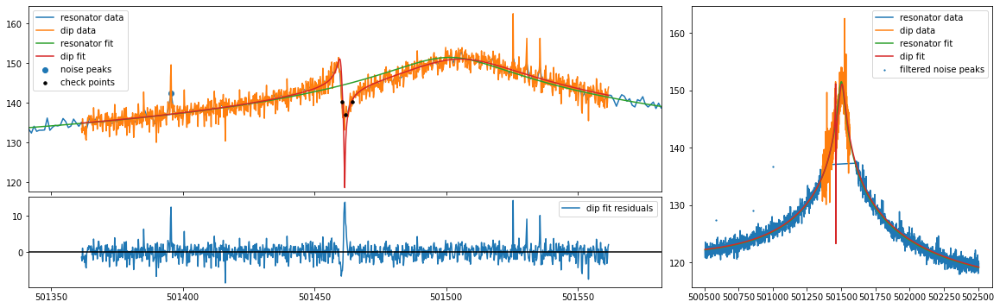

mean fit residuals = 1.4e-02 +/- 6.8e-02
{'A': 1282773770521881.5, 'dA': 52957053613507.24, 'Q': 11655.573705555527, 'dQ': 316.99376197073656, 'offset': 585723481632.4199, 'doffset': 16550403278.017437, 'slope': -0.0015378243787761824, 'dslope': 3.668482944135317e-05, 'nu_res': 501503.6675497135, 'dnu_res': 0.5260700092306309, 'nu_z': 501461.458867051, 'dnu_z': 0.02439552883831836, 'dip_width': 7.680857942639759, 'ddip_width': 0.4170960842103528, 'pcov': array([[ 5.951418273012e-04,  2.244172266514e-03,  1.268870973869e+09,
         2.256106831970e-02, -8.117583023799e-04],
       [ 2.244172266514e-03,  1.739691434636e-01,  9.802041659774e+12,
         6.171341808101e+01, -2.071581507643e-02],
       [ 1.268870973869e+09,  9.802041659774e+12,  2.804449527424e+27,
         1.543029790410e+16, -2.654146740389e+12],
       [ 2.256106831970e-02,  6.171341808101e+01,  1.543029790410e+16,
         1.004850451284e+05, -3.507973594378e+01],
       [-8.117583023799e-04, -2.071581507643e-02, -2.

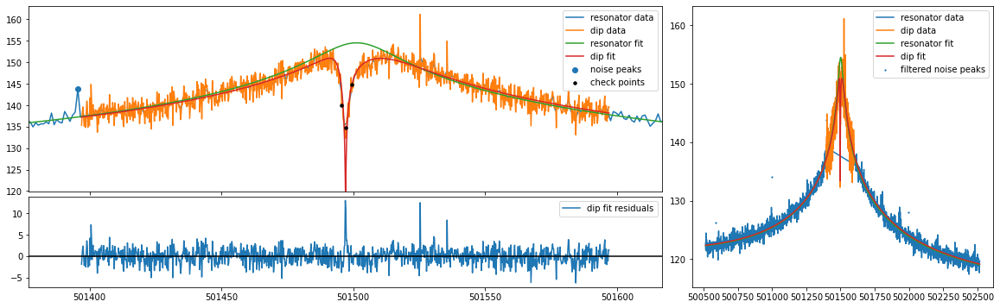

mean fit residuals = 9.6e-03 +/- 6.1e-02
{'A': 1235991165911791.8, 'dA': 45727385970866.234, 'Q': 11392.997196438151, 'dQ': 278.18068005648524, 'offset': 593090106819.8651, 'doffset': 16755088854.117058, 'slope': -0.0015642615430892575, 'dslope': 3.6984716714633216e-05, 'nu_res': 501504.5780831271, 'dnu_res': 0.4394337351292733, 'nu_z': 501497.09857316635, 'dnu_z': 0.021025327380601682, 'dip_width': 7.275851315794045, 'ddip_width': 0.354214797301098, 'pcov': array([[ 4.420643914615e-04,  2.808851640064e-04,  3.886886342261e+08,
         2.307348851052e-03, -5.737301474334e-04],
       [ 2.808851640064e-04,  1.254681226271e-01,  7.224916573285e+12,
         4.617694685158e+01, -2.759311893154e-03],
       [ 3.886886342249e+08,  7.224916573285e+12,  2.090993827729e+27,
         1.175587557587e+16, -4.638900269724e+11],
       [ 2.307348851045e-03,  4.617694685158e+01,  1.175587557587e+16,
         7.738449075669e+04, -4.736963494954e+00],
       [-5.737301474334e-04, -2.759311893156e-03,

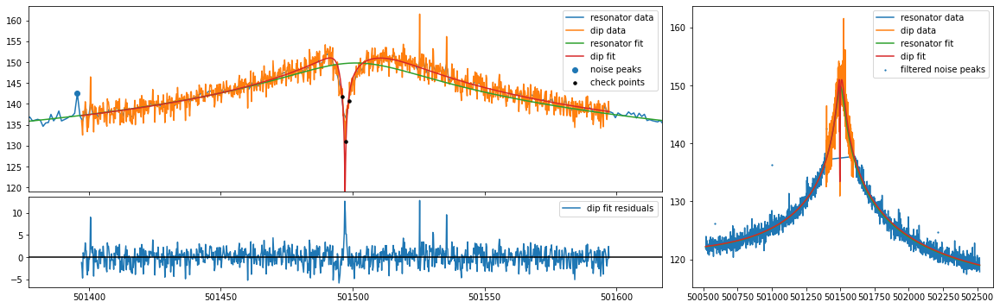

mean fit residuals = 8.5e-03 +/- 6.2e-02
{'A': 1257463981723779.8, 'dA': 47291196145288.69, 'Q': 11531.188026481253, 'dQ': 285.1873971345415, 'offset': 563271647919.48, 'doffset': 16786399329.717466, 'slope': -0.0015528573375265203, 'dslope': 3.762217873496639e-05, 'nu_res': 501504.8925364486, 'dnu_res': 0.440822330570635, 'nu_z': 501497.1183870083, 'dnu_z': 0.02067238590831157, 'dip_width': 7.0112388331628575, 'ddip_width': 0.35015235076634427, 'pcov': array([[ 4.273475391422e-04,  2.828204891805e-04,  3.184953729127e+08,
         1.581686188348e-03, -5.529616267382e-04],
       [ 2.828204891805e-04,  1.226066687472e-01,  7.304414343128e+12,
         4.625873979082e+01, -2.716241614282e-03],
       [ 3.184953729132e+08,  7.304414343128e+12,  2.236457232852e+27,
         1.247497967348e+16, -4.800827368845e+11],
       [ 1.581686188352e-03,  4.625873979082e+01,  1.247497967348e+16,
         8.133185148437e+04, -4.878046179346e+00],
       [-5.529616267382e-04, -2.716241614281e-03, -4.8

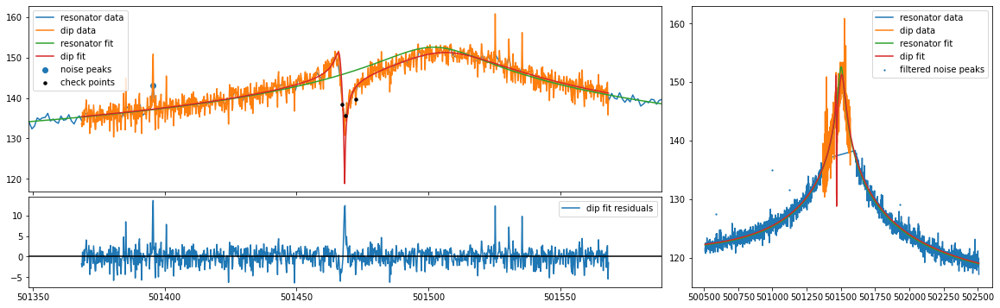

mean fit residuals = 1.4e-02 +/- 6.6e-02
{'A': 1330535504921971.8, 'dA': 54376765138496.086, 'Q': 11815.041735182245, 'dQ': 316.43875083983545, 'offset': 566685195577.1263, 'doffset': 16413551075.164278, 'slope': -0.0016025433440960992, 'dslope': 3.6904868775433305e-05, 'nu_res': 501504.1245963165, 'dnu_res': 0.49753070040275876, 'nu_z': 501468.24865943386, 'dnu_z': 0.02584167043254943, 'dip_width': 8.579136582903809, 'ddip_width': 0.4360230781053857, 'pcov': array([[ 6.677919307445e-04,  2.093384883422e-03,  5.418876180509e+08,
         1.176790554103e-02, -8.857822525537e-04],
       [ 2.093384883422e-03,  1.901161246405e-01,  1.111546522789e+13,
         6.796596814044e+01, -1.848837032887e-02],
       [ 5.418876180510e+08,  1.111546522789e+13,  2.956832586927e+27,
         1.587170316712e+16, -2.276388568893e+12],
       [ 1.176790554103e-02,  6.796596814044e+01,  1.587170316712e+16,
         1.001334830331e+05, -2.780174249810e+01],
       [-8.857822525537e-04, -1.848837032887e-02

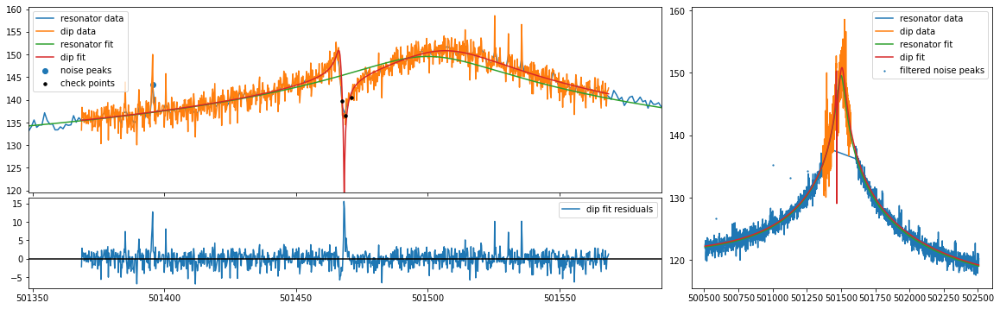

mean fit residuals = 1.2e-02 +/- 6.8e-02
{'A': 1207989629294994.2, 'dA': 48886266761354.51, 'Q': 11058.802918684416, 'dQ': 299.07347162899396, 'offset': 560159930546.1648, 'doffset': 16776770665.778498, 'slope': -0.0015135019785534635, 'dslope': 3.7391685768027395e-05, 'nu_res': 501504.6415394407, 'dnu_res': 0.5329410848450169, 'nu_z': 501468.2877281719, 'dnu_z': 0.022602867335496993, 'dip_width': 6.96112757985399, 'ddip_width': 0.38865411948551853, 'pcov': array([[ 5.108896117861e-04,  1.645053602659e-03,  1.623023062151e+09,
         2.334080185813e-02, -7.050032353568e-04],
       [ 1.645053602659e-03,  1.510520245931e-01,  8.101728960839e+12,
         5.213608730582e+01, -1.683835483154e-02],
       [ 1.623023062152e+09,  8.101728960839e+12,  2.389867077862e+27,
         1.341348868667e+16, -2.341490990458e+12],
       [ 2.334080185813e-02,  5.213608730582e+01,  1.341348868667e+16,
         8.944494143222e+04, -3.041930869052e+01],
       [-7.050032353568e-04, -1.683835483154e-02, 

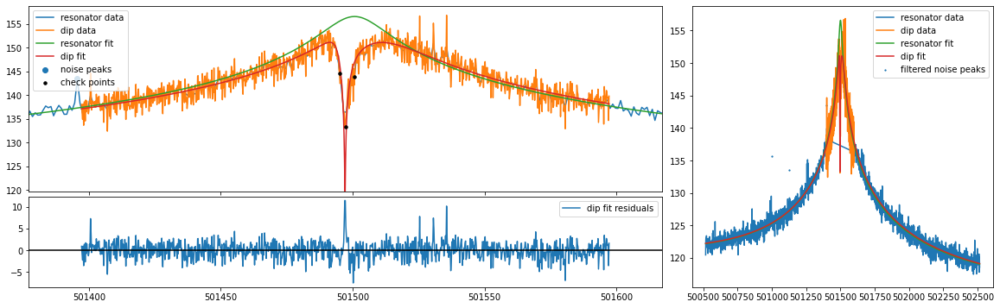

mean fit residuals = 1.0e-02 +/- 6.2e-02
{'A': 1290310055165053.8, 'dA': 48884882422840.56, 'Q': 11730.558687147506, 'dQ': 290.874527715322, 'offset': 586526940486.0195, 'doffset': 16843114013.469263, 'slope': -0.0015130020532650031, 'dslope': 3.759773329147477e-05, 'nu_res': 501505.3790036064, 'dnu_res': 0.4361515891606125, 'nu_z': 501497.09679597226, 'dnu_z': 0.0213526550415033, 'dip_width': 7.540787641872351, 'ddip_width': 0.36680165665577835, 'pcov': array([[ 4.559358773214e-04,  3.326255425567e-04,  3.972863013106e+08,
         2.366544461037e-03, -5.867288820313e-04],
       [ 3.326255425567e-04,  1.345434553254e-01,  8.163369503695e+12,
         5.100440193222e+01, -3.064572347844e-03],
       [ 3.972863013095e+08,  8.163369503695e+12,  2.389731729495e+27,
         1.316731505811e+16, -5.046281594774e+11],
       [ 2.366544461032e-03,  5.100440193222e+01,  1.316731505811e+16,
         8.460799087361e+04, -5.136503469306e+00],
       [-5.867288820313e-04, -3.064572347845e-03, -5.

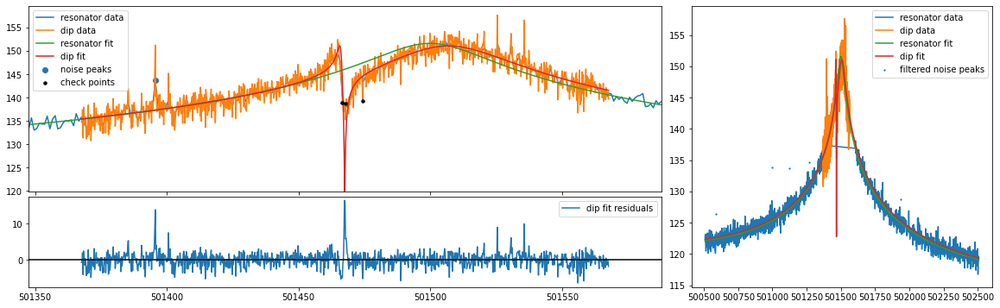

mean fit residuals = 1.2e-02 +/- 6.6e-02
{'A': 1270600558514357.5, 'dA': 50499221798743.55, 'Q': 11283.402621068128, 'dQ': 297.9509135852455, 'offset': 589384792817.737, 'doffset': 16895558711.195799, 'slope': -0.00150461838755107, 'dslope': 3.726891693840443e-05, 'nu_res': 501504.98068621237, 'dnu_res': 0.514108949827209, 'nu_z': 501467.4869362465, 'dnu_z': 0.021693327164506247, 'dip_width': 6.755246634876916, 'ddip_width': 0.3729354617832043, 'pcov': array([[ 4.706004434663e-04,  1.601762476723e-03,  1.720748961613e+09,
         2.367764365828e-02, -6.475021296412e-04],
       [ 1.601762476723e-03,  1.390808586555e-01,  7.952933763222e+12,
         4.935006066674e+01, -1.575828263029e-02],
       [ 1.720748961613e+09,  7.952933763222e+12,  2.550171402279e+27,
         1.382011469023e+16, -2.351151891412e+12],
       [ 2.367764365828e-02,  4.935006066674e+01,  1.382011469023e+16,
         8.877474690628e+04, -2.966578889502e+01],
       [-6.475021296412e-04, -1.575828263029e-02, -2.35

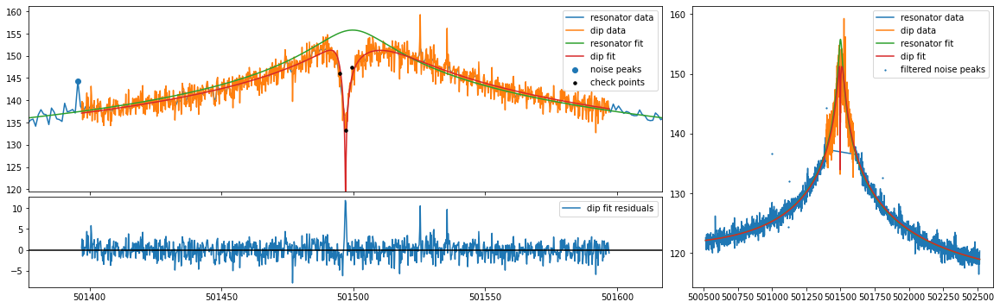

mean fit residuals = 9.1e-03 +/- 6.1e-02
{'A': 1330545028683359.0, 'dA': 50611354734774.984, 'Q': 11987.47045899083, 'dQ': 296.6025229492387, 'offset': 559968824066.392, 'doffset': 16627503487.446505, 'slope': -0.0015349065790021597, 'dslope': 3.732984453107859e-05, 'nu_res': 501504.7168873954, 'dnu_res': 0.42746799846491923, 'nu_z': 501497.0882227417, 'dnu_z': 0.020292904433356886, 'dip_width': 7.160137029060136, 'ddip_width': 0.35346394311940066, 'pcov': array([[ 4.118019703414e-04,  2.850660581971e-04,  4.186363906300e+08,
         2.515346463137e-03, -5.278676252281e-04],
       [ 2.850660581971e-04,  1.249367590855e-01,  8.030098960547e+12,
         4.938245792099e+01, -2.630111552461e-03],
       [ 4.186363906295e+08,  8.030098960547e+12,  2.561509228089e+27,
         1.392205357875e+16, -4.778922986591e+11],
       [ 2.515346463133e-03,  4.938245792099e+01,  1.392205357875e+16,
         8.797305661985e+04, -4.726921383444e+00],
       [-5.278676252281e-04, -2.630111552461e-03, -

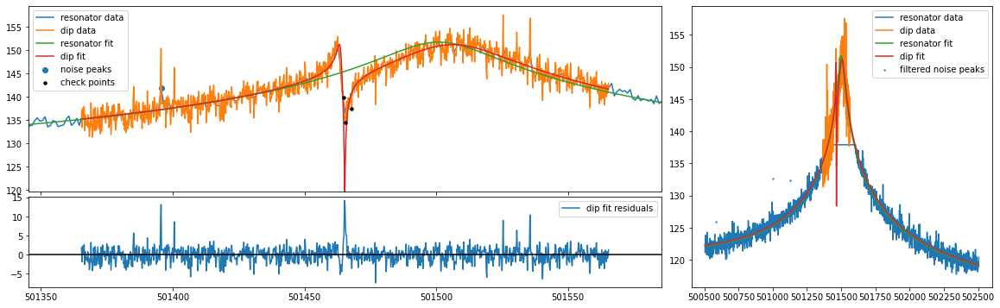

mean fit residuals = 1.1e-02 +/- 6.5e-02
{'A': 1319298479416346.8, 'dA': 52628356820315.09, 'Q': 11664.15991898874, 'dQ': 306.2252626920532, 'offset': 566474087653.6173, 'doffset': 16950581894.899624, 'slope': -0.0015183344823453547, 'dslope': 3.7744723274732135e-05, 'nu_res': 501504.3082886226, 'dnu_res': 0.4997571427317662, 'nu_z': 501465.29614765337, 'dnu_z': 0.02254187370787045, 'dip_width': 7.728463735164508, 'ddip_width': 0.40190270104409553, 'pcov': array([[ 5.081360702616e-04,  1.850367919690e-03,  1.842661703646e+09,
         2.564109211236e-02, -6.926762361228e-04],
       [ 1.850367919690e-03,  1.615257811065e-01,  9.471478842269e+12,
         5.793255638938e+01, -1.769087565064e-02],
       [ 1.842661703646e+09,  9.471478842269e+12,  2.769743941606e+27,
         1.483425586846e+16, -2.379383122206e+12],
       [ 2.564109211236e-02,  5.793255638938e+01,  1.483425586846e+16,
         9.377391151082e+04, -2.981686927991e+01],
       [-6.926762361228e-04, -1.769087565064e-02, -

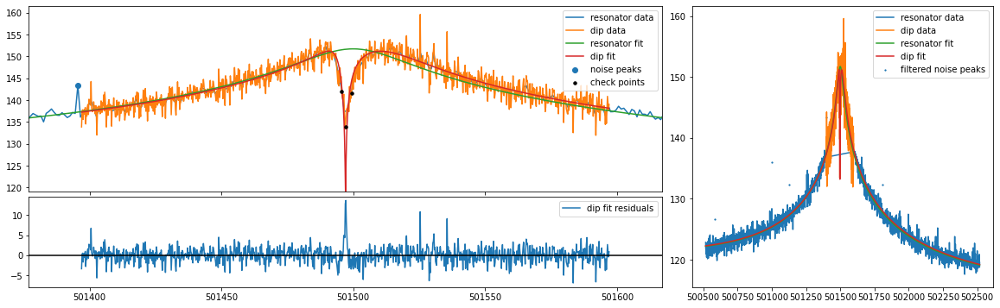

mean fit residuals = 1.2e-02 +/- 6.1e-02
{'A': 1318664917414472.0, 'dA': 49895245669608.59, 'Q': 11793.42807050893, 'dQ': 291.6203976191564, 'offset': 596222427272.1241, 'doffset': 17260921260.656, 'slope': -0.001477028258517703, 'dslope': 3.82333135110992e-05, 'nu_res': 501504.1988379483, 'dnu_res': 0.4328243490329507, 'nu_z': 501497.08767087845, 'dnu_z': 0.021762472615450966, 'dip_width': 7.869348717348106, 'ddip_width': 0.37537594617910147, 'pcov': array([[ 4.736052143383e-04,  2.830503604905e-04,  2.689591473701e+08,
         7.877897675024e-04, -6.079257759537e-04],
       [ 2.830503604905e-04,  1.409071009699e-01,  8.678670271152e+12,
         5.326116629643e+01, -2.748970339042e-03],
       [ 2.689591473697e+08,  8.678670271152e+12,  2.489535540431e+27,
         1.347919670046e+16, -4.553672646395e+11],
       [ 7.877897674996e-04,  5.326116629643e+01,  1.347919670046e+16,
         8.504245630755e+04, -4.468445853952e+00],
       [-6.079257759537e-04, -2.748970339041e-03, -4.553

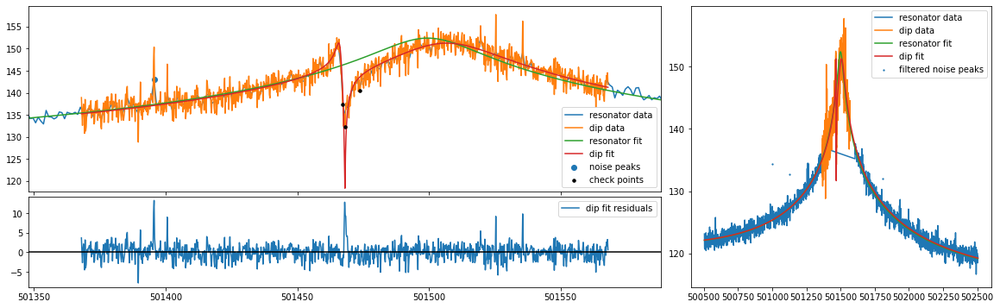

mean fit residuals = 1.4e-02 +/- 6.5e-02
{'A': 1334590369906238.0, 'dA': 53605883374924.58, 'Q': 11910.954225874393, 'dQ': 312.8870628694031, 'offset': 584688711749.9432, 'doffset': 17004573362.314877, 'slope': -0.0014510473776729194, 'dslope': 3.759359713535706e-05, 'nu_res': 501504.45380076463, 'dnu_res': 0.48581760374830174, 'nu_z': 501468.0635830319, 'dnu_z': 0.02460479370264615, 'dip_width': 8.594587479510205, 'ddip_width': 0.4282004465772922, 'pcov': array([[ 6.053958731498e-04,  1.992123429586e-03,  1.037589936199e+09,
         1.715610535917e-02, -8.045896471249e-04],
       [ 1.992123429586e-03,  1.833556224490e-01,  1.077912935862e+13,
         6.611387583890e+01, -1.790821568235e-02],
       [ 1.037589936200e+09,  1.077912935862e+13,  2.873590732406e+27,
         1.547619526760e+16, -2.198014625891e+12],
       [ 1.715610535917e-02,  6.611387583890e+01,  1.547619526760e+16,
         9.789831411104e+04, -2.716107783059e+01],
       [-8.045896471249e-04, -1.790821568235e-02, -

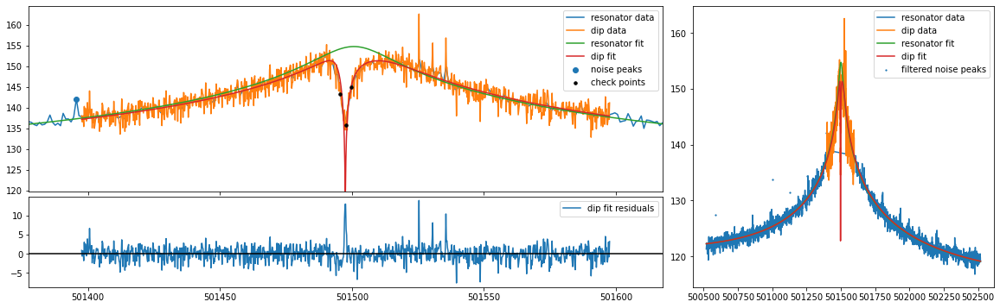

mean fit residuals = 1.0e-02 +/- 6.4e-02
{'A': 1348296508439835.5, 'dA': 53393960959326.72, 'Q': 12128.76790070507, 'dQ': 311.44736419683403, 'offset': 598702177243.4327, 'doffset': 16831232915.371096, 'slope': -0.0015047147553504255, 'dslope': 3.7273406822521655e-05, 'nu_res': 501504.0967722531, 'dnu_res': 0.43913972856963474, 'nu_z': 501497.48933160555, 'dnu_z': 0.021214806056517783, 'dip_width': 7.092737361455308, 'ddip_width': 0.36453545220283745, 'pcov': array([[ 4.500679960157e-04,  2.676385538358e-04,  3.597916073183e+08,
         1.506620022237e-03, -5.734696886708e-04],
       [ 2.676385538358e-04,  1.328860959127e-01,  8.725546327232e+12,
         5.340825096306e+01, -2.334604437127e-03],
       [ 3.597916073179e+08,  8.725546327232e+12,  2.850915066926e+27,
         1.543484302442e+16, -4.425555071650e+11],
       [ 1.506620022235e-03,  5.340825096306e+01,  1.543484302442e+16,
         9.699946066516e+04, -4.227846029409e+00],
       [-5.734696886708e-04, -2.334604437127e-03

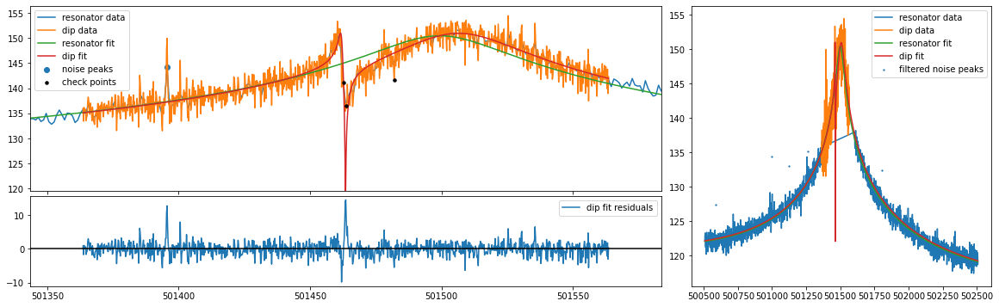

mean fit residuals = 1.2e-02 +/- 6.6e-02
{'A': 1243681433510669.5, 'dA': 49258599824976.47, 'Q': 11279.100558950176, 'dQ': 297.0863183099819, 'offset': 560869522094.5448, 'doffset': 16811283853.58341, 'slope': -0.0014468302573002957, 'dslope': 3.734366303164738e-05, 'nu_res': 501504.76129139966, 'dnu_res': 0.5225599972141511, 'nu_z': 501463.4895392127, 'dnu_z': 0.022273079681339108, 'dip_width': 7.262197671832483, 'ddip_width': 0.38992118519495966, 'pcov': array([[ 4.960900784913e-04,  1.849369346917e-03,  1.747126838809e+09,
         2.663464874228e-02, -6.915239194090e-04],
       [ 1.849369346917e-03,  1.520385306638e-01,  8.305383714863e+12,
         5.269741425378e+01, -1.866084879902e-02],
       [ 1.747126838810e+09,  8.305383714863e+12,  2.426409656717e+27,
         1.341926600844e+16, -2.482739875053e+12],
       [ 2.663464874228e-02,  5.269741425378e+01,  1.341926600844e+16,
         8.826028052698e+04, -3.306967814821e+01],
       [-6.915239194090e-04, -1.866084879902e-02, -

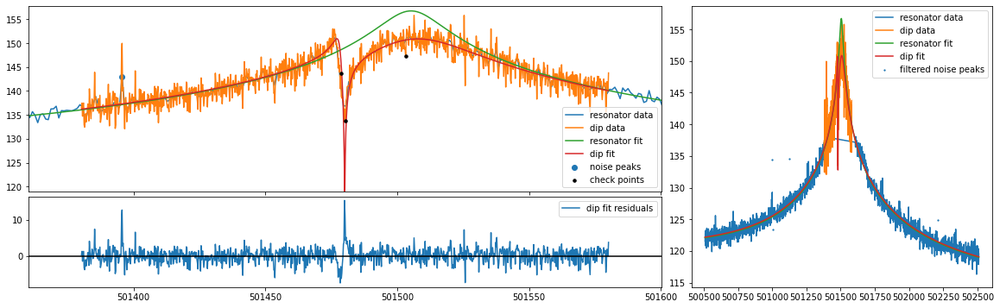

mean fit residuals = 1.1e-02 +/- 6.6e-02
{'A': 1224842460364171.8, 'dA': 48358946732130.31, 'Q': 11091.305293218162, 'dQ': 291.7394501625288, 'offset': 534665125645.45984, 'doffset': 16960959840.620924, 'slope': -0.0015330022503920369, 'dslope': 3.7622160854761273e-05, 'nu_res': 501504.95683527086, 'dnu_res': 0.4974021477123837, 'nu_z': 501480.0842512671, 'dnu_z': 0.02212474879218661, 'dip_width': 7.25822377379394, 'ddip_width': 0.38379803427632253, 'pcov': array([[ 4.895045091174e-04,  1.068773061188e-03,  1.109728557988e+09,
         1.368690757817e-02, -6.562291698875e-04],
       [ 1.068773061188e-03,  1.473009311144e-01,  8.155903385088e+12,
         5.171167265711e+01, -1.109059386746e-02],
       [ 1.109728557988e+09,  8.155903385088e+12,  2.338587729041e+27,
         1.298787647571e+16, -1.589028568558e+12],
       [ 1.368690757817e-02,  5.171167265711e+01,  1.298787647571e+16,
         8.511190678113e+04, -1.901683732183e+01],
       [-6.562291698875e-04, -1.109059386746e-02, 

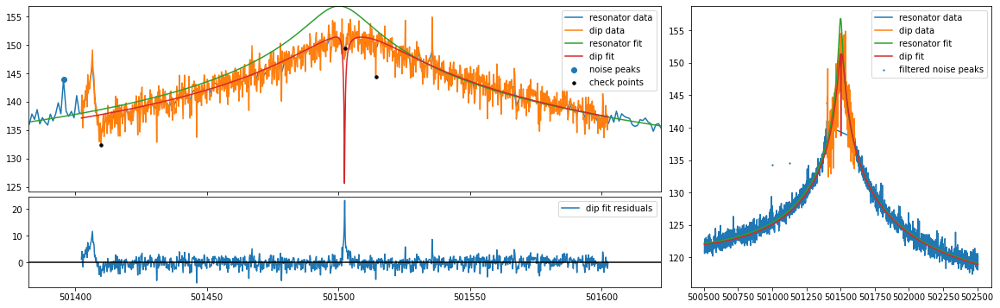

mean fit residuals = 1.3e-02 +/- 7.2e-02
{'A': 1374139683938799.5, 'dA': 62722484850193.914, 'Q': 12630.695780917134, 'dQ': 369.67546499258776, 'offset': 563665387625.5166, 'doffset': 16974358437.943281, 'slope': -0.0015475908820399105, 'dslope': 3.786307947104481e-05, 'nu_res': 501505.61219548533, 'dnu_res': 0.48298508456727873, 'nu_z': 501502.3478499812, 'dnu_z': 0.013914934853537508, 'dip_width': 2.035293364351914, 'ddip_width': 0.20448733570915648, 'pcov': array([[ 1.936254119782e-04, -5.174420157378e-04, -6.604854034670e+09,
        -7.168618911170e-02, -2.461856962416e-04],
       [-5.174420157378e-04,  4.181507046543e-02,  3.380552942582e+12,
         2.093594300577e+01,  3.522961300748e-04],
       [-6.604854034669e+09,  3.380552942582e+12,  3.934110105783e+27,
         2.158288922885e+16, -3.184496761127e+11],
       [-7.168618911170e-02,  2.093594300577e+01,  2.158288922885e+16,
         1.366599494175e+05, -2.487168729909e+00],
       [-2.461856962416e-04,  3.522961300754e-0

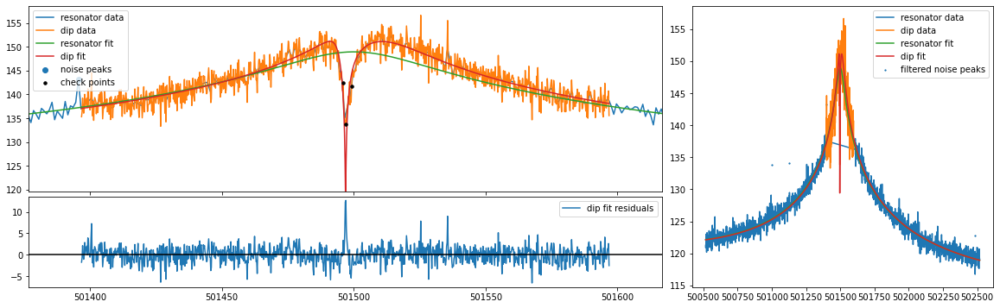

mean fit residuals = 1.1e-02 +/- 6.2e-02
{'A': 1296628800508123.5, 'dA': 49769367221334.96, 'Q': 11874.412736899914, 'dQ': 297.2742410432651, 'offset': 555474380802.7208, 'doffset': 16734031551.125721, 'slope': -0.001542605259405503, 'dslope': 3.739104269518631e-05, 'nu_res': 501504.8310997478, 'dnu_res': 0.43600220612848267, 'nu_z': 501496.8986780686, 'dnu_z': 0.021459224682767473, 'dip_width': 7.730582805469459, 'ddip_width': 0.37540919213662716, 'pcov': array([[ 4.604983239855e-04,  3.260454206676e-04,  4.310365020787e+08,
         2.639197971043e-03, -5.911172659562e-04],
       [ 3.260454206676e-04,  1.409320615407e-01,  8.615838670669e+12,
         5.401874548302e+01, -3.065391548769e-03],
       [ 4.310365020774e+08,  8.615838670669e+12,  2.476989913612e+27,
         1.371220645628e+16, -5.010606896876e+11],
       [ 2.639197971034e-03,  5.401874548302e+01,  1.371220645628e+16,
         8.837197438785e+04, -5.085644952217e+00],
       [-5.911172659562e-04, -3.065391548770e-03, -

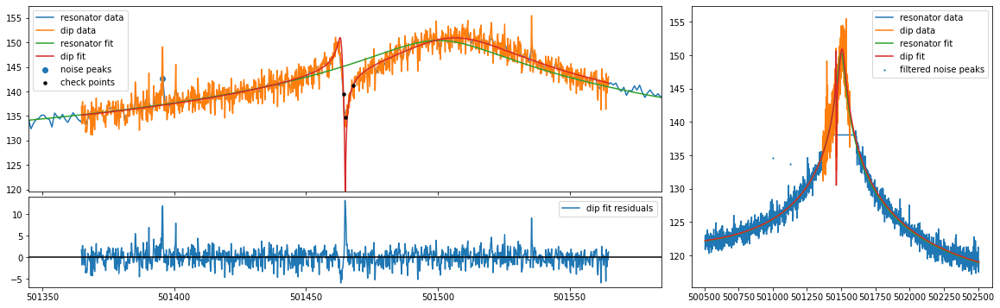

mean fit residuals = 1.0e-02 +/- 6.2e-02
{'A': 1240838774124482.8, 'dA': 46441699278704.0, 'Q': 11342.933391446466, 'dQ': 281.7551491150339, 'offset': 546143412675.32214, 'doffset': 17428596991.28314, 'slope': -0.0016094469602128591, 'dslope': 3.88359636149072e-05, 'nu_res': 501504.7699520296, 'dnu_res': 0.4873565252264808, 'nu_z': 501464.8918759603, 'dnu_z': 0.021003861103088887, 'dip_width': 7.362032829278506, 'ddip_width': 0.36994950405668614, 'pcov': array([[ 4.411621812379e-04,  1.598036728486e-03,  1.567629595777e+09,
         2.310964028078e-02, -6.112426931519e-04],
       [ 1.598036728486e-03,  1.368626355518e-01,  7.496354959435e+12,
         4.782916030780e+01, -1.613200902468e-02],
       [ 1.567629595777e+09,  7.496354959435e+12,  2.156831431894e+27,
         1.201197118281e+16, -2.143400820955e+12],
       [ 2.310964028078e-02,  4.782916030780e+01,  1.201197118281e+16,
         7.938596405283e+04, -2.826662174217e+01],
       [-6.112426931519e-04, -1.613200902468e-02, -2.

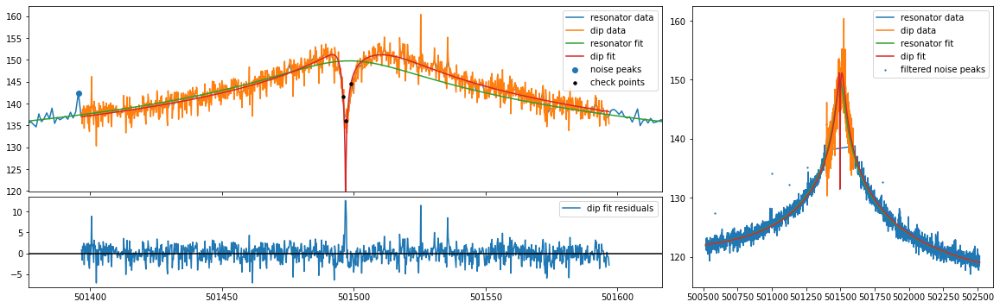

mean fit residuals = 8.3e-03 +/- 6.3e-02
{'A': 1307654150980983.0, 'dA': 50926642088297.23, 'Q': 11913.085869480276, 'dQ': 302.3082006267909, 'offset': 560765578675.8342, 'doffset': 16550760524.13605, 'slope': -0.00146857422477711, 'dslope': 3.702100060993394e-05, 'nu_res': 501505.60683466395, 'dnu_res': 0.440890734661377, 'nu_z': 501496.9123438131, 'dnu_z': 0.01992582288841155, 'dip_width': 6.405907173483849, 'ddip_width': 0.33882259419027605, 'pcov': array([[ 3.970384177803e-04,  2.817275891425e-04,  7.528821679741e+07,
        -7.326179170234e-04, -5.099068225069e-04],
       [ 2.817275891425e-04,  1.148007503338e-01,  7.405390351716e+12,
         4.612597752502e+01, -2.809877023973e-03],
       [ 7.528821679625e+07,  7.405390351716e+12,  2.593522874390e+27,
         1.427182690096e+16, -5.526180823287e+11],
       [-7.326179170297e-04,  4.612597752502e+01,  1.427182690096e+16,
         9.139024816621e+04, -5.704339708766e+00],
       [-5.099068225069e-04, -2.809877023974e-03, -5.52

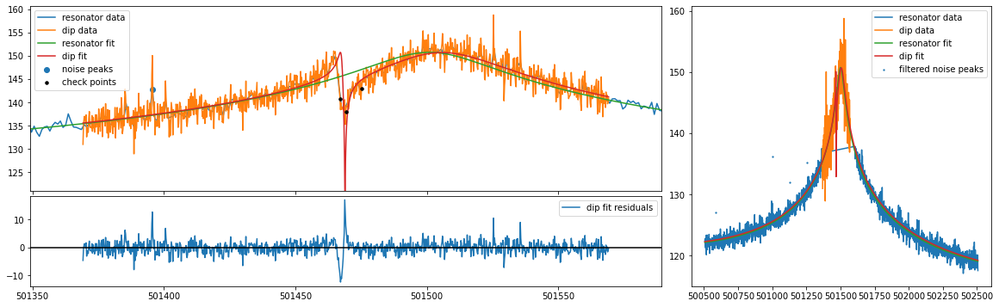

mean fit residuals = 8.5e-03 +/- 7.4e-02
{'A': 1172397897996047.2, 'dA': 51197386305745.73, 'Q': 10862.532211479778, 'dQ': 318.64536665599127, 'offset': 565178843505.8341, 'doffset': 16893157709.550026, 'slope': -0.0015210554203818024, 'dslope': 3.743615509909478e-05, 'nu_res': 501504.20497103134, 'dnu_res': 0.5843395646407507, 'nu_z': 501468.8990398248, 'dnu_z': 0.022586322401632476, 'dip_width': 5.619323235663128, 'ddip_width': 0.37080762969285985, 'pcov': array([[ 5.101419596305e-04,  1.565794979719e-03,  1.528500041783e+09,
         2.206866218285e-02, -7.085852730773e-04],
       [ 1.565794979719e-03,  1.374982982384e-01,  7.405663463218e+12,
         4.847008915946e+01, -1.592653386939e-02],
       [ 1.528500041784e+09,  7.405663463218e+12,  2.621172364540e+27,
         1.495134939744e+16, -2.674742610303e+12],
       [ 2.206866218285e-02,  4.847008915946e+01,  1.495134939744e+16,
         1.015348696913e+05, -3.513161722021e+01],
       [-7.085852730773e-04, -1.592653386939e-02,

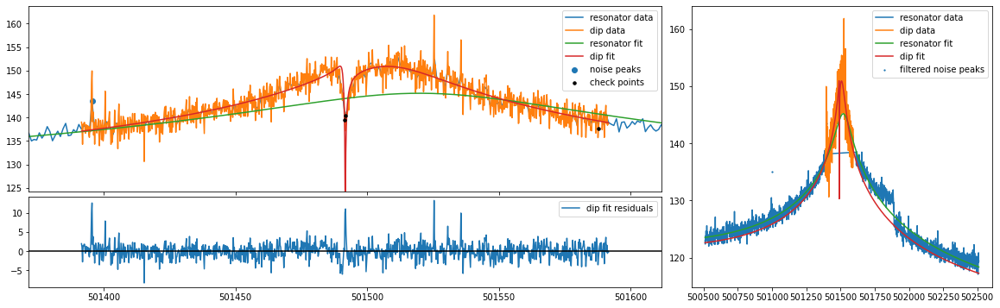

mean fit residuals = -1.7e-03 +/- 6.5e-02
{'A': 1233644601002463.2, 'dA': 47896891853191.875, 'Q': 11015.09583869027, 'dQ': 284.8502245131668, 'offset': 354608219090.6851, 'doffset': 26987583532.160732, 'slope': -0.0026541026626957587, 'dslope': 4.958911676176542e-05, 'nu_res': 501505.7499715459, 'dnu_res': 0.48087551804244566, 'nu_z': 501491.72057056724, 'dnu_z': 0.015523246393980488, 'dip_width': 2.775611668480893, 'ddip_width': 0.21208389008857018, 'pcov': array([[ 2.409711786082e-04,  2.390444458756e-06, -2.624778909981e+09,
        -2.945738741571e-02, -3.220455065745e-04],
       [ 2.390444458756e-06,  4.497957643510e-02,  3.025015826304e+12,
         1.883204161643e+01, -1.991337949060e-03],
       [-2.624778909981e+09,  3.025015826304e+12,  2.294112249196e+27,
         1.257927759048e+16, -1.006477283030e+12],
       [-2.945738741571e-02,  1.883204161643e+01,  1.257927759048e+16,
         8.113965040520e+04, -1.026705629832e+01],
       [-3.220455065745e-04, -1.991337949061e-03

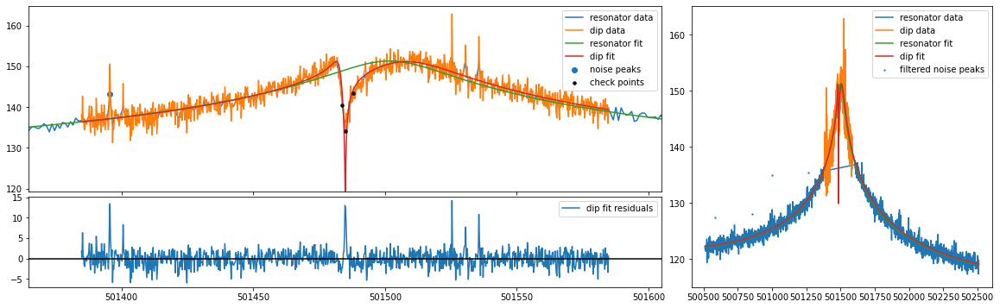

mean fit residuals = 1.0e-02 +/- 6.6e-02
{'A': 1306527042413646.0, 'dA': 53125887196625.71, 'Q': 11740.379679208192, 'dQ': 312.62071141910997, 'offset': 560503515031.6355, 'doffset': 16703716987.526619, 'slope': -0.001564396827506966, 'dslope': 3.732642405879166e-05, 'nu_res': 501504.7375884067, 'dnu_res': 0.47518144069880086, 'nu_z': 501484.88656077103, 'dnu_z': 0.02233606660227797, 'dip_width': 7.386288287962076, 'ddip_width': 0.39027589798790585, 'pcov': array([[ 4.988998712614e-04,  9.145889781607e-04,  1.022995602227e+09,
         1.101855589654e-02, -6.500424183436e-04],
       [ 9.145889781607e-04,  1.523152765503e-01,  9.320038979432e+12,
         5.758572008650e+01, -8.527746564851e-03],
       [ 1.022995602227e+09,  9.320038979432e+12,  2.822359890429e+27,
         1.536516748562e+16, -1.300902476935e+12],
       [ 1.101855589654e-02,  5.758572008650e+01,  1.536516748562e+16,
         9.773170920819e+04, -1.471284862186e+01],
       [-6.500424183436e-04, -8.527746564852e-03, 

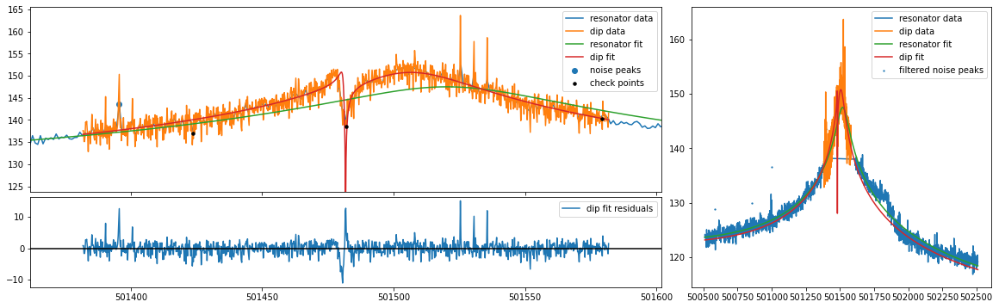

mean fit residuals = 1.3e-03 +/- 6.8e-02
{'A': 1191941383699215.8, 'dA': 47329133325809.36, 'Q': 10490.791563407363, 'dQ': 282.02326247082357, 'offset': 439999686632.9219, 'doffset': 26221848341.178833, 'slope': -0.0026972470199520563, 'dslope': 4.849272748613057e-05, 'nu_res': 501505.12578256865, 'dnu_res': 0.5297333259471126, 'nu_z': 501481.70913067984, 'dnu_z': 0.017437843990892505, 'dip_width': 3.3141563406860755, 'ddip_width': 0.2462479880989707, 'pcov': array([[ 3.040784030507e-04,  4.478233829446e-04, -7.372276710705e+08,
        -8.534378123014e-03, -4.184114952232e-04],
       [ 4.478233829446e-04,  6.063807164279e-02,  3.676504752507e+12,
         2.295547548727e+01, -5.267086443253e-03],
       [-7.372276710703e+08,  3.676504752507e+12,  2.240046861372e+27,
         1.224574061004e+16, -1.751848198094e+12],
       [-8.534378123013e-03,  2.295547548727e+01,  1.224574061004e+16,
         7.953712057469e+04, -1.952809772153e+01],
       [-4.184114952232e-04, -5.267086443253e-03

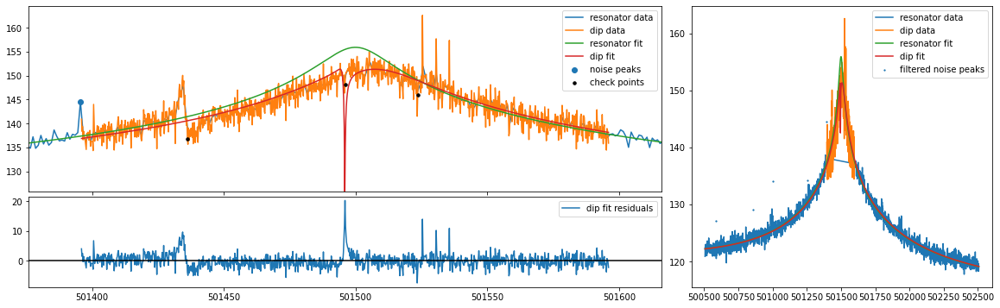

mean fit residuals = 1.5e-02 +/- 7.4e-02
{'A': 1356381479250038.2, 'dA': 62660270169880.82, 'Q': 12199.257210693517, 'dQ': 364.75060407820234, 'offset': 588885471472.1467, 'doffset': 16216268297.161745, 'slope': -0.001538009072248422, 'dslope': 3.5993946325163596e-05, 'nu_res': 501505.4933456132, 'dnu_res': 0.5093362987193869, 'nu_z': 501495.9338686892, 'dnu_z': 0.016367354570612436, 'dip_width': 2.042133042962223, 'ddip_width': 0.20674859405630386, 'pcov': array([[ 2.678902956401e-04, -3.025948564373e-04, -5.987272653523e+09,
        -6.424081098575e-02, -3.428611608847e-04],
       [-3.025948564373e-04,  4.274498114426e-02,  3.429346835087e+12,
         2.091911515502e+01, -6.978878084538e-04],
       [-5.987272653522e+09,  3.429346835087e+12,  3.926309457762e+27,
         2.122252505667e+16, -8.112793644533e+11],
       [-6.424081098574e-02,  2.091911515502e+01,  2.122252505667e+16,
         1.330430031754e+05, -8.229352481826e+00],
       [-3.428611608847e-04, -6.978878084533e-04, 

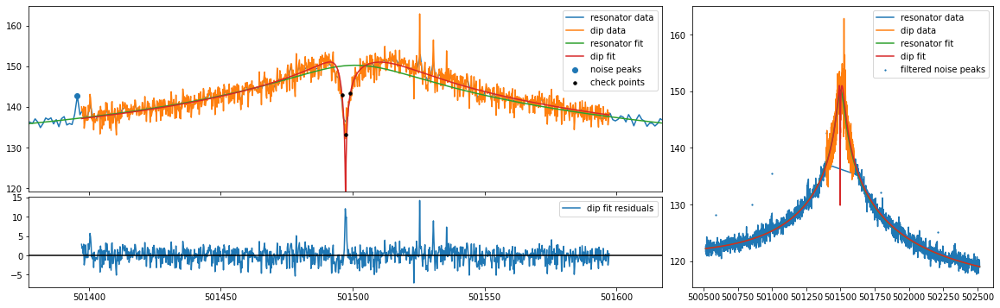

mean fit residuals = 9.7e-03 +/- 6.3e-02
{'A': 1261158939649109.8, 'dA': 48826222828980.375, 'Q': 11691.096487497658, 'dQ': 296.5087097116607, 'offset': 582984955465.0612, 'doffset': 16501983901.8166, 'slope': -0.0015560451105308887, 'dslope': 3.6454031976022775e-05, 'nu_res': 501504.4808673069, 'dnu_res': 0.44699525131166606, 'nu_z': 501497.2849813941, 'dnu_z': 0.02145705299209519, 'dip_width': 7.192215393359733, 'ddip_width': 0.36450479887735093, 'pcov': array([[ 4.604051231056e-04,  2.833360657880e-04,  3.497753867846e+08,
         1.664514390765e-03, -5.930490232766e-04],
       [ 2.833360657880e-04,  1.328637484046e-01,  7.950868699874e+12,
         5.070354759079e+01, -2.718237281297e-03],
       [ 3.497753867835e+08,  7.950868699874e+12,  2.384000035745e+27,
         1.340374909783e+16, -4.734882693327e+11],
       [ 1.664514390759e-03,  5.070354759079e+01,  1.340374909783e+16,
         8.791741493487e+04, -4.790767440094e+00],
       [-5.930490232766e-04, -2.718237281297e-03, -

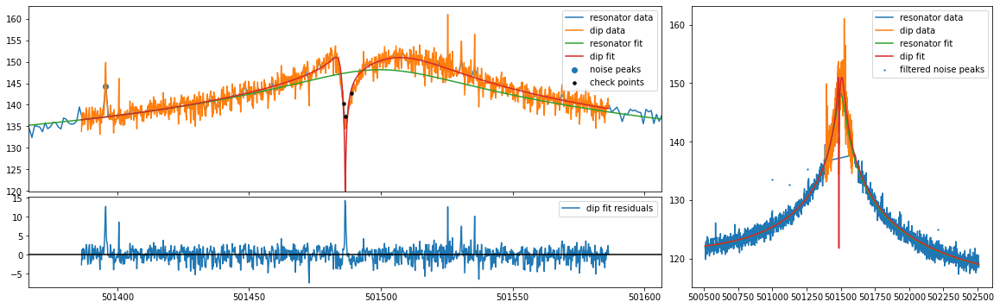

mean fit residuals = 9.5e-03 +/- 6.5e-02
{'A': 1260943399006780.8, 'dA': 49951390730799.24, 'Q': 11537.27610904196, 'dQ': 300.69231943729926, 'offset': 549946113805.1669, 'doffset': 16625350211.925241, 'slope': -0.0015449569938653202, 'dslope': 3.709616376350771e-05, 'nu_res': 501503.95178383344, 'dnu_res': 0.4697119433298944, 'nu_z': 501486.5079258397, 'dnu_z': 0.020918009250805846, 'dip_width': 6.610435623450261, 'ddip_width': 0.3567660375759041, 'pcov': array([[ 4.375631110168e-04,  6.758526223908e-04,  6.231412978152e+08,
         6.530726356212e-03, -5.718772693269e-04],
       [ 6.758526223908e-04,  1.272820055676e-01,  7.656635815728e+12,
         4.839330114184e+01, -6.549802147587e-03],
       [ 6.231412978147e+08,  7.656635815728e+12,  2.495141435941e+27,
         1.388320632542e+16, -1.098340687346e+12],
       [ 6.530726356210e-03,  4.839330114184e+01,  1.388320632542e+16,
         9.041587096858e+04, -1.253755584588e+01],
       [-5.718772693269e-04, -6.549802147587e-03, -

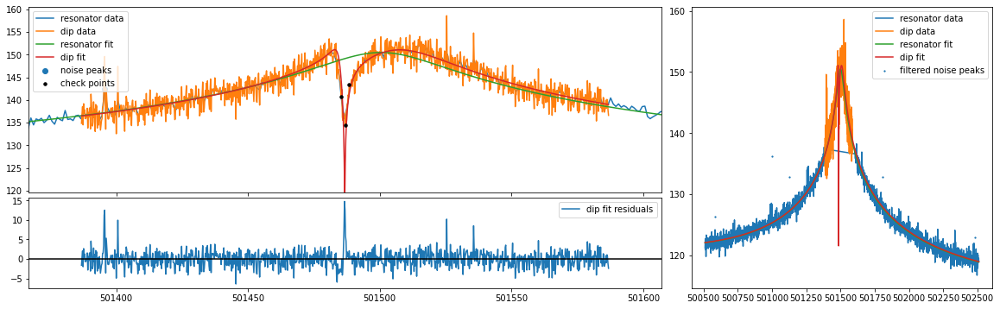

mean fit residuals = 1.1e-02 +/- 6.6e-02
{'A': 1276312243956579.0, 'dA': 51936294511105.82, 'Q': 11712.70012116262, 'dQ': 312.2289566870453, 'offset': 541315213480.90326, 'doffset': 16259161515.586302, 'slope': -0.0015321095631662754, 'dslope': 3.6996094596662077e-05, 'nu_res': 501503.8554973804, 'dnu_res': 0.4742512637249081, 'nu_z': 501486.6950470546, 'dnu_z': 0.02235978990897952, 'dip_width': 7.430608599119745, 'ddip_width': 0.3915588228233764, 'pcov': array([[ 4.999602047737e-04,  7.879083052924e-04,  8.493826688736e+08,
         8.824148500627e-03, -6.497692543748e-04],
       [ 7.879083052925e-04,  1.533183117308e-01,  9.175718945315e+12,
         5.791409778896e+01, -7.353945192792e-03],
       [ 8.493826688740e+08,  9.175718945315e+12,  2.697378687544e+27,
         1.500509796391e+16, -1.105930573705e+12],
       [ 8.824148500629e-03,  5.791409778896e+01,  1.500509796391e+16,
         9.748692139388e+04, -1.257111965013e+01],
       [-6.497692543748e-04, -7.353945192792e-03, -1

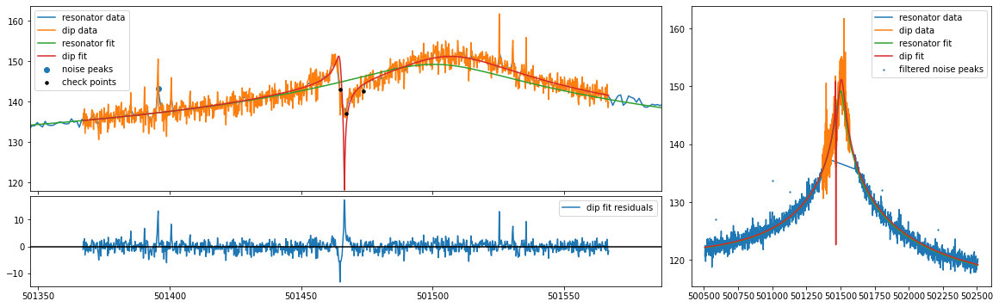

mean fit residuals = 1.7e-02 +/- 6.9e-02
{'A': 1317469762900999.8, 'dA': 55736520710159.445, 'Q': 11626.400154349147, 'dQ': 323.9511094334786, 'offset': 562409494657.4825, 'doffset': 17080847103.791008, 'slope': -0.0015105033610306017, 'dslope': 3.753424608563538e-05, 'nu_res': 501504.7897567047, 'dnu_res': 0.5294170936884955, 'nu_z': 501466.46787927, 'dnu_z': 0.024913892658851983, 'dip_width': 8.117225935665926, 'ddip_width': 0.43936210585615176, 'pcov': array([[ 6.207020474168e-04,  2.136480506652e-03,  1.361095811838e+09,
         2.128827335135e-02, -8.382121375965e-04],
       [ 2.136480506652e-03,  1.930390600624e-01,  1.118041738234e+13,
         6.831087804090e+01, -2.041858239282e-02],
       [ 1.361095811838e+09,  1.118041738234e+13,  3.106559740874e+27,
         1.662195582458e+16, -2.621259617059e+12],
       [ 2.128827335135e-02,  6.831087804090e+01,  1.662195582458e+16,
         1.049443213032e+05, -3.257745652913e+01],
       [-8.382121375965e-04, -2.041858239282e-02, -2

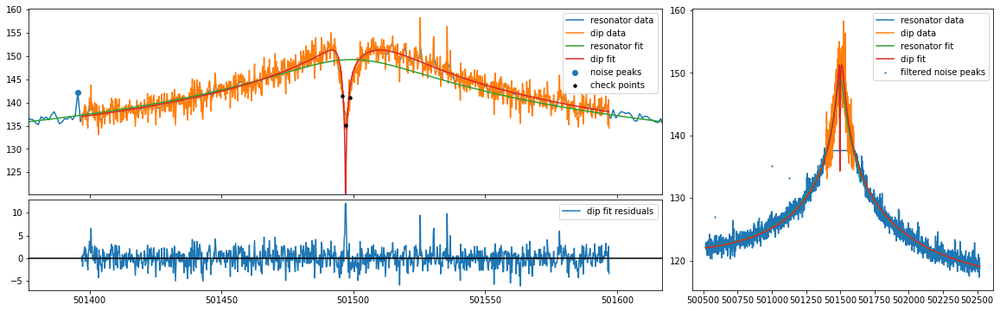

mean fit residuals = 8.4e-03 +/- 6.2e-02
{'A': 1346729653183444.5, 'dA': 52526339812869.14, 'Q': 12226.013419277322, 'dQ': 308.52524230388696, 'offset': 577907610918.1493, 'doffset': 16985274426.231428, 'slope': -0.0014466632754285588, 'dslope': 3.798837009629592e-05, 'nu_res': 501505.0298003005, 'dnu_res': 0.4291137063531655, 'nu_z': 501497.10654523986, 'dnu_z': 0.019938288773627653, 'dip_width': 6.565715529447742, 'ddip_width': 0.3412130313435466, 'pcov': array([[ 3.975353592206e-04,  2.741108317864e-04,  2.021967286827e+08,
         4.396746952038e-04, -5.063209046424e-04],
       [ 2.741108317864e-04,  1.164263327587e-01,  7.814122082983e+12,
         4.814296509132e+01, -2.514879849570e-03],
       [ 2.021967286823e+08,  7.814122082983e+12,  2.759016374137e+27,
         1.504914544171e+16, -4.976961627818e+11],
       [ 4.396746952011e-04,  4.814296509132e+01,  1.504914544171e+16,
         9.518782513867e+04, -5.015236719594e+00],
       [-5.063209046424e-04, -2.514879849569e-03, 

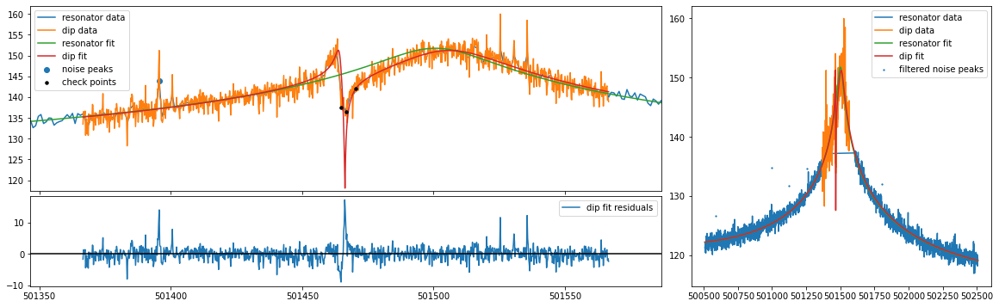

mean fit residuals = 1.9e-02 +/- 7.0e-02
{'A': 1325538352323727.8, 'dA': 57389875593918.98, 'Q': 11915.246422723458, 'dQ': 337.3991546305509, 'offset': 579421750634.5425, 'doffset': 16937558584.242725, 'slope': -0.0015373143595265408, 'dslope': 3.7382420861444404e-05, 'nu_res': 501503.5364737136, 'dnu_res': 0.5247908227340718, 'nu_z': 501466.26735956635, 'dnu_z': 0.028120756763742198, 'dip_width': 9.577106503424728, 'ddip_width': 0.49450899721927233, 'pcov': array([[ 7.907769609656e-04,  2.669339381951e-03,  1.276291364485e+09,
         2.177893971680e-02, -1.051486183474e-03],
       [ 2.669339381951e-03,  2.445391483308e-01,  1.385973587719e+13,
         8.562729384112e+01, -2.360221597338e-02],
       [ 1.276291364485e+09,  1.385973587719e+13,  3.293597820685e+27,
         1.786402326574e+16, -2.573600132036e+12],
       [ 2.177893971680e-02,  8.562729384112e+01,  1.786402326574e+16,
         1.138381895454e+05, -3.206560955841e+01],
       [-1.051486183474e-03, -2.360221597338e-02,

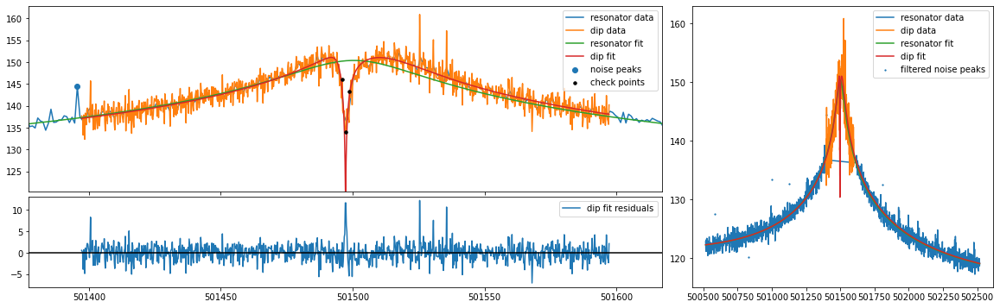

mean fit residuals = 8.1e-03 +/- 6.1e-02
{'A': 1274256763809757.5, 'dA': 48039711357667.92, 'Q': 11693.745845046486, 'dQ': 288.7577827212611, 'offset': 580216194432.5317, 'doffset': 16796251878.871347, 'slope': -0.00154503463585036, 'dslope': 3.7353485884231456e-05, 'nu_res': 501504.7312801778, 'dnu_res': 0.43512353502552464, 'nu_z': 501497.29677341814, 'dnu_z': 0.01983663292781018, 'dip_width': 6.5313909339387655, 'ddip_width': 0.33436871657325967, 'pcov': array([[ 3.934920059127e-04,  2.550834855962e-04,  3.524326308679e+08,
         1.982206212881e-03, -5.079515569418e-04],
       [ 2.550834855962e-04,  1.118024386228e-01,  6.914552264222e+12,
         4.363269601906e+01, -2.417801217617e-03],
       [ 3.524326308680e+08,  6.914552264222e+12,  2.307813867328e+27,
         1.284355495962e+16, -4.653298105526e+11],
       [ 1.982206212883e-03,  4.363269601906e+01,  1.284355495962e+16,
         8.338105708210e+04, -4.695569859051e+00],
       [-5.079515569418e-04, -2.417801217616e-03, 

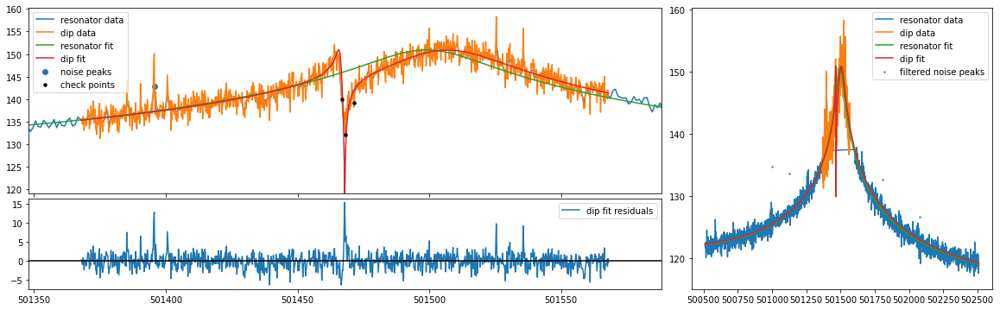

mean fit residuals = 1.3e-02 +/- 6.7e-02
{'A': 1224468101940677.5, 'dA': 49108950115800.23, 'Q': 11251.316458673897, 'dQ': 300.0775924152529, 'offset': 583029693165.6038, 'doffset': 17316272538.577534, 'slope': -0.001510341207617343, 'dslope': 3.841069582194403e-05, 'nu_res': 501504.7211535379, 'dnu_res': 0.5193678703978526, 'nu_z': 501467.901920322, 'dnu_z': 0.024156995527343825, 'dip_width': 7.998763362707945, 'ddip_width': 0.41761792630956635, 'pcov': array([[ 5.835604329081e-04,  1.939315879767e-03,  1.954229543949e+09,
         2.812912473817e-02, -7.996675734000e-04],
       [ 1.939315879767e-03,  1.744047323751e-01,  9.249580208881e+12,
         5.946047957505e+01, -1.882972683070e-02],
       [ 1.954229543949e+09,  9.249580208881e+12,  2.411688981476e+27,
         1.353460665191e+16, -2.286883979699e+12],
       [ 2.812912473817e-02,  5.946047957505e+01,  1.353460665191e+16,
         9.004656146973e+04, -2.977607602342e+01],
       [-7.996675734000e-04, -1.882972683070e-02, -2.

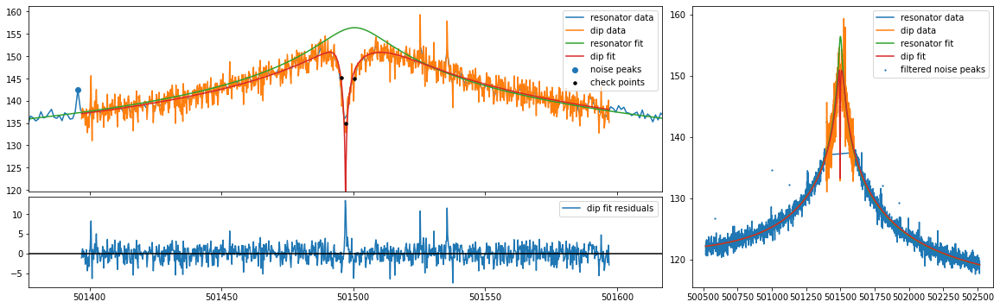

mean fit residuals = 1.0e-02 +/- 6.4e-02
{'A': 1227613641244450.8, 'dA': 48252928385191.88, 'Q': 11554.078118688753, 'dQ': 298.5273337821187, 'offset': 590908906513.7512, 'doffset': 16423284936.621609, 'slope': -0.001461691810067978, 'dslope': 3.6588313065301794e-05, 'nu_res': 501504.40524150175, 'dnu_res': 0.4597787025658041, 'nu_z': 501497.0962012436, 'dnu_z': 0.022437169442560703, 'dip_width': 7.409443516960619, 'ddip_width': 0.37871478732750297, 'pcov': array([[ 5.034265725942e-04,  3.150310839942e-04,  3.965465377351e+08,
         2.341711732515e-03, -6.499488797968e-04],
       [ 3.150310839942e-04,  1.434248901405e-01,  8.233447726777e+12,
         5.350853624114e+01, -3.014828009003e-03],
       [ 3.965465377344e+08,  8.233447726777e+12,  2.328345097746e+27,
         1.332532815014e+16, -4.887210703118e+11],
       [ 2.341711732511e-03,  5.350853624114e+01,  1.332532815014e+16,
         8.911856901506e+04, -5.114354604468e+00],
       [-6.499488797968e-04, -3.014828009004e-03, 

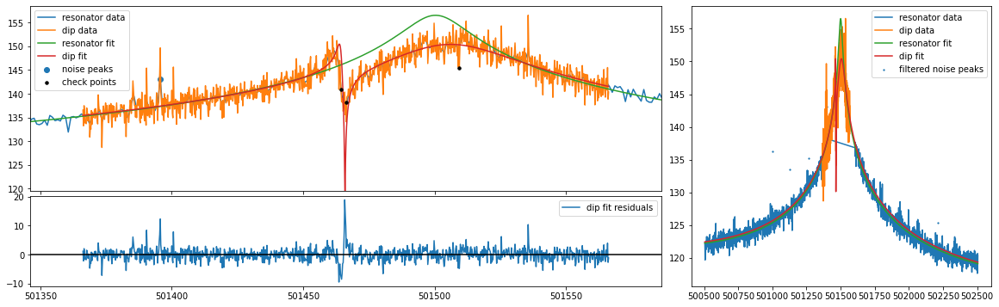

mean fit residuals = 1.5e-02 +/- 6.9e-02
{'A': 1100803940521418.6, 'dA': 44598080614536.76, 'Q': 10465.293024152883, 'dQ': 288.5121627131864, 'offset': 598641276224.2125, 'doffset': 16539987912.159975, 'slope': -0.0015544664475316758, 'dslope': 3.651301965979443e-05, 'nu_res': 501504.0305006789, 'dnu_res': 0.5754074152748074, 'nu_z': 501465.89223370195, 'dnu_z': 0.02458914616394774, 'dip_width': 7.183030831985891, 'ddip_width': 0.4062025797034388, 'pcov': array([[ 6.046261090720e-04,  1.921110220845e-03,  1.718933832853e+09,
         2.795592333686e-02, -8.558108760232e-04],
       [ 1.921110220845e-03,  1.650005357577e-01,  7.699070235758e+12,
         5.246606757894e+01, -2.070025783279e-02],
       [ 1.718933832853e+09,  7.699070235758e+12,  1.988988794501e+27,
         1.173910594278e+16, -2.509519936802e+12],
       [ 2.795592333686e-02,  5.246606757894e+01,  1.173910594278e+16,
         8.323926803344e+04, -3.516273966892e+01],
       [-8.558108760232e-04, -2.070025783279e-02, -2

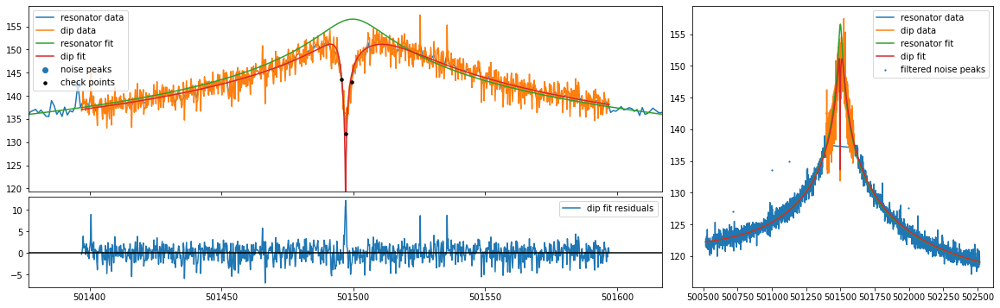

mean fit residuals = 9.6e-03 +/- 6.2e-02
{'A': 1301857623759019.0, 'dA': 49759000377647.38, 'Q': 11892.993316179523, 'dQ': 296.36953384559433, 'offset': 586112856515.3295, 'doffset': 16287032054.03287, 'slope': -0.0015346198465784147, 'dslope': 3.64190030236223e-05, 'nu_res': 501505.19855918066, 'dnu_res': 0.4334816652655642, 'nu_z': 501497.08802270266, 'dnu_z': 0.021170239974564308, 'dip_width': 7.397925052709914, 'ddip_width': 0.36387480552534535, 'pcov': array([[ 4.481790605806e-04,  3.204938361442e-04,  3.816687317814e+08,
         2.156063370805e-03, -5.744914853040e-04],
       [ 3.204938361442e-04,  1.324048740961e-01,  8.208489040325e+12,
         5.132491396664e+01, -2.969309027867e-03],
       [ 3.816687317805e+08,  8.208489040325e+12,  2.475958118583e+27,
         1.366877466794e+16, -5.049909963748e+11],
       [ 2.156063370799e-03,  5.132491396664e+01,  1.366877466794e+16,
         8.783490059185e+04, -5.132666400293e+00],
       [-5.744914853040e-04, -2.969309027868e-03, 

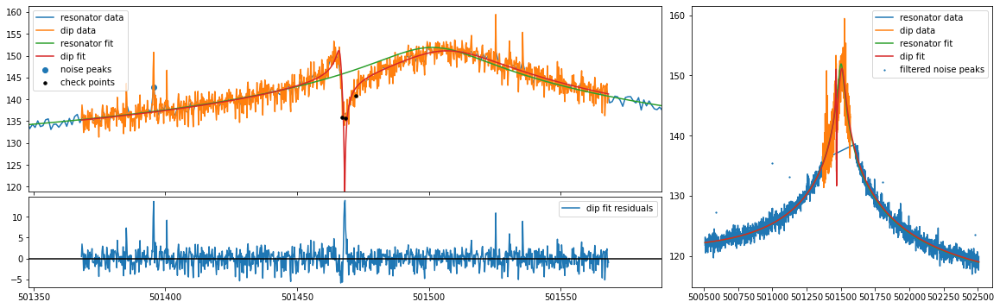

mean fit residuals = 1.3e-02 +/- 6.7e-02
{'A': 1293625666682645.2, 'dA': 53250336171065.51, 'Q': 11718.919937670156, 'dQ': 316.91664744494057, 'offset': 561365104222.8911, 'doffset': 16715192638.231813, 'slope': -0.0016010619621809714, 'dslope': 3.71945751869381e-05, 'nu_res': 501504.782127332, 'dnu_res': 0.5075699762293631, 'nu_z': 501468.0868124791, 'dnu_z': 0.023925703391299197, 'dip_width': 8.131279547865022, 'ddip_width': 0.4261718089759517, 'pcov': array([[ 5.724392827684e-04,  1.947510361337e-03,  1.760320596817e+09,
         2.465379411104e-02, -7.711950543623e-04],
       [ 1.947510361337e-03,  1.816224107658e-01,  1.040318900018e+13,
         6.507304683453e+01, -1.837722069617e-02],
       [ 1.760320596817e+09,  1.040318900018e+13,  2.835598302331e+27,
         1.555232105322e+16, -2.334732202772e+12],
       [ 2.465379411104e-02,  6.507304683453e+01,  1.555232105322e+16,
         1.004361614277e+05, -2.934579662233e+01],
       [-7.711950543623e-04, -1.837722069617e-02, -2.

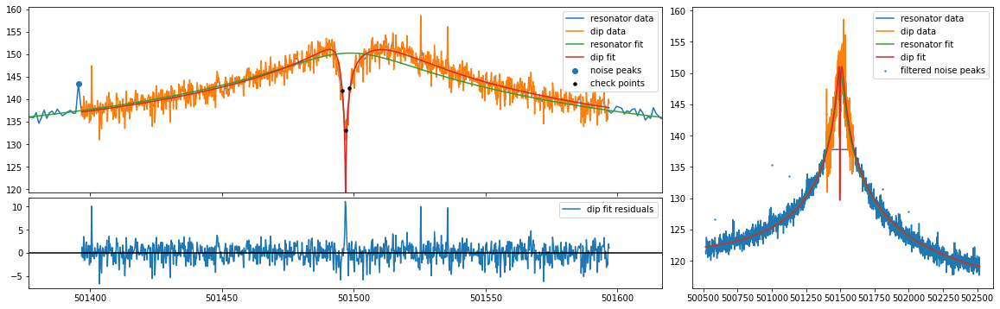

mean fit residuals = 9.2e-03 +/- 6.1e-02
{'A': 1257374923348048.5, 'dA': 46672847306812.24, 'Q': 11661.389309564485, 'dQ': 283.7803141852384, 'offset': 581310463987.1082, 'doffset': 16612022550.949877, 'slope': -0.001516633853747613, 'dslope': 3.686795827269729e-05, 'nu_res': 501504.3570051196, 'dnu_res': 0.4299087174694536, 'nu_z': 501496.9078542175, 'dnu_z': 0.021266323770072804, 'dip_width': 7.629183666157337, 'ddip_width': 0.3627963363749042, 'pcov': array([[ 4.522565266936e-04,  3.026793923251e-04,  4.875981684023e+08,
         3.390112464904e-03, -5.824725951163e-04],
       [ 3.026793923251e-04,  1.316211816871e-01,  7.732967367284e+12,
         4.937936330418e+01, -2.781046457211e-03],
       [ 4.875981684016e+08,  7.732967367284e+12,  2.178354675725e+27,
         1.226013664810e+16, -4.480956821448e+11],
       [ 3.390112464901e-03,  4.937936330418e+01,  1.226013664810e+16,
         8.053126671907e+04, -4.594519988426e+00],
       [-5.824725951163e-04, -2.781046457212e-03, -4.

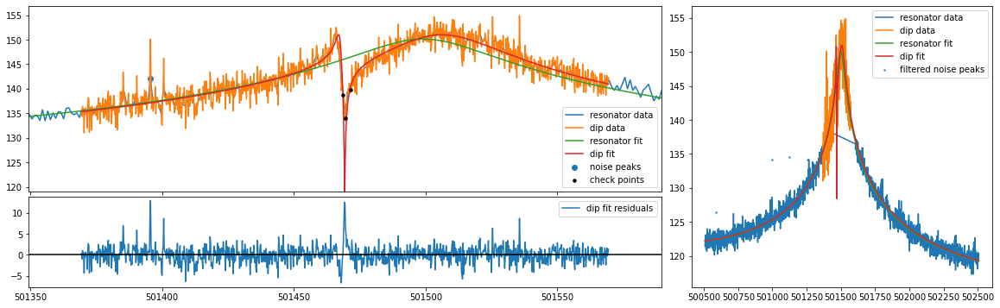

mean fit residuals = 1.2e-02 +/- 6.5e-02
{'A': 1257483305337722.5, 'dA': 50031580132085.305, 'Q': 11566.49197085684, 'dQ': 303.4213952721939, 'offset': 603750887643.223, 'doffset': 17373154140.89377, 'slope': -0.0014442221331261952, 'dslope': 3.780402426227751e-05, 'nu_res': 501503.95138776116, 'dnu_res': 0.49402267610624173, 'nu_z': 501469.2861577713, 'dnu_z': 0.023486953188959298, 'dip_width': 7.8551621025158, 'ddip_width': 0.40493157183128825, 'pcov': array([[ 5.516369701004e-04,  1.743725261465e-03,  1.540610810908e+09,
         2.197399937483e-02, -7.405185227860e-04],
       [ 1.743725261465e-03,  1.639695778658e-01,  9.149370895435e+12,
         5.834482828526e+01, -1.611837297122e-02],
       [ 1.540610810908e+09,  9.149370895435e+12,  2.503159010513e+27,
         1.398352418358e+16, -2.057569104774e+12],
       [ 2.197399937483e-02,  5.834482828526e+01,  1.398352418358e+16,
         9.206454310892e+04, -2.617475844800e+01],
       [-7.405185227860e-04, -1.611837297122e-02, -2.

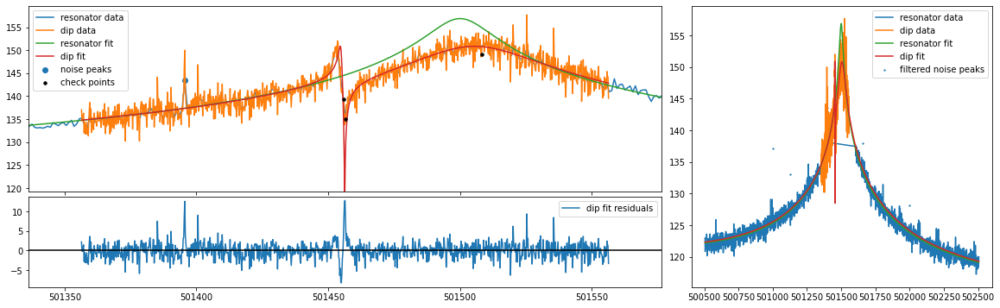

mean fit residuals = 1.1e-02 +/- 6.7e-02
{'A': 1214704237912228.5, 'dA': 48580034681866.65, 'Q': 11126.175530197619, 'dQ': 297.60010293956634, 'offset': 592931016121.1519, 'doffset': 16999843304.693972, 'slope': -0.0015129313206924265, 'dslope': 3.755987830082184e-05, 'nu_res': 501503.9789097191, 'dnu_res': 0.5584884360733074, 'nu_z': 501456.2842876104, 'dnu_z': 0.023379041087908607, 'dip_width': 7.384417167341234, 'ddip_width': 0.4040452247689268, 'pcov': array([[ 5.465795621901e-04,  2.309822851624e-03,  1.879313842866e+09,
         3.346326397604e-02, -7.865096302529e-04],
       [ 2.309822851624e-03,  1.632525436586e-01,  8.415754409721e+12,
         5.430424561274e+01, -2.345170659056e-02],
       [ 1.879313842866e+09,  8.415754409721e+12,  2.360019769691e+27,
         1.319330453972e+16, -2.842954871699e+12],
       [ 3.346326397604e-02,  5.430424561274e+01,  1.319330453972e+16,
         8.856582126964e+04, -4.118547008753e+01],
       [-7.865096302529e-04, -2.345170659056e-02, -

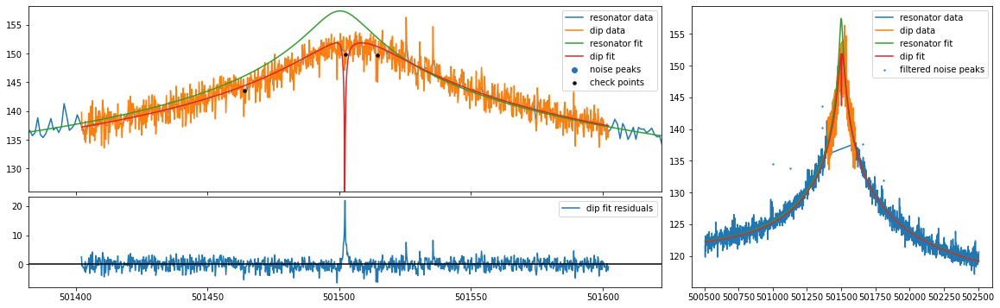

mean fit residuals = 1.7e-02 +/- 6.3e-02
{'A': 1535397563091477.8, 'dA': 62182563418433.35, 'Q': 13231.167992181163, 'dQ': 339.5923748374238, 'offset': 621622892112.2288, 'doffset': 17303978087.686558, 'slope': -0.0015516946691747167, 'dslope': 3.767756264847294e-05, 'nu_res': 501505.3936363219, 'dnu_res': 0.40784226837501203, 'nu_z': 501502.13683911425, 'dnu_z': 0.013451660665511385, 'dip_width': 2.059060708587679, 'ddip_width': 0.17749599176737665, 'pcov': array([[ 1.809471746601e-04, -3.524998261999e-04, -5.163244130627e+09,
        -5.269329135670e-02, -2.292957271963e-04],
       [-3.524998261999e-04,  3.150482709348e-02,  2.982578595392e+12,
         1.706741920669e+01,  2.245652584882e-04],
       [-5.163244130626e+09,  2.982578595392e+12,  3.866671193287e+27,
         1.971313307800e+16, -2.524373767848e+11],
       [-5.269329135670e-02,  1.706741920669e+01,  1.971313307800e+16,
         1.153229810477e+05, -1.817958075092e+00],
       [-2.292957271963e-04,  2.245652584888e-04,

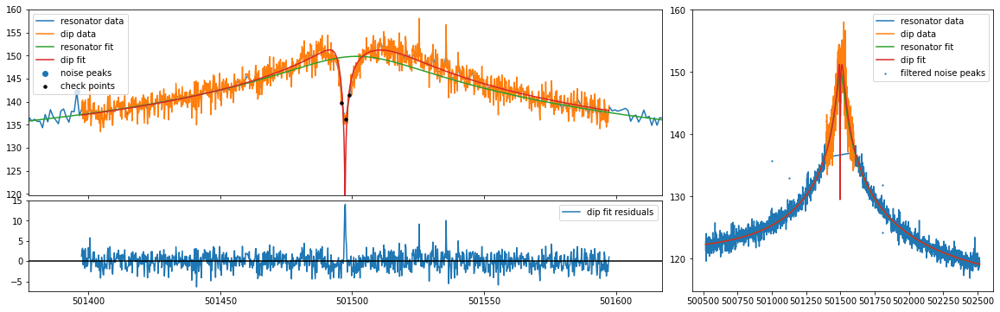

mean fit residuals = 1.2e-02 +/- 6.3e-02
{'A': 1322934306292312.2, 'dA': 51632102012388.73, 'Q': 11982.456503355173, 'dQ': 304.27297264981144, 'offset': 598696604613.9149, 'doffset': 16936067014.618336, 'slope': -0.0015649834954480101, 'dslope': 3.702444627342855e-05, 'nu_res': 501505.0034981192, 'dnu_res': 0.43888972274712623, 'nu_z': 501497.29442080465, 'dnu_z': 0.02170357353628579, 'dip_width': 7.492405046147002, 'ddip_width': 0.3734661938150868, 'pcov': array([[ 4.710451042450e-04,  3.238004429177e-04,  3.908528671940e+08,
         1.925098163574e-03, -6.019050456730e-04],
       [ 3.238004429177e-04,  1.394769979227e-01,  8.799953975242e+12,
         5.443595711243e+01, -2.876413041719e-03],
       [ 3.908528671938e+08,  8.799953975242e+12,  2.665873958218e+27,
         1.456914543231e+16, -4.961268137451e+11],
       [ 1.925098163572e-03,  5.443595711243e+01,  1.456914543231e+16,
         9.258204188515e+04, -4.903250674471e+00],
       [-6.019050456730e-04, -2.876413041718e-03, 

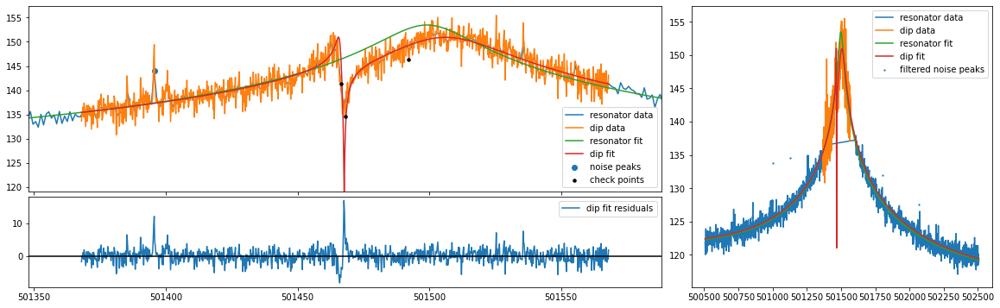

mean fit residuals = 1.5e-02 +/- 6.8e-02
{'A': 1238952562235879.0, 'dA': 51030622622394.625, 'Q': 11259.266105290631, 'dQ': 308.3043042576872, 'offset': 623648728158.574, 'doffset': 17767916325.586216, 'slope': -0.0015061463865435746, 'dslope': 3.862505140999312e-05, 'nu_res': 501504.07723274216, 'dnu_res': 0.5312495283305618, 'nu_z': 501467.68074272096, 'dnu_z': 0.02421719803404963, 'dip_width': 7.423104598459769, 'ddip_width': 0.4097335779223665, 'pcov': array([[ 5.864726806204e-04,  1.890365311442e-03,  1.618428455215e+09,
         2.375022475676e-02, -7.983251919078e-04],
       [ 1.890365311442e-03,  1.678816048771e-01,  9.162376743106e+12,
         5.824105395494e+01, -1.809450616732e-02],
       [ 1.618428455215e+09,  9.162376743106e+12,  2.604124445229e+27,
         1.445399542325e+16, -2.396247399384e+12],
       [ 2.375022475676e-02,  5.824105395494e+01,  1.445399542325e+16,
         9.505154402382e+04, -3.069577130934e+01],
       [-7.983251919078e-04, -1.809450616732e-02, -

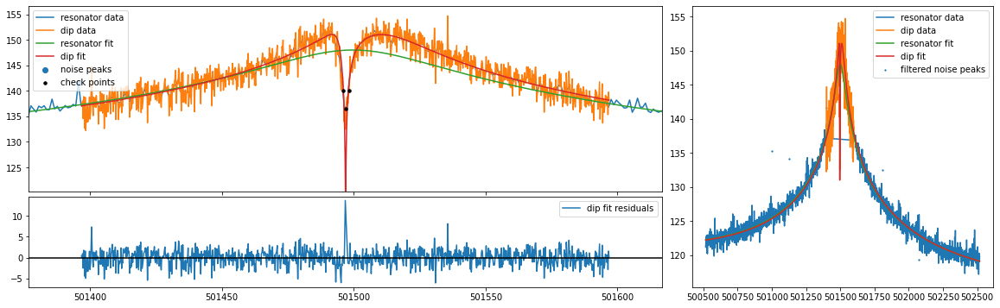

mean fit residuals = 8.2e-03 +/- 6.1e-02
{'A': 1271890494007459.8, 'dA': 47693308182327.73, 'Q': 11687.613527085769, 'dQ': 287.11449571518614, 'offset': 581747923317.983, 'doffset': 17073664214.991678, 'slope': -0.0014996943685200805, 'dslope': 3.7154505350572664e-05, 'nu_res': 501505.36345288646, 'dnu_res': 0.43337839091641417, 'nu_z': 501496.9042635679, 'dnu_z': 0.019732462300181275, 'dip_width': 6.499961784630168, 'ddip_width': 0.3317483360435797, 'pcov': array([[ 3.893700684281e-04,  2.809241020230e-04,  2.785404840498e+08,
         1.452125251214e-03, -5.026160207412e-04],
       [ 2.809241020230e-04,  1.100569584677e-01,  6.795390934018e+12,
         4.294684511160e+01, -2.703647546735e-03],
       [ 2.785404840488e+08,  6.795390934018e+12,  2.274651645374e+27,
         1.267731746332e+16, -5.092592316433e+11],
       [ 1.452125251209e-03,  4.294684511160e+01,  1.267731746332e+16,
         8.243473364979e+04, -5.291774153462e+00],
       [-5.026160207412e-04, -2.703647546736e-03,

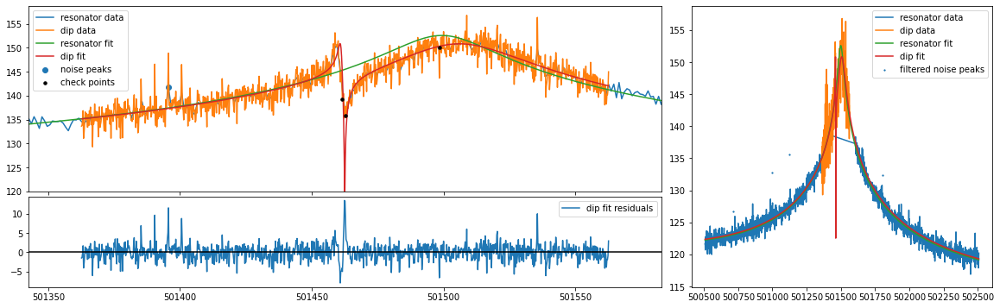

mean fit residuals = 1.1e-02 +/- 6.8e-02
{'A': 1213862395874097.8, 'dA': 49265667208206.12, 'Q': 11074.231789961908, 'dQ': 300.6339560800553, 'offset': 593872498402.23, 'doffset': 17101099390.840136, 'slope': -0.001513407327829095, 'dslope': 3.7325154572021516e-05, 'nu_res': 501504.3725951114, 'dnu_res': 0.5493438412999542, 'nu_z': 501462.48882274394, 'dnu_z': 0.022632316264302725, 'dip_width': 6.74019745165769, 'ddip_width': 0.38536099879991637, 'pcov': array([[ 5.122217394874e-04,  1.909613803720e-03,  1.882931969059e+09,
         2.887903422727e-02, -7.212908189946e-04],
       [ 1.909613803720e-03,  1.485030993961e-01,  7.921254166878e+12,
         5.088016386790e+01, -1.927172559872e-02],
       [ 1.882931969059e+09,  7.921254166878e+12,  2.427105965470e+27,
         1.355596001503e+16, -2.679701831434e+12],
       [ 2.887903422727e-02,  5.088016386790e+01,  1.355596001503e+16,
         9.038077554834e+04, -3.632964525017e+01],
       [-7.212908189946e-04, -1.927172559872e-02, -2.

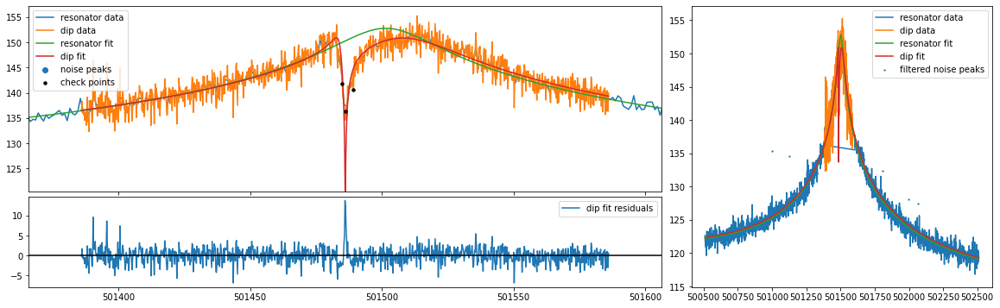

mean fit residuals = 9.6e-03 +/- 6.3e-02
{'A': 1219540367833802.0, 'dA': 45985514288337.96, 'Q': 11173.251304604975, 'dQ': 279.87004716193326, 'offset': 599284024073.0758, 'doffset': 16981291853.199396, 'slope': -0.0015063661191569225, 'dslope': 3.7487498040740656e-05, 'nu_res': 501504.6025373377, 'dnu_res': 0.46426092536673313, 'nu_z': 501486.09898259, 'dnu_z': 0.020556284329675233, 'dip_width': 6.493554376414759, 'ddip_width': 0.34075972983173886, 'pcov': array([[ 4.225608254425e-04,  6.864002618756e-04,  7.810633938619e+08,
         8.675200010808e-03, -5.581480981212e-04],
       [ 6.864002618756e-04,  1.161171934750e-01,  6.623865469166e+12,
         4.236509188981e+01, -6.667384371886e-03],
       [ 7.810633938616e+08,  6.623865469166e+12,  2.114667524363e+27,
         1.186639259039e+16, -1.086127332956e+12],
       [ 8.675200010806e-03,  4.236509188981e+01,  1.186639259039e+16,
         7.832724329842e+04, -1.266337101363e+01],
       [-5.581480981212e-04, -6.667384371886e-03, 

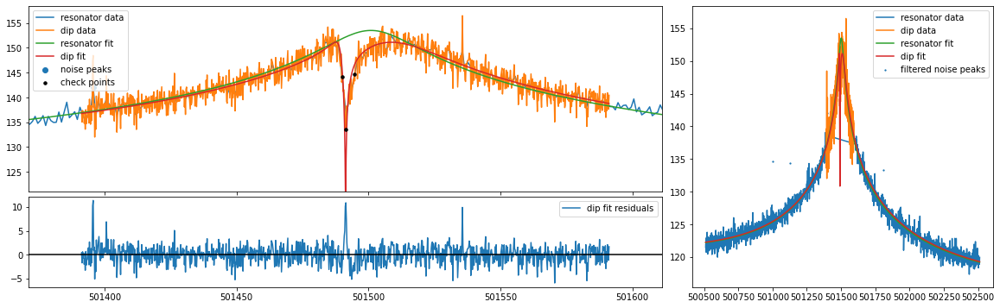

mean fit residuals = 7.0e-03 +/- 6.1e-02
{'A': 1298305581039546.8, 'dA': 48543944083690.7, 'Q': 11656.6709605853, 'dQ': 285.82603891138507, 'offset': 599439421080.5139, 'doffset': 16628329226.982445, 'slope': -0.0014643317924124405, 'dslope': 3.645118175324848e-05, 'nu_res': 501505.08093054936, 'dnu_res': 0.4358063244227565, 'nu_z': 501491.3007524206, 'dnu_z': 0.01900228110322341, 'dip_width': 5.958942207793027, 'ddip_width': 0.3147352290650845, 'pcov': array([[ 3.610866871259e-04,  4.434546717676e-04,  4.609489635579e+08,
         4.175409202897e-03, -4.689139220271e-04],
       [ 4.434546717676e-04,  9.905826441465e-02,  6.322753936443e+12,
         3.908018741732e+01, -4.073968156294e-03],
       [ 4.609489635574e+08,  6.322753936443e+12,  2.356514507200e+27,
         1.283880106811e+16, -7.907700186323e+11],
       [ 4.175409202894e-03,  3.908018741732e+01,  1.283880106811e+16,
         8.169652451977e+04, -8.626380290507e+00],
       [-4.689139220271e-04, -4.073968156295e-03, -7.9

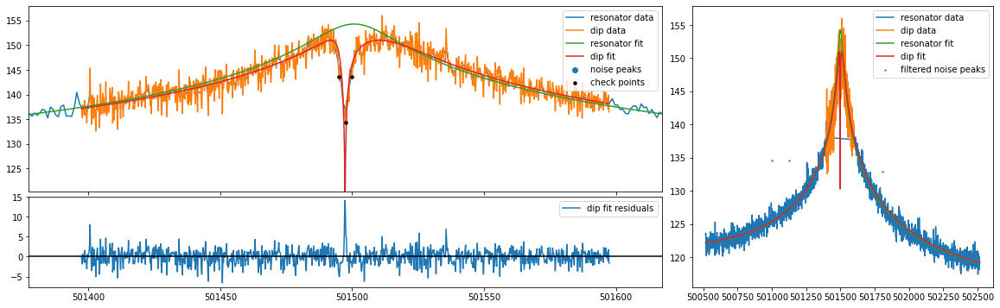

mean fit residuals = 9.1e-03 +/- 6.1e-02
{'A': 1260140996897769.5, 'dA': 46825374374536.01, 'Q': 11570.289529317019, 'dQ': 282.4596620808831, 'offset': 586450698314.6978, 'doffset': 17230764075.27949, 'slope': -0.0014642286715676465, 'dslope': 3.8224963979865345e-05, 'nu_res': 501504.9912929106, 'dnu_res': 0.43385936148247284, 'nu_z': 501497.30413914606, 'dnu_z': 0.019560839281359266, 'dip_width': 6.388531864749656, 'ddip_width': 0.3265060691113218, 'pcov': array([[ 3.826264333912e-04,  2.441702497451e-04,  2.044181633326e+08,
         6.018140834577e-04, -4.952294068396e-04],
       [ 2.441702497451e-04,  1.066062131665e-01,  6.507255589247e+12,
         4.121599111633e+01, -2.363943634868e-03],
       [ 2.044181633332e+08,  6.507255589247e+12,  2.192615685315e+27,
         1.223683728217e+16, -4.558820342331e+11],
       [ 6.018140834614e-04,  4.121599111633e+01,  1.223683728217e+16,
         7.978346070285e+04, -4.669100357108e+00],
       [-4.952294068396e-04, -2.363943634868e-03, 

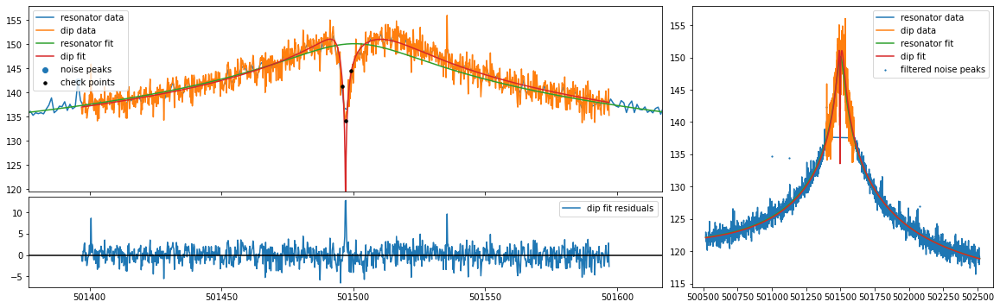

mean fit residuals = 1.0e-02 +/- 6.2e-02
{'A': 1277866935622836.5, 'dA': 48791993652167.31, 'Q': 11921.444820379093, 'dQ': 296.54990494690344, 'offset': 550810639712.2114, 'doffset': 16734269009.024374, 'slope': -0.0015781977417329406, 'dslope': 3.776715779840241e-05, 'nu_res': 501504.6454715646, 'dnu_res': 0.43168473081524245, 'nu_z': 501497.0921383922, 'dnu_z': 0.020759018063067413, 'dip_width': 7.320498130198221, 'ddip_width': 0.3605069633691415, 'pcov': array([[ 4.309368309428e-04,  2.896541780025e-04,  3.835684142431e+08,
         2.156166441134e-03, -5.527356548641e-04],
       [ 2.896541780025e-04,  1.299652706376e-01,  7.951855234534e+12,
         5.072495857713e+01, -2.710833353769e-03],
       [ 3.835684142437e+08,  7.951855234534e+12,  2.380658644553e+27,
         1.341409665400e+16, -4.668179979663e+11],
       [ 2.156166441137e-03,  5.072495857713e+01,  1.341409665400e+16,
         8.794184612402e+04, -4.757007006958e+00],
       [-5.527356548641e-04, -2.710833353769e-03, 

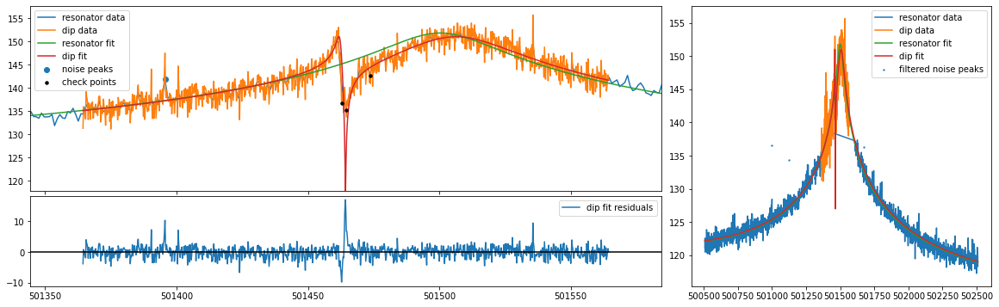

mean fit residuals = 1.9e-02 +/- 6.5e-02
{'A': 1265157432842694.8, 'dA': 50251194819393.83, 'Q': 11564.42320810719, 'dQ': 303.1500470337334, 'offset': 549692146504.62134, 'doffset': 16585370251.750957, 'slope': -0.0015466161287768184, 'dslope': 3.742554930055401e-05, 'nu_res': 501503.8862741413, 'dnu_res': 0.5047723716579486, 'nu_z': 501464.281304688, 'dnu_z': 0.02583057934100037, 'dip_width': 9.685526928060915, 'ddip_width': 0.4624975992017181, 'pcov': array([[ 6.672188290917e-04,  2.378727359276e-03,  1.624000892380e+09,
         2.659072965304e-02, -9.089432564963e-04],
       [ 2.378727359276e-03,  2.139040292674e-01,  1.129923925674e+13,
         7.167949203748e+01, -2.282849594651e-02],
       [ 1.624000892381e+09,  1.129923925674e+13,  2.525182580777e+27,
         1.400746812281e+16, -2.337326559489e+12],
       [ 2.659072965304e-02,  7.167949203748e+01,  1.400746812281e+16,
         9.189995101655e+04, -3.056270278561e+01],
       [-9.089432564963e-04, -2.282849594651e-02, -2.3

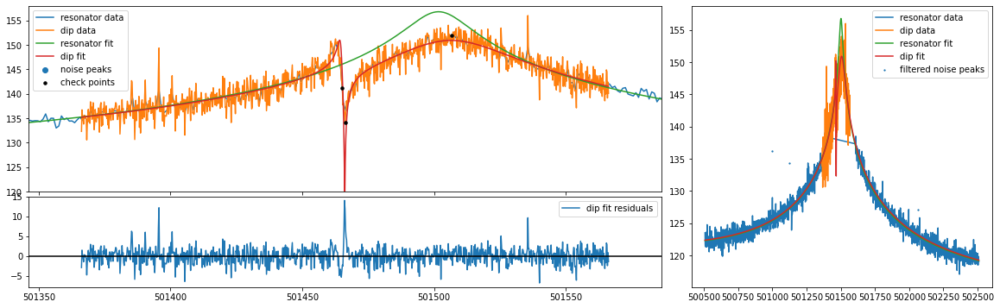

mean fit residuals = 1.1e-02 +/- 6.5e-02
{'A': 1236925447784105.8, 'dA': 48621402380862.46, 'Q': 11362.760037660139, 'dQ': 296.2395824153338, 'offset': 603701796269.498, 'doffset': 17140537529.892515, 'slope': -0.00153803974469801, 'dslope': 3.745122309534142e-05, 'nu_res': 501504.61490447976, 'dnu_res': 0.5068199384234641, 'nu_z': 501466.0928069855, 'dnu_z': 0.022156677934979295, 'dip_width': 7.049994440236322, 'ddip_width': 0.37854826183541435, 'pcov': array([[ 4.909183771144e-04,  1.720334635128e-03,  1.713996388292e+09,
         2.477677803180e-02, -6.738563681876e-04],
       [ 1.720334635128e-03,  1.432987865386e-01,  7.897886576361e+12,
         5.062085750565e+01, -1.640821770929e-02],
       [ 1.713996388292e+09,  7.897886576361e+12,  2.364040769482e+27,
         1.323165894539e+16, -2.262445524202e+12],
       [ 2.477677803179e-02,  5.062085750565e+01,  1.323165894539e+16,
         8.775789018961e+04, -2.964818266548e+01],
       [-6.738563681876e-04, -1.640821770929e-02, -2.

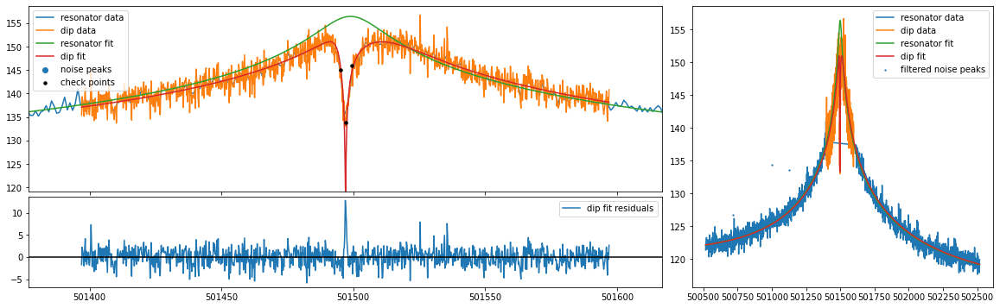

mean fit residuals = 1.1e-02 +/- 6.3e-02
{'A': 1260608301054872.0, 'dA': 48353876106644.01, 'Q': 11646.651413265097, 'dQ': 292.98712167322986, 'offset': 583829774682.6312, 'doffset': 16996250667.044872, 'slope': -0.0014312393452089792, 'dslope': 3.7781343777664535e-05, 'nu_res': 501504.9948545905, 'dnu_res': 0.44499491082248915, 'nu_z': 501497.0877570037, 'dnu_z': 0.02185815548769232, 'dip_width': 7.566926546905767, 'ddip_width': 0.3732163276585909, 'pcov': array([[ 4.777789613241e-04,  3.204100601585e-04,  3.195453742329e+08,
         1.669224143373e-03, -6.158974110073e-04],
       [ 3.204100601585e-04,  1.392904272310e-01,  8.212605373317e+12,
         5.226265985200e+01, -3.107831714908e-03],
       [ 3.195453742325e+08,  8.212605373317e+12,  2.338097334537e+27,
         1.311238395096e+16, -4.989578711882e+11],
       [ 1.669224143372e-03,  5.226265985200e+01,  1.311238395096e+16,
         8.584145346636e+04, -5.201000853761e+00],
       [-6.158974110073e-04, -3.107831714907e-03, 

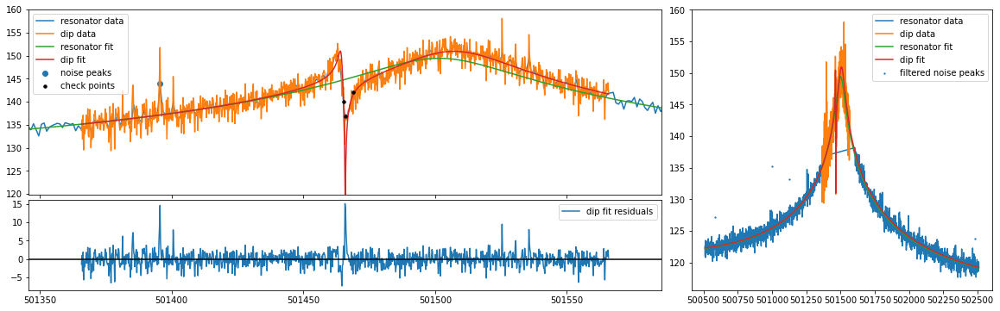

mean fit residuals = 1.1e-02 +/- 6.7e-02
{'A': 1246278424934090.2, 'dA': 50621598662586.46, 'Q': 11379.889437936192, 'dQ': 306.4876619944025, 'offset': 587754144219.805, 'doffset': 17128234759.1663, 'slope': -0.0015254267291409732, 'dslope': 3.729317441343185e-05, 'nu_res': 501505.36820271553, 'dnu_res': 0.525692629900744, 'nu_z': 501465.88956411544, 'dnu_z': 0.022540105067857648, 'dip_width': 6.967973167171479, 'ddip_width': 0.3883920382280585, 'pcov': array([[ 5.080563364701e-04,  1.830632299005e-03,  1.859626561371e+09,
         2.702928527955e-02, -7.010862722542e-04],
       [ 1.830632299005e-03,  1.508483753589e-01,  8.392906101225e+12,
         5.345118736454e+01, -1.776892506515e-02],
       [ 1.859626561371e+09,  8.392906101225e+12,  2.562546251156e+27,
         1.424798046434e+16, -2.489030028372e+12],
       [ 2.702928527955e-02,  5.345118736454e+01,  1.424798046434e+16,
         9.393468695480e+04, -3.270756950732e+01],
       [-7.010862722542e-04, -1.776892506515e-02, -2.4

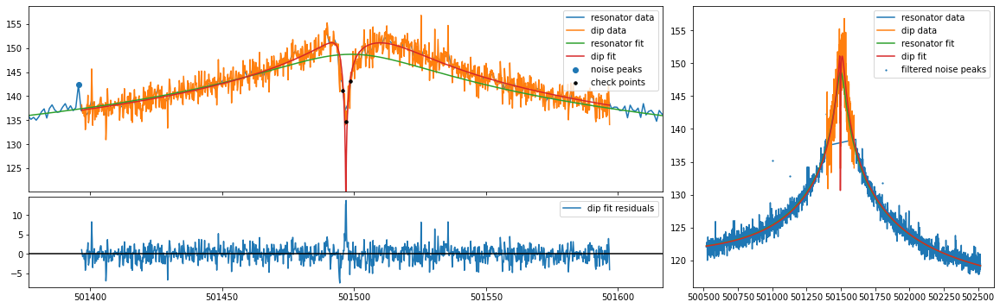

mean fit residuals = 8.8e-03 +/- 6.3e-02
{'A': 1286229342186880.5, 'dA': 49675972556224.766, 'Q': 11795.851082429614, 'dQ': 297.68097765675884, 'offset': 591838258903.4703, 'doffset': 17209011114.21004, 'slope': -0.001432457535484225, 'dslope': 3.767126451320485e-05, 'nu_res': 501504.62162467954, 'dnu_res': 0.4416751581381716, 'nu_z': 501496.88972146413, 'dnu_z': 0.020209934754720944, 'dip_width': 6.469501236606606, 'ddip_width': 0.33964547504863046, 'pcov': array([[ 4.084414627901e-04,  2.881291754670e-04,  4.664692052405e+08,
         3.315137447745e-03, -5.257945936723e-04],
       [ 2.881291754670e-04,  1.153590487210e-01,  7.247559082816e+12,
         4.559169602417e+01, -2.586597156391e-03],
       [ 4.664692052412e+08,  7.247559082816e+12,  2.467702249407e+27,
         1.369920264662e+16, -4.925748546064e+11],
       [ 3.315137447749e-03,  4.559169602417e+01,  1.369920264662e+16,
         8.861396445868e+04, -5.054406815063e+00],
       [-5.257945936723e-04, -2.586597156390e-03,

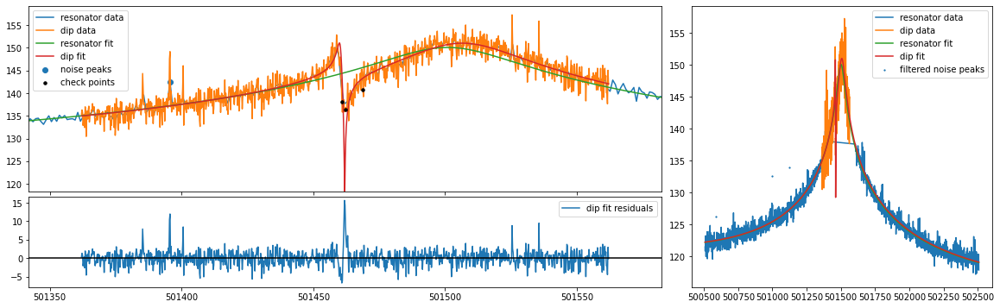

mean fit residuals = 1.5e-02 +/- 6.7e-02
{'A': 1266845052646075.8, 'dA': 51844163323002.85, 'Q': 11504.035222062643, 'dQ': 311.3572666590133, 'offset': 561459153057.7673, 'doffset': 17286361254.84773, 'slope': -0.0015638129094980551, 'dslope': 3.814209401782267e-05, 'nu_res': 501504.5880990392, 'dnu_res': 0.5315044517442244, 'nu_z': 501461.8773065968, 'dnu_z': 0.02437110026129379, 'dip_width': 8.188319108209168, 'ddip_width': 0.43153272832661826, 'pcov': array([[ 5.939505279460e-04,  2.287815055550e-03,  1.702177328610e+09,
         2.797755695720e-02, -8.210767495935e-04],
       [ 2.287815055550e-03,  1.862204956170e-01,  1.015531833688e+13,
         6.415505384553e+01, -2.243717122689e-02],
       [ 1.702177328610e+09,  1.015531833688e+13,  2.687817270662e+27,
         1.481736669284e+16, -2.676611162759e+12],
       [ 2.797755695720e-02,  6.415505384553e+01,  1.481736669284e+16,
         9.694334750137e+04, -3.573269093122e+01],
       [-8.210767495935e-04, -2.243717122689e-02, -2.

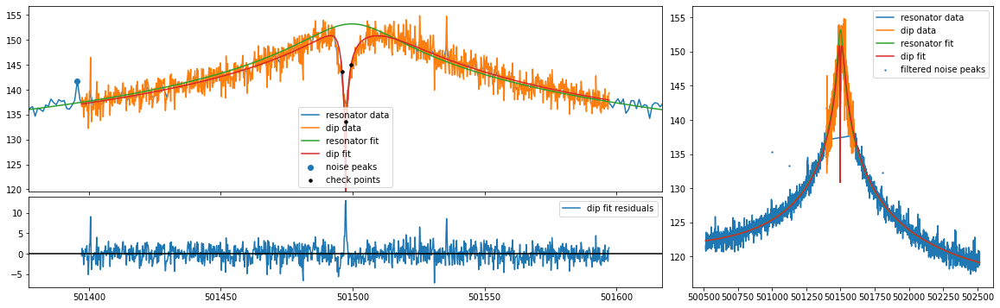

mean fit residuals = 9.4e-03 +/- 6.1e-02
{'A': 1213363005945234.5, 'dA': 45336709493942.445, 'Q': 11524.69935944789, 'dQ': 283.24397805745144, 'offset': 608794718733.147, 'doffset': 17188880023.20231, 'slope': -0.001552810967058994, 'dslope': 3.7680775517665295e-05, 'nu_res': 501503.7520528716, 'dnu_res': 0.43789341703841206, 'nu_z': 501497.28079592023, 'dnu_z': 0.020029324565847568, 'dip_width': 6.351915262151931, 'ddip_width': 0.32817037947340527, 'pcov': array([[ 4.011738425641e-04,  2.303904858214e-04,  4.284371015437e+08,
         2.775072428778e-03, -5.187521578373e-04],
       [ 2.303904858214e-04,  1.076957979637e-01,  6.306192476414e+12,
         4.138750633322e+01, -2.096404563975e-03],
       [ 4.284371015441e+08,  6.306192476414e+12,  2.055417227738e+27,
         1.187754965054e+16, -4.016682514211e+11],
       [ 2.775072428781e-03,  4.138750633322e+01,  1.187754965054e+16,
         8.022715110581e+04, -4.094861244229e+00],
       [-5.187521578373e-04, -2.096404563974e-03, 

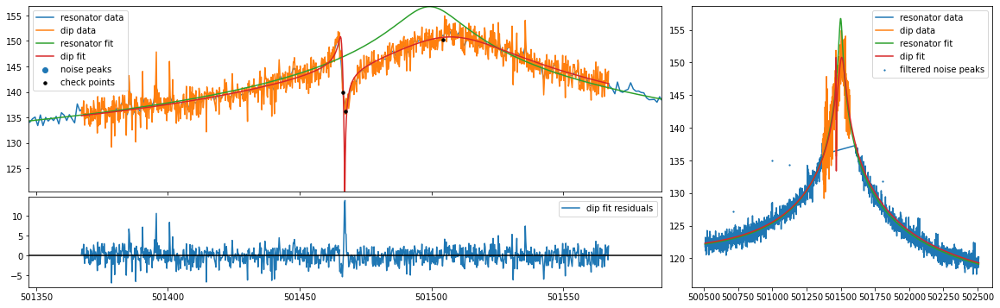

mean fit residuals = 8.9e-03 +/- 6.4e-02
{'A': 1200710840745084.5, 'dA': 45813615959318.76, 'Q': 10996.483712406554, 'dQ': 281.01150400005923, 'offset': 584021089999.4915, 'doffset': 16793820755.306183, 'slope': -0.0015028699973630099, 'dslope': 3.7069207299938134e-05, 'nu_res': 501505.71543723997, 'dnu_res': 0.5116073985874616, 'nu_z': 501467.1070889882, 'dnu_z': 0.019911121021721243, 'dip_width': 5.7406136261430225, 'ddip_width': 0.32804822638255376, 'pcov': array([[ 3.964527403416e-04,  1.327155202628e-03,  1.110428098480e+09,
         1.723896306683e-02, -5.522741687872e-04],
       [ 1.327155202628e-03,  1.076156388327e-01,  5.902420972188e+12,
         3.807772508477e+01, -1.341374995458e-02],
       [ 1.110428098480e+09,  5.902420972188e+12,  2.098887407268e+27,
         1.179452096666e+16, -2.216744684665e+12],
       [ 1.723896306683e-02,  3.807772508477e+01,  1.179452096666e+16,
         7.896746538038e+04, -2.940989820209e+01],
       [-5.522741687872e-04, -1.341374995458e-0

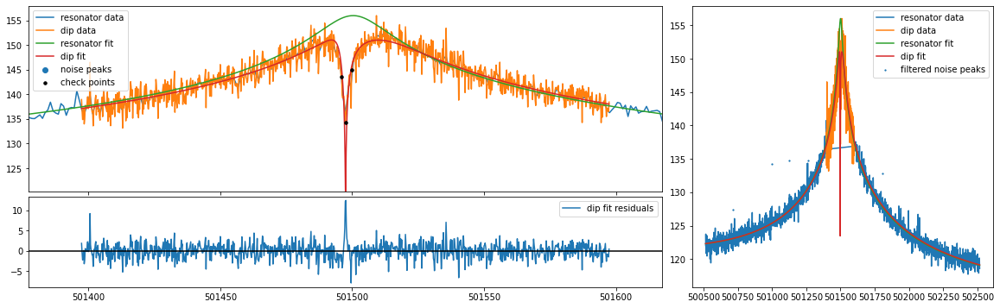

mean fit residuals = 8.5e-03 +/- 6.0e-02
{'A': 1268402002008781.2, 'dA': 47075323542910.5, 'Q': 11714.777707151894, 'dQ': 284.64540493276735, 'offset': 607683354349.6621, 'doffset': 16902737728.144634, 'slope': -0.0015503359572642751, 'dslope': 3.721233727549894e-05, 'nu_res': 501504.66453126876, 'dnu_res': 0.42744342233320354, 'nu_z': 501497.4882829939, 'dnu_z': 0.019270959418620445, 'dip_width': 6.185678383555458, 'ddip_width': 0.31857715691735716, 'pcov': array([[ 3.713698769141e-04,  2.451240025359e-04,  4.706687527138e+08,
         3.288943674780e-03, -4.788588368190e-04],
       [ 2.451240025359e-04,  1.014914049095e-01,  6.317045127252e+12,
         4.010395381662e+01, -2.159979020617e-03],
       [ 4.706687527145e+08,  6.317045127252e+12,  2.216086086670e+27,
         1.240794717661e+16, -4.343326792710e+11],
       [ 3.288943674784e-03,  4.010395381662e+01,  1.240794717661e+16,
         8.102300654934e+04, -4.374619061808e+00],
       [-4.788588368190e-04, -2.159979020617e-03,

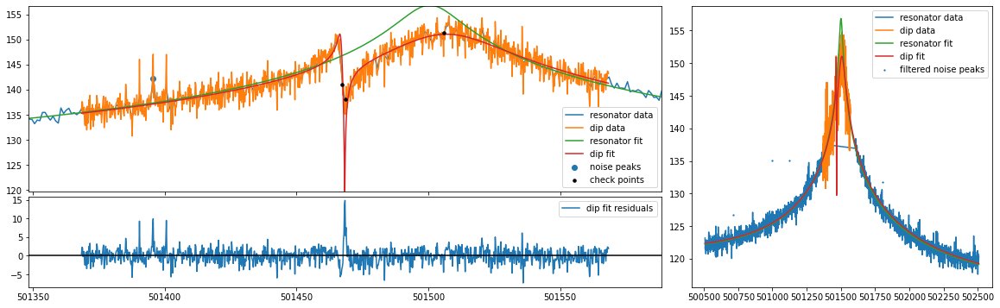

mean fit residuals = 1.1e-02 +/- 6.5e-02
{'A': 1275516322886386.5, 'dA': 50508819422049.38, 'Q': 11553.320485450498, 'dQ': 301.8190043627444, 'offset': 604257155580.0587, 'doffset': 16792701270.455254, 'slope': -0.0015434649623010056, 'dslope': 3.6855459209399285e-05, 'nu_res': 501505.11286929174, 'dnu_res': 0.49650790383890187, 'nu_z': 501468.28114609857, 'dnu_z': 0.021341082622813392, 'dip_width': 6.641008693557537, 'ddip_width': 0.3649191517152443, 'pcov': array([[ 4.554418075137e-04,  1.560251698848e-03,  1.711884587434e+09,
         2.307820275075e-02, -6.187063058396e-04],
       [ 1.560251698848e-03,  1.331659872886e-01,  7.769387042415e+12,
         4.881679602155e+01, -1.443896518365e-02],
       [ 1.711884587434e+09,  7.769387042415e+12,  2.551140839409e+27,
         1.403251159137e+16, -2.195775908692e+12],
       [ 2.307820275075e-02,  4.881679602155e+01,  1.403251159137e+16,
         9.109471139452e+04, -2.780378175276e+01],
       [-6.187063058396e-04, -1.443896518365e-02

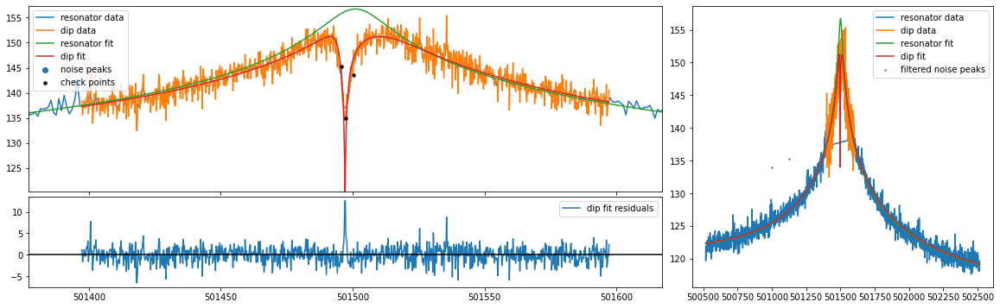

mean fit residuals = 9.6e-03 +/- 6.0e-02
{'A': 1326838007142487.2, 'dA': 48742334393366.12, 'Q': 11831.800219875633, 'dQ': 283.7715529847333, 'offset': 601366350330.8416, 'doffset': 17260797734.896492, 'slope': -0.001567710468828601, 'dslope': 3.781660778856212e-05, 'nu_res': 501504.66988966014, 'dnu_res': 0.418687365020312, 'nu_z': 501497.0985640969, 'dnu_z': 0.01988572678207075, 'dip_width': 7.021565152472997, 'ddip_width': 0.3391785486845867, 'pcov': array([[ 3.954421296512e-04,  2.638107766774e-04,  3.359615765823e+08,
         1.635287705331e-03, -5.078058940503e-04],
       [ 2.638107766774e-04,  1.150420878878e-01,  7.339096797286e+12,
         4.485385094687e+01, -2.401768670072e-03],
       [ 3.359615765826e+08,  7.339096797286e+12,  2.375815162115e+27,
         1.281641016418e+16, -4.466777116133e+11],
       [ 1.635287705333e-03,  4.485385094687e+01,  1.281641016418e+16,
         8.052629428337e+04, -4.346197839570e+00],
       [-5.078058940503e-04, -2.401768670071e-03, -4.4

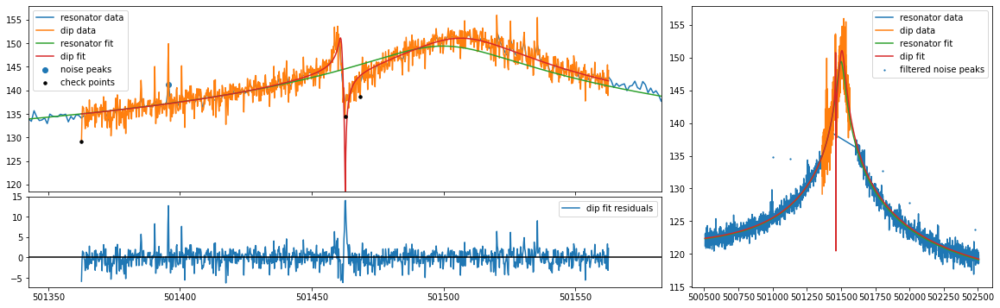

mean fit residuals = 1.2e-02 +/- 6.5e-02
{'A': 1279788529422778.8, 'dA': 50494024332829.45, 'Q': 11564.286755507548, 'dQ': 301.28500220683674, 'offset': 603449124873.6876, 'doffset': 16966720143.840994, 'slope': -0.0015866054074249098, 'dslope': 3.706155793936553e-05, 'nu_res': 501504.85771946266, 'dnu_res': 0.5079651067648024, 'nu_z': 501462.66779993766, 'dnu_z': 0.022361687183105525, 'dip_width': 7.187801367338917, 'ddip_width': 0.38407145109618485, 'pcov': array([[ 5.000450536751e-04,  1.915333285690e-03,  1.582602472135e+09,
         2.459945509612e-02, -6.884471817268e-04],
       [ 1.915333285690e-03,  1.475108795471e-01,  8.368789592122e+12,
         5.253419073828e+01, -1.804933090958e-02],
       [ 1.582602472135e+09,  8.368789592122e+12,  2.549646493324e+27,
         1.397345335758e+16, -2.470898088270e+12],
       [ 2.459945509612e-02,  5.253419073828e+01,  1.397345335758e+16,
         9.077265255477e+04, -3.258685027843e+01],
       [-6.884471817268e-04, -1.804933090958e-02

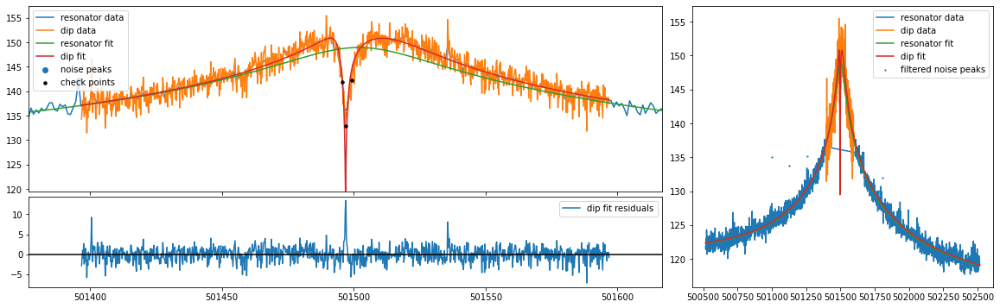

mean fit residuals = 1.0e-02 +/- 6.0e-02
{'A': 1209815548887549.8, 'dA': 43916702318645.16, 'Q': 11345.918080133531, 'dQ': 272.17244899678207, 'offset': 607424501624.2083, 'doffset': 17110909360.464535, 'slope': -0.0015866046149945628, 'dslope': 3.743687935045476e-05, 'nu_res': 501505.16256073123, 'dnu_res': 0.4334260851936414, 'nu_z': 501496.89126063144, 'dnu_z': 0.02091897185891306, 'dip_width': 7.271340673776844, 'ddip_width': 0.3482744657171354, 'pcov': array([[ 4.376033836340e-04,  3.032455195067e-04,  3.595266187312e+08,
         2.182990196459e-03, -5.681314302094e-04],
       [ 3.032455195067e-04,  1.212951034706e-01,  6.809738190113e+12,
         4.434982170293e+01, -2.965770603629e-03],
       [ 3.595266187314e+08,  6.809738190113e+12,  1.928676742544e+27,
         1.104271091055e+16, -4.796750697021e+11],
       [ 2.182990196461e-03,  4.434982170293e+01,  1.104271091055e+16,
         7.407784199291e+04, -5.067610671645e+00],
       [-5.681314302094e-04, -2.965770603629e-03, 

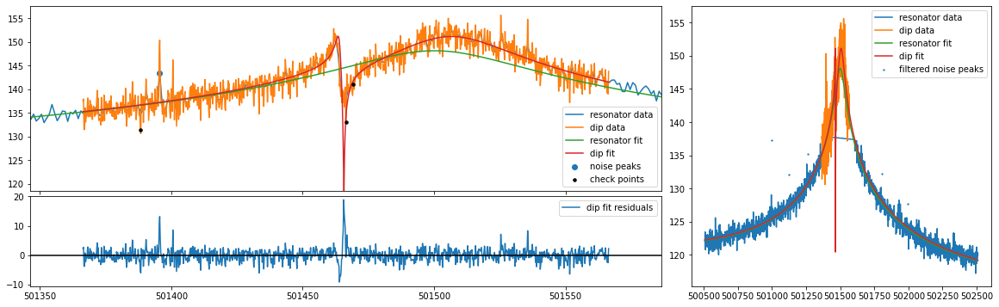

mean fit residuals = 1.7e-02 +/- 7.0e-02
{'A': 1288998873072781.0, 'dA': 55332096162188.01, 'Q': 11620.036860363387, 'dQ': 328.6459596299107, 'offset': 586754523208.3142, 'doffset': 16983839475.424555, 'slope': -0.0015029506787373659, 'dslope': 3.724504489183522e-05, 'nu_res': 501504.4923778758, 'dnu_res': 0.5383951939034095, 'nu_z': 501465.6796339559, 'dnu_z': 0.02588873235842212, 'dip_width': 8.352274130979895, 'ddip_width': 0.45473320248532584, 'pcov': array([[ 6.702264631260e-04,  2.361952411073e-03,  1.692613490945e+09,
         2.594220194544e-02, -9.059366006583e-04],
       [ 2.361952411073e-03,  2.067822854426e-01,  1.159281329799e+13,
         7.240421228874e+01, -2.196773083719e-02],
       [ 1.692613490945e+09,  1.159281329799e+13,  3.061640865702e+27,
         1.673702634427e+16, -2.661732466459e+12],
       [ 2.594220194543e-02,  7.240421228874e+01,  1.673702634427e+16,
         1.080081667811e+05, -3.389184314980e+01],
       [-9.059366006583e-04, -2.196773083719e-02, -2

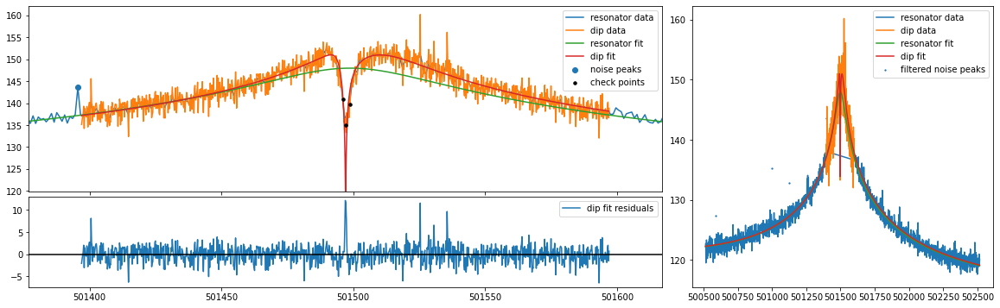

mean fit residuals = 9.3e-03 +/- 6.2e-02
{'A': 1253904066026661.2, 'dA': 47241367842731.78, 'Q': 11532.917138816143, 'dQ': 285.7438495389473, 'offset': 596579168276.5979, 'doffset': 16925996716.918064, 'slope': -0.0015283196226386865, 'dslope': 3.721867066920897e-05, 'nu_res': 501504.6649257995, 'dnu_res': 0.4415386441372588, 'nu_z': 501497.1084444365, 'dnu_z': 0.020499647630325496, 'dip_width': 6.735703216981559, 'ddip_width': 0.342473384071665, 'pcov': array([[ 4.202355529675e-04,  2.673719348024e-04,  3.098883002242e+08,
         1.550257642358e-03, -5.435216068388e-04],
       [ 2.673719348024e-04,  1.172880187975e-01,  7.023331047205e+12,
         4.461686085795e+01, -2.602452266832e-03],
       [ 3.098883002248e+08,  7.023331047205e+12,  2.231746835652e+27,
         1.248603275957e+16, -4.772325333988e+11],
       [ 1.550257642361e-03,  4.461686085795e+01,  1.248603275957e+16,
         8.164954754934e+04, -4.873338310426e+00],
       [-5.435216068388e-04, -2.602452266831e-03, -4.

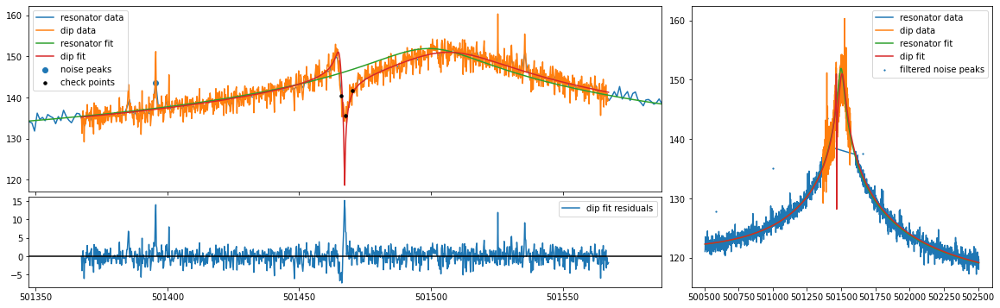

mean fit residuals = 1.7e-02 +/- 6.9e-02
{'A': 1262968668424162.2, 'dA': 53370432066440.59, 'Q': 11598.421257166781, 'dQ': 323.05741374691826, 'offset': 595206938945.4786, 'doffset': 17383893689.699677, 'slope': -0.0015612115228952833, 'dslope': 3.8147574770594576e-05, 'nu_res': 501504.28329885035, 'dnu_res': 0.5285822729026096, 'nu_z': 501467.25456465845, 'dnu_z': 0.027927971769893447, 'dip_width': 8.893980282192981, 'ddip_width': 0.4653981125115931, 'pcov': array([[ 7.799716071800e-04,  2.494346546190e-03,  7.950346167716e+08,
         1.694863798933e-02, -1.043776640186e-03],
       [ 2.494346546190e-03,  2.165954031294e-01,  1.172693308974e+13,
         7.463774246207e+01, -2.213740679128e-02],
       [ 7.950346167716e+08,  1.172693308974e+13,  2.848403018959e+27,
         1.587316568779e+16, -2.469357737133e+12],
       [ 1.694863798933e-02,  7.463774246207e+01,  1.587316568779e+16,
         1.043660925768e+05, -3.173332453535e+01],
       [-1.043776640186e-03, -2.213740679128e-02

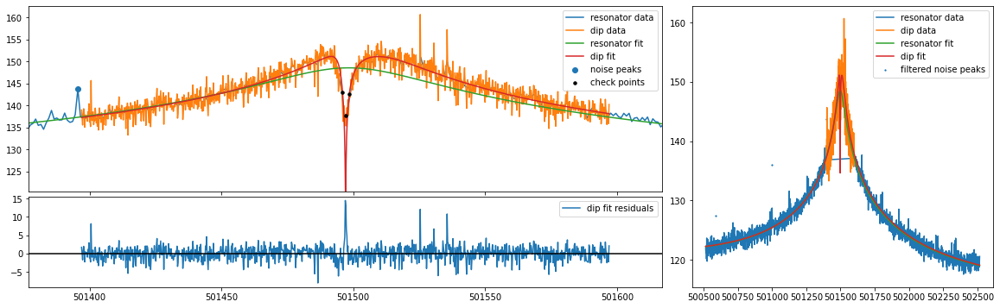

mean fit residuals = 9.2e-03 +/- 6.3e-02
{'A': 1291600803034350.5, 'dA': 49861027033536.35, 'Q': 11653.996369180799, 'dQ': 294.9383523408167, 'offset': 576554767666.079, 'doffset': 17533516155.74503, 'slope': -0.0015347556649730454, 'dslope': 3.866961167515674e-05, 'nu_res': 501504.1247493145, 'dnu_res': 0.44701971484757713, 'nu_z': 501497.10528473655, 'dnu_z': 0.019923317384047786, 'dip_width': 6.287540403723379, 'ddip_width': 0.3347579230004095, 'pcov': array([[ 3.969385755855e-04,  2.237687174306e-04,  1.578690511318e+08,
        -1.864803284427e-04, -5.132273482931e-04],
       [ 2.237687174306e-04,  1.120628670115e-01,  7.075880778280e+12,
         4.393526530405e+01, -2.292623316896e-03],
       [ 1.578690511311e+08,  7.075880778280e+12,  2.486122016839e+27,
         1.361311205386e+16, -4.751970461633e+11],
       [-1.864803284467e-04,  4.393526530405e+01,  1.361311205386e+16,
         8.698863168152e+04, -4.675249911982e+00],
       [-5.132273482931e-04, -2.292623316897e-03, -4

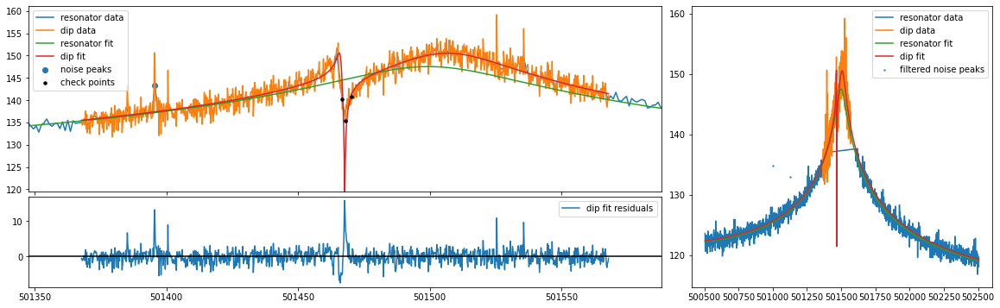

mean fit residuals = 1.2e-02 +/- 6.6e-02
{'A': 1130642719107337.2, 'dA': 43545126363385.57, 'Q': 10599.319291050862, 'dQ': 276.5235204055681, 'offset': 572805972609.7013, 'doffset': 17115219434.15494, 'slope': -0.001541608048041891, 'dslope': 3.736576885382568e-05, 'nu_res': 501504.6180522519, 'dnu_res': 0.5356668493920597, 'nu_z': 501467.68728213664, 'dnu_z': 0.02218989486457887, 'dip_width': 6.822171343812659, 'ddip_width': 0.3715813256185222, 'pcov': array([[ 4.923914341011e-04,  1.539860679780e-03,  1.478622031490e+09,
         2.281205145053e-02, -6.927963862901e-04],
       [ 1.539860679780e-03,  1.380726815484e-01,  6.772533270338e+12,
         4.527699149020e+01, -1.671064430809e-02],
       [ 1.478622031490e+09,  6.772533270338e+12,  1.896178030003e+27,
         1.100363578696e+16, -2.213878475253e+12],
       [ 2.281205145053e-02,  4.527699149020e+01,  1.100363578696e+16,
         7.646525733749e+04, -3.016003502876e+01],
       [-6.927963862901e-04, -1.671064430809e-02, -2.2

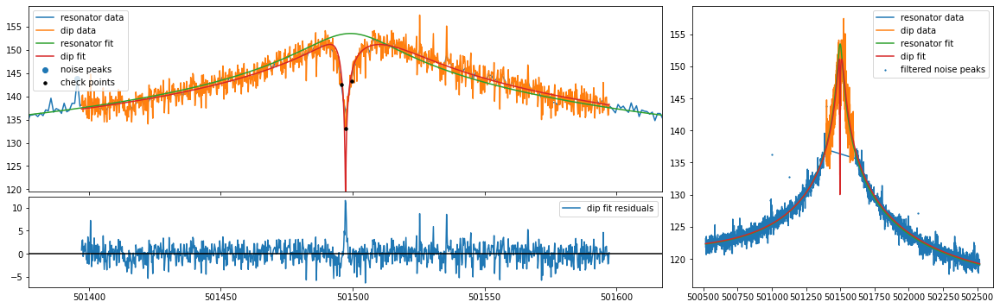

mean fit residuals = 9.2e-03 +/- 6.2e-02
{'A': 1290203166994096.2, 'dA': 49206005186234.734, 'Q': 11679.679576825189, 'dQ': 291.89378961397875, 'offset': 614752062188.0975, 'doffset': 16960866896.53124, 'slope': -0.0015191679387239227, 'dslope': 3.7339364813714424e-05, 'nu_res': 501504.34079173463, 'dnu_res': 0.4407756874863083, 'nu_z': 501497.2871117651, 'dnu_z': 0.02118577948859754, 'dip_width': 7.114272089071277, 'ddip_width': 0.35693917128914865, 'pcov': array([[ 4.488372525395e-04,  2.704728766638e-04,  3.450809621519e+08,
         1.624151110483e-03, -5.778228349593e-04],
       [ 2.704728766638e-04,  1.274055720006e-01,  7.809735894410e+12,
         4.865485429443e+01, -2.567779387839e-03],
       [ 3.450809621519e+08,  7.809735894410e+12,  2.421230946388e+27,
         1.329676122790e+16, -4.614297416973e+11],
       [ 1.624151110483e-03,  4.865485429443e+01,  1.329676122790e+16,
         8.520198441521e+04, -4.564021102784e+00],
       [-5.778228349593e-04, -2.567779387838e-03,

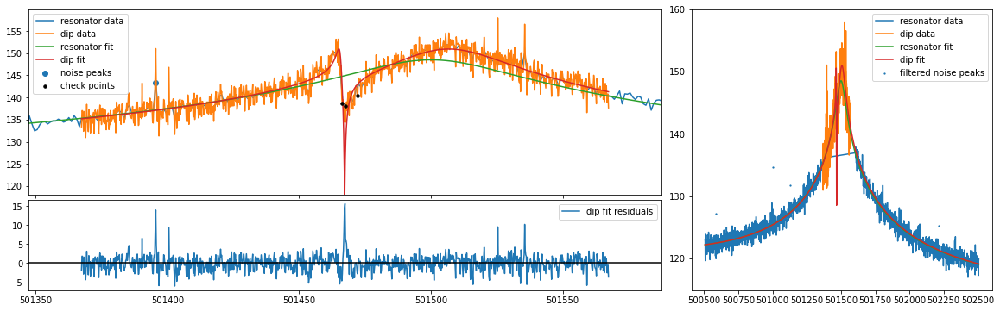

mean fit residuals = 1.5e-02 +/- 6.7e-02
{'A': 1245823479332561.0, 'dA': 51019150768798.07, 'Q': 11517.76729002277, 'dQ': 311.50465553740247, 'offset': 568096394721.2324, 'doffset': 17364512584.71026, 'slope': -0.0015444352723784608, 'dslope': 3.83157422267852e-05, 'nu_res': 501504.6349459184, 'dnu_res': 0.5169397025104557, 'nu_z': 501467.27070680034, 'dnu_z': 0.024413407387543114, 'dip_width': 8.007236645739729, 'ddip_width': 0.42316139533036806, 'pcov': array([[ 5.960144602701e-04,  1.983295556209e-03,  1.340197890694e+09,
         2.130660778061e-02, -8.062413958690e-04],
       [ 1.983295556209e-03,  1.790655664979e-01,  9.788464380861e+12,
         6.284429772171e+01, -1.896419239622e-02],
       [ 1.340197890694e+09,  9.788464380861e+12,  2.602953745169e+27,
         1.462211333928e+16, -2.340007525495e+12],
       [ 2.130660778061e-02,  6.284429772171e+01,  1.462211333928e+16,
         9.703515042148e+04, -3.042996133672e+01],
       [-8.062413958690e-04, -1.896419239622e-02, -2

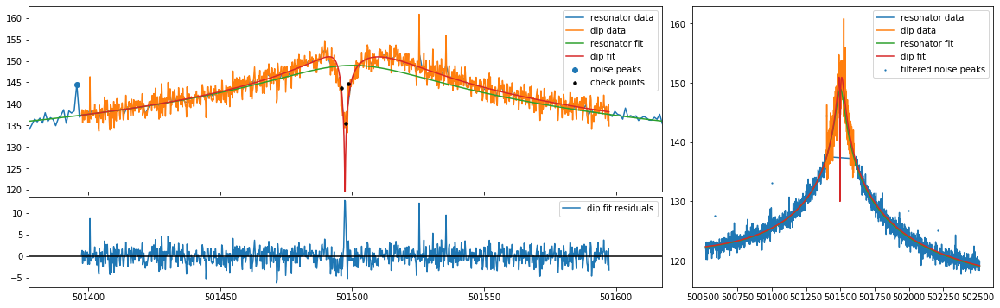

mean fit residuals = 1.1e-02 +/- 6.1e-02
{'A': 1242104297044133.2, 'dA': 45721080336369.76, 'Q': 11356.463571691947, 'dQ': 276.1215634116752, 'offset': 592655916713.4022, 'doffset': 17320300269.50595, 'slope': -0.001551146524427025, 'dslope': 3.771457868888818e-05, 'nu_res': 501503.95170862135, 'dnu_res': 0.4383662231372529, 'nu_z': 501497.28834849823, 'dnu_z': 0.020442833041940247, 'dip_width': 6.950293396794129, 'ddip_width': 0.3429700159620903, 'pcov': array([[ 4.179094227806e-04,  2.318377039473e-04,  3.004127755754e+08,
         1.242308445309e-03, -5.432822746890e-04],
       [ 2.318377039473e-04,  1.176284318490e-01,  6.868155429482e+12,
         4.357672650906e+01, -2.274957454670e-03],
       [ 3.004127755749e+08,  6.868155429482e+12,  2.090417187125e+27,
         1.166526848067e+16, -4.121708053777e+11],
       [ 1.242308445307e-03,  4.357672650906e+01,  1.166526848067e+16,
         7.624311778091e+04, -4.065963232849e+00],
       [-5.432822746890e-04, -2.274957454671e-03, -4

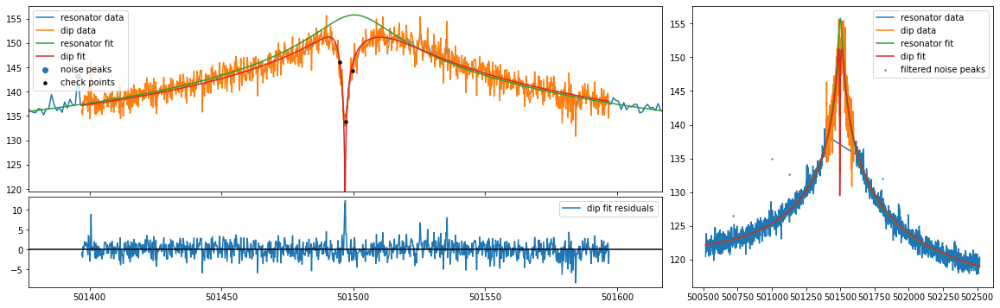

mean fit residuals = 1.0e-02 +/- 6.1e-02
{'A': 1317900238558080.8, 'dA': 49855807456074.23, 'Q': 11958.654334648065, 'dQ': 294.48516745254494, 'offset': 569714096645.6256, 'doffset': 16277044594.954617, 'slope': -0.0015379211910995, 'dslope': 3.6799483931079906e-05, 'nu_res': 501504.10647302086, 'dnu_res': 0.4261855440965716, 'nu_z': 501496.9018033169, 'dnu_z': 0.021273961253242008, 'dip_width': 7.815549301383082, 'ddip_width': 0.37159482432060315, 'pcov': array([[ 4.525814274044e-04,  2.935009931628e-04,  3.972284682095e+08,
         2.089154288100e-03, -5.790458047210e-04],
       [ 2.935009931628e-04,  1.380827134619e-01,  8.592423252330e+12,
         5.327106206670e+01, -2.638563192270e-03],
       [ 3.972284682084e+08,  8.592423252330e+12,  2.485601537097e+27,
         1.361398189130e+16, -4.400911116265e+11],
       [ 2.089154288094e-03,  5.327106206670e+01,  1.361398189130e+16,
         8.672151384955e+04, -4.319132207672e+00],
       [-5.790458047210e-04, -2.638563192270e-03, -

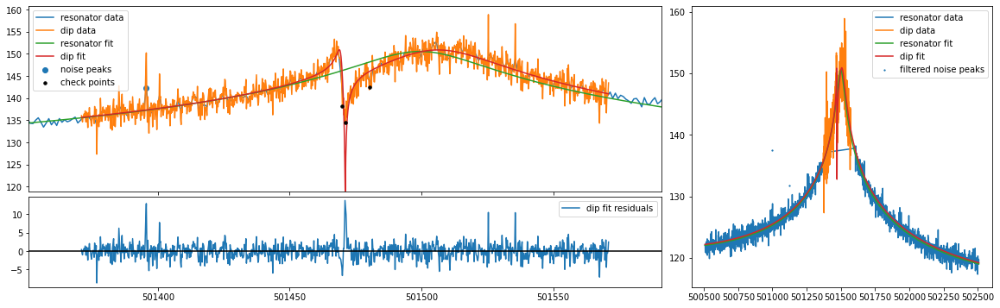

mean fit residuals = 1.1e-02 +/- 6.7e-02
{'A': 1229042960233469.8, 'dA': 49126222750873.58, 'Q': 11172.14292916134, 'dQ': 297.3176545429472, 'offset': 554540830806.717, 'doffset': 16678238716.797686, 'slope': -0.0014774865200430972, 'dslope': 3.769091858115985e-05, 'nu_res': 501504.19438942376, 'dnu_res': 0.5137956708851459, 'nu_z': 501471.07717362954, 'dnu_z': 0.022218069004388757, 'dip_width': 7.02217881279845, 'ddip_width': 0.38314665750523463, 'pcov': array([[ 4.936425902838e-04,  1.454601934271e-03,  1.481720195475e+09,
         2.039734965281e-02, -6.727034820025e-04],
       [ 1.454601934271e-03,  1.468013611574e-01,  8.103287933946e+12,
         5.156912390105e+01, -1.481650069985e-02],
       [ 1.481720195475e+09,  8.103287933946e+12,  2.413385761768e+27,
         1.342437722121e+16, -2.108275031450e+12],
       [ 2.039734965281e-02,  5.156912390105e+01,  1.342437722121e+16,
         8.839778770292e+04, -2.659560804828e+01],
       [-6.727034820025e-04, -1.481650069985e-02, -2

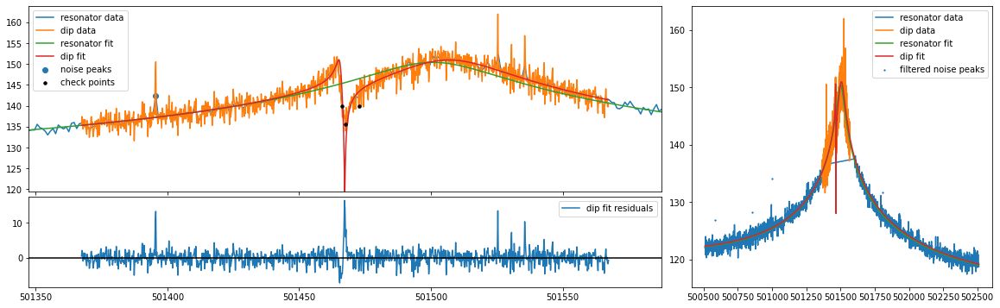

mean fit residuals = 1.4e-02 +/- 6.7e-02
{'A': 1249483618938400.2, 'dA': 50700377748450.2, 'Q': 11365.914780043091, 'dQ': 305.78802102893013, 'offset': 583025705038.9089, 'doffset': 16568642634.498512, 'slope': -0.001553050728336935, 'dslope': 3.6366144105602285e-05, 'nu_res': 501504.69193782425, 'dnu_res': 0.5204926410213765, 'nu_z': 501467.2955451126, 'dnu_z': 0.02415249169741461, 'dip_width': 7.994547061617171, 'ddip_width': 0.4209799570825472, 'pcov': array([[ 5.833428551937e-04,  1.977396351209e-03,  1.907168553259e+09,
         2.738943426947e-02, -7.972045327145e-04],
       [ 1.977396351209e-03,  1.772241242652e-01,  9.641105588969e+12,
         6.116174834772e+01, -1.914967051241e-02],
       [ 1.907168553259e+09,  9.641105588969e+12,  2.570528303836e+27,
         1.424830242639e+16, -2.373809663508e+12],
       [ 2.738943426947e-02,  6.116174834772e+01,  1.424830242639e+16,
         9.350631380479e+04, -3.054897787692e+01],
       [-7.972045327145e-04, -1.914967051241e-02, -2

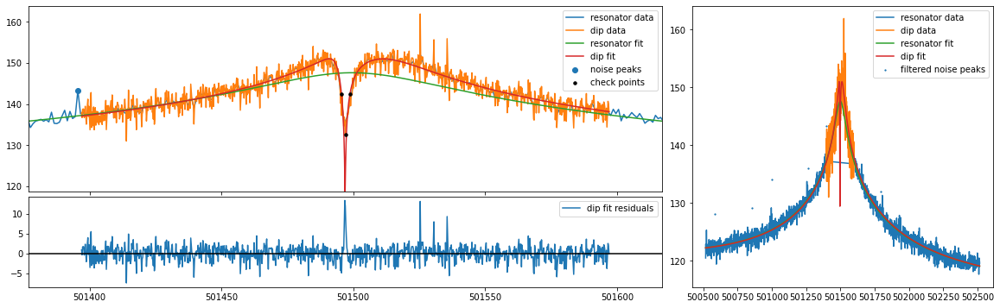

mean fit residuals = 1.2e-02 +/- 6.2e-02
{'A': 1254632464685936.0, 'dA': 48028963626127.125, 'Q': 11661.525621527191, 'dQ': 292.6946228120113, 'offset': 590028114726.8486, 'doffset': 17054689066.940086, 'slope': -0.0015228625016216507, 'dslope': 3.740649059449158e-05, 'nu_res': 501505.34372556856, 'dnu_res': 0.4437241493701841, 'nu_z': 501496.9140318732, 'dnu_z': 0.022754869465266486, 'dip_width': 8.018921907597058, 'ddip_width': 0.3862197896380079, 'pcov': array([[ 5.177840843813e-04,  4.132165619464e-04,  7.625066488806e+08,
         6.274089107111e-03, -6.663564173340e-04],
       [ 4.132165619464e-04,  1.491657259080e-01,  8.627975128613e+12,
         5.522932472169e+01, -3.491063280614e-03],
       [ 7.625066488792e+08,  8.627975128613e+12,  2.306781347000e+27,
         1.301196745412e+16, -5.171360842003e+11],
       [ 6.274089107103e-03,  5.522932472169e+01,  1.301196745412e+16,
         8.567014222307e+04, -5.405434998491e+00],
       [-6.663564173340e-04, -3.491063280615e-03, 

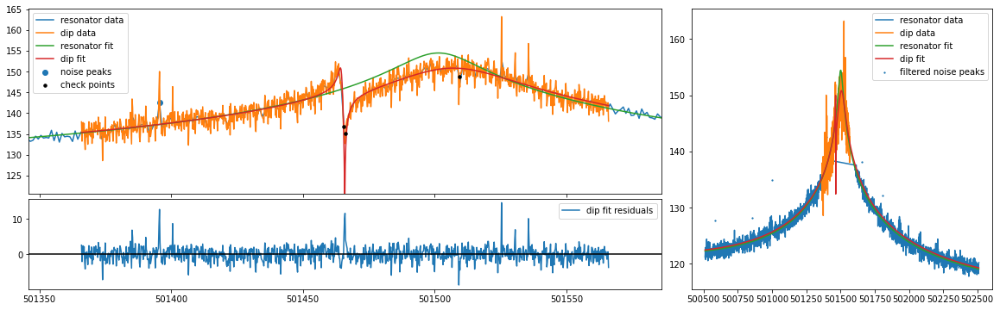

mean fit residuals = 6.9e-03 +/- 6.6e-02
{'A': 1211702994299616.8, 'dA': 47661444551505.234, 'Q': 10960.574431382503, 'dQ': 289.1058520825317, 'offset': 586882470280.5383, 'doffset': 16918749259.44786, 'slope': -0.0015770319576581563, 'dslope': 3.734729351250203e-05, 'nu_res': 501505.5965261767, 'dnu_res': 0.5324908863748239, 'nu_z': 501465.8870612907, 'dnu_z': 0.020592264853490798, 'dip_width': 5.869383603271046, 'ddip_width': 0.3441140315009551, 'pcov': array([[ 4.240413717963e-04,  1.510951059603e-03,  1.798124188565e+09,
         2.533470139177e-02, -5.981961874832e-04],
       [ 1.510951059603e-03,  1.184144666758e-01,  6.477119130837e+12,
         4.134193017474e+01, -1.519441408332e-02],
       [ 1.798124188565e+09,  6.477119130837e+12,  2.271613296736e+27,
         1.261443158889e+16, -2.458477166100e+12],
       [ 2.533470139177e-02,  4.134193017474e+01,  1.261443158889e+16,
         8.358219370837e+04, -3.247657786914e+01],
       [-5.981961874832e-04, -1.519441408332e-02, -2

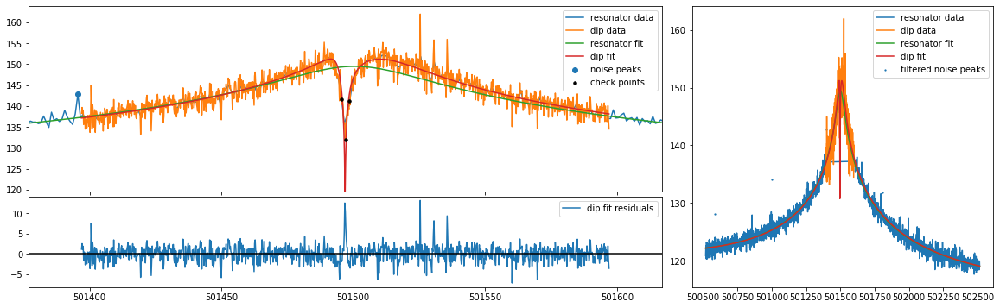

mean fit residuals = 8.5e-03 +/- 6.2e-02
{'A': 1318166058777409.2, 'dA': 50476792113636.95, 'Q': 11930.126972284805, 'dQ': 297.57303621464774, 'offset': 584943155502.1273, 'doffset': 16960997031.76924, 'slope': -0.0015067869330237479, 'dslope': 3.736152001439818e-05, 'nu_res': 501504.72900532803, 'dnu_res': 0.4326022836616584, 'nu_z': 501496.91272231826, 'dnu_z': 0.020542235567119062, 'dip_width': 6.9558690001833785, 'ddip_width': 0.3504133500215216, 'pcov': array([[ 4.219834420950e-04,  2.875678437851e-04,  2.827998242419e+08,
         1.137172396673e-03, -5.403291635975e-04],
       [ 2.875678437851e-04,  1.227895158733e-01,  7.838911671657e+12,
         4.850329190618e+01, -2.619534150404e-03],
       [ 2.827998242412e+08,  7.838911671657e+12,  2.547906542083e+27,
         1.392571846072e+16, -4.834097574059e+11],
       [ 1.137172396669e-03,  4.850329190618e+01,  1.392571846072e+16,
         8.854971188200e+04, -4.826711937170e+00],
       [-5.403291635975e-04, -2.619534150404e-03,

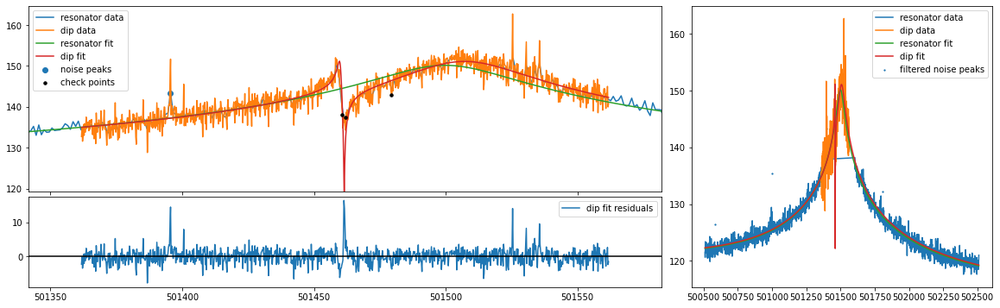

mean fit residuals = 1.4e-02 +/- 6.9e-02
{'A': 1288281700725261.2, 'dA': 53943867988527.95, 'Q': 11481.907710462487, 'dQ': 318.22078517951377, 'offset': 586864317970.5974, 'doffset': 17001203755.136036, 'slope': -0.0015070281563566608, 'dslope': 3.73345818993835e-05, 'nu_res': 501505.4514382803, 'dnu_res': 0.5482385746214365, 'nu_z': 501461.48561240174, 'dnu_z': 0.02402180089231368, 'dip_width': 7.597970529624859, 'ddip_width': 0.42302027350973553, 'pcov': array([[ 5.770469181100e-04,  2.319962632959e-03,  2.043033072423e+09,
         3.175490180100e-02, -8.040002115932e-04],
       [ 2.319962632959e-03,  1.789461518003e-01,  1.003345325110e+13,
         6.227601591240e+01, -2.253512049174e-02],
       [ 2.043033072423e+09,  1.003345325110e+13,  2.909940893564e+27,
         1.574650343864e+16, -2.912725116185e+12],
       [ 3.175490180100e-02,  6.227601591240e+01,  1.574650343864e+16,
         1.012644681203e+05, -3.863457253584e+01],
       [-8.040002115932e-04, -2.253512049174e-02, -

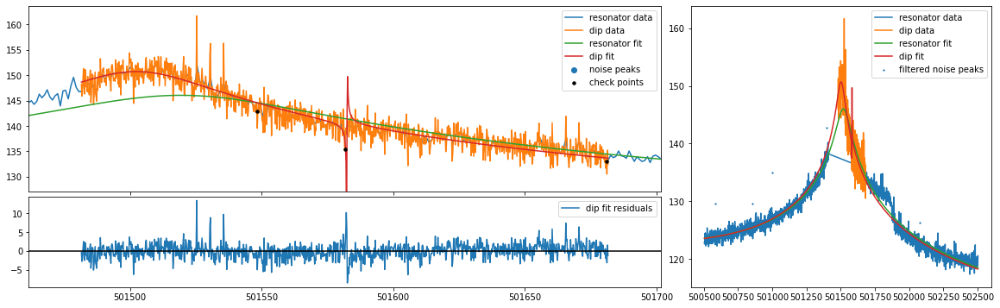

mean fit residuals = 2.3e-03 +/- 6.4e-02
{'A': 1174381590116765.2, 'dA': 43101280801654.74, 'Q': 9434.619678150755, 'dQ': 230.0305955120933, 'offset': 413488253974.5761, 'doffset': 26326444910.41105, 'slope': -0.0026560084867289237, 'dslope': 4.835496901964977e-05, 'nu_res': 501502.99662047025, 'dnu_res': 0.9495510099524439, 'nu_z': 501582.3099767503, 'dnu_z': 0.01584675365178304, 'dip_width': 2.0000000086314276, 'ddip_width': 0.21022695647149076, 'pcov': array([[ 2.511196013003e-04, -1.666359224597e-03,  3.473051531973e+09,
        -3.373472723353e-02, -6.605337801848e-04],
       [-1.666359224597e-03,  4.419537322727e-02,  1.887487369926e+12,
         1.074697183599e+01,  8.847531578722e-03],
       [ 3.473051531973e+09,  1.887487369926e+12,  1.857720406743e+27,
         8.030957024291e+15, -5.600965397377e+12],
       [-3.373472723353e-02,  1.074697183599e+01,  8.030957024291e+15,
         5.291407487165e+04,  7.103438547145e+01],
       [-6.605337801848e-04,  8.847531578722e-03, -5

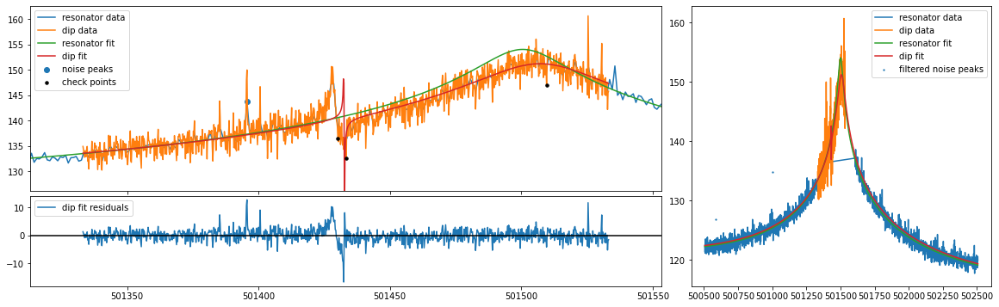

mean fit residuals = 1.7e-03 +/- 7.2e-02
{'A': 1325039954920825.5, 'dA': 57624319346680.42, 'Q': 11495.073082438259, 'dQ': 326.2690002970648, 'offset': 608265311844.7203, 'doffset': 16981725563.422838, 'slope': -0.0015432800298484908, 'dslope': 3.714318482357421e-05, 'nu_res': 501506.92100673716, 'dnu_res': 0.7742916135108656, 'nu_z': 501432.7162737163, 'dnu_z': 0.01783843668340102, 'dip_width': 2.0000000000000004, 'ddip_width': 0.24293617742855603, 'pcov': array([[ 3.182098233077e-04,  1.873570531858e-03,  1.675202714617e+09,
         1.997527834532e-02, -5.218082694986e-04],
       [ 1.873570531858e-03,  5.901798630360e-02,  2.541451877932e+12,
         1.550437473768e+01, -1.277234537404e-02],
       [ 1.675202714617e+09,  2.541451877932e+12,  3.320562180168e+27,
         1.657692888957e+16, -6.834539043631e+11],
       [ 1.997527834532e-02,  1.550437473768e+01,  1.657692888957e+16,
         1.064514605548e+05, -7.813556570908e+01],
       [-5.218082694986e-04, -1.277234537404e-02, 

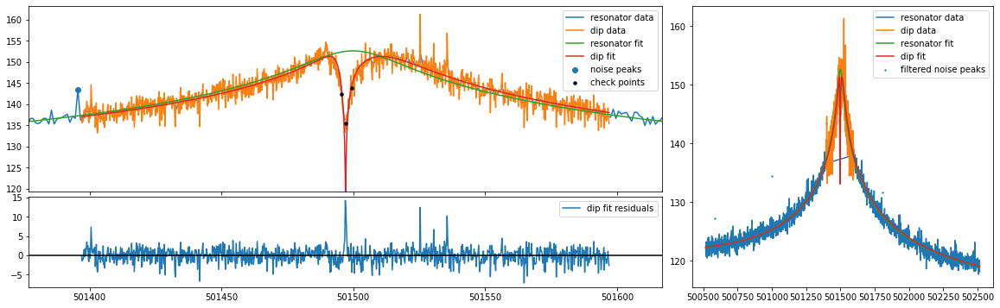

mean fit residuals = 1.2e-02 +/- 6.3e-02
{'A': 1356874577832937.0, 'dA': 53460218847322.57, 'Q': 12186.57572598626, 'dQ': 310.98716405679085, 'offset': 613522084535.9683, 'doffset': 16918757021.294287, 'slope': -0.0015701783235476962, 'dslope': 3.728746744103247e-05, 'nu_res': 501504.8825397128, 'dnu_res': 0.4352229865719961, 'nu_z': 501497.0918964551, 'dnu_z': 0.02252373093923993, 'dip_width': 7.994544876165957, 'ddip_width': 0.39028497351738184, 'pcov': array([[ 5.073184554233e-04,  3.538526234810e-04,  4.084307559973e+08,
         1.930441382798e-03, -6.442995802302e-04],
       [ 3.538526234810e-04,  1.523223605535e-01,  9.794190768122e+12,
         5.979563149318e+01, -3.123918648882e-03],
       [ 4.084307559972e+08,  9.794190768122e+12,  2.857994999204e+27,
         1.543473956132e+16, -5.153093155604e+11],
       [ 1.930441382798e-03,  5.979563149318e+01,  1.543473956132e+16,
         9.671301620809e+04, -5.056093607711e+00],
       [-6.442995802302e-04, -3.123918648882e-03, -5

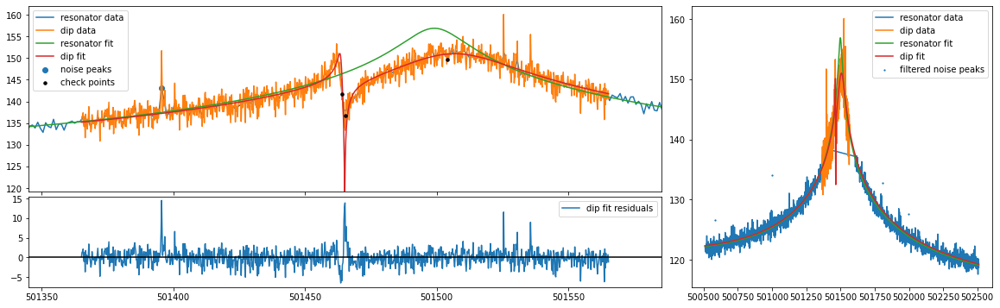

mean fit residuals = 1.2e-02 +/- 6.6e-02
{'A': 1267698844092069.8, 'dA': 50385467210309.33, 'Q': 11386.315436621744, 'dQ': 300.0363694064183, 'offset': 590095998385.0717, 'doffset': 16673688558.423563, 'slope': -0.001505082443395612, 'dslope': 3.681207039124455e-05, 'nu_res': 501505.0144861199, 'dnu_res': 0.5147154944096458, 'nu_z': 501465.07939550426, 'dnu_z': 0.022199700108086112, 'dip_width': 7.083494617236606, 'ddip_width': 0.3839600542709948, 'pcov': array([[ 4.928266848890e-04,  1.786748599130e-03,  1.715496861069e+09,
         2.505707620726e-02, -6.794839449666e-04],
       [ 1.786748599130e-03,  1.474253232758e-01,  8.309212999076e+12,
         5.205026588002e+01, -1.739895623710e-02],
       [ 1.715496861069e+09,  8.309212999076e+12,  2.538695306001e+27,
         1.388214209213e+16, -2.432999724047e+12],
       [ 2.505707620726e-02,  5.205026588002e+01,  1.388214209213e+16,
         9.002182296658e+04, -3.152742797147e+01],
       [-6.794839449666e-04, -1.739895623710e-02, -2

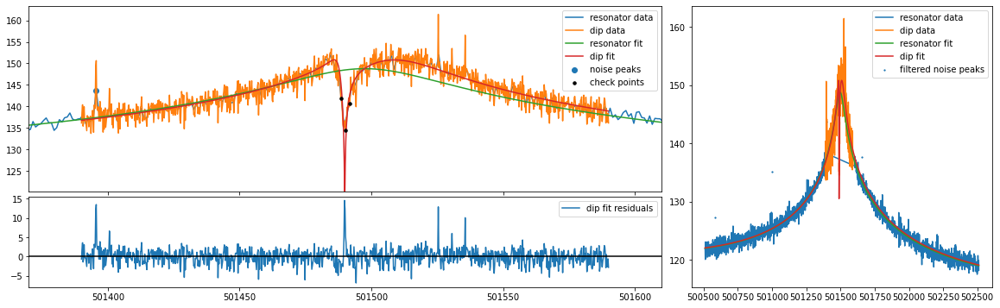

mean fit residuals = 1.0e-02 +/- 6.5e-02
{'A': 1205637274625773.2, 'dA': 47429628587978.695, 'Q': 11169.856094435807, 'dQ': 291.786115061395, 'offset': 549306789569.4108, 'doffset': 16745978982.52194, 'slope': -0.0014514518480677617, 'dslope': 3.74324963654372e-05, 'nu_res': 501504.8113836023, 'dnu_res': 0.48126482479240723, 'nu_z': 501489.8978398589, 'dnu_z': 0.02134270567595255, 'dip_width': 6.69280828044219, 'ddip_width': 0.36093911661095684, 'pcov': array([[ 4.555110855703e-04,  5.906674097664e-04,  6.343571447344e+08,
         6.520949556394e-03, -6.002314762405e-04],
       [ 5.906674097664e-04,  1.302770458999e-01,  7.344962645042e+12,
         4.747126682549e+01, -5.904511406861e-03],
       [ 6.343571447345e+08,  7.344962645042e+12,  2.249569667994e+27,
         1.276595583337e+16, -9.465914568245e+11],
       [ 6.520949556395e-03,  4.747126682549e+01,  1.276595583337e+16,
         8.513913694262e+04, -1.090311388986e+01],
       [-6.002314762405e-04, -5.904511406861e-03, -9.4

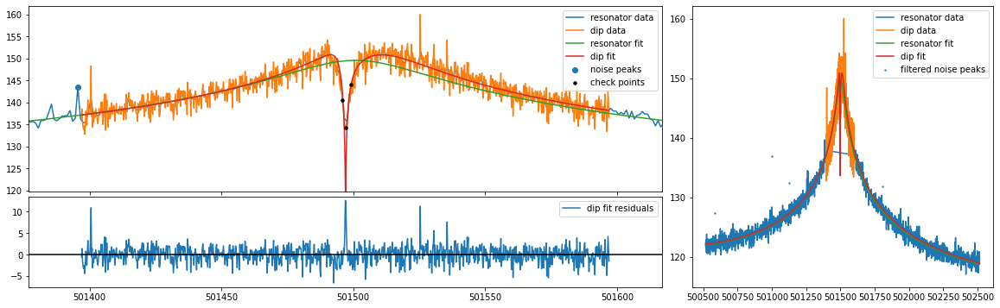

mean fit residuals = 9.5e-03 +/- 6.3e-02
{'A': 1213275989717730.2, 'dA': 46105972691177.23, 'Q': 11352.25456215978, 'dQ': 284.97717548197505, 'offset': 541036987586.8, 'doffset': 16665094762.41825, 'slope': -0.0015364679919652527, 'dslope': 3.819093812785764e-05, 'nu_res': 501505.1720027641, 'dnu_res': 0.45321437133230663, 'nu_z': 501497.0958538403, 'dnu_z': 0.020810960961582192, 'dip_width': 7.006053515205126, 'ddip_width': 0.35552780812520585, 'pcov': array([[ 4.330960961445e-04,  2.975323879658e-04,  3.850718094026e+08,
         2.505379289656e-03, -5.647113499680e-04],
       [ 2.975323879658e-04,  1.264000223503e-01,  7.204861950207e+12,
         4.677263660980e+01, -3.032504441698e-03],
       [ 3.850718094025e+08,  7.204861950207e+12,  2.125760717800e+27,
         1.213999431703e+16, -5.139225196296e+11],
       [ 2.505379289655e-03,  4.677263660980e+01,  1.213999431703e+16,
         8.121199054568e+04, -5.423918779987e+00],
       [-5.647113499680e-04, -3.032504441698e-03, -5.1

In [34]:
## NOW FITTING THE DATA


fit_func = settings["fit_function"]

fitdata = pd.DataFrame( columns=["cycle", "TR", "time", "ref", "nu_z", "dnu_z", "dip_width", "ddip_width", "fit_success", "nu_res", "dnu_res", "Q", "dQ", "offset", "doffset", "A", "dA", "slope", "dslope", "fit_quality", "redchi"] )

if not settings["reuse_fitdata"]:

    for path in raw_data_keys:

        print(path)
        if not path.endswith(".spec"):
            continue

        try:
            spec = data_conversion.Spectrum(data_root[path])
            attrs = data_conversion.attrs_to_dict(data_root[path])
            center = meas_config["nu_z"] - 20
        except:
            print("load spec error")

        spec.cut(center, 4000)
        #spec.downsample(3, inplace=True)
        #print("cut and down sampled")

        x = spec.freqs
        y = spec.amps
        time = attrs["time"]
        ref = attrs.get("ref", False)
        tr = attrs["test_tr"]
        cycle = attrs["cycle"]

        try:
            if len(x) < 1000:
                # typically at least a resolution of 0.1 Hz (seconds), so at least 1000 kHz span, otherwise, its bad data.
                raise IndexError("The given spectrum is too small (<10000 points) to be an axial spectrum... ")

            q =12
            if fit_func == 'pavel':
                pconfig = {
                    #"center" : nu_z,
                    #"nu_z" : nu_z,
                    #"dip_center": nu_z,
                    "res_span" : 2000,
                    "resonator_span" : 2000, # same same
                    "span" : 10,
                    "dip_span": 200,
                    "q_guess" : 8000, 
                    "dip_range" : 10, 
                    "width_range" : [0.05*q, 0.3*q],
                    "dip_width_guess": 0.3*q,
                    "min_dip_width": 0.05,
                    "plot": True,
                    "print_fit_report": False,
                    "plot_results": True,
                    "fancy_plot": True,
                    "equal_widths": False,
                    "vary_offset": False,
                    "vary_slope": False,
                    "vary_A": True,
                    "vary_nu_res": True,
                    "vary_Q": True,
                    "vary_nu_z_jitter": False,
                    "nu_z_jitter": 0.0,
                    "slope": 0.0,
                    "min_dip_depth": 2.0,
                }
                fit_config.update(pconfig)
                
                fit_obj = fitaxialClass_Pavel.AXIAl_FIT(fit_config)
                fdata = fit_obj.fit_axial_dip(x, y, downsample=5)
            else:
                #fit_obj = fitaxial.AXIAl_FIT()
                fit_obj = fitaxialClass_old.AXIAl_FIT()
                popt, perr, fdata = fit_obj.fit_axial_dip_test_new(x, y)
            
            
            del fit_obj
            #popt, perr, fdata = mennofit(x, y, nu_z_guess, res_span=1000, dip_span=50, fixed_res=True, show=True)
            #fdata, popt, perr = fit_dip_alex(x, y, **fit_config)

            cdata = [cycle, tr, time, ref, fdata["nu_z"], fdata["dnu_z"], fdata["dip_width"], fdata["ddip_width"], fdata["fit_success"], fdata["nu_res"], fdata["dnu_res"],
                    fdata["Q"], fdata["dQ"], fdata["offset"], fdata["doffset"], fdata["A"], fdata["dA"], fdata["slope"], fdata["dslope"], fdata["fit_quality"], fdata["redchi"] ]
            print(fdata)
        except:
            raise
            print("fit failed for", path)
            continue

        dset = pd.Series(data=cdata, index=fitdata.columns)
        fitdata = fitdata.append(dset, ignore_index=True)


In [36]:
if not settings["reuse_fitdata"]:
    fitdata["time"] = pd.to_datetime(fitdata['time'], format='%Y%m%d_%H%M%S.%f')
    #display(avg_axial_fitdata)
    display(fitdata)

    fitdata.to_csv(output_folder + "/fitdata.csv", index=False)
else:
    fitdata = pd.read_csv(output_folder + "/fitdata.csv")

,cycle,TR,time,ref,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,...,Q,dQ,offset,doffset,A,dA,slope,dslope,fit_quality,redchi
0,0,0.8766,2021-12-07 13:54:11.799304,False,501503.684227125603,0.022268100169,8.076640606122,0.392775439427,True,501504.066109451640,...,11873.629740367469,302.906379397841,5.203494685385e+11,1.714485370427e+10,1.250314718206e+15,4.890930784983e+13,-0.001513910973,0.000039377344,2.010226093603,4.027214728278
1,1,0.8866,2021-12-07 13:56:25.840512,False,501469.090107872733,0.020792678931,6.336372509839,0.359189047681,True,501504.856007663650,...,11510.021283987378,305.406319749306,5.368411577204e+11,1.686550739263e+10,1.235574273471e+15,4.965902740643e+13,-0.001491102435,0.000038485472,1.548507136686,4.392897308353
2,10,0.8866,2021-12-07 14:21:19.496042,False,501449.700173756457,0.022661485156,7.031386030747,0.402888277592,True,501504.820467491634,...,11256.056807818159,306.669367940843,5.427356864914e+11,1.628678040833e+10,1.229624961521e+15,5.023218623031e+13,-0.001566638474,0.000036956586,4.851787062829,4.686173980772
3,10,0.8866,2021-12-07 14:22:52.485183,True,501496.916533041745,0.020037768637,6.335258266654,0.336240975701,True,501504.749772371433,...,11684.287299728485,295.598117593628,5.732434577473e+11,1.666757759249e+10,1.283303720203e+15,4.955728276247e+13,-0.001611565590,0.000037453361,0.934903420471,3.977533913028
4,11,0.8866,2021-12-07 14:24:05.414795,False,501467.696509202535,0.021173750159,6.074677405846,0.362293024721,True,501505.208952804212,...,11454.844296361161,313.872430690646,5.395443147267e+11,1.611513319629e+10,1.234929160314e+15,5.116543206791e+13,-0.001482592817,0.000036518997,3.483698533679,4.691215698787
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184,93,0.8866,2021-12-07 18:10:50.375581,False,501432.716273716302,0.017838436683,2.000000000000,0.242936177429,True,501506.921006737160,...,11495.073082438259,326.269000297065,6.082653118447e+11,1.698172556342e+10,1.325039954921e+15,5.762431934668e+13,-0.001543280030,0.000037143185,0.748710594677,5.233794180181
185,93,0.8866,2021-12-07 18:12:23.359099,True,501497.091896455095,0.022523730939,7.994544876166,0.390284973517,True,501504.882539712824,...,12186.575725986260,310.987164056791,6.135220845360e+11,1.691875702129e+10,1.356874577833e+15,5.346021884732e+13,-0.001570178324,0.000037287467,1.134946426750,3.998312400448
186,94,0.8866,2021-12-07 18:13:36.332422,False,501465.079395504261,0.022199700108,7.083494617237,0.383960054271,True,501505.014486119908,...,11386.315436621744,300.036369406418,5.900959983851e+11,1.667368855842e+10,1.267698844092e+15,5.038546721031e+13,-0.001505082443,0.000036812070,2.011889028718,4.343396840580
187,9,0.8866,2021-12-07 14:20:06.529263,True,501489.897839858895,0.021342705676,6.692808280442,0.360939116611,True,501504.811383602326,...,11169.856094435807,291.786115061395,5.493067895694e+11,1.674597898252e+10,1.205637274626e+15,4.742962858798e+13,-0.001451451848,0.000037432496,0.497205285970,4.286362907231


In [70]:
# look at some correlation:
fitdata_filtered = fitdata.copy(deep=True)
fitdata_filtered['masked'] = False

fig = px.scatter(fitdata_filtered, x="nu_z", error_x="dnu_z", y="dip_width", error_y="ddip_width")
fig.show()
fitdata_filtered = filtering.minmax_value(fitdata_filtered, val="dip_width", min_val=5, max_val=20)
fitdata_filtered = fitdata_filtered[fitdata_filtered["masked"] == False]

fig = px.scatter(fitdata_filtered, x="cycle", y="nu_z", error_y="dnu_z", color="ref")
fig.show()

filtered min max dip_width 22


In [71]:
print(nu_z_guess)
fitdata_filtered = filtering.minmax_value(fitdata_filtered, val="dnu_z", min_val=0, max_val=1)
fitdata_filtered = filtering.minmax_value(fitdata_filtered, val="nu_z", min_val=nu_z_guess - 150, max_val=nu_z_guess + 50)
fitdata_filtered = fitdata_filtered[fitdata_filtered["masked"] == False]


501503.1


In [72]:
print(" >>> AXIAL DATA >>> ")
fig = px.scatter(fitdata_filtered, x="cycle", y="nu_z", error_y="dnu_z", color="ref", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()


filtered_data = fitdata_filtered.copy(deep=True)

 >>> AXIAL DATA >>> 


In [73]:
refsub = filtered_data[filtered_data["ref"] == True]
dasub = filtered_data[filtered_data["ref"] == False]
refsub = filtering.minmax_value(refsub, val="nu_z", min_val=nu_z_guess - 25, max_val=nu_z_guess + 25)
refsub = filtering.minmax_value(refsub, val="dip_width", min_val=1, max_val=18)
nu_z_guess_shifted = dasub.nu_z.mean()
dasub = filtering.minmax_value(dasub, val="nu_z", min_val=nu_z_guess_shifted - 18, max_val=nu_z_guess_shifted + 18)
dasub = filtering.minmax_value(dasub, val="dip_width", min_val=1, max_val=18)

refsub = filtering.three_sigma(refsub, "nu_z", err="dnu_z", times_sigma=1, undrift_xcolumn=None, manual_std=None, around='median', show=True)
dasub = filtering.three_sigma(dasub, "nu_z", err="dnu_z", times_sigma=2, undrift_xcolumn=None, manual_std=None, around='median', show=True)
frefsub = refsub[refsub["masked"]==False]
fdasub = dasub[dasub["masked"]==False]
filtered_data = frefsub.append(fdasub, ignore_index=True)
display(filtered_data)

print(" >>> AXIAL DATA >>> ")
fig = px.scatter(filtered_data, x="cycle", y="nu_z", error_y="dnu_z", color="ref", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

filtered min max nu_z 2
filtered min max nu_z 8


filtered 3sigma nu_z 6


filtered 3sigma nu_z 1


,cycle,TR,time,ref,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,...,dQ,offset,doffset,A,dA,slope,dslope,fit_quality,redchi,masked
0,10,0.8866,2021-12-07 14:22:52.485183,True,501496.916533041745,0.020037768637,6.335258266654,0.336240975701,True,501504.749772371433,...,295.598117593628,5.732434577473e+11,1.666757759249e+10,1.283303720203e+15,4.955728276247e+13,-0.001611565590,0.000037453361,0.934903420471,3.977533913028,False
1,12,0.8866,2021-12-07 14:28:24.287045,True,501497.287499846192,0.021466728265,7.488612080709,0.364923891781,True,501504.167396866309,...,282.673571367364,5.675829755235e+11,1.681262067860e+10,1.216042263964e+15,4.560774373760e+13,-0.001541889873,0.000037880820,0.867735867348,3.819172902475,False
2,14,0.8866,2021-12-07 14:33:56.071506,True,501497.287175984064,0.021488155914,7.783007915324,0.377318242440,True,501504.538135234325,...,304.889518521128,5.719650922121e+11,1.663248378767e+10,1.349202185965e+15,5.225487512054e+13,-0.001563309977,0.000037289616,-1.725625483593,3.875094135966,False
3,17,0.8866,2021-12-07 14:42:13.732151,True,501497.294120105566,0.021193567480,6.944127777454,0.360069540164,True,501504.646288286196,...,293.871193128476,5.673976328850e+11,1.659380160281e+10,1.246353432618e+15,4.842645306352e+13,-0.001535652164,0.000036854660,-0.750344707634,4.082497081870,False
4,19,0.8866,2021-12-07 14:47:45.507682,True,501496.907341583632,0.021061780245,7.355464031893,0.365142516620,True,501505.171838944079,...,301.815620625416,5.732548223320e+11,1.626363439474e+10,1.327613674401e+15,5.131568602566e+13,-0.001508768953,0.000036686713,0.448868353089,3.895849850491,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,9,0.8866,2021-12-07 14:18:33.560364,False,501471.077173629543,0.022218069004,7.022178812798,0.383146657505,True,501504.194389423763,...,297.317654542947,5.545408308067e+11,1.667823871680e+10,1.229042960233e+15,4.912622275087e+13,-0.001477486520,0.000037690919,3.110262616035,4.448248012222,False
146,90,0.8866,2021-12-07 18:02:32.671755,False,501467.295545112574,0.024152491697,7.994547061617,0.420979957083,True,501504.691937824246,...,305.788021028930,5.830257050389e+11,1.656864263450e+10,1.249483618938e+15,5.070037774845e+13,-0.001553050728,0.000036366144,1.829882246355,4.527468734430,False
147,91,0.8866,2021-12-07 18:05:18.577957,False,501465.887061290676,0.020592264853,5.869383603271,0.344114031501,True,501505.596526176727,...,289.105852082532,5.868824702805e+11,1.691874925945e+10,1.211702994300e+15,4.766144455151e+13,-0.001577031958,0.000037347294,4.127715604743,4.390513184178,False
148,92,0.8866,2021-12-07 18:08:04.475494,False,501461.485612401739,0.024021800892,7.597970529625,0.423020273510,True,501505.451438280288,...,318.220785179514,5.868643179706e+11,1.700120375514e+10,1.288281700725e+15,5.394386798853e+13,-0.001507028156,0.000037334582,2.548139283761,4.798472357136,False


 >>> AXIAL DATA >>> 


In [74]:
diffdata = pd.DataFrame()

for cyc, grp in filtered_data.groupby("cycle"):
    if len(grp) != 2:
        print("not enough data, skipping...")
        continue
        
    refsub = grp[grp["ref"] == True]
    dasub = grp[grp["ref"] == False]

    ref, dref = refsub["nu_z"], refsub["dnu_z"]
    nuz, dnuz = dasub["nu_z"], dasub["dnu_z"]
    
    diff = float(nuz) - float(ref)
    ddiff = np.sqrt(float(dref)**2 + float(dnuz)**2)
    
    row = grp.iloc[0].copy()
    
    row["diff"] = diff    
    row["ddiff"] = ddiff
    
    diffdata = diffdata.append(row, ignore_index=True)

not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...
not enough data, skipping...


In [75]:
display(diffdata)

,A,Q,TR,cycle,dA,dQ,ddiff,ddip_width,diff,dip_width,...,fit_quality,fit_success,masked,nu_res,nu_z,offset,redchi,ref,slope,time
0,1.365322023434e+15,12371.312415282646,0.8866,1.0,5.199989463796e+13,303.876889933626,0.028854795139,0.353469409307,-28.399034544593,7.285401327206,...,-1.447252913760,1.0,0.0,501504.584779529832,501497.489142417326,5.510347780759e+11,3.690369097589,1.0,-0.001574582833,2021-12-07 13:57:58.798585
1,1.293473649325e+15,11966.776310662615,0.8866,2.0,5.211483002164e+13,313.816790765772,0.033829658891,0.396843300703,-30.610387815221,7.841390766612,...,0.510424950708,1.0,0.0,501504.005999692017,501497.477415442001,5.894686507328e+11,4.244472426701,1.0,-0.001552898535,2021-12-07 14:00:45.248459
2,1.240462799127e+15,11485.822671612717,0.8866,3.0,4.808166906645e+13,293.077223627064,0.032467154579,0.351996385562,-33.624772482610,6.724444896965,...,-3.105783712589,1.0,0.0,501504.092063688731,501497.095504051365,5.470701326416e+11,4.063983500183,1.0,-0.001566982792,2021-12-07 14:03:31.117139
3,1.317611472124e+15,12202.950732681333,0.8866,4.0,5.221626400217e+13,313.060845399868,0.031376687880,0.367541839851,-31.813422381529,7.206266428313,...,-1.990641941506,1.0,0.0,501503.544181239035,501497.286948029767,5.798755312171e+11,4.040613820007,1.0,-0.001502404698,2021-12-07 14:06:17.037717
4,1.317900238558e+15,11958.654334648065,0.8866,8.0,4.985580745607e+13,294.485167452545,0.033463416689,0.371594824321,-32.620498628879,7.815549301383,...,-1.437523586659,1.0,0.0,501504.106473020860,501496.901803316898,5.697140966456e+11,3.744463989164,1.0,-0.001537921191,2021-12-07 14:17:20.623005
5,1.216042263964e+15,11431.669742749520,0.8866,12.0,4.560774373760e+13,282.673571367364,0.031812691771,0.364923891781,-29.201503698132,7.488612080709,...,0.867735867348,1.0,0.0,501504.167396866309,501497.287499846192,5.675829755235e+11,3.819172902475,1.0,-0.001541889873,2021-12-07 14:28:24.287045
6,1.349202185965e+15,12144.512142892561,0.8866,14.0,5.225487512054e+13,304.889518521128,0.030756720044,0.377318242440,-18.007988854311,7.783007915324,...,-1.725625483593,1.0,0.0,501504.538135234325,501497.287175984064,5.719650922121e+11,3.875094135966,1.0,-0.001563309977,2021-12-07 14:33:56.071506
7,1.327613674401e+15,12009.208046372763,0.8866,19.0,5.131568602566e+13,301.815620625416,0.030650402158,0.365142516620,-16.615144764131,7.355464031893,...,0.448868353089,1.0,0.0,501505.171838944079,501496.907341583632,5.732548223320e+11,3.895849850491,1.0,-0.001508768953,2021-12-07 14:47:45.507682
8,1.241962676466e+15,11526.714173198487,0.8866,21.0,4.958655333843e+13,302.673061102349,0.031031777570,0.365968712570,-29.190440081758,6.835376992971,...,-0.666193297537,1.0,0.0,501504.881926357921,501497.291333628993,5.583310695550e+11,4.299388938873,1.0,-0.001556888267,2021-12-07 14:53:17.423016
9,1.296613733876e+15,11817.221899746921,0.8866,22.0,5.097382279896e+13,303.366683491862,0.030168011390,0.349152900084,-33.020558396995,6.599269759144,...,-3.141422659017,1.0,0.0,501504.425912037899,501497.094795886893,5.495208642814e+11,4.084184404790,1.0,-0.001503073596,2021-12-07 14:56:03.353468


In [76]:
ref_data = filtered_data[filtered_data["ref"] == True]
ref_mean = ref_data["nu_z"].mean()

ref_data = filtering.minmax_value(ref_data, val="nu_z", min_val=ref_mean - 5, max_val=ref_mean + 5)
ref_data_filtered = ref_data[ref_data["masked"] == False]

ref, dref = statistics.mean_and_error(ref_data_filtered["nu_z"], ref_data_filtered["dnu_z"])
nu_z_cool = ufloat(ref, dref)
print(nu_z_cool)

filtered min max nu_z 1
501497.03+/-0.08


In [77]:
print(" >>> AXIAL DATA >>> ")
fig = px.scatter(diffdata, x="cycle", y="diff", error_y="ddiff")
fig.show()

 >>> AXIAL DATA >>> 


In [78]:
diffdata = data_conversion.fix_column_dtypes(diffdata)
filtered_diff = filtering.three_sigma(diffdata, "diff", err="ddiff", times_sigma=2.5, undrift_xcolumn=None, manual_std=None, show=False)
filtered_diff = filtered_diff[filtered_diff["masked"]==False]

filtered 3sigma diff 2


In [79]:
print(" >>> AXIAL DATA >>> ")
fig = px.scatter(filtered_diff, x="cycle", y="diff", error_y="ddiff")
fig.show()

 >>> AXIAL DATA >>> 


In [80]:
fig = px.histogram(filtered_diff, x="diff")
fig.show()

-39 -21
> bins: [-39.             -38.379310344828 -37.758620689655 -37.137931034483
 -36.51724137931  -35.896551724138 -35.275862068966 -34.655172413793
 -34.034482758621 -33.413793103448 -32.793103448276 -32.172413793103
 -31.551724137931 -30.931034482759 -30.310344827586 -29.689655172414
 -29.068965517241 -28.448275862069 -27.827586206897 -27.206896551724
 -26.586206896552 -25.965517241379 -25.344827586207 -24.724137931034
 -24.103448275862 -23.48275862069  -22.862068965517 -22.241379310345
 -21.620689655172 -21.            ]
> biny: [0.111111111111 0.             0.             0.
 0.             0.222222222222 0.111111111111 0.111111111111
 0.333333333333 0.333333333333 0.333333333333 0.444444444444
 0.666666666667 0.555555555556 0.555555555556 1.
 0.666666666667 0.444444444444 0.111111111111 0.111111111111
 0.111111111111 0.             0.             0.
 0.             0.111111111111 0.             0.
 0.             0.            ]
> fit p0     : [1, -30.64156894139497, 2.57794

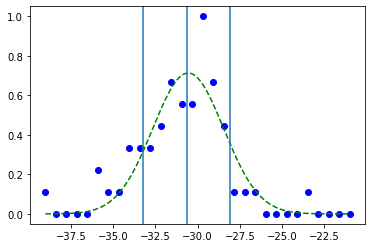

In [81]:
# histogram
nuzdiff = filtered_diff['diff']
dnuzdiff = filtered_diff['ddiff']

print(int(min(nuzdiff))-1, int(max(nuzdiff)+1))
# x axis
bins = np.linspace(int(min(nuzdiff))-1, int(max(nuzdiff)+1), 30)
print('> bins:', bins)

# y axis
digitized = np.digitize(nuzdiff, bins)
bin_y = [sum(digitized == i) for i in range(1, len(bins)+1)]
bin_y = bin_y / max(bin_y)
print('> biny:', bin_y)

# fit gaus
def gaus(x, a, x0, sigma):
    return a*np.exp(-(x-x0)**2/(2*sigma**2))

mean_nuzdiff, dmean_nuzdiff = statistics.mean_and_error(nuzdiff, dnuzdiff)
umean_nuzdiff = ufloat(mean_nuzdiff, dmean_nuzdiff)
std_nuzdiff = ufloat(nuzdiff.std(), 0)

p0 = [1, mean_nuzdiff, std_nuzdiff.n]
#p0 = [1, mean, nu_z_shift_sigma]
print("> fit p0     :", p0)
popt, pcov = scipy.optimize.curve_fit(gaus, bins, bin_y, p0=p0)
p_errors = np.sqrt(np.diag(pcov))
print("> fit results:", popt, p_errors)

if False:
    umean_nuzdiff = ufloat(popt[1], p_errors[1])
    std_nuzdiff = ufloat(popt[2], p_errors[2])

print('> nu_z_mean', mean_nuzdiff, std_nuzdiff)

# plot data and fit
gausbins = np.linspace(int(min(nuzdiff))-1, int(max(nuzdiff)+1), 300)
plt.plot(bins, bin_y, 'bo')
plt.plot(gausbins, gaus(gausbins, popt[0], popt[1], popt[2]), 'g--')
#plt.axvline(nu_z_shift_mean.n)
#plt.axvline(nu_z_shift_mean.n - nu_z_shift_sigma)
#plt.axvline(nu_z_shift_mean.n + nu_z_shift_sigma)
plt.axvline(umean_nuzdiff.n)
plt.axvline(umean_nuzdiff.n - std_nuzdiff.n)
plt.axvline(umean_nuzdiff.n + std_nuzdiff.n)
plt.savefig("histogram.png")
plt.show()


In [82]:
c2 = ufloat(-1.496e-2, 0.007e-2)
d4 = ufloat(8.878e-4, 2.6e-6)
c4 = d4 * meas_config["tr_offsets"][0]
nu_p = meas_config["nu_p"]
nu_m = meas_config["nu_m"]

ion = meas_config["ion"]
m, dmion = ame.get_ion_mass(ion)
print(m)
m = m * scipy.constants.physical_constants["atomic mass unit-kilogram relationship"][0]

A, el, q = ideal_trap_physics.re_ionstr(ion)
kb = scipy.constants.k
e = scipy.constants.e

print(kb)
print(m)
print(e)

11.99670962641247
1.380649e-23
1.9921005005314195e-26
1.602176634e-19


In [83]:
from numpy.random import rand, exponential, normal


In [84]:
### Equations
# eq. 1:
#       nu_z_shift / nu_z_cool = C4/C2 * 3/2 * {roh_-}^2
# =>    roh_- = sqrt ( 2/3 * C2/C4 * nu_z_shift/nu_z_cool )
#
# eq. 2 (error calculation):
#       del_roh_- = roh_-/2 * del(nu_z_shift)/nu_z_shift
#
# eq. 3:
#       2* del(z) \approx 0.5/nu_+ * sqrt ( k*T_z / (2m) )
# =>    T_z = (4 * del(z) * nu_+)^2 * 2m/k
#      >>> This is a rough estimation, using the (hopefully) correctly solved integral:
# =>    T_z = (2.673 * del(z) * nu_+)^2 * 2m/k
#
# eq. 4:
#       del(z) = sqrt( omega_+/omega_z ) * del(roh_-)
#
# =>    T_z = 8 * m/k * nu_+^3/nu_z * (roh_-)^2 * del(nu_z_shift)/nu_z_shift
#
# =>    T_z = 16/3 * m/k * nu_+^3/nu_z^2 * C2/C4 * del(nu_z_shift)
### 

print("\n<<< AXIAL TEMP TRAP", trap, '>>>')

umean_nuzdiff += 0
#nu_z_shift_sigma += -1
print('> C2 =', c2, 'C4 =', c4, 'C4/C2 =', c4/c2, 'C2/C4 =', c2/c4)
print('nu_z_shift_mean =', umean_nuzdiff, 'nu_z_shift_sigma =', std_nuzdiff)        
print('> nu_p =', nu_p)        

roh_minus = umath.sqrt( 2/3*c2/c4*umean_nuzdiff/nu_z_cool ) # or rho_plus, same same
print('> roh_- (mm)=', roh_minus)

del_roh_minus = roh_minus/2 * std_nuzdiff/umean_nuzdiff
print('> del(roh_-) (mm)=', del_roh_minus)

del_z = umath.sqrt( nu_p / nu_z_cool ) * del_roh_minus # also same same
print('> del(z) (mm)=', del_z)

temp_z = (2.673 * del_z /1000 * nu_z_cool)**2 * 2* m / kb # /1000 for conversion from mm to m
print('>>> temp_z (K)=', temp_z, "(original calculation)\n")

temp_z = 2.373 * m/kb * nu_p/umean_nuzdiff * c2/c4 * std_nuzdiff**2 / 1000**2
print('>>> temp_z (K)=', temp_z, "(alternative calculation (Alex))\n")

# delR**2 = del(Delta_nu_z)**2 / Delta_nu_z * C_4/C_2 / (6*nu_z_cool)
del_roh_minus = umath.sqrt( std_nuzdiff**2 / umean_nuzdiff * c4/c2 / (6*nu_z_cool) )
print('> del(roh_-) (mm)=', del_roh_minus * 1000, "(alternative calculation (Sergey))")
# temp_z = m * nu_p * nu_z_cool / k_boltz * delR**2 ;       
temp_z = m * nu_p / kb * std_nuzdiff**2 / umean_nuzdiff * c4/c2 / 6 * 4 * np.pi**2
#temp_z = m * nu_p * nu_z_cool / k_boltz * del_roh_minus**2 * 4 * np.pi**2
print('>>> temp_z (K)=', temp_z, "(alternative calculation (Sergey))\n")


# thermal energy picked from distribution and calc radii
Tp = temp_z.n * nu_p/nu_z_cool.n
E0p = exponential(kb*Tp, 50000)
r0p = np.sqrt(2*E0p/m/(2*np.pi*nu_p)**2) # Das sind tatsächlich die Einzelradien
print('mean/std thermal rho_p', np.mean(r0p), np.std(r0p))

# same for magnetron...
Tm = temp_z.n * nu_m/nu_z_cool.n
E0m = exponential(kb*Tm, 50000)
r0m = np.sqrt(4*E0m/m/(2*np.pi*nu_z_cool.n)**2) #
print('mean/std thermal rho_m', np.mean(r0m), np.std(r0m))

# and axial...
E0z = exponential(kb*temp_z.n, 50000)
z0r = np.sqrt(2*E0z/m/(2*np.pi*nu_z_cool.n)**2)
print('mean/std thermal z', np.mean(z0r), np.std(z0r))

rho_other_thermal = np.mean(r0p)*1000
zamp_thermal = np.mean(z0r)*1000
roh_minus = umath.sqrt(2/3*c2/c4*umean_nuzdiff/nu_z_cool + rho_other_thermal**2 - zamp_thermal**2 )
print('> roh_- (mm, corrected) =', roh_minus)




<<< AXIAL TEMP TRAP 3 >>>
> C2 = -0.01496+/-0.00007 C4 = (8.878+/-0.026)e-06 C4/C2 = -0.0005934+/-0.0000033 C2/C4 = -1685+/-9
nu_z_shift_mean = -30.64+/-0.34 nu_z_shift_sigma = 2.5779407983527496+/-0
> nu_p = 53775425.26
> roh_- (mm)= 0.2620+/-0.0016
> del(roh_-) (mm)= -0.01102+/-0.00007
> del(z) (mm)= -0.1141+/-0.0007
>>> temp_z (K)= 67.5+/-0.8 (original calculation)

>>> temp_z (K)= 67.3+/-0.8 (alternative calculation (Alex))

> del(roh_-) (mm)= 0.00654+/-0.00004 (alternative calculation (Sergey))
>>> temp_z (K)= 65.7+/-0.8 (alternative calculation (Sergey))

mean/std thermal rho_p 8.206556476754913e-06 4.258766378427444e-06
mean/std thermal rho_m 8.185423903376889e-06 4.299588784600052e-06
mean/std thermal z 8.441793254536381e-05 4.425899772127543e-05
> roh_- (mm, corrected) = 0.2482+/-0.0017


In [ ]:
_